# Прогнозирование большого количества рядов

Процесс подбора модели ARIMA в Питоне достаточно трудоёмок, поэтому вы не сможете вручную подобрать модель для каждого из рядов в выбранных ячейках. Чтобы облегчить ручной перебор, вам предстоит кластеризовать временные ряды и подобрать гиперпараметры модели ARIMA только один раз для всех рядов каждого кластера.

Результатом этой недели будут построенные с помощью ARIMA почасовые прогнозы количества поездок для всех географических зон Нью-Йорка. Модель, которую мы строим, должна делать почасовые прогнозы для всех выбранных непустых ячеек на 6 часов вперёд. Качество модели мы будем оценивать с помощью среднего абсолютного отклонения от истинного количества поездок в июне:

<center>$Q_{june}=\frac{1}{R∗715∗6}\sum_{r=1}^R\sum_{T=2016.05.3123:00}^{2016.06.3017:00}\sum_{i=1}^6\mid{\widehat{y}}^r_{T|T+i}−{\widehat{y}}^r_{T+i}\mid.$</center>

$R$ — количество прогнозируемых рядов, $715$ — количество перебираемых концов истории.

Построенные прогнозы вам предстоит загрузить на kaggle. К сожалению, в формате kaggle сложно организовать конкурс по прогнозированию временных рядов в традиционном виде, с отложенным тестом и пересчётом лидерборда, поскольку прогнозы необходимо строить со скользящим концом истории. Но цель использования kaggle в этом проекте — не победа в конкурсе; вы всегда можете загрузить истинные данные за июнь и получить первое место. Цель в том, чтобы посмотреть, какие модели, решения и признаки использовали ваши коллеги, и понять, какие из них стоит попробовать и вам.

## Задание № 1

Составьте из данных о поездках прямоугольную таблицу так, чтобы по строкам было время, а по столбцам идентификатор ячейки (возьмите только те, которые были отобраны на второй неделе). **Не используйте данные за последние имеющиеся месяцы — май и июнь 2016!**

In [1]:
import numpy as np
import pandas as pd
from glob import glob

Перед непосредственной загрузкой данных, необходимо получить путь ко всем файлам выборки по годам. Для этого воспользуемся библиотекой glob, с помощью которой довольно просто получить путь к файлам конкретного формата (в нашем случае **csv**)

In [2]:
file_path = glob("u_data/*.csv", recursive=True)
file_path = np.sort(file_path)[:-12]

Далее, определяем функцию, с помощью которой будет осуществляться загрузка файлов, и объединение разрозненной выборки в одно целое.

In [3]:
def open_data(path):
    data_list = []
    for p in path:
        data = pd.read_csv(p, sep=",", index_col="time", parse_dates=["time"])
        data_list.append(data)
    return pd.concat(data_list)

Вызываем функцию, предварительно указав массив со строками путей до файлов, и объединенную выборку присваиваем переменной **data_orig**.

In [4]:
data_orig = open_data(file_path)

Согласно условию задания, необходимо исследовать только те области, которые визуализировались **на второй неделе дипломного проекта**.

Напоминаю, что условием отбора областей являлось среднее значение за час **не менее 5 поездок** в мае 2016.

In [5]:
data_means = data_orig.loc['2016.05.01 00:00:00':'2016.05.31 23:00:00'].groupby("region").mean()
regions = data_means[data_means.trips >= 5].index.values
del data_means

In [6]:
regions_check = data_orig.region.isin(regions)
data = data_orig[regions_check].loc['2013.01.01 00:00:00':'2016.06.30 23:00:00']

Получив всю необходимую информацию, получим желаемый датафрейм преобразовав исходную выборку.

In [7]:
temp = [data[data.region == r].trips for r in regions]
data = pd.concat(temp, axis=1)
data.columns = ["region_" + str(region) for region in regions]
del temp
data.head(5)

,region_1075,region_1076,region_1077,region_1125,region_1126,region_1127,region_1128,region_1129,region_1130,region_1131,...,region_1630,region_1684,region_1733,region_1734,region_1783,region_2068,region_2069,region_2118,region_2119,region_2168
time,,,,,,,,,,,,,,,,,,,,,
2013-01-01 00:00:00,75.0,149.0,88.0,95.0,297.0,538.0,594.0,769.0,952.0,267.0,...,12.0,0.0,9.0,113.0,27.0,19.0,6.0,68.0,18.0,67.0
2013-01-01 01:00:00,108.0,204.0,81.0,126.0,402.0,572.0,518.0,623.0,655.0,220.0,...,22.0,0.0,3.0,7.0,5.0,11.0,3.0,82.0,1.0,15.0
2013-01-01 02:00:00,82.0,162.0,83.0,135.0,361.0,471.0,470.0,495.0,484.0,156.0,...,23.0,0.0,1.0,6.0,3.0,2.0,0.0,28.0,0.0,16.0
2013-01-01 03:00:00,79.0,122.0,24.0,106.0,289.0,482.0,448.0,467.0,337.0,102.0,...,25.0,0.0,1.0,1.0,7.0,2.0,0.0,6.0,0.0,1.0
2013-01-01 04:00:00,35.0,89.0,20.0,59.0,181.0,332.0,377.0,343.0,354.0,92.0,...,26.0,0.0,2.0,5.0,2.0,3.0,0.0,30.0,2.0,16.0


Учитывая тот факт, что для построении модели необходимо исключить **май** и **июнь 2016 года**, выделим из общего массива информации обучающую (до мая 2016 г.) и тестовую (начиная с мая 2016 г.) выборку.

In [44]:
def prepare_train_test_data(end_train_date, start_test_date):
    train_data = data.loc[:end_train_date]
    test_data = data.loc[start_test_date:]

    print("Дата и время начала тренировочных наблюдений: ", train_data.index[0])
    print("Дата и время окончания тренировочных наблюдений: ", train_data.index[-1])
    print()
    print("Дата и время начала тестовых наблюдений: ", test_data.index[0])
    print("Дата и время окончания тестовых наблюдений: ", test_data.index[-1])
    
    return (train_data, test_data)

In [45]:
train_data, test_data = prepare_train_test_data('2016.04.30 23:00:00', '2016.05.01 00:00:00')

Дата и время начала тренировочных наблюдений:  2013-01-01 00:00:00
Дата и время окончания тренировочных наблюдений:  2016-04-30 23:00:00

Дата и время начала тестовых наблюдений:  2016-05-01 00:00:00
Дата и время окончания тестовых наблюдений:  2016-06-30 23:00:00


Таким образом, мы достигли желаемого результата.

## Задание № 2

Перед проведением кластеризации стандартизуйте столбцы (вычтите выборочное среднее и поделите на выборочную дисперсию). Это необходимо, поскольку при выборе модели ARIMA имеет значение только форма ряда, но не его средний уровень и размах колебаний.

In [10]:
#Расчет выборочного среднего и выборочной дисперсии.
data_mean = train_data.mean()
data_var = train_data.var()

In [11]:
data_stand = (train_data - data_mean) / (data_var ** 0.5)
data_stand.head(5)

,region_1075,region_1076,region_1077,region_1125,region_1126,region_1127,region_1128,region_1129,region_1130,region_1131,...,region_1630,region_1684,region_1733,region_1734,region_1783,region_2068,region_2069,region_2118,region_2119,region_2168
time,,,,,,,,,,,,,,,,,,,,,
2013-01-01 00:00:00,0.222759,0.100307,-0.108587,0.498143,0.793496,1.272241,1.113517,1.515547,1.669770,1.189422,...,1.297103,-0.877302,0.038376,-0.597891,-1.081713,-1.104500,-0.344588,-0.833061,-0.731373,0.276610
2013-01-01 01:00:00,1.016275,0.755864,-0.214600,1.220312,1.739010,1.469183,0.748702,0.901711,0.623122,0.667846,...,3.317504,-0.877302,-0.798453,-1.278446,-1.247840,-1.248264,-0.716215,-0.644727,-1.255740,-1.209127
2013-01-01 02:00:00,0.391081,0.255256,-0.184311,1.429973,1.369810,0.884151,0.518292,0.363553,0.020507,-0.042385,...,3.519544,-0.877302,-1.077396,-1.284867,-1.262943,-1.409998,-1.087842,-1.371160,-1.286585,-1.180555
2013-01-01 03:00:00,0.318943,-0.221512,-1.077853,0.754396,0.721457,0.947867,0.412688,0.245831,-0.497530,-0.641643,...,3.923624,-0.877302,-1.077396,-1.316968,-1.232738,-1.409998,-1.087842,-1.667114,-1.286585,-1.609133
2013-01-01 04:00:00,-0.739078,-0.614847,-1.138432,-0.340505,-0.251072,0.079007,0.071873,-0.275509,-0.437621,-0.752616,...,4.125665,-0.877302,-0.937925,-1.291287,-1.270494,-1.392028,-1.087842,-1.344255,-1.224895,-1.180555


## Задание № 3

Кластеризуйте географические зоны по значениям стандартизованных рядов. Подберите число кластеров так, чтобы оно было не слишком большим, но ряды внутри кластеров имели похожую форму. Постройте графики стандартизованных рядов каждого кластера, чтобы в этом убедиться.

In [12]:
from sklearn.cluster import KMeans

Так как текущей задачей является кластеризация географических зон, то перед непосредственной кластеризацией, необходимо транспонировать матрицу стандартизированных значений ВР областей. Это связано с тем, что для кластеризации следует обратить каждое значение ВР в признаковое пространство с той целью, чтобы каждый регион характеризовался значениями ряда, а не наоборот.

In [13]:
trans_data_stand = data_stand.transpose()

После перебора различного числа кластеров, выбор был остановлен на 10, так как данное количество является наиболее удачным для выбора схожих по форме областей, о чем свидетельствуют графики (представлены ниже).

In [14]:
n_clusters = 18
model = KMeans(n_clusters=n_clusters, random_state=10)
preds = model.fit_predict(data_stand.transpose())
print(preds)
unique = np.unique(preds, return_counts=True)
["Cluster " + str(x[0]) + " count is " + str(x[1]) for x in zip(unique[0], unique[1])]

[ 5  3  3  5  5  2  2  1  1  2  3  6  6  6  0  1  1  1  2  5  3  2  3  3  9
  9  9  2  6  1  1  2  2  5  5  5  3  3  9  9  9  1  3  3  5  5  5  3  3  3
  3  7  7  3  3  3  3  3  3  0  0  0  7  7  7  9  5  3  3  3  0 14 14 10 10
  7 13  3 14 14 14 14 10 17  0  4 16  4  4 16 16  4 15 12 12 12 12 11 11 11
 11  8]


['Cluster 0 count is 6',
 'Cluster 1 count is 8',
 'Cluster 2 count is 8',
 'Cluster 3 count is 24',
 'Cluster 4 count is 4',
 'Cluster 5 count is 11',
 'Cluster 6 count is 4',
 'Cluster 7 count is 6',
 'Cluster 8 count is 1',
 'Cluster 9 count is 7',
 'Cluster 10 count is 3',
 'Cluster 11 count is 4',
 'Cluster 12 count is 4',
 'Cluster 13 count is 1',
 'Cluster 14 count is 6',
 'Cluster 15 count is 1',
 'Cluster 16 count is 3',
 'Cluster 17 count is 1']

In [15]:
data_trans = data_stand.transpose()
for n in range(n_clusters):
    print("Cluster", n, ":", data_trans[preds == n].index.values)

Cluster 0 : ['region_1175' 'region_1337' 'region_1338' 'region_1339' 'region_1386'
 'region_1442']
Cluster 1 : ['region_1129' 'region_1130' 'region_1176' 'region_1177' 'region_1178'
 'region_1227' 'region_1228' 'region_1278']
Cluster 2 : ['region_1127' 'region_1128' 'region_1131' 'region_1179' 'region_1182'
 'region_1224' 'region_1229' 'region_1230']
Cluster 3 : ['region_1076' 'region_1077' 'region_1132' 'region_1181' 'region_1183'
 'region_1184' 'region_1234' 'region_1235' 'region_1279' 'region_1280'
 'region_1284' 'region_1285' 'region_1286' 'region_1287' 'region_1331'
 'region_1332' 'region_1333' 'region_1334' 'region_1335' 'region_1336'
 'region_1383' 'region_1384' 'region_1385' 'region_1434']
Cluster 4 : ['region_1480' 'region_1483' 'region_1530' 'region_1580']
Cluster 5 : ['region_1075' 'region_1125' 'region_1126' 'region_1180' 'region_1231'
 'region_1232' 'region_1233' 'region_1281' 'region_1282' 'region_1283'
 'region_1382']
Cluster 6 : ['region_1172' 'region_1173' 'region_1174

In [16]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/IPython/core/magics/pylab.py:161: UserWarning: pylab import has clobbered these variables: ['unique']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


После проведения кластеризации, следует изобразить графики ВР каждой области, которая попала в тот или иной кластер для оценки корректности результов.

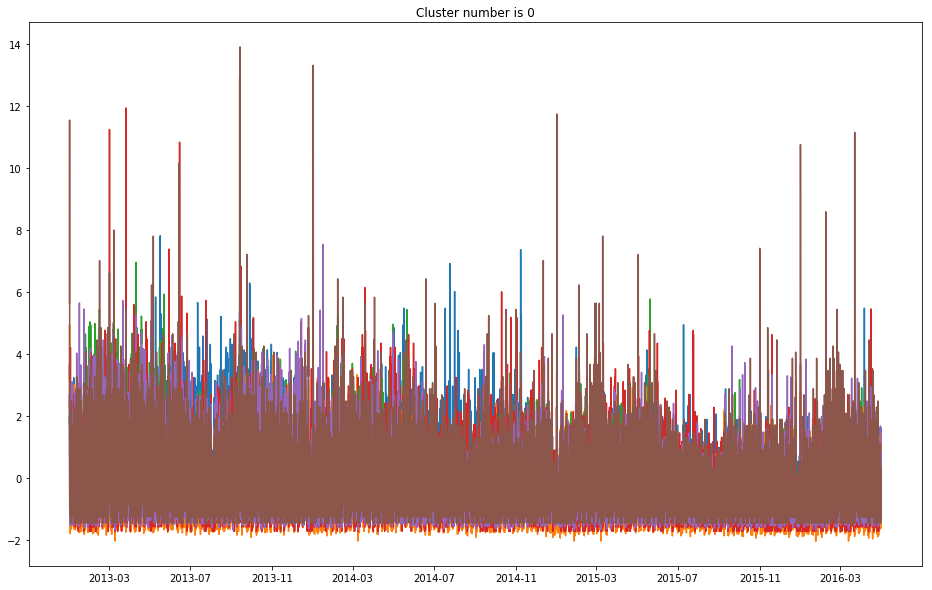

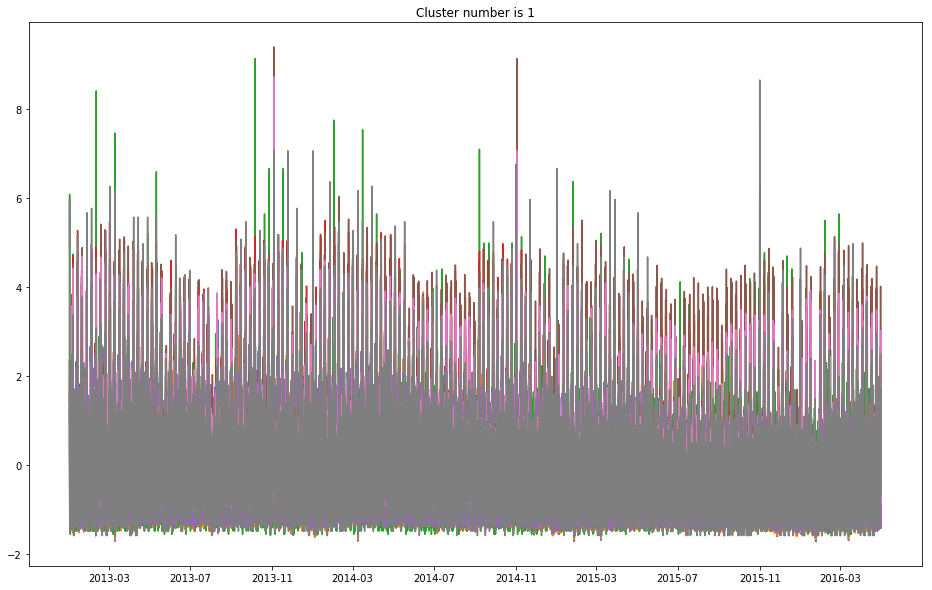

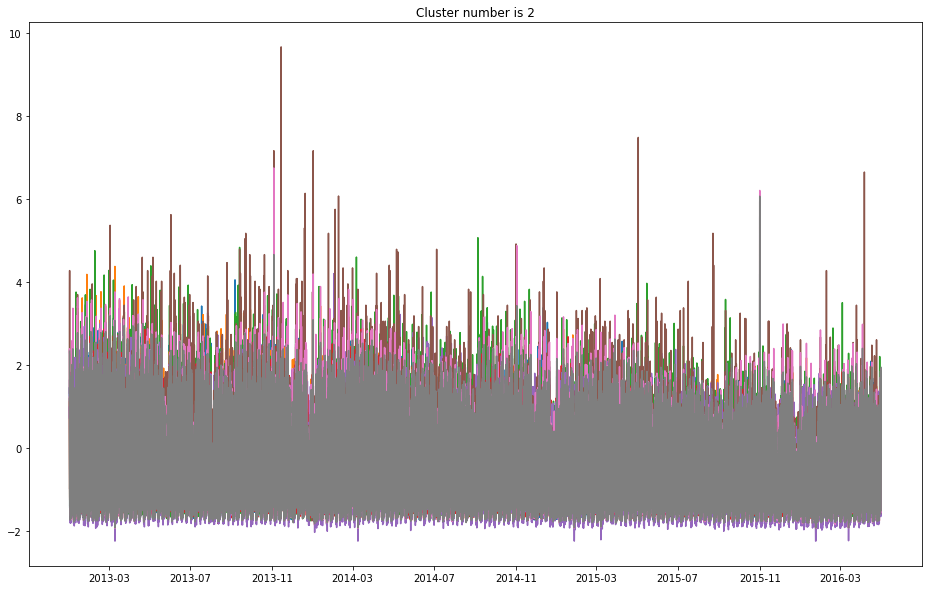

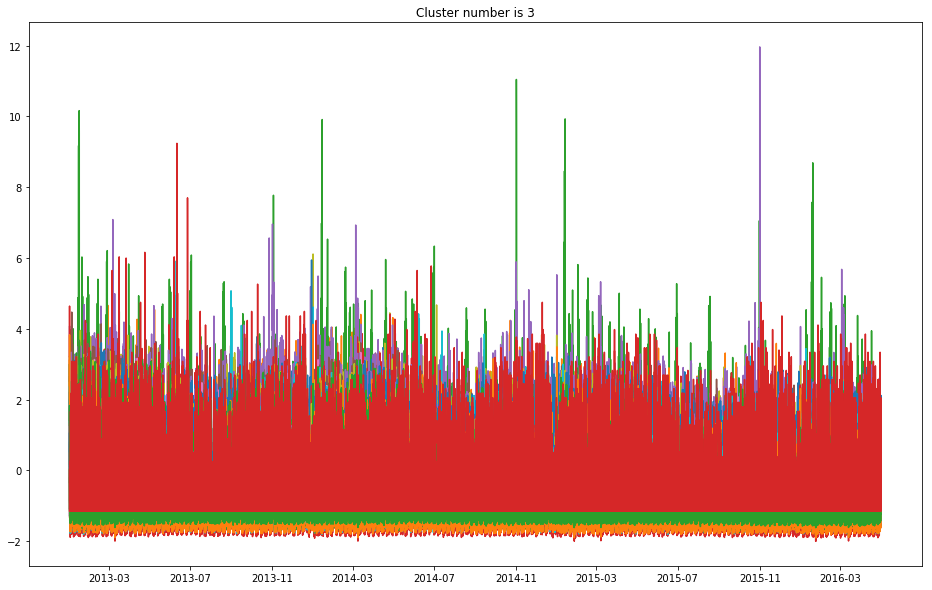

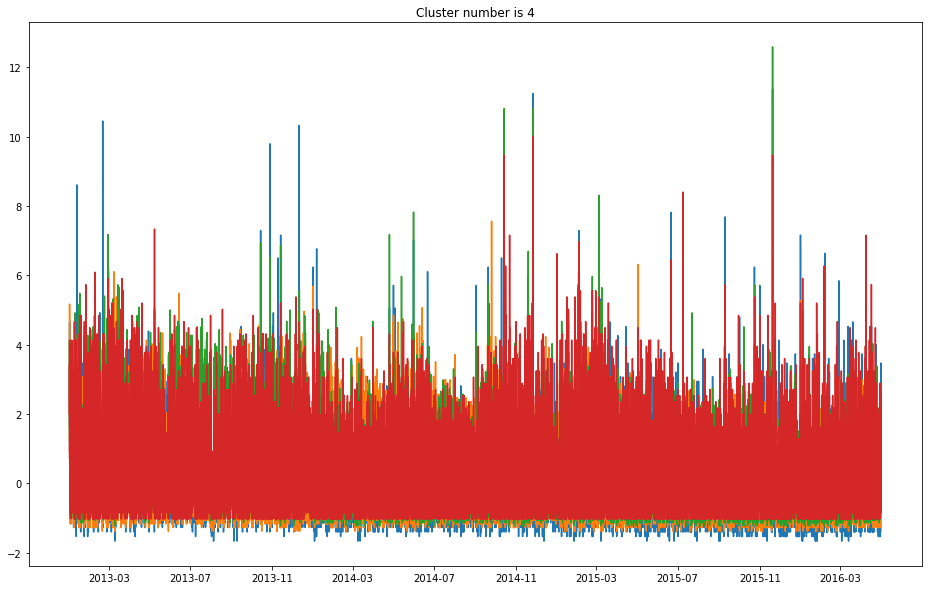

...

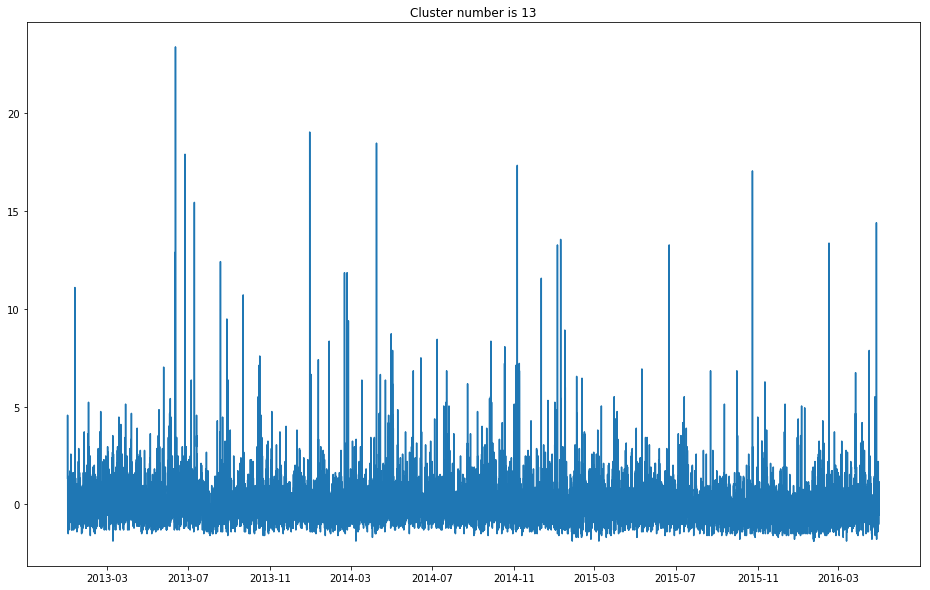

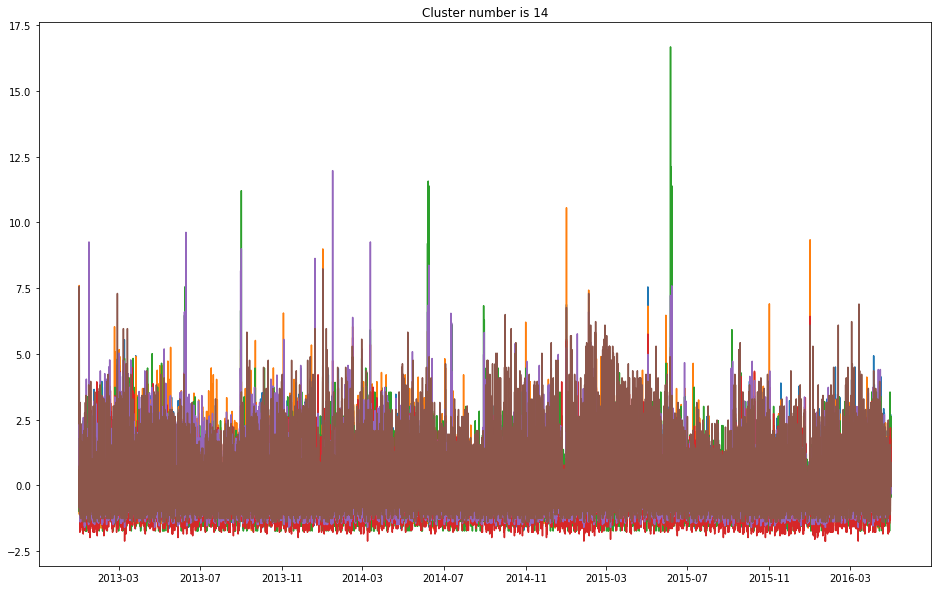

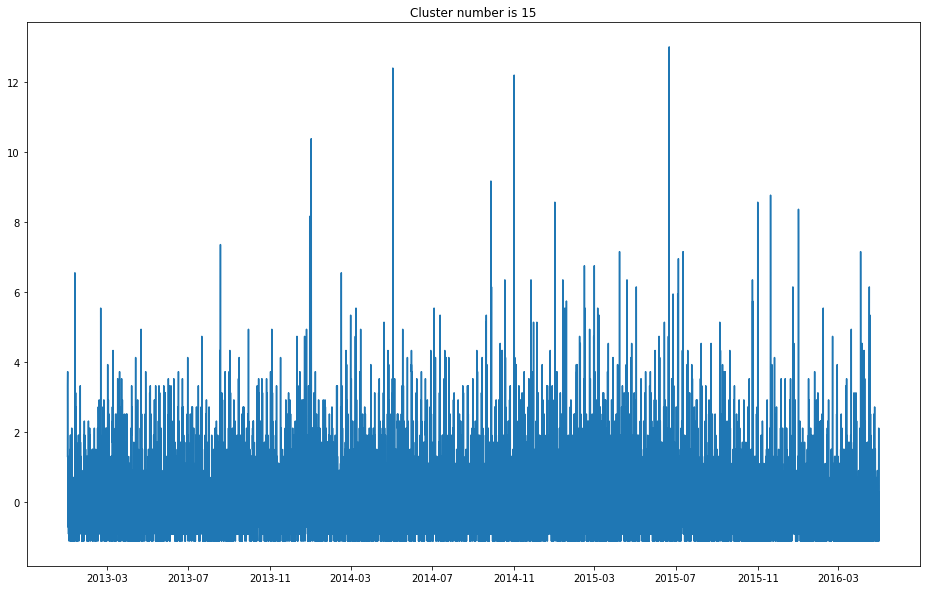

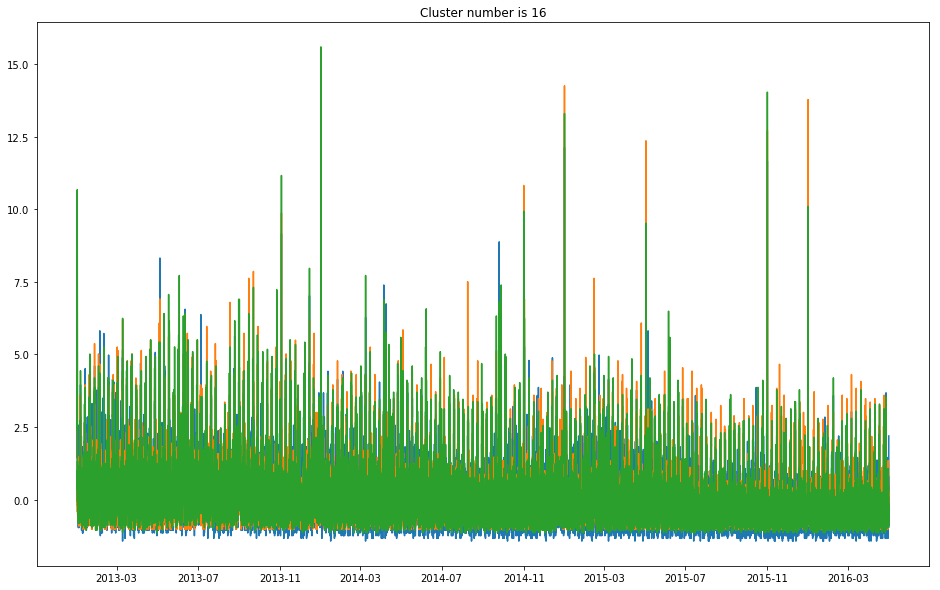

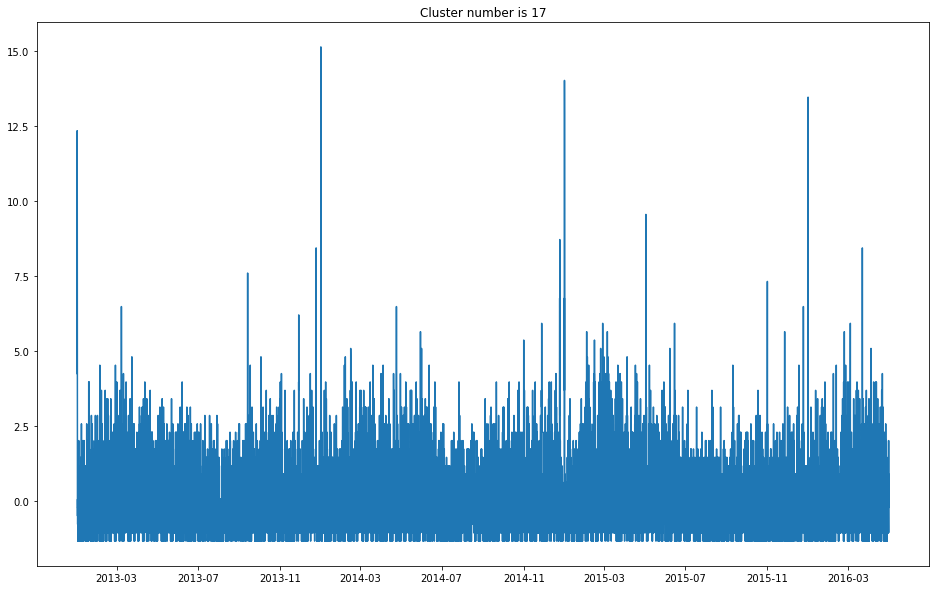

In [17]:
for n_cluster in np.unique(preds):
    pylab.figure(figsize=(16, 10))
    pylab.plot(data_stand.index, trans_data_stand[preds == n_cluster].transpose())
    pylab.title("Cluster number is " + str(n_cluster))
    pylab.show()

Представленные выше графики подтвержают, что 10 кластеров является вполне удачным выбором для отбора **"схожих"** регионов.

## Задание № 4

В каждом кластере выберите наиболее типичный ряд (например, это может быть ряд, соответствующий центру кластера).

In [18]:
t_series = model.cluster_centers_
index = ["cluster_" + str(n_cluster) for n_cluster in np.unique(preds)]
t_series = pd.DataFrame(t_series, index=index).transpose()
t_series.index = data_stand.index
t_series

,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,cluster_8,cluster_9,cluster_10,cluster_11,cluster_12,cluster_13,cluster_14,cluster_15,cluster_16,cluster_17
time,,,,,,,,,,,,,,,,,,
2013-01-01 00:00:00,2.750473,1.770384,1.552783,0.940549,1.382328,0.380445,1.352779,3.056450,0.276610,2.800577,3.661363,-0.753381,-0.629633,1.338128,2.538205,1.297103,2.162806,4.243028
2013-01-01 01:00:00,4.206839,1.866707,1.514571,1.569439,3.749053,0.453432,4.617515,4.907811,-1.209127,6.047500,9.586299,-0.966237,-1.050510,2.569231,5.640681,3.317504,7.932600,10.670410
2013-01-01 02:00:00,3.967207,1.692281,1.224347,1.127037,4.366789,0.309603,4.859997,4.543912,-1.180555,5.566403,8.555322,-1.288896,-1.125627,4.557936,5.544549,3.519544,8.765062,12.347118
2013-01-01 03:00:00,2.360862,1.874786,1.210310,0.278240,4.071178,0.079264,3.118785,4.099419,-1.609133,4.992071,6.915607,-1.362885,-1.126101,2.663931,4.252148,3.923624,9.825867,10.111507
2013-01-01 04:00:00,1.689544,1.487308,0.436726,-0.454457,3.259377,-0.573791,1.389868,3.434606,-1.180555,2.765903,3.504043,-1.262255,-1.094252,2.758632,2.832154,4.125665,6.645562,5.640285
2013-01-01 05:00:00,0.790251,0.087334,-0.629129,-0.935114,1.925989,-1.105239,0.352556,1.675830,0.362325,0.711803,2.718724,-0.513374,-1.150016,0.864627,1.128431,3.721584,3.400911,3.404674
2013-01-01 06:00:00,0.169328,-0.404159,-1.027769,-1.079818,1.680627,-1.233604,-0.355484,0.492171,1.448056,-0.049335,0.957922,-0.550148,-1.118641,0.959327,0.605688,2.307303,2.244538,2.286869
2013-01-01 07:00:00,-0.150630,-0.662305,-1.197826,-1.034401,1.038607,-1.216485,-0.694855,-0.012604,0.533756,-0.466589,0.970978,-0.531834,-0.948785,0.391125,-0.248680,2.307303,0.875954,1.448514
2013-01-01 08:00:00,-0.507595,-0.951137,-1.292763,-1.001947,0.839837,-1.228955,-0.734708,-0.252824,0.390897,-0.583190,0.744587,-0.992756,-0.665105,-0.839978,-0.596770,1.095063,0.494405,2.566320


## Задание № 5

Для выбранных географических зон подберите на исходных рядах оптимальную структуру моделей — набор регрессионных признаков и значения гиперпараметров $p,d,q,P,D,Q$ — так, как это делалось на прошлой неделе. **Не используйте данные за последний имеющийся месяц — май и июнь 2016!**

In [19]:
# Функция построения регрессионного признака по формулам синуса и косинуса

def season_attribute(func_name, start_T, T, season_length, season_name, K):
    if func_name not in ["sin", "cos"]:
        raise ValueError("Set func_name the value is sin or cos")
    
    func = np.sin if func_name is "sin" else np.cos
    
    if start_T < 1:
        raise ValueError("Set start_T equal or greater then 1")
        
    t_interval = np.arange(start_T, T + 1, dtype=int)
    values_dict = dict()
    for k in range(1, K + 1):
        key = func_name + "_" + season_name + "_" + str(k)
        values_dict[key] = func(t_interval * 2 * np.pi * k / season_length)
    return pd.DataFrame(values_dict)

In [20]:
def trend_attribute(start_T, T):
    if start_T < 1:
        raise ValueError("Set start_T equal or greater then 1")  
    t_interval = np.arange(start_T, T + 1, dtype=int)
    return pd.DataFrame(t_interval, columns=["Trend"])

In [21]:
import statsmodels.formula.api as smf
import statsmodels.api as sm

def set_attributes(cluster, week_k=0, year_k=0, fit=True, trend=True, start=1, end=1):
    data_list = []
    
    if cluster is not None:
        data_list.extend([cluster])
    
    if end <= 1:
        end = cluster.shape[0]
    
    day_hours = 24

    # Регрессионные признаки по недельной сезонности
    week_hours = day_hours * 7
    if week_k > 0:
        sin_week_data = season_attribute("sin", start, end, week_hours, "week", week_k).set_index(cluster.index)
        cos_week_data = season_attribute("cos", start, end, week_hours, "week", week_k).set_index(cluster.index)
        data_list.extend([sin_week_data, cos_week_data])

    # Регрессионные признаки по годовой сезонности
    year_hours = 8766
    if year_k > 0:
        sin_year_data = season_attribute("sin", start, end, year_hours, "year", year_k).set_index(cluster.index)
        cos_year_data = season_attribute("cos", start, end, year_hours, "year", year_k).set_index(cluster.index)
        data_list.extend([sin_year_data, cos_year_data])
    
    if trend is True:
        trend_data = trend_attribute(start, end).set_index(cluster.index)
        data_list.extend([trend_data])

    cluster = pd.concat(data_list, axis=1)
    resid = []
    if fit is True:
        formula = cluster.columns[0] + " ~ "
        formula_attr = " + ".join(cluster.columns[1:])
        formula += formula_attr
        del formula_attr

        estimator = smf.ols(formula, cluster)
        fitted = estimator.fit()

        resid = fitted.resid
        pylab.figure(figsize=(16, 10))
        pylab.plot(cluster.index, resid)
        pylab.show()
        print(formula)
        print(fitted.summary())
        
    return resid, cluster.iloc[:,1:]

/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/statsmodels/compat/pandas.py:56: FutureWarning: The pandas.core.datetools module is deprecated and will be removed in a future version. Please use the pandas.tseries module instead.
  from pandas.core import datetools


In [22]:
def resid_seasonal_decompose(resid):
    plt.figure(figsize(15,10))
    s_dec = sm.tsa.seasonal_decompose(resid.dropna())
    s_dec.plot()
    print("Критерий Дики-Фуллера %.8f" % sm.tsa.stattools.adfuller(resid.dropna())[1])
    plt.ylabel("Trips")
    plt.show()
    return s_dec

In [23]:
def show_random_interval(s_dec):
    rand_day = np.random.randint(1, (s_dec.observed.shape[0] / 24) - 15)
    n = 24 * rand_day
    plt.figure(figsize(14,6))
    plt.plot(s_dec.observed[n:n + 24 * 15])
    plt.show()

    plt.figure(figsize(14,6))
    plt.plot(s_dec.seasonal[n:n + 24 * 15])
    plt.show()

In [24]:
def show_acf_pacf(resid, lags):
    plt.figure(figsize=(14,10))
    ax = plt.subplot(211)
    sm.graphics.tsa.plot_acf(resid.dropna().values.squeeze(), lags=lags, ax=ax)
    plt.show()
    plt.figure(figsize=(14,10))
    ax = plt.subplot(212)
    sm.graphics.tsa.plot_pacf(resid.dropna().values.squeeze(), lags=lags, ax=ax)
    plt.show()

In [25]:
def invboxcox(y,lmbda):
    if lmbda == 0:
        return(np.exp(y))
    else:
        return(np.exp(np.log(lmbda*y+1)/lmbda))

### Подбор параметров 1-го кластера


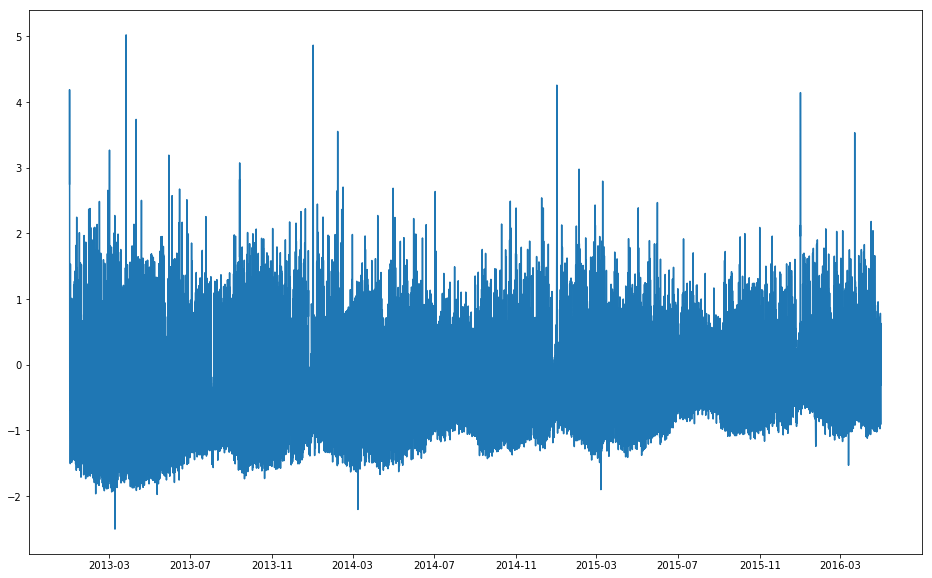

cluster_0 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + sin_week_5 + sin_week_6 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + cos_week_5 + cos_week_6 + sin_year_1 + sin_year_10 + sin_year_11 + sin_year_12 + sin_year_2 + sin_year_3 + sin_year_4 + sin_year_5 + sin_year_6 + sin_year_7 + sin_year_8 + sin_year_9 + cos_year_1 + cos_year_10 + cos_year_11 + cos_year_12 + cos_year_2 + cos_year_3 + cos_year_4 + cos_year_5 + cos_year_6 + cos_year_7 + cos_year_8 + cos_year_9 + Trend
                            OLS Regression Results                            
Dep. Variable:              cluster_0   R-squared:                       0.210
Model:                            OLS   Adj. R-squared:                  0.209
Method:                 Least Squares   F-statistic:                     209.3
Date:                Sat, 09 Dec 2017   Prob (F-statistic):               0.00
Time:                        13:26:08   Log-Likelihood:                -32013.
No. Observations:               29

In [340]:
resid_1, attr_1 = set_attributes(t_series.cluster_0, 6, 12)

Критерий Дики-Фуллера 0.00000000


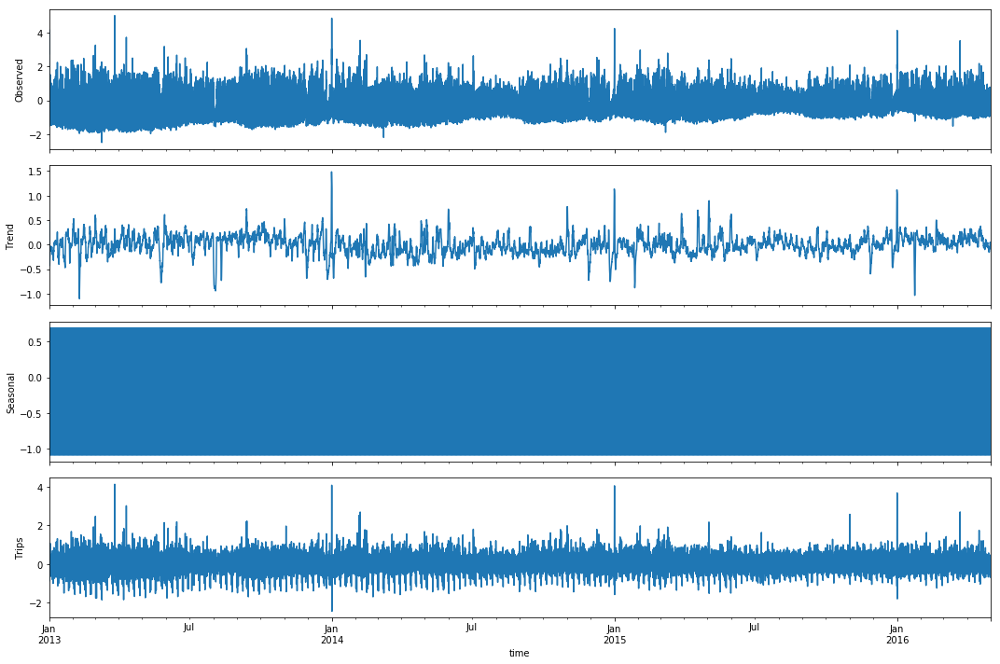

In [28]:
s_dec = resid_seasonal_decompose(resid_1)

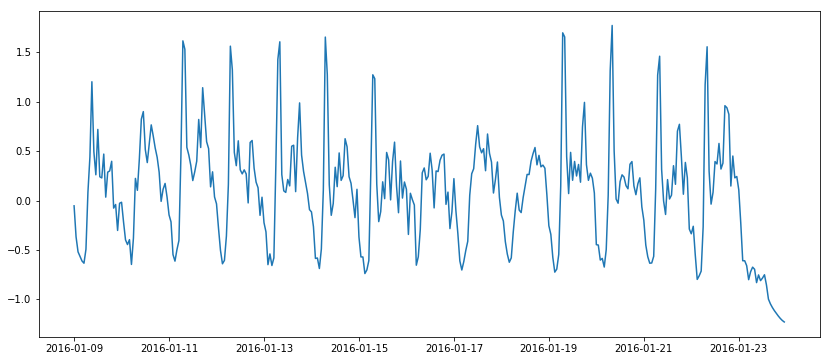

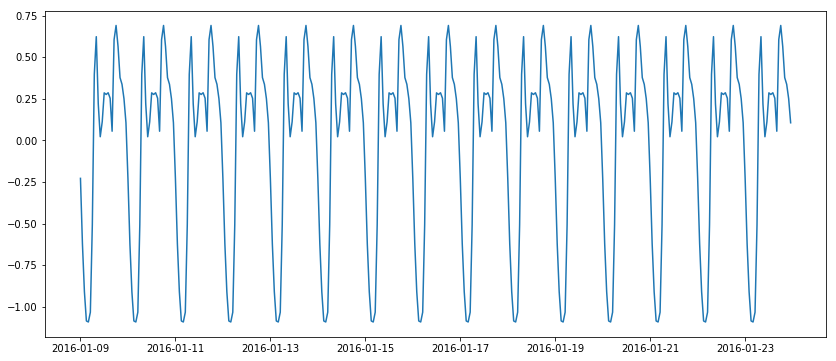

In [29]:
show_random_interval(s_dec)

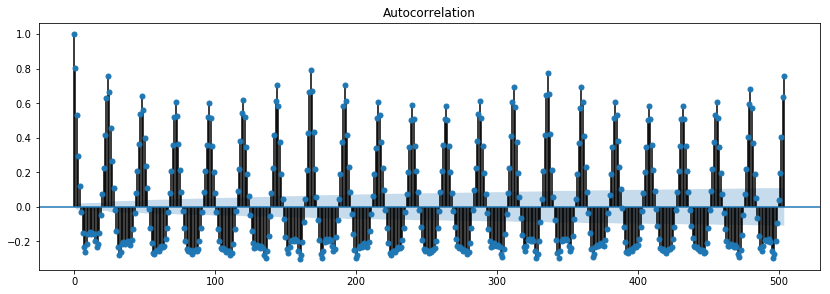

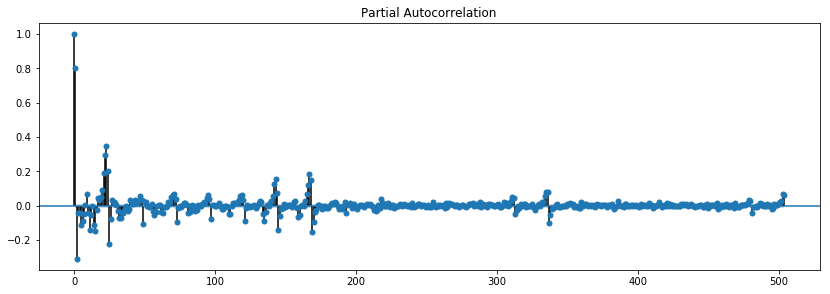

In [30]:
show_acf_pacf(resid_1, 24 * 7 * 3)

### Подбор параметров 2-го кластера

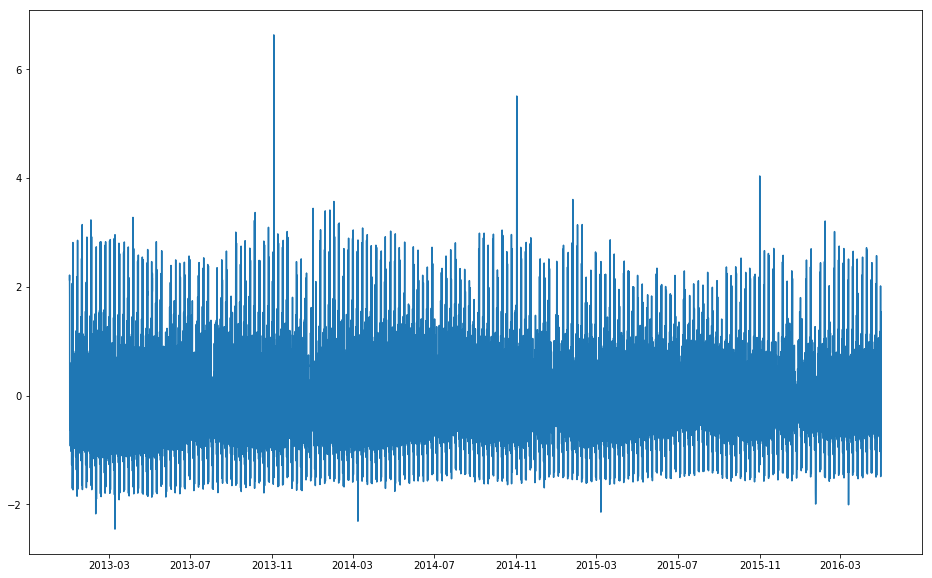

cluster_1 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + sin_year_1 + sin_year_10 + sin_year_11 + sin_year_12 + sin_year_13 + sin_year_14 + sin_year_2 + sin_year_3 + sin_year_4 + sin_year_5 + sin_year_6 + sin_year_7 + sin_year_8 + sin_year_9 + cos_year_1 + cos_year_10 + cos_year_11 + cos_year_12 + cos_year_13 + cos_year_14 + cos_year_2 + cos_year_3 + cos_year_4 + cos_year_5 + cos_year_6 + cos_year_7 + cos_year_8 + cos_year_9 + Trend
                            OLS Regression Results                            
Dep. Variable:              cluster_1   R-squared:                       0.234
Model:                            OLS   Adj. R-squared:                  0.233
Method:                 Least Squares   F-statistic:                     240.8
Date:                Thu, 30 Nov 2017   Prob (F-statistic):               0.00
Time:                        22:29:38   Log-Likelihood:                -34335.
No. Observations:             

In [31]:
resid_2, attr_2 = set_attributes(t_series.cluster_1, 4, 14)

Критерий Дики-Фуллера 0.00000000


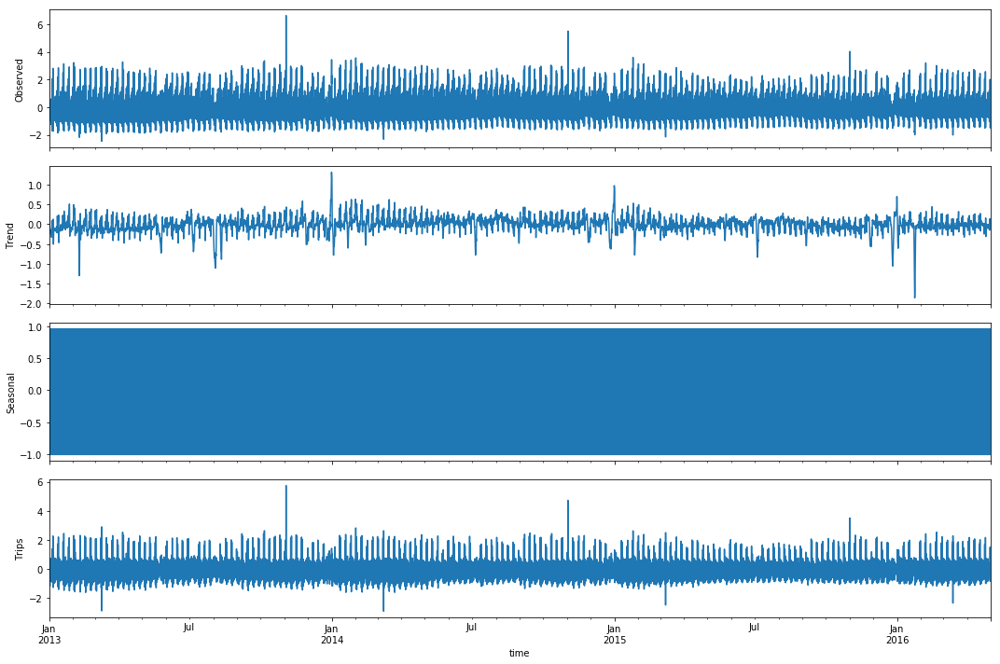

In [32]:
s_dec = resid_seasonal_decompose(resid_2)

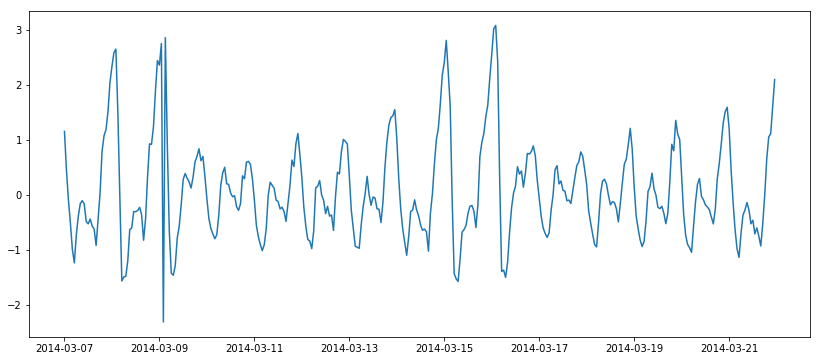

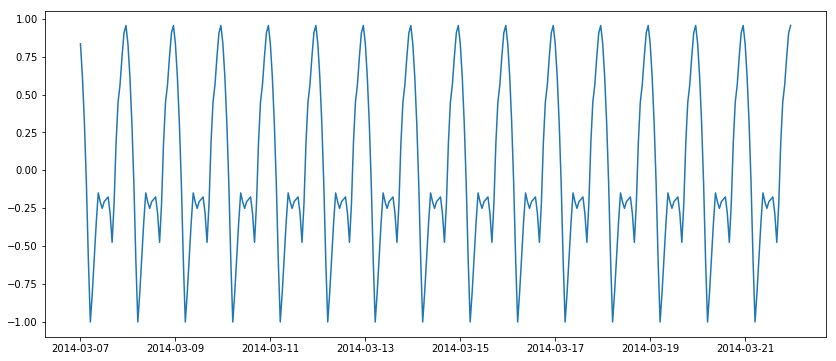

In [33]:
show_random_interval(s_dec)

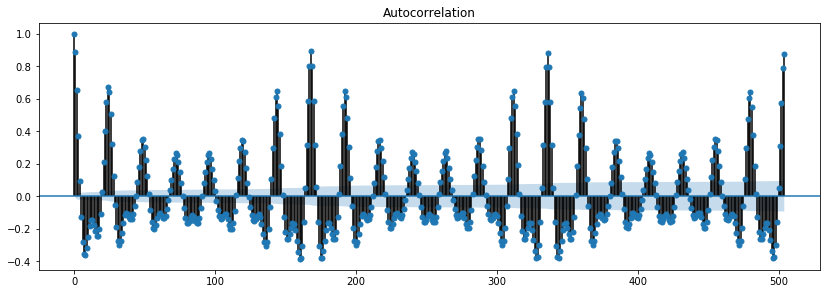

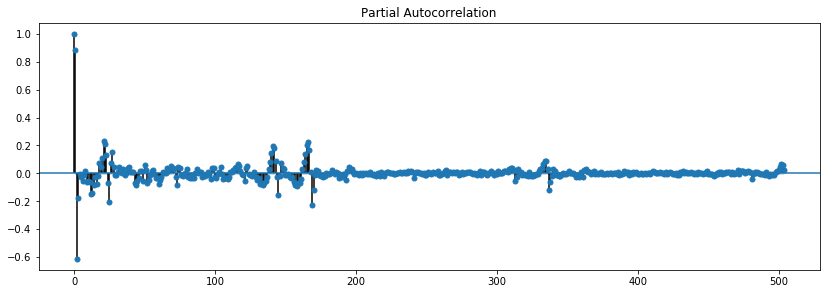

In [34]:
show_acf_pacf(resid_2, 24 * 7 * 3)

### Подбор параметров 3-го кластера


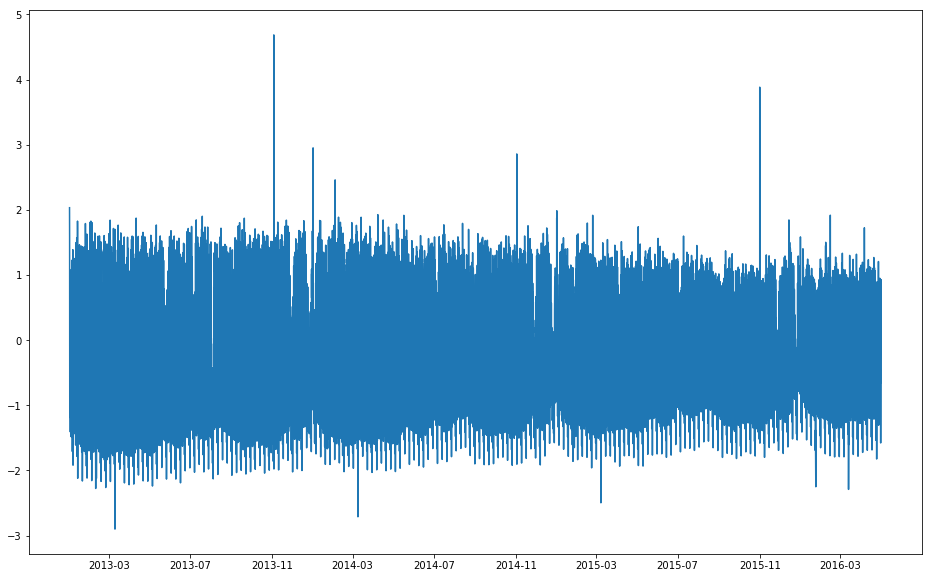

cluster_2 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + sin_week_5 + sin_week_6 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + cos_week_5 + cos_week_6 + sin_year_1 + sin_year_10 + sin_year_2 + sin_year_3 + sin_year_4 + sin_year_5 + sin_year_6 + sin_year_7 + sin_year_8 + sin_year_9 + cos_year_1 + cos_year_10 + cos_year_2 + cos_year_3 + cos_year_4 + cos_year_5 + cos_year_6 + cos_year_7 + cos_year_8 + cos_year_9 + Trend
                            OLS Regression Results                            
Dep. Variable:              cluster_2   R-squared:                       0.169
Model:                            OLS   Adj. R-squared:                  0.168
Method:                 Least Squares   F-statistic:                     179.6
Date:                Thu, 30 Nov 2017   Prob (F-statistic):               0.00
Time:                        22:29:53   Log-Likelihood:                -36127.
No. Observations:               29184   AIC:                         7.232e+04
Df Residual

In [35]:
resid_3, attr_3 = set_attributes(t_series.cluster_2, 6, 10)

Критерий Дики-Фуллера 0.00000000


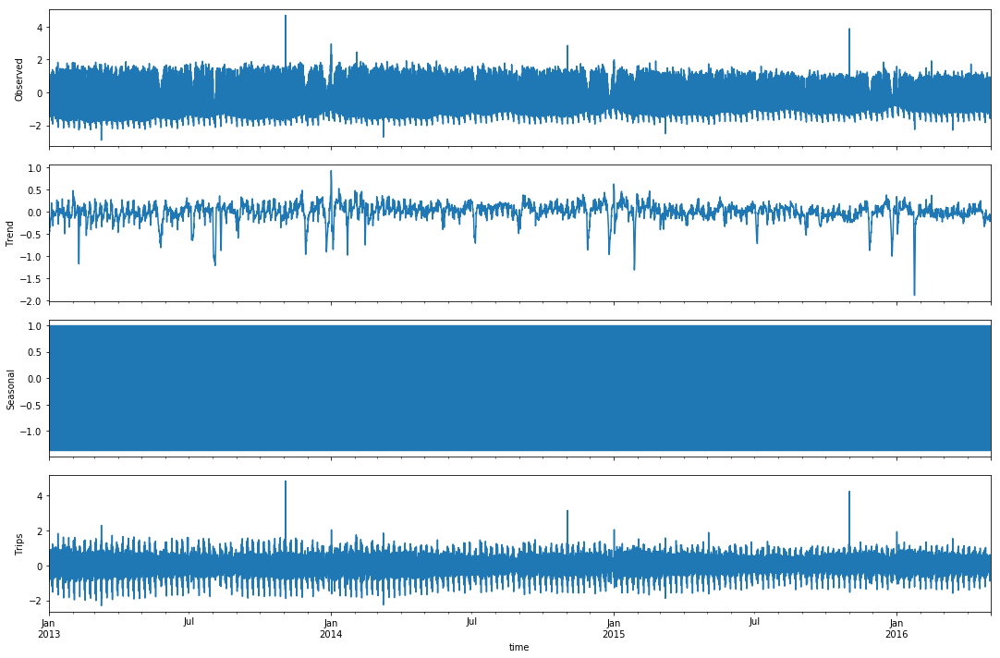

In [36]:
s_dec = resid_seasonal_decompose(resid_3)

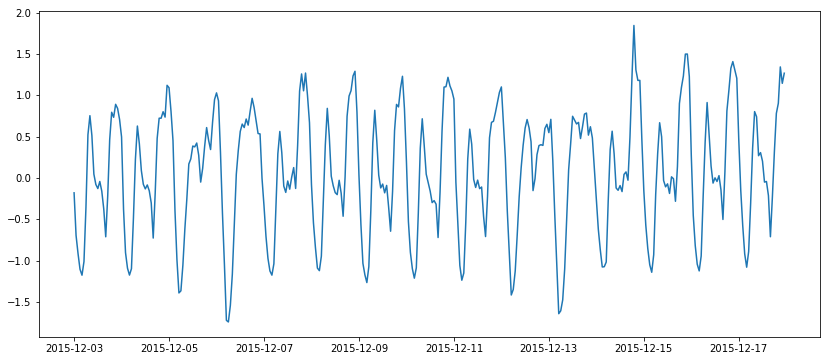

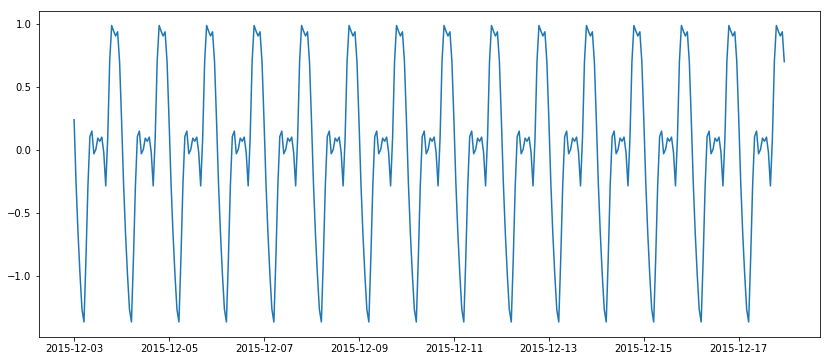

In [37]:
show_random_interval(s_dec)

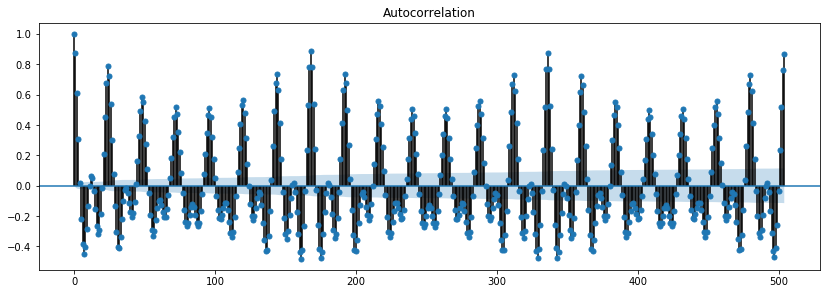

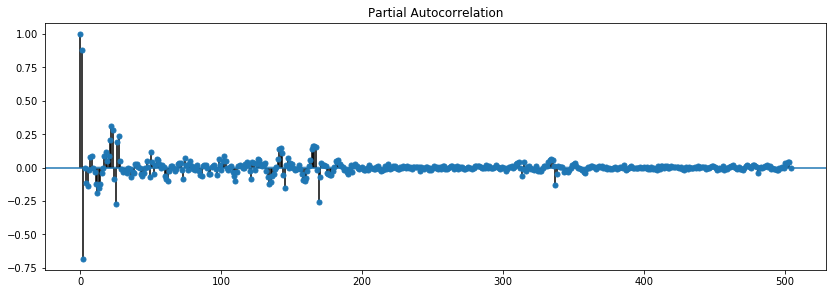

In [38]:
show_acf_pacf(resid_3, 24 * 7 * 3)

### Подбор параметров 4-го кластера


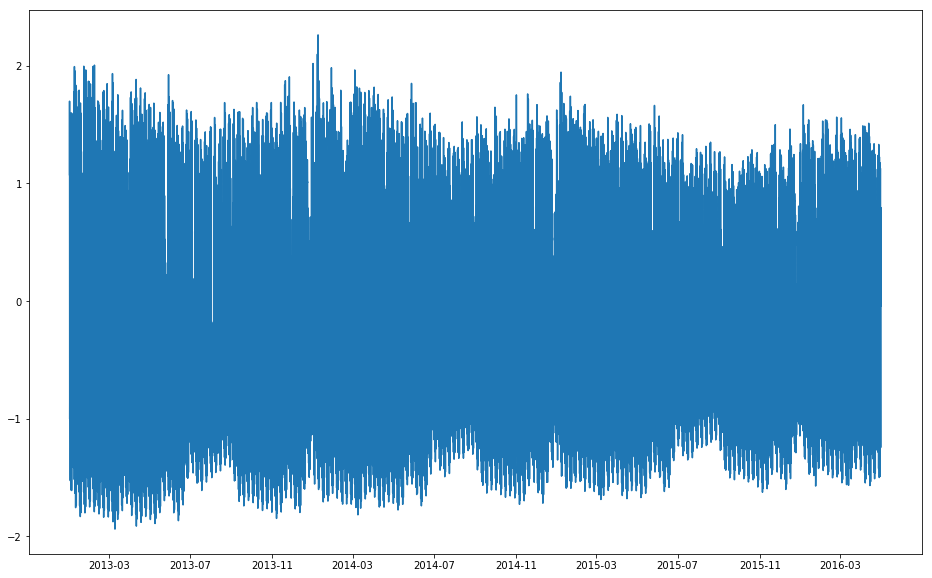

cluster_3 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + sin_week_5 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + cos_week_5 + sin_year_1 + sin_year_10 + sin_year_11 + sin_year_12 + sin_year_2 + sin_year_3 + sin_year_4 + sin_year_5 + sin_year_6 + sin_year_7 + sin_year_8 + sin_year_9 + cos_year_1 + cos_year_10 + cos_year_11 + cos_year_12 + cos_year_2 + cos_year_3 + cos_year_4 + cos_year_5 + cos_year_6 + cos_year_7 + cos_year_8 + cos_year_9 + Trend
                            OLS Regression Results                            
Dep. Variable:              cluster_3   R-squared:                       0.053
Model:                            OLS   Adj. R-squared:                  0.052
Method:                 Least Squares   F-statistic:                     46.55
Date:                Thu, 30 Nov 2017   Prob (F-statistic):          3.17e-311
Time:                        22:30:10   Log-Likelihood:                -37274.
No. Observations:               29184   AIC:                

In [39]:
resid_4, attr_4 = set_attributes(t_series.cluster_3, 5, 12)

In [40]:
resid_orig = resid_4

In [41]:
resid_4 = resid_4 - resid_4.shift(24)

Критерий Дики-Фуллера 0.00000000


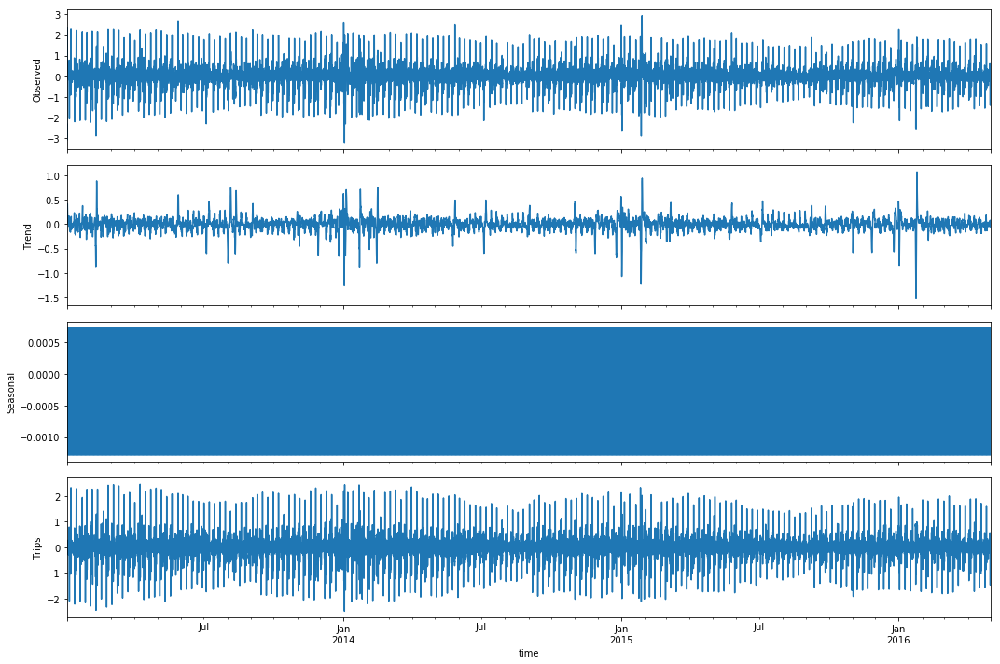

In [42]:
s_dec = resid_seasonal_decompose(resid_4)

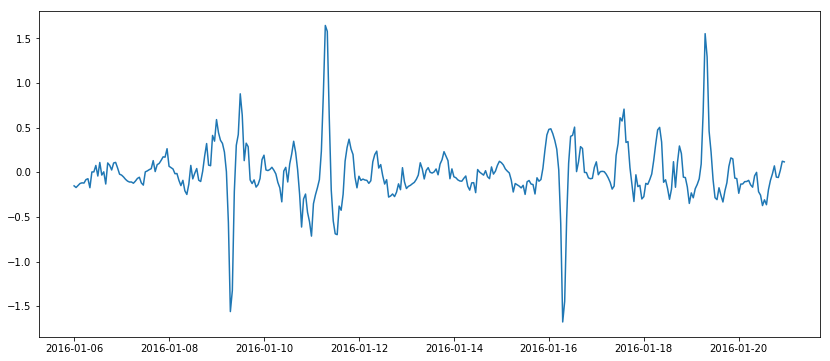

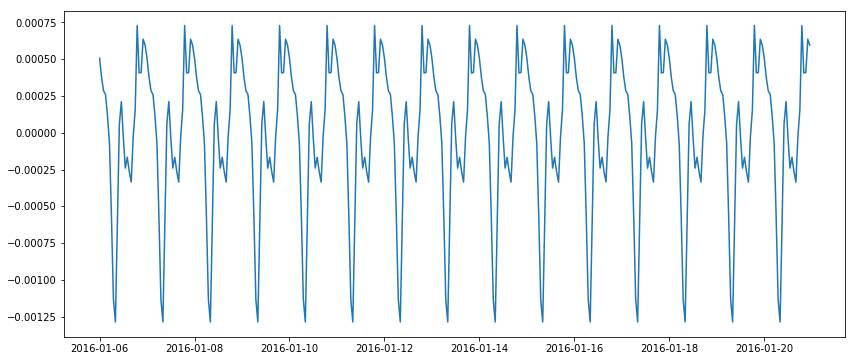

In [43]:
show_random_interval(s_dec)

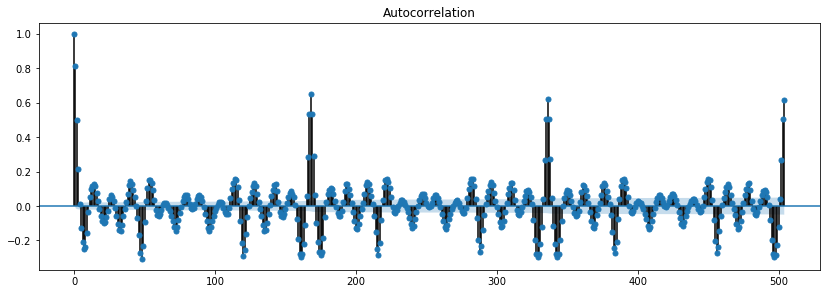

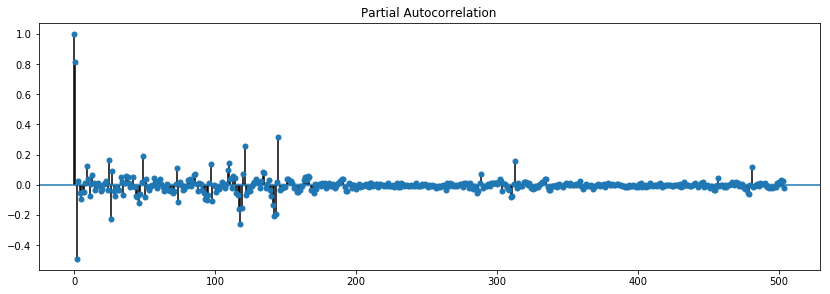

In [44]:
show_acf_pacf(resid_4, 24 * 7 * 3)

### Подбор параметров 5-го кластера


/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:652: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  return safe_is_pandas_categorical_dtype(data.dtype)
/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:679: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  if safe_is_pandas_categorical_dtype(dt1):


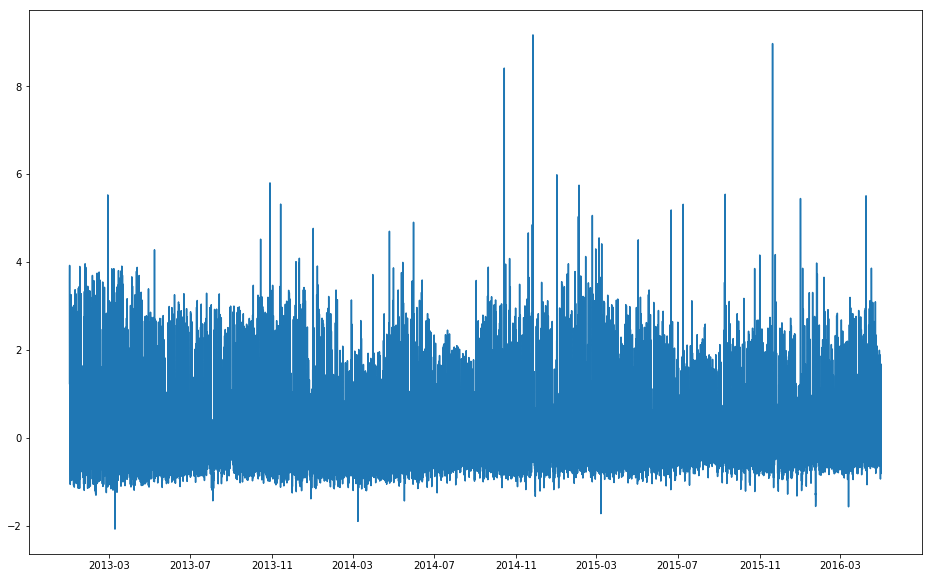

cluster_4 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + sin_week_5 + sin_week_6 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + cos_week_5 + cos_week_6 + sin_year_1 + sin_year_2 + sin_year_3 + sin_year_4 + sin_year_5 + sin_year_6 + sin_year_7 + sin_year_8 + sin_year_9 + cos_year_1 + cos_year_2 + cos_year_3 + cos_year_4 + cos_year_5 + cos_year_6 + cos_year_7 + cos_year_8 + cos_year_9 + Trend
                            OLS Regression Results                            
Dep. Variable:              cluster_4   R-squared:                       0.092
Model:                            OLS   Adj. R-squared:                  0.091
Method:                 Least Squares   F-statistic:                     95.12
Date:                Fri, 01 Dec 2017   Prob (F-statistic):               0.00
Time:                        17:10:22   Log-Likelihood:                -36823.
No. Observations:               29184   AIC:                         7.371e+04
Df Residuals:                   29152  

In [110]:
resid_5, attr_5 = set_attributes(t_series.cluster_4, 6, 9)

In [112]:
resid_5 = resid_5 - resid_5.shift(24)

Критерий Дики-Фуллера 0.00000000


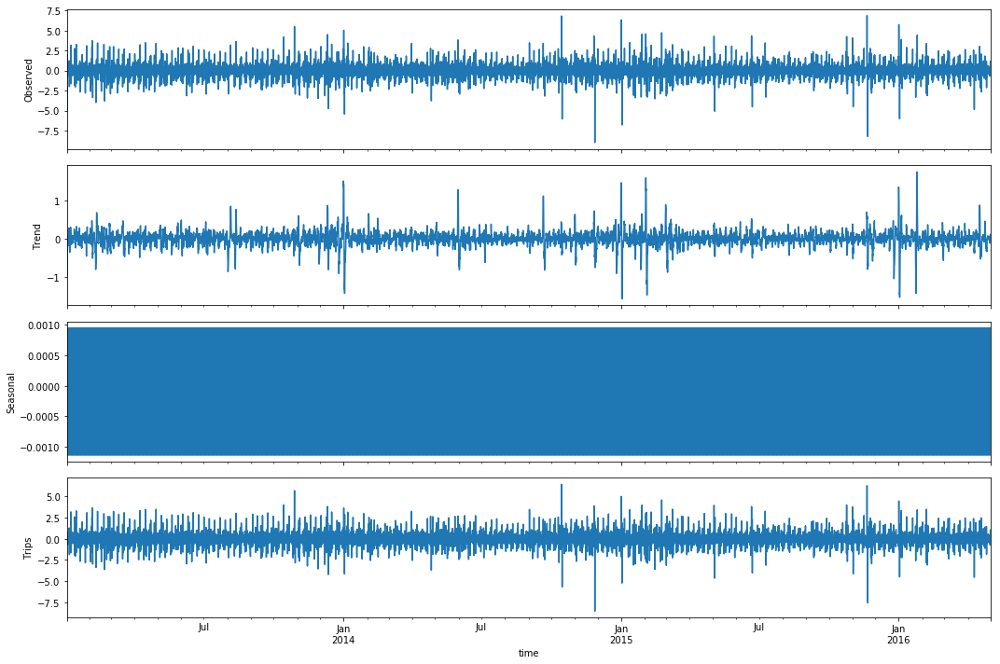

In [113]:
s_dec = resid_seasonal_decompose(resid_5)

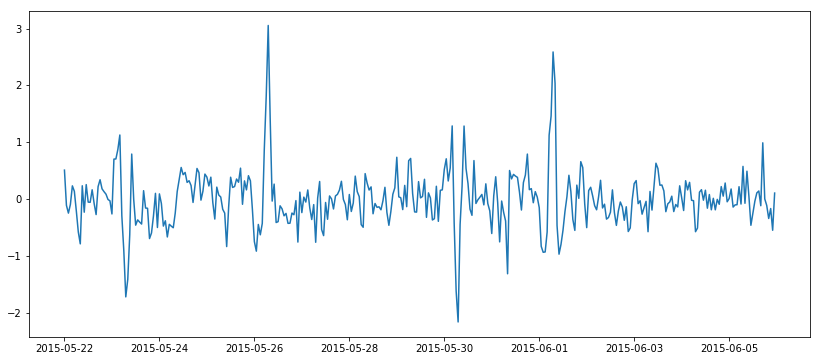

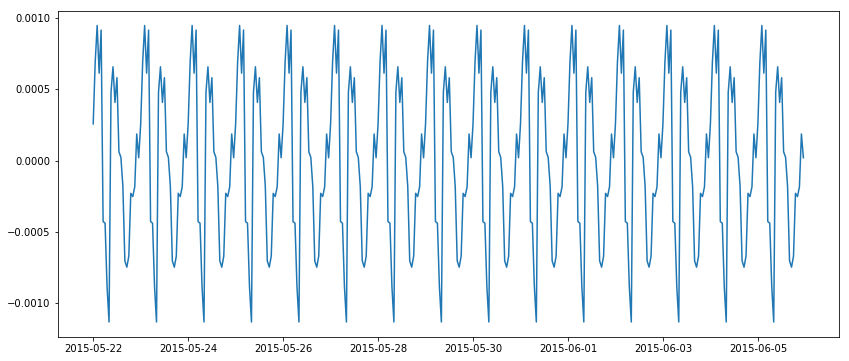

In [116]:
show_random_interval(s_dec)

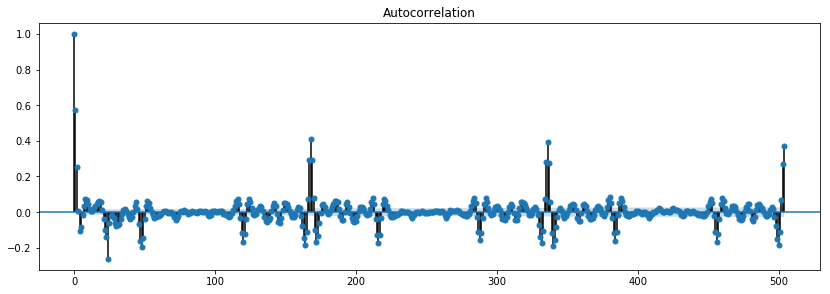

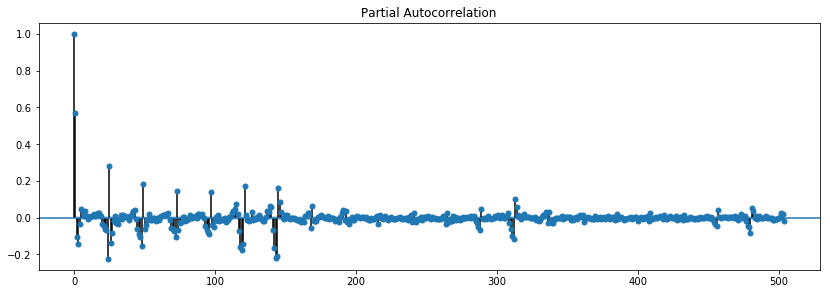

In [117]:
show_acf_pacf(resid_5, 24 * 7 * 3)

### Подбор параметров 6-го кластера


/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:652: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  return safe_is_pandas_categorical_dtype(data.dtype)
/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:679: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  if safe_is_pandas_categorical_dtype(dt1):


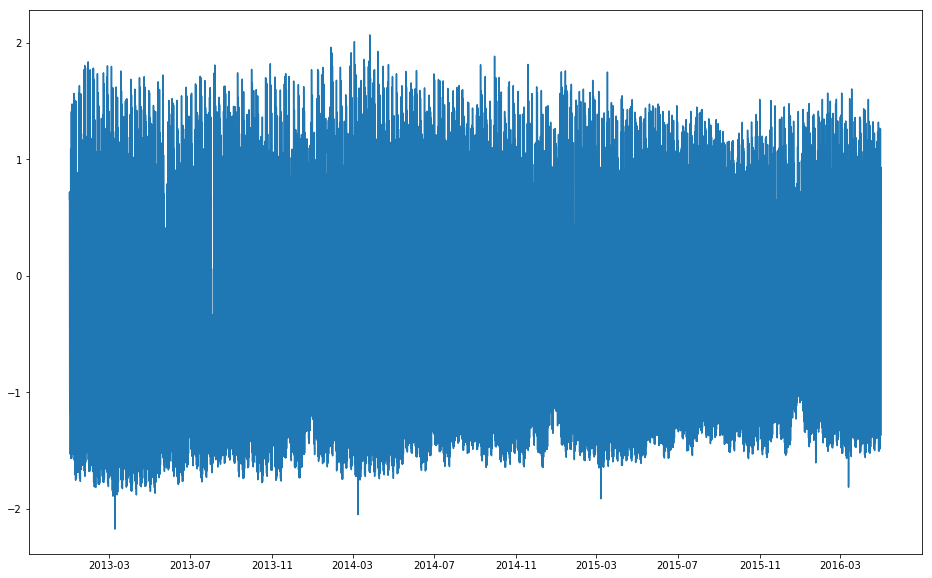

cluster_5 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + sin_week_5 + sin_week_6 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + cos_week_5 + cos_week_6 + sin_year_1 + sin_year_10 + sin_year_11 + sin_year_12 + sin_year_13 + sin_year_2 + sin_year_3 + sin_year_4 + sin_year_5 + sin_year_6 + sin_year_7 + sin_year_8 + sin_year_9 + cos_year_1 + cos_year_10 + cos_year_11 + cos_year_12 + cos_year_13 + cos_year_2 + cos_year_3 + cos_year_4 + cos_year_5 + cos_year_6 + cos_year_7 + cos_year_8 + cos_year_9 + Trend
                            OLS Regression Results                            
Dep. Variable:              cluster_5   R-squared:                       0.093
Model:                            OLS   Adj. R-squared:                  0.092
Method:                 Least Squares   F-statistic:                     76.41
Date:                Sat, 02 Dec 2017   Prob (F-statistic):               0.00
Time:                        18:53:17   Log-Likelihood:                -37561.
No. Ob

In [181]:
resid_6, attr_6 = set_attributes(t_series.cluster_5, 6, 13)

In [182]:
resid_6 = resid_6 - resid_6.shift(24)

Критерий Дики-Фуллера 0.00000000


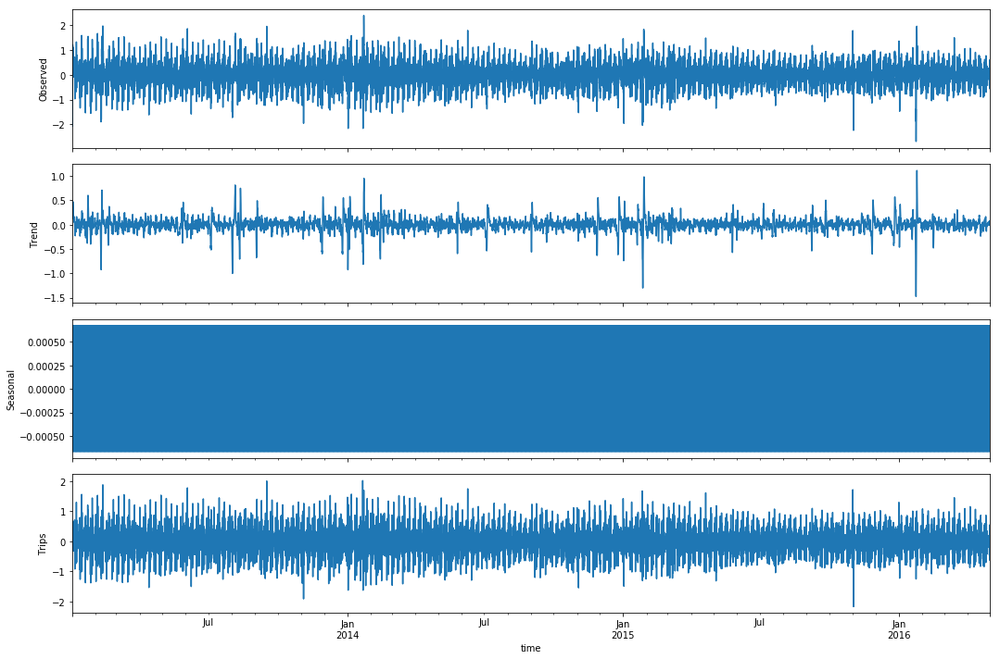

In [183]:
s_dec = resid_seasonal_decompose(resid_6)

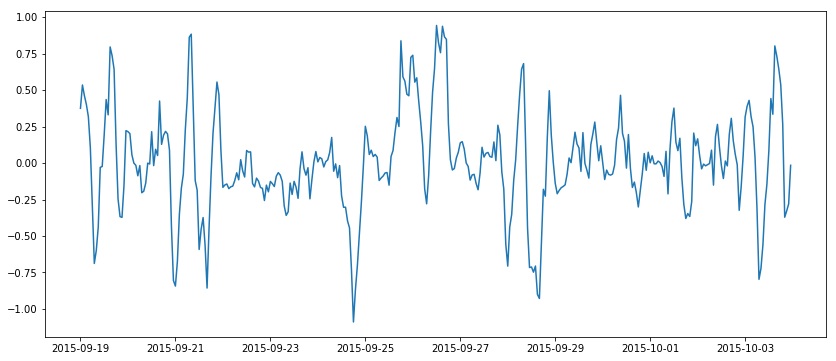

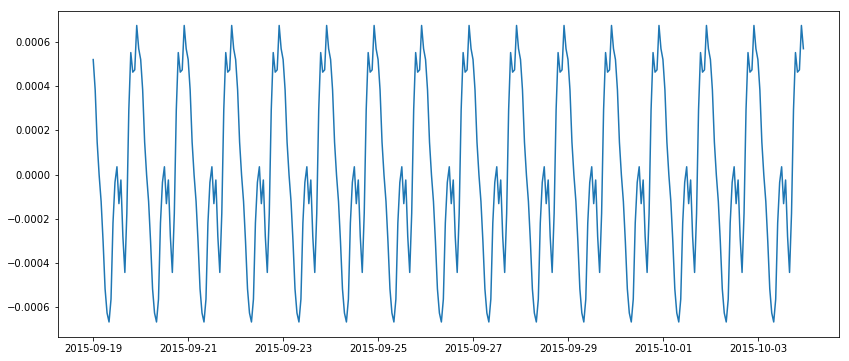

In [184]:
show_random_interval(s_dec)

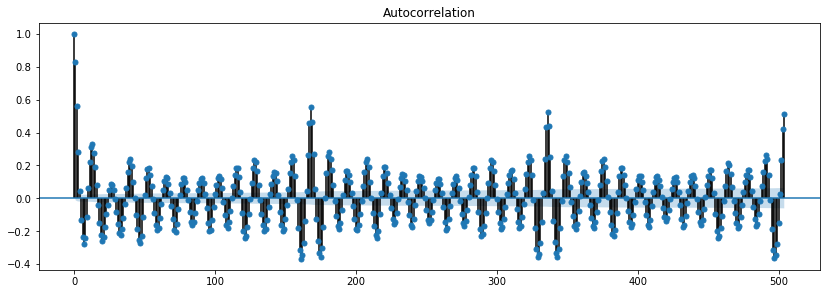

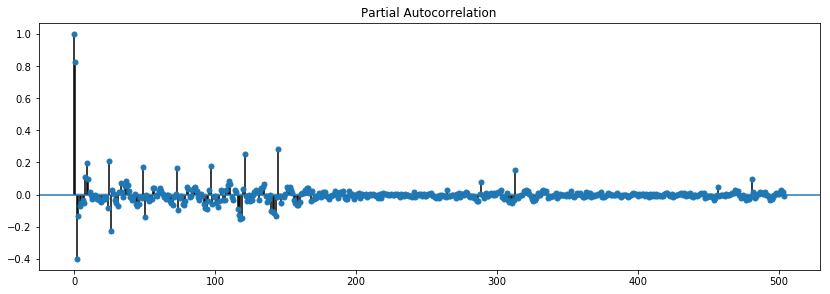

In [185]:
show_acf_pacf(resid_6, 24 * 7 * 3)

### Подбор параметров 7-го кластера


/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:652: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  return safe_is_pandas_categorical_dtype(data.dtype)
/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:679: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  if safe_is_pandas_categorical_dtype(dt1):


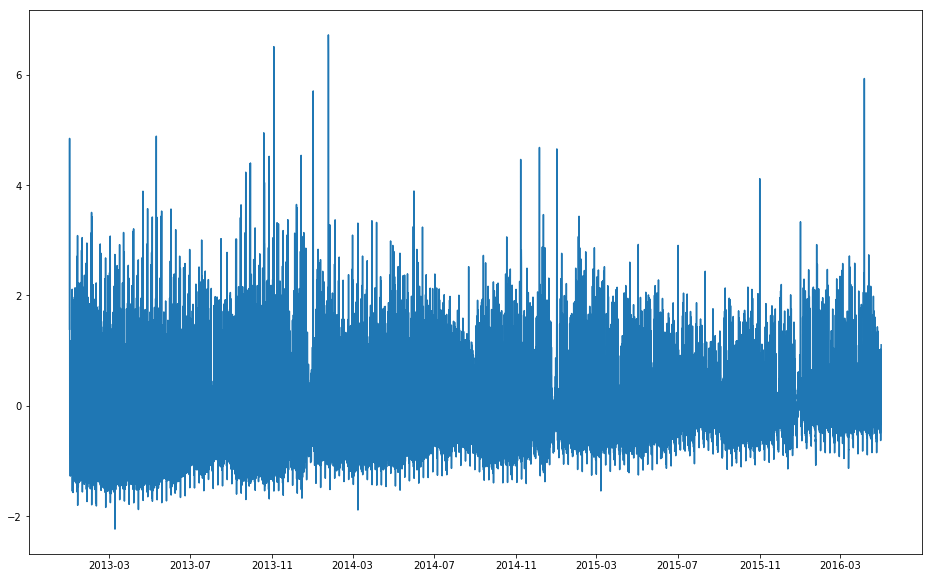

cluster_6 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + sin_week_5 + sin_week_6 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + cos_week_5 + cos_week_6 + sin_year_1 + sin_year_10 + sin_year_11 + sin_year_12 + sin_year_13 + sin_year_14 + sin_year_15 + sin_year_2 + sin_year_3 + sin_year_4 + sin_year_5 + sin_year_6 + sin_year_7 + sin_year_8 + sin_year_9 + cos_year_1 + cos_year_10 + cos_year_11 + cos_year_12 + cos_year_13 + cos_year_14 + cos_year_15 + cos_year_2 + cos_year_3 + cos_year_4 + cos_year_5 + cos_year_6 + cos_year_7 + cos_year_8 + cos_year_9 + Trend
                            OLS Regression Results                            
Dep. Variable:              cluster_6   R-squared:                       0.221
Model:                            OLS   Adj. R-squared:                  0.220
Method:                 Least Squares   F-statistic:                     192.3
Date:                Mon, 04 Dec 2017   Prob (F-statistic):               0.00
Time:                        

In [207]:
resid_7, attr_7 = set_attributes(t_series.cluster_6, 6, 15)

In [209]:
resid_7 = resid_7 - resid_7.shift(24)

Критерий Дики-Фуллера 0.00000000


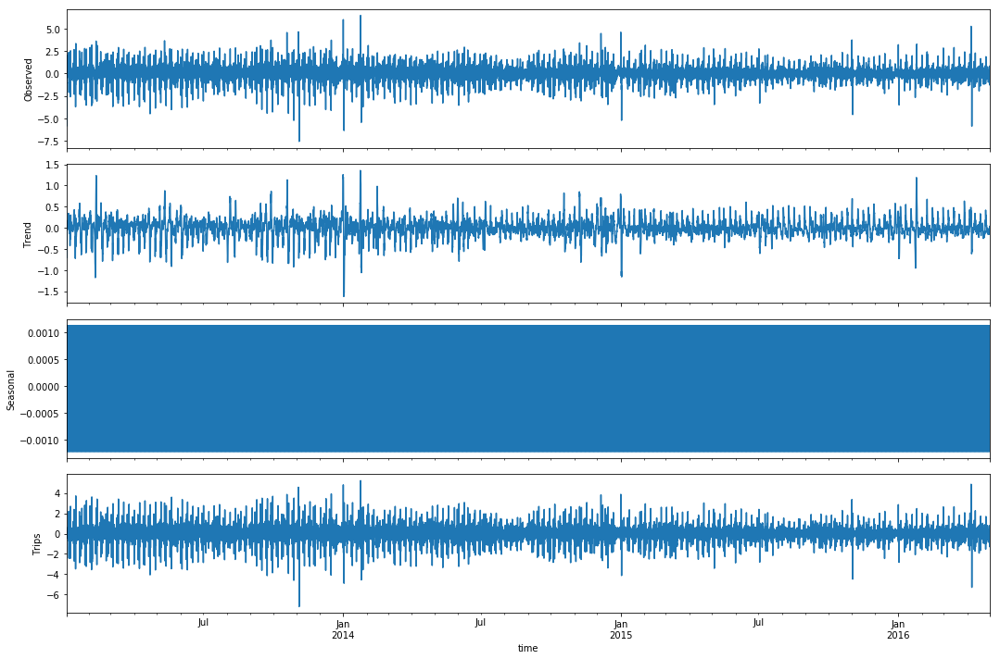

In [210]:
s_dec = resid_seasonal_decompose(resid_7)

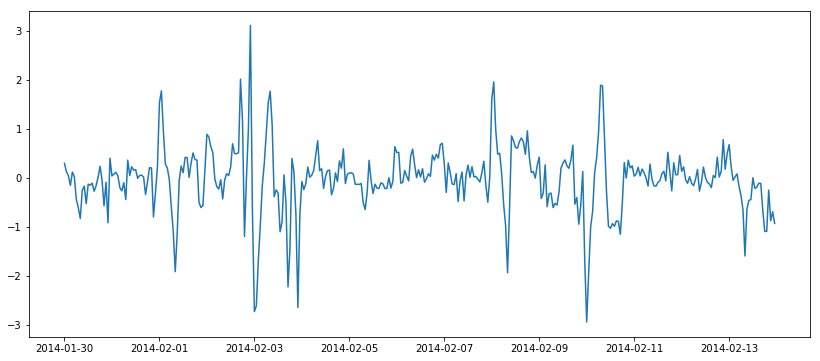

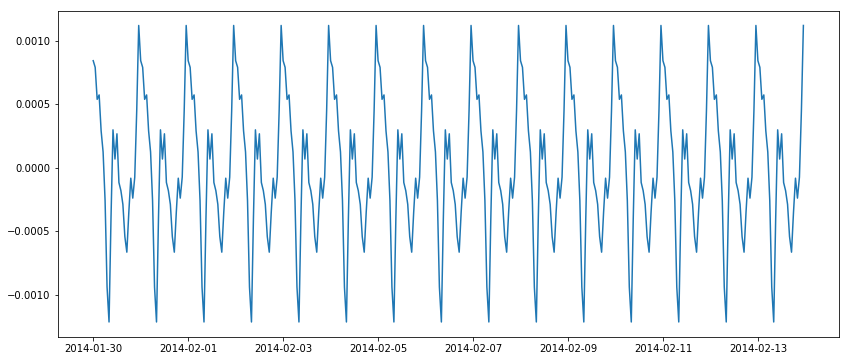

In [212]:
show_random_interval(s_dec)

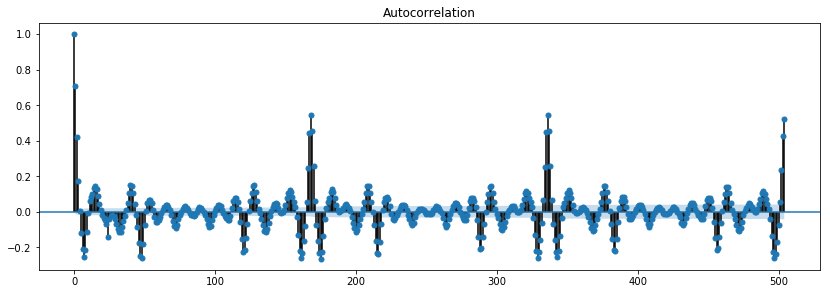

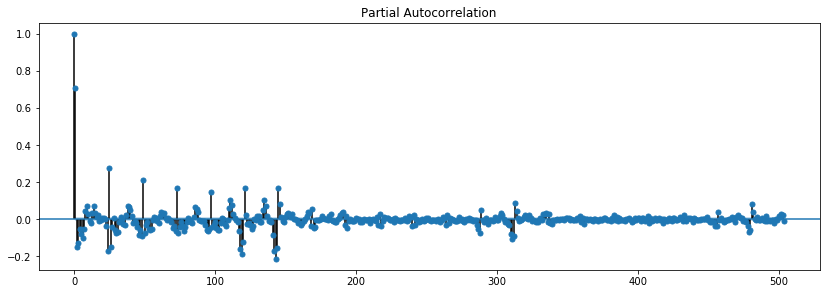

In [213]:
show_acf_pacf(resid_7, 24 * 7 * 3)

### Подбор параметров 8-го кластера


/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:652: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  return safe_is_pandas_categorical_dtype(data.dtype)
/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:679: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  if safe_is_pandas_categorical_dtype(dt1):


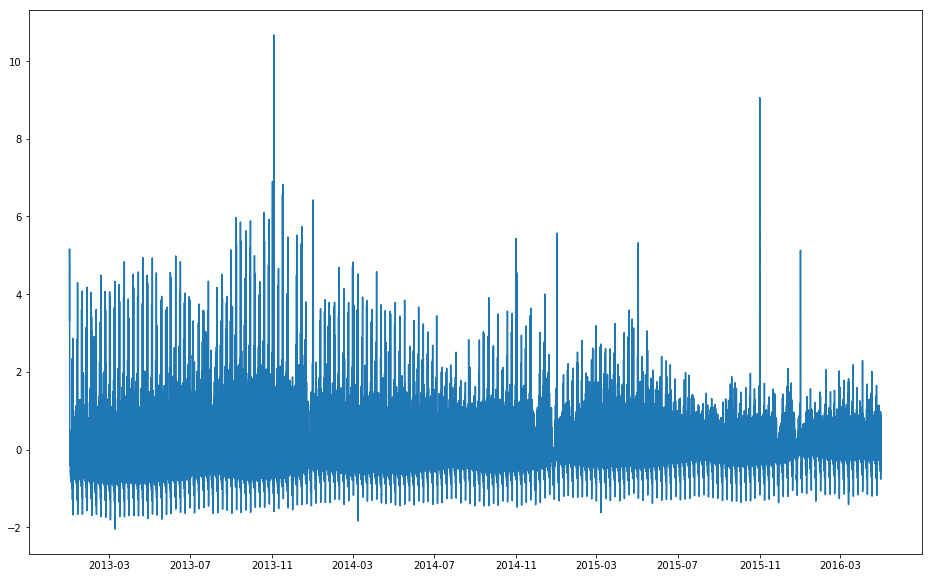

cluster_7 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + sin_week_5 + sin_week_6 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + cos_week_5 + cos_week_6 + sin_year_1 + sin_year_2 + sin_year_3 + sin_year_4 + sin_year_5 + cos_year_1 + cos_year_2 + cos_year_3 + cos_year_4 + cos_year_5 + Trend
                            OLS Regression Results                            
Dep. Variable:              cluster_7   R-squared:                       0.221
Model:                            OLS   Adj. R-squared:                  0.220
Method:                 Least Squares   F-statistic:                     359.2
Date:                Tue, 05 Dec 2017   Prob (F-statistic):               0.00
Time:                        04:54:22   Log-Likelihood:                -36593.
No. Observations:               29184   AIC:                         7.323e+04
Df Residuals:                   29160   BIC:                         7.343e+04
Df Model:                          23                           

In [228]:
resid_8, attr_8 = set_attributes(t_series.cluster_7, 6, 5)

In [230]:
resid_8 = resid_8 - resid_8.shift(24)

Критерий Дики-Фуллера 0.00000000


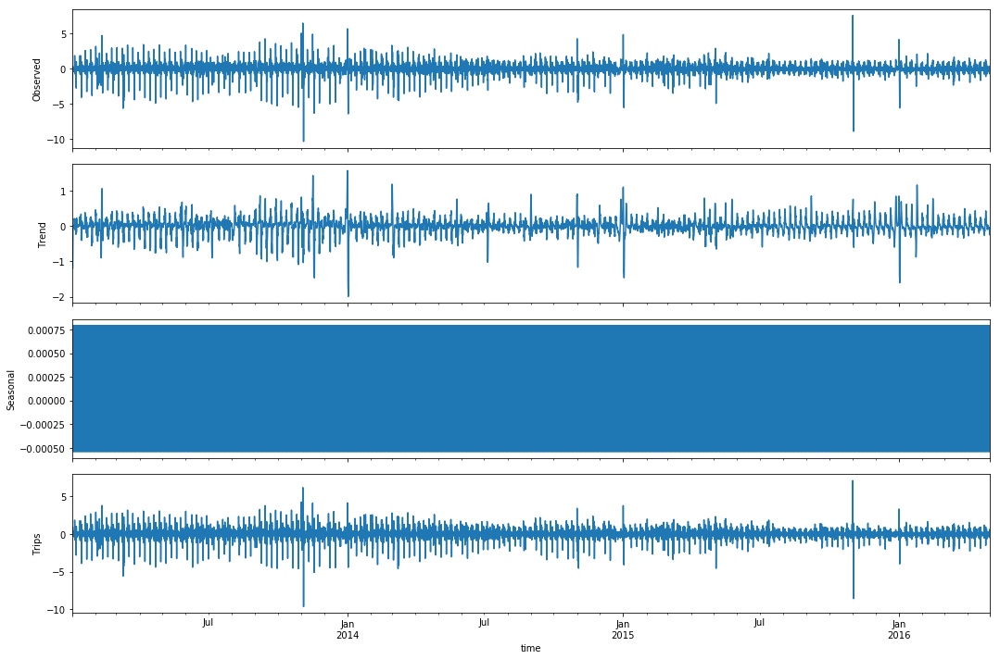

In [231]:
s_dec = resid_seasonal_decompose(resid_8)

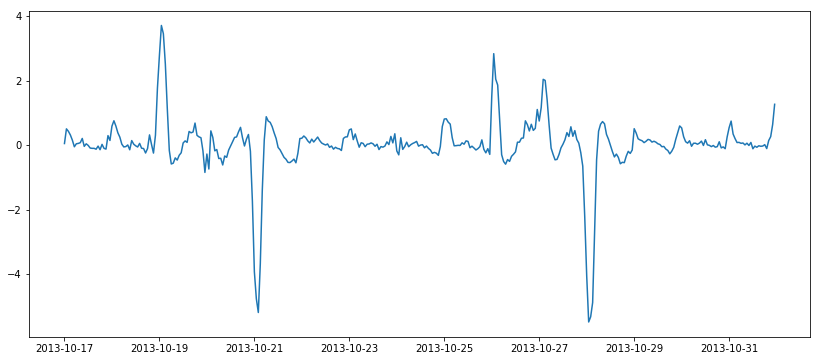

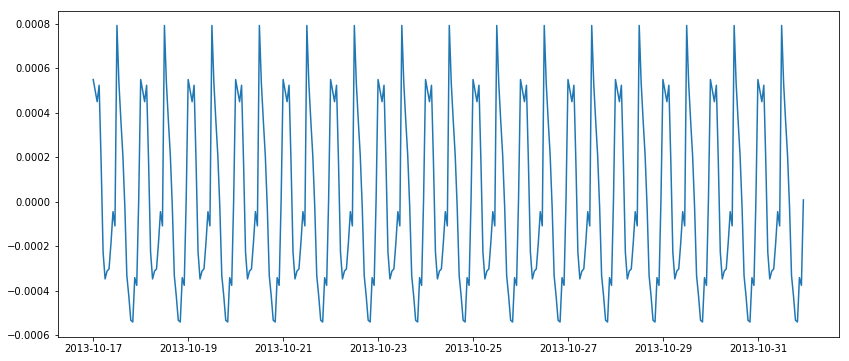

In [234]:
show_random_interval(s_dec)

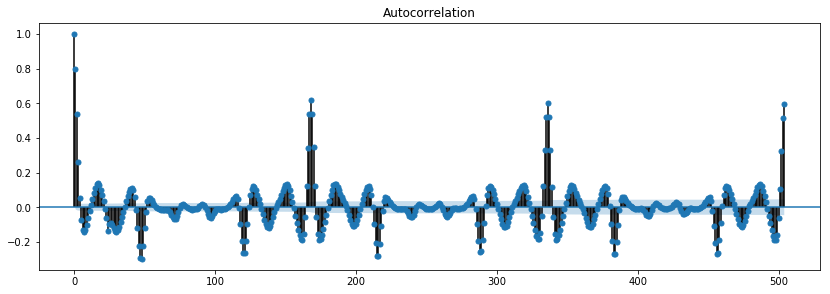

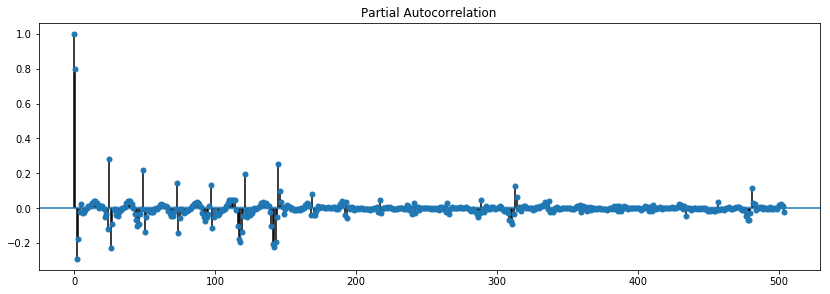

In [235]:
show_acf_pacf(resid_8, 24 * 7 * 3)

### Подбор параметров 9-го кластера


/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:652: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  return safe_is_pandas_categorical_dtype(data.dtype)
/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:679: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  if safe_is_pandas_categorical_dtype(dt1):


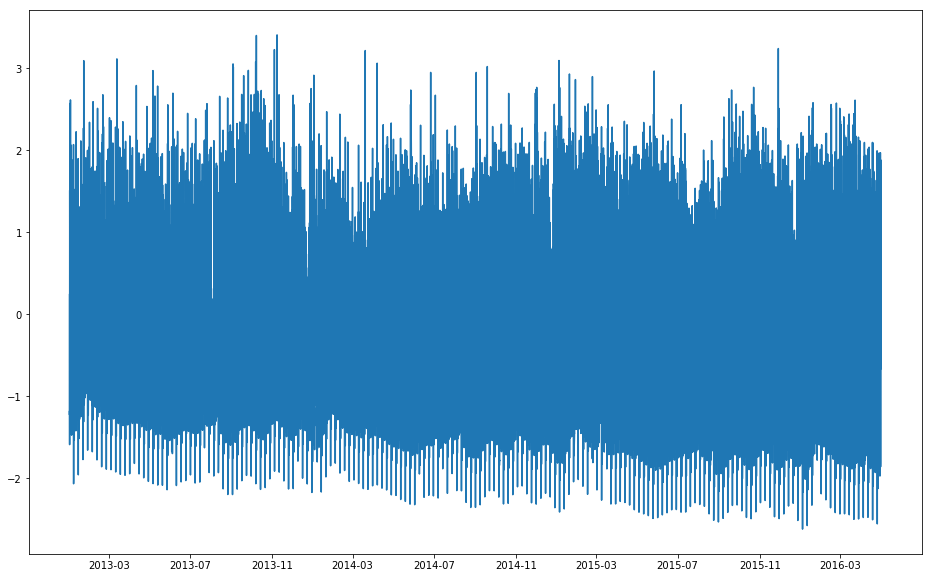

cluster_8 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + sin_year_1 + sin_year_10 + sin_year_2 + sin_year_3 + sin_year_4 + sin_year_5 + sin_year_6 + sin_year_7 + sin_year_8 + sin_year_9 + cos_year_1 + cos_year_10 + cos_year_2 + cos_year_3 + cos_year_4 + cos_year_5 + cos_year_6 + cos_year_7 + cos_year_8 + cos_year_9 + Trend
                            OLS Regression Results                            
Dep. Variable:              cluster_8   R-squared:                       0.105
Model:                            OLS   Adj. R-squared:                  0.105
Method:                 Least Squares   F-statistic:                     118.5
Date:                Tue, 05 Dec 2017   Prob (F-statistic):               0.00
Time:                        05:04:04   Log-Likelihood:                -39783.
No. Observations:               29184   AIC:                         7.963e+04
Df Residuals:                   29154   BIC:                   

In [268]:
resid_9, attr_9 = set_attributes(t_series.cluster_8, 4, 10)

In [269]:
resid_9 = resid_9 - resid_9.shift(24)

Критерий Дики-Фуллера 0.00000000


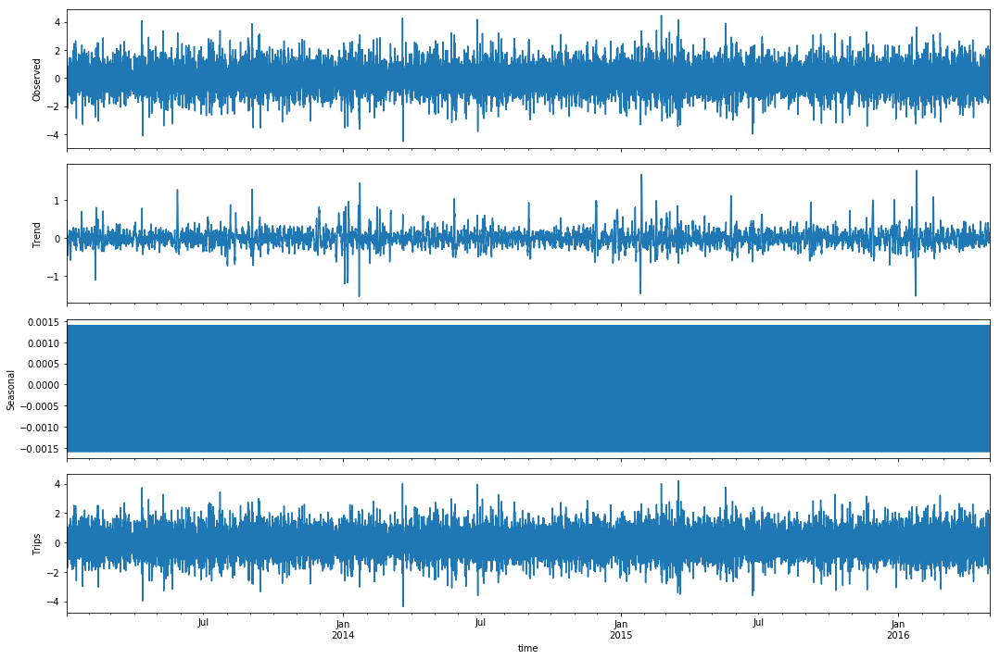

In [270]:
s_dec = resid_seasonal_decompose(resid_9)

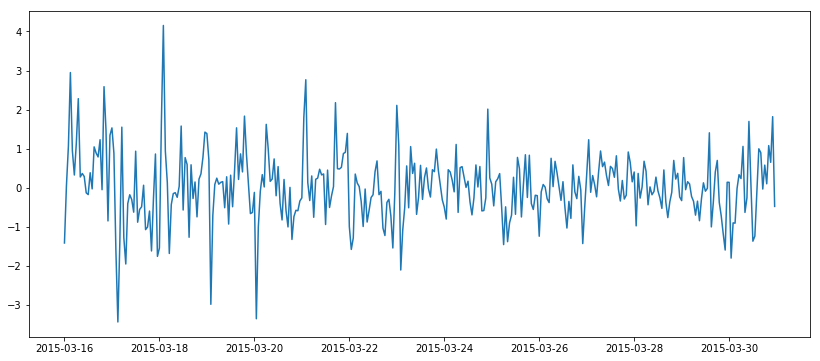

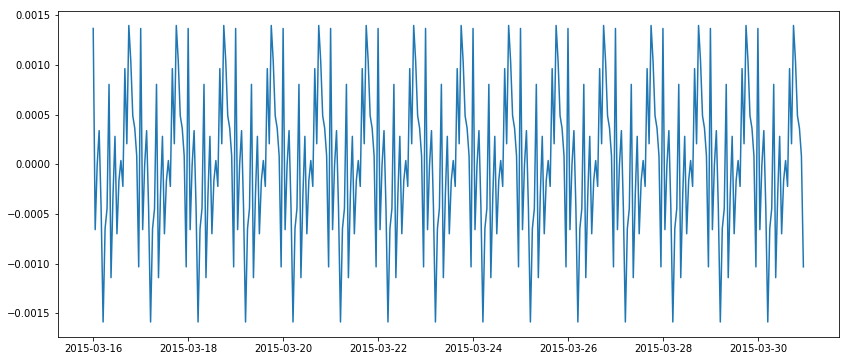

In [271]:
show_random_interval(s_dec)

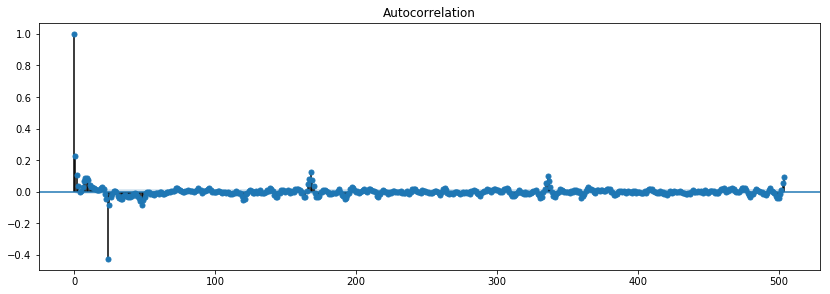

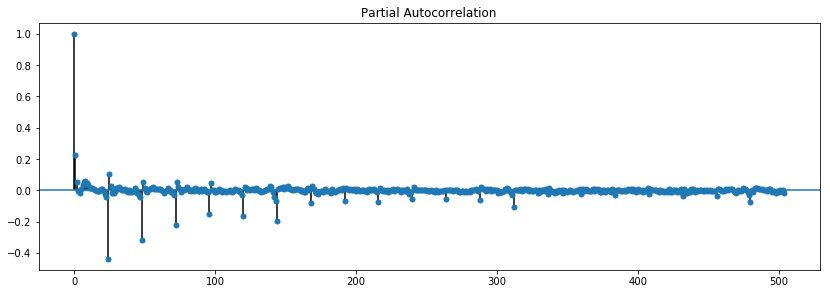

In [272]:
show_acf_pacf(resid_9, 24 * 7 * 3)

### Подбор параметров 10-го кластера


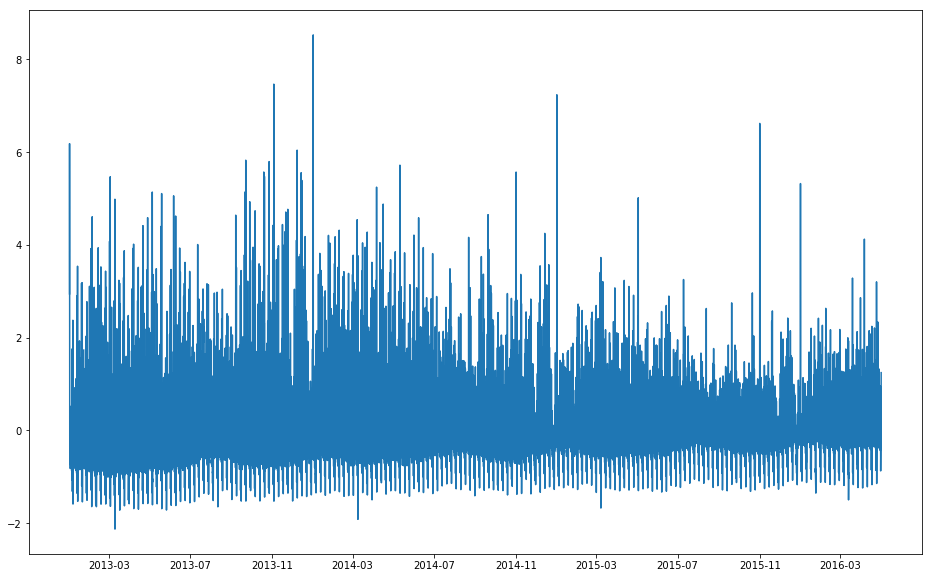

cluster_9 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + sin_week_5 + sin_week_6 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + cos_week_5 + cos_week_6 + sin_year_1 + sin_year_2 + sin_year_3 + sin_year_4 + cos_year_1 + cos_year_2 + cos_year_3 + cos_year_4 + Trend
                            OLS Regression Results                            
Dep. Variable:              cluster_9   R-squared:                       0.184
Model:                            OLS   Adj. R-squared:                  0.184
Method:                 Least Squares   F-statistic:                     313.9
Date:                Wed, 06 Dec 2017   Prob (F-statistic):               0.00
Time:                        07:40:49   Log-Likelihood:                -34996.
No. Observations:               29184   AIC:                         7.004e+04
Df Residuals:                   29162   BIC:                         7.022e+04
Df Model:                          21                                         
Covariance 

In [27]:
resid_10, attr_10 = set_attributes(t_series.cluster_9, 6, 4)

In [28]:
resid_10 = resid_10 - resid_10.shift(24)

Критерий Дики-Фуллера 0.00000000


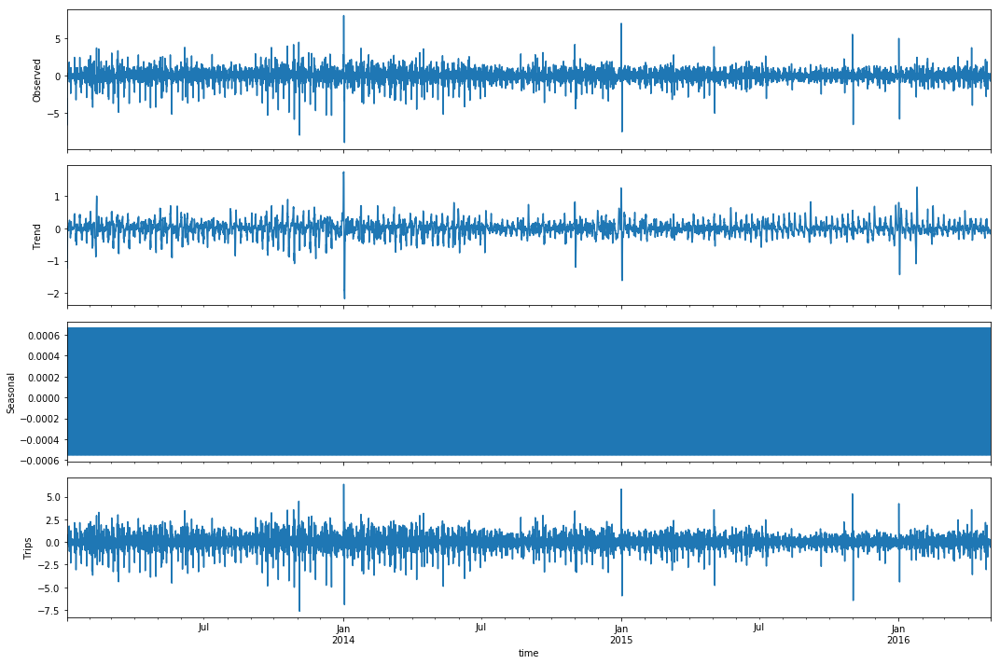

In [29]:
s_dec = resid_seasonal_decompose(resid_10)

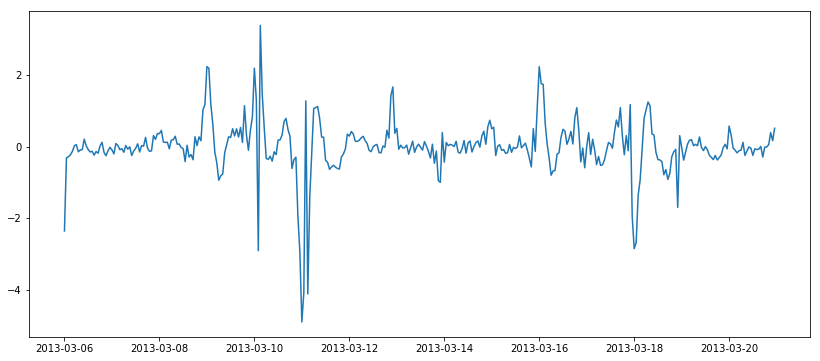

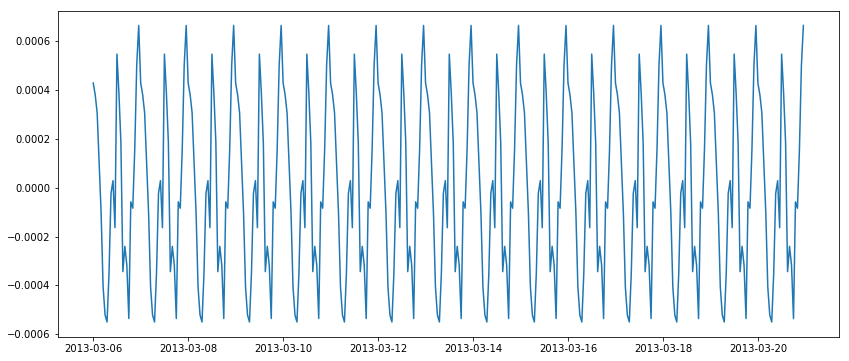

In [30]:
show_random_interval(s_dec)

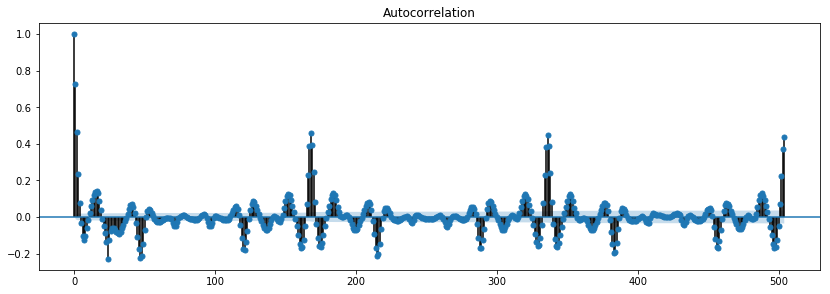

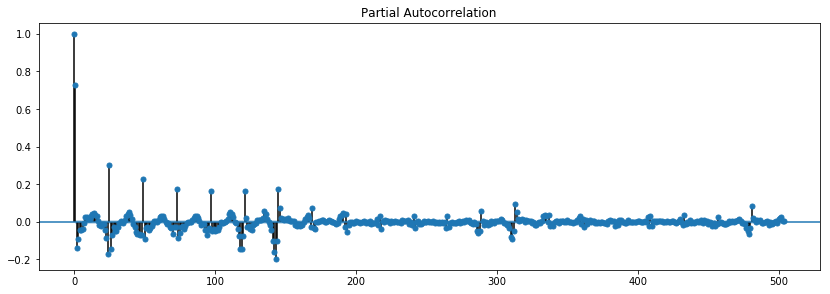

In [31]:
show_acf_pacf(resid_10, 24 * 7 * 3)

### Подбор параметров 11-го кластера



/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:652: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  return safe_is_pandas_categorical_dtype(data.dtype)
/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:679: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  if safe_is_pandas_categorical_dtype(dt1):


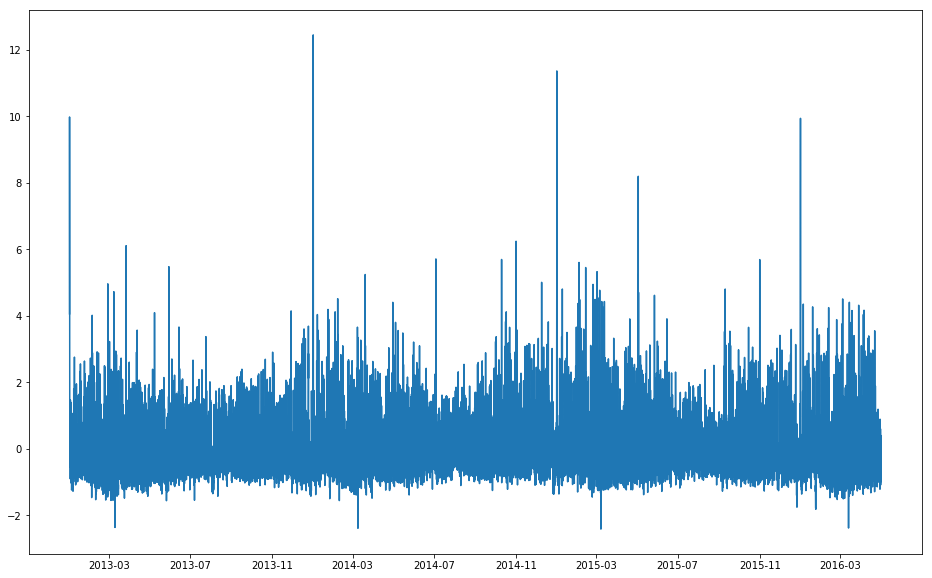

cluster_10 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + sin_year_1 + sin_year_2 + sin_year_3 + sin_year_4 + sin_year_5 + sin_year_6 + sin_year_7 + cos_year_1 + cos_year_2 + cos_year_3 + cos_year_4 + cos_year_5 + cos_year_6 + cos_year_7 + Trend
                            OLS Regression Results                            
Dep. Variable:             cluster_10   R-squared:                       0.156
Model:                            OLS   Adj. R-squared:                  0.156
Method:                 Least Squares   F-statistic:                     235.2
Date:                Wed, 06 Dec 2017   Prob (F-statistic):               0.00
Time:                        21:26:50   Log-Likelihood:                -34512.
No. Observations:               29184   AIC:                         6.907e+04
Df Residuals:                   29160   BIC:                         6.927e+04
Df Model:                          23                          

In [62]:
resid_11, attr_11 = set_attributes(t_series.cluster_10, 4, 7)

In [64]:
resid_11 = resid_11 - resid_11.shift(24)

Критерий Дики-Фуллера 0.00000000


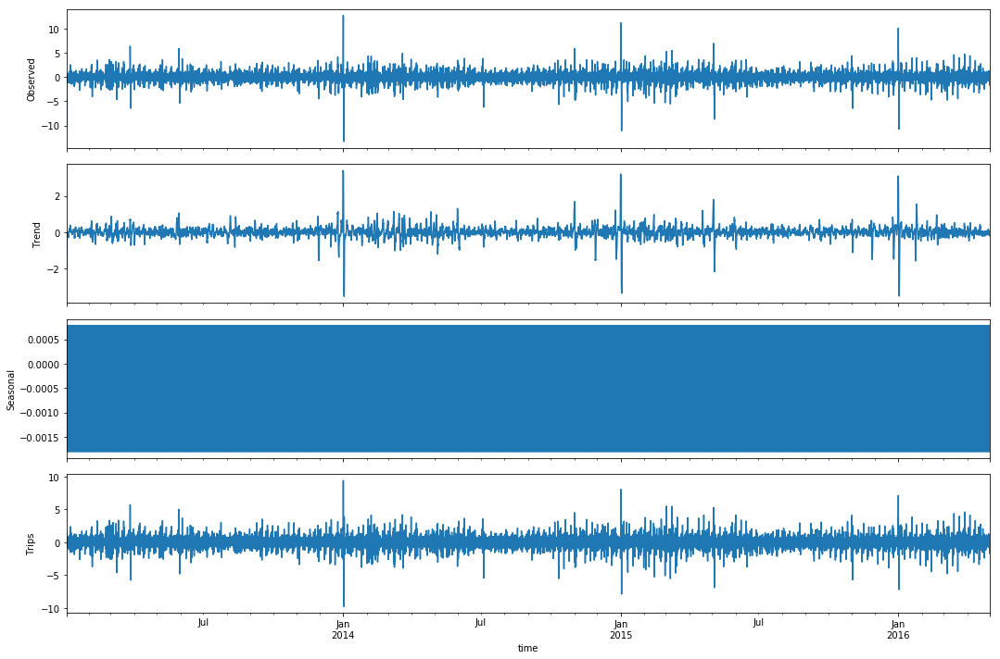

In [65]:
s_dec = resid_seasonal_decompose(resid_11)

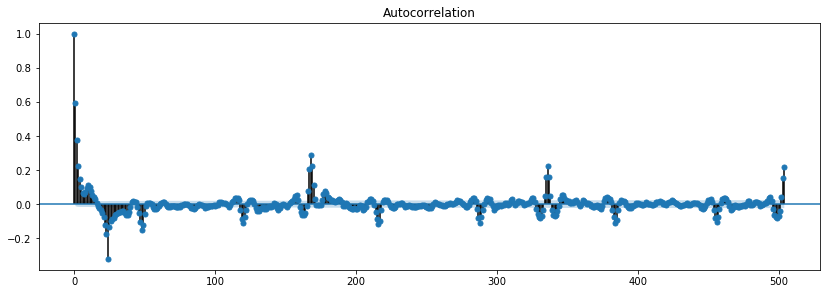

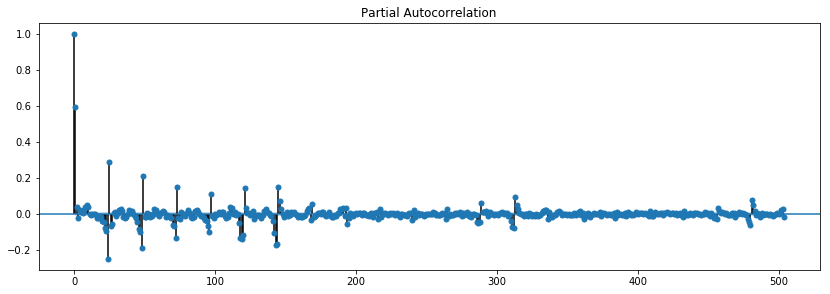

In [66]:
show_acf_pacf(resid_11, 24 * 7 * 3)

### Подбор параметров 12-го кластера



/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:652: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  return safe_is_pandas_categorical_dtype(data.dtype)
/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:679: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  if safe_is_pandas_categorical_dtype(dt1):


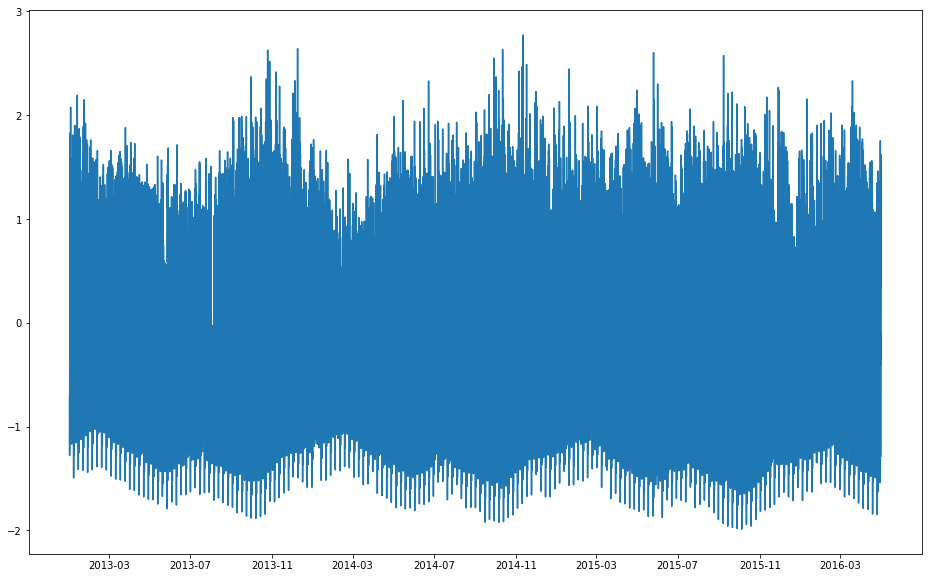

cluster_11 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + sin_week_5 + sin_week_6 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + cos_week_5 + cos_week_6 + sin_year_1 + sin_year_2 + sin_year_3 + sin_year_4 + sin_year_5 + cos_year_1 + cos_year_2 + cos_year_3 + cos_year_4 + cos_year_5 + Trend
                            OLS Regression Results                            
Dep. Variable:             cluster_11   R-squared:                       0.058
Model:                            OLS   Adj. R-squared:                  0.057
Method:                 Least Squares   F-statistic:                     77.98
Date:                Wed, 06 Dec 2017   Prob (F-statistic):               0.00
Time:                        21:30:24   Log-Likelihood:                -36599.
No. Observations:               29184   AIC:                         7.325e+04
Df Residuals:                   29160   BIC:                         7.345e+04
Df Model:                          23                          

In [77]:
resid_12, attr_12 = set_attributes(t_series.cluster_11, 6, 5)

In [79]:
resid_12 = resid_12 - resid_12.shift(24)

Критерий Дики-Фуллера 0.00000000


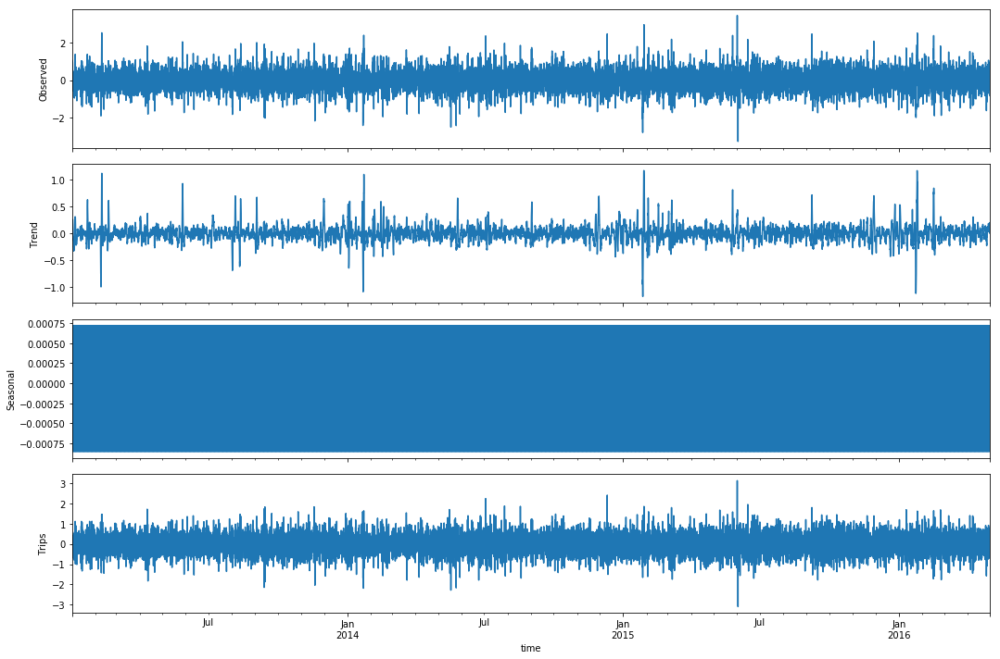

In [80]:
s_dec = resid_seasonal_decompose(resid_12)

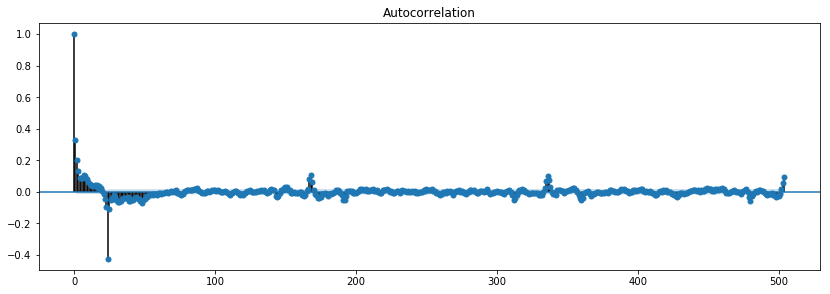

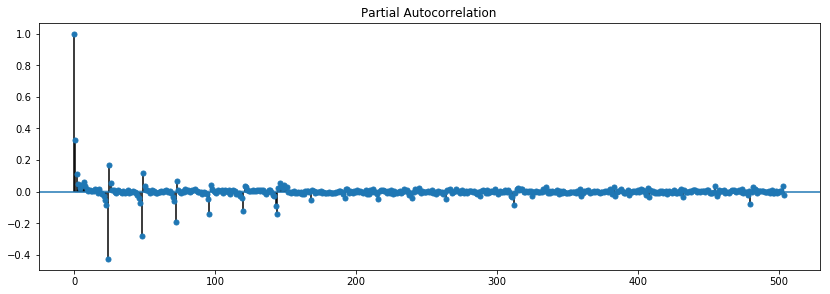

In [81]:
show_acf_pacf(resid_12, 24 * 7 * 3)

### Подбор параметров 13-го кластера



/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:652: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  return safe_is_pandas_categorical_dtype(data.dtype)
/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:679: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  if safe_is_pandas_categorical_dtype(dt1):


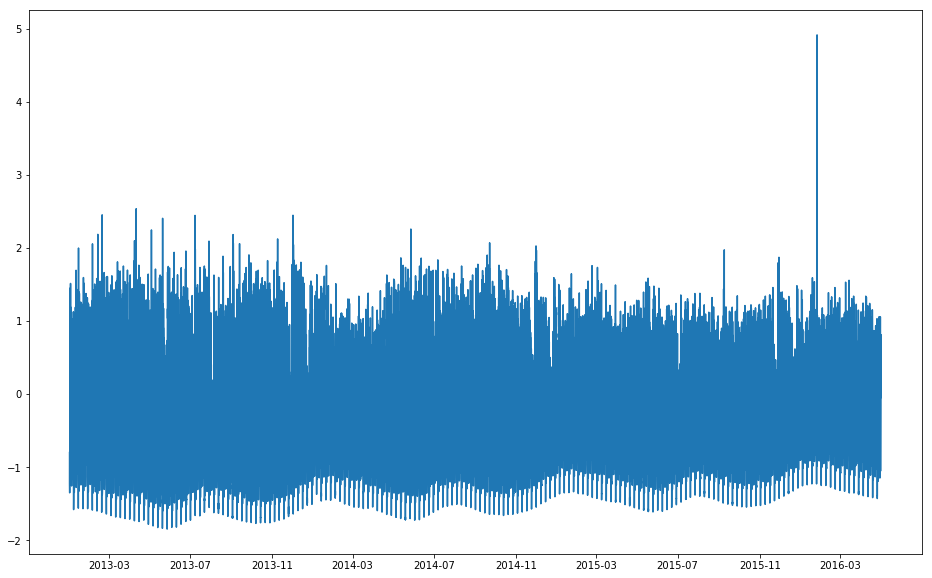

cluster_12 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + sin_week_5 + sin_week_6 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + cos_week_5 + cos_week_6 + sin_year_1 + sin_year_2 + sin_year_3 + sin_year_4 + cos_year_1 + cos_year_2 + cos_year_3 + cos_year_4 + Trend
                            OLS Regression Results                            
Dep. Variable:             cluster_12   R-squared:                       0.130
Model:                            OLS   Adj. R-squared:                  0.130
Method:                 Least Squares   F-statistic:                     207.8
Date:                Wed, 06 Dec 2017   Prob (F-statistic):               0.00
Time:                        21:33:37   Log-Likelihood:                -35159.
No. Observations:               29184   AIC:                         7.036e+04
Df Residuals:                   29162   BIC:                         7.054e+04
Df Model:                          21                                         
Covariance

In [91]:
resid_13, attr_13 = set_attributes(t_series.cluster_12, 6, 4)

In [93]:
resid_13 = resid_13 - resid_13.shift(24)

Критерий Дики-Фуллера 0.00000000


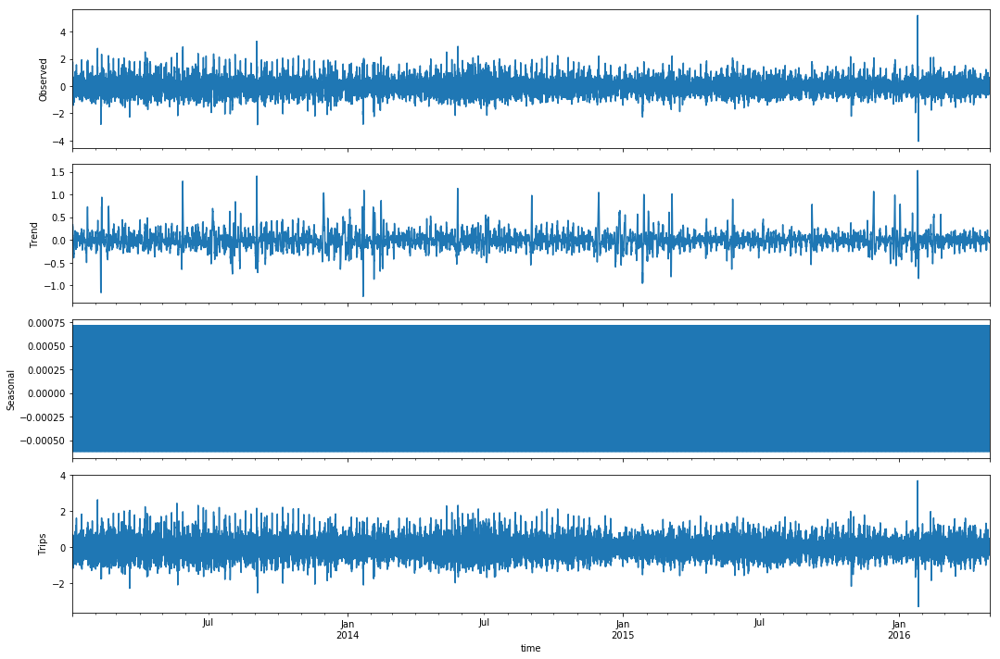

In [94]:
s_dec = resid_seasonal_decompose(resid_13)

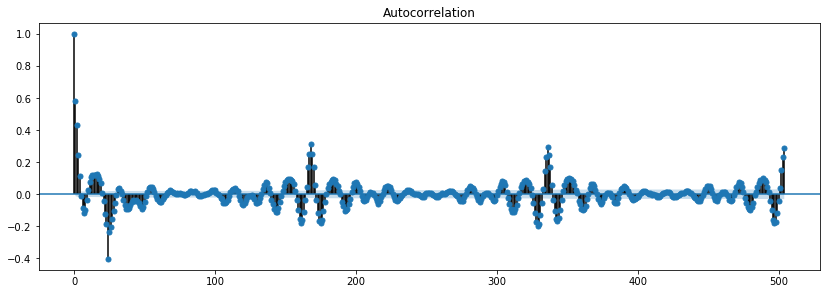

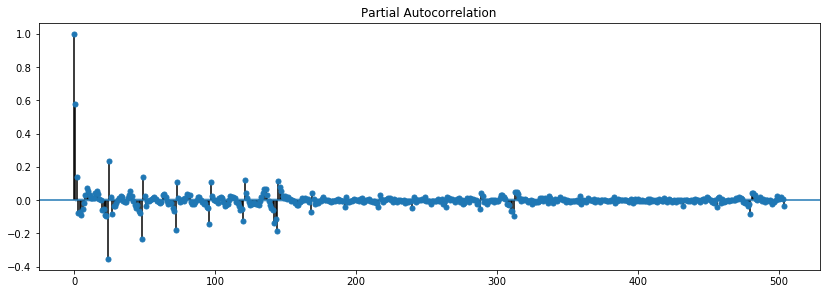

In [95]:
show_acf_pacf(resid_13, 24 * 7 * 3)

### Подбор параметров 14-го кластера



/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:652: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  return safe_is_pandas_categorical_dtype(data.dtype)
/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:679: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  if safe_is_pandas_categorical_dtype(dt1):


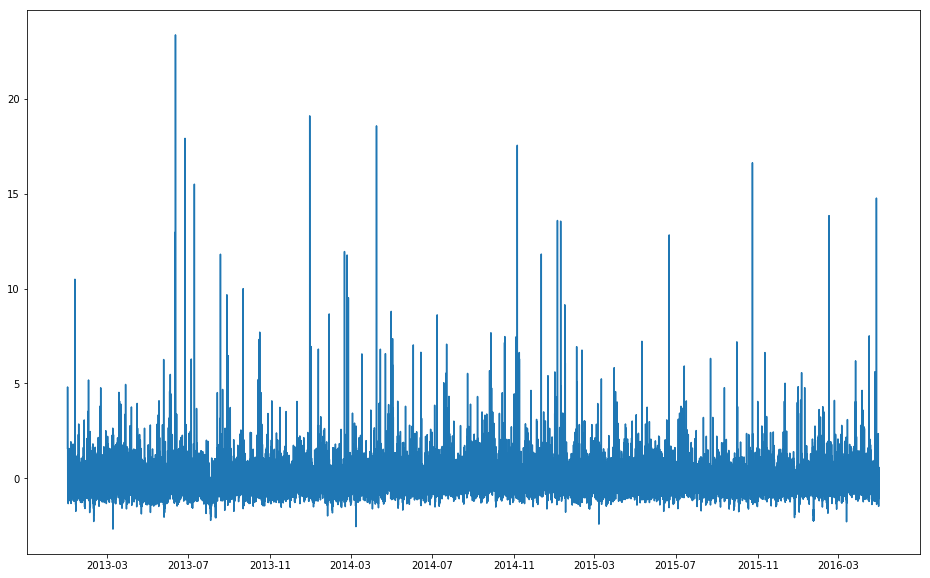

cluster_13 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + sin_week_5 + sin_week_6 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + cos_week_5 + cos_week_6 + sin_year_1 + sin_year_2 + sin_year_3 + cos_year_1 + cos_year_2 + cos_year_3 + Trend
                            OLS Regression Results                            
Dep. Variable:             cluster_13   R-squared:                       0.142
Model:                            OLS   Adj. R-squared:                  0.141
Method:                 Least Squares   F-statistic:                     253.3
Date:                Wed, 06 Dec 2017   Prob (F-statistic):               0.00
Time:                        21:40:42   Log-Likelihood:                -39181.
No. Observations:               29184   AIC:                         7.840e+04
Df Residuals:                   29164   BIC:                         7.857e+04
Df Model:                          19                                         
Covariance Type:            nonrobus

In [110]:
resid_14, attr_14 = set_attributes(t_series.cluster_13, 6, 3)

In [112]:
resid_14 = resid_14 - resid_14.shift(24)

Критерий Дики-Фуллера 0.00000000


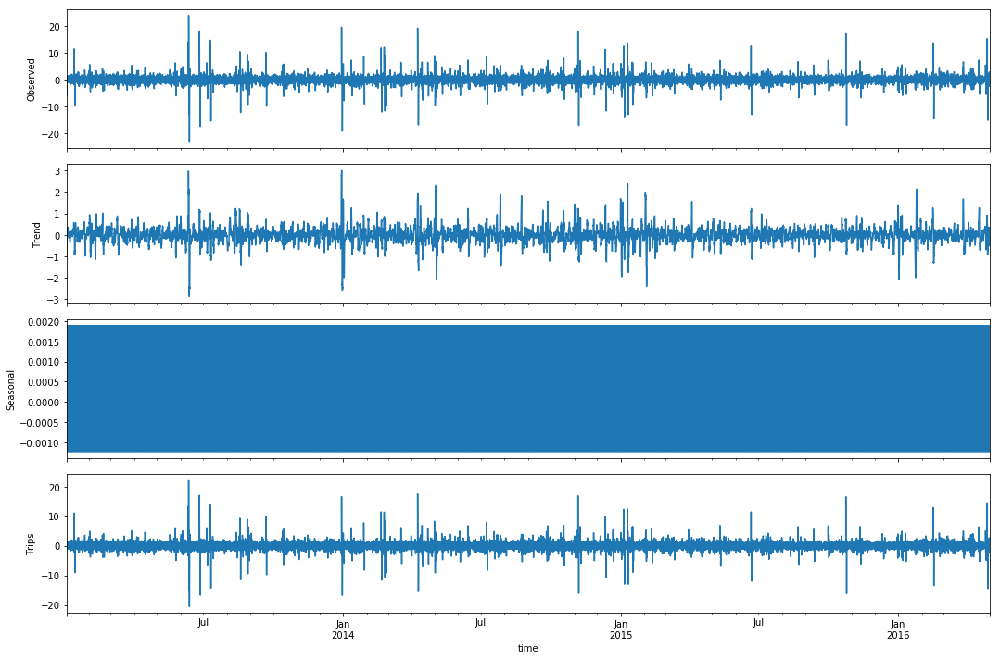

In [113]:
s_dec = resid_seasonal_decompose(resid_14)

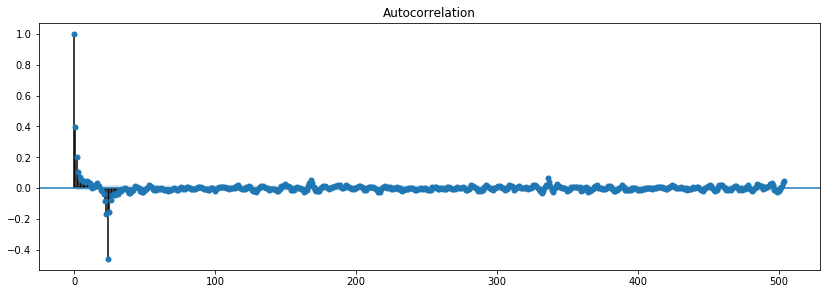

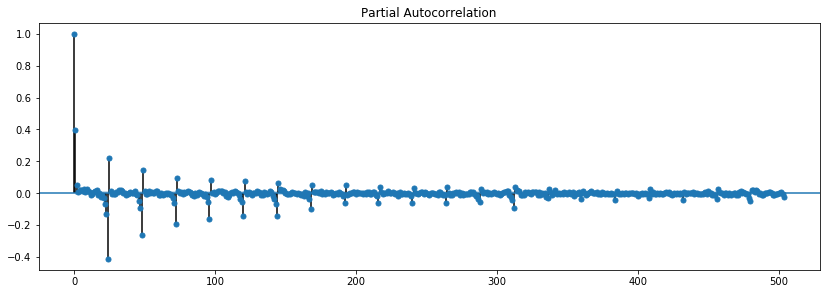

In [114]:
show_acf_pacf(resid_14, 24 * 7 * 3)

### Подбор параметров 15-го кластера



/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:652: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  return safe_is_pandas_categorical_dtype(data.dtype)
/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:679: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  if safe_is_pandas_categorical_dtype(dt1):


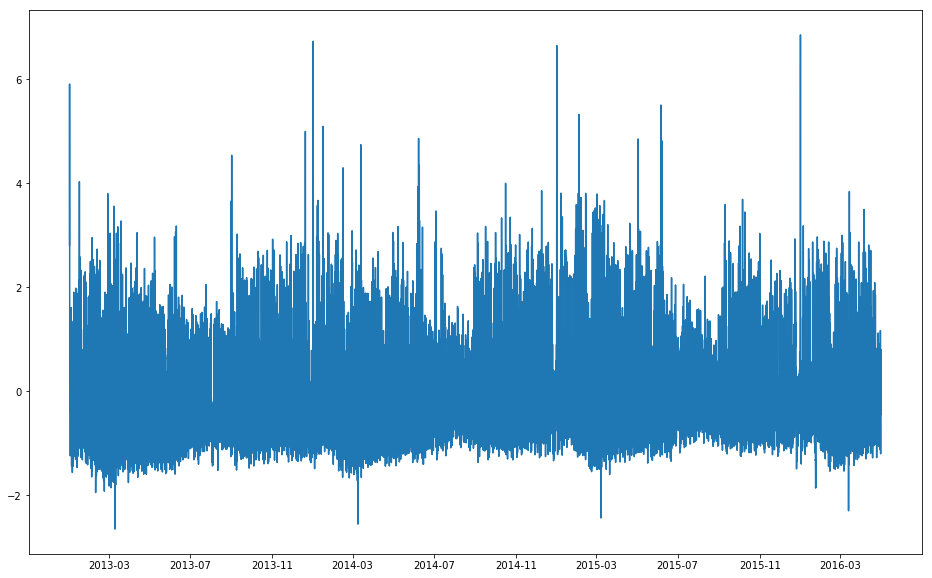

cluster_14 ~ sin_week_1 + sin_week_2 + sin_week_3 + cos_week_1 + cos_week_2 + cos_week_3 + sin_year_1 + sin_year_2 + sin_year_3 + sin_year_4 + sin_year_5 + sin_year_6 + sin_year_7 + cos_year_1 + cos_year_2 + cos_year_3 + cos_year_4 + cos_year_5 + cos_year_6 + cos_year_7 + Trend
                            OLS Regression Results                            
Dep. Variable:             cluster_14   R-squared:                       0.172
Model:                            OLS   Adj. R-squared:                  0.172
Method:                 Least Squares   F-statistic:                     288.8
Date:                Fri, 08 Dec 2017   Prob (F-statistic):               0.00
Time:                        07:21:26   Log-Likelihood:                -34077.
No. Observations:               29184   AIC:                         6.820e+04
Df Residuals:                   29162   BIC:                         6.838e+04
Df Model:                          21                                         
Covariance

In [150]:
resid_15, attr_15 = set_attributes(t_series.cluster_14, 3, 7)

In [152]:
resid_15 = resid_15 - resid_15.shift(24)

Критерий Дики-Фуллера 0.00000000


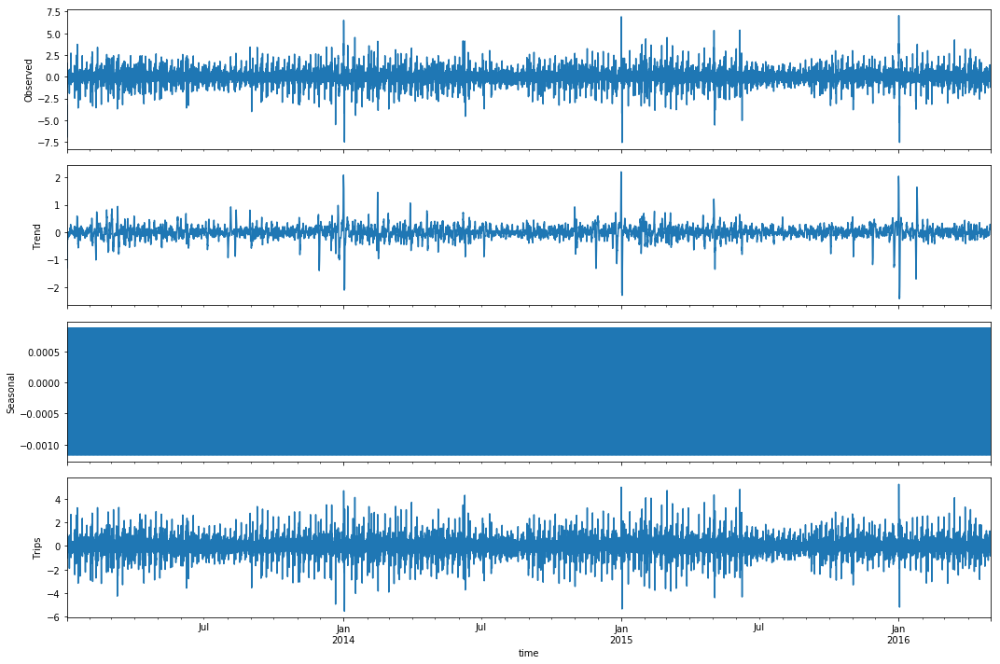

In [153]:
s_dec = resid_seasonal_decompose(resid_15)

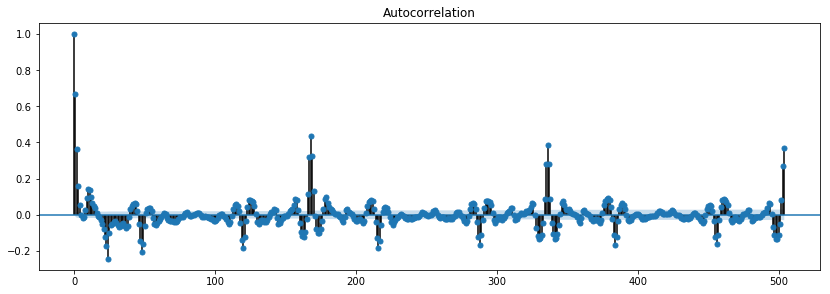

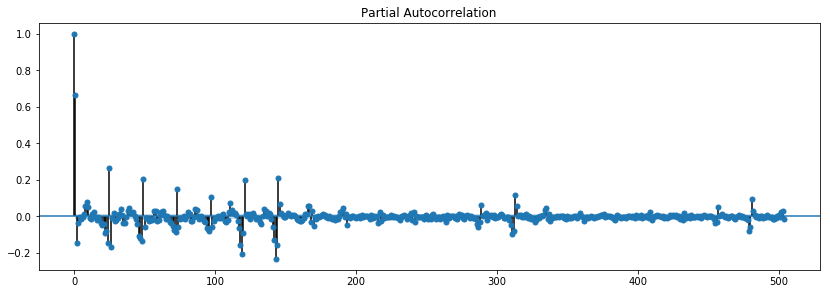

In [154]:
show_acf_pacf(resid_15, 24 * 7 * 3)

### Подбор параметров 16-го кластера



/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:652: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  return safe_is_pandas_categorical_dtype(data.dtype)
/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:679: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  if safe_is_pandas_categorical_dtype(dt1):


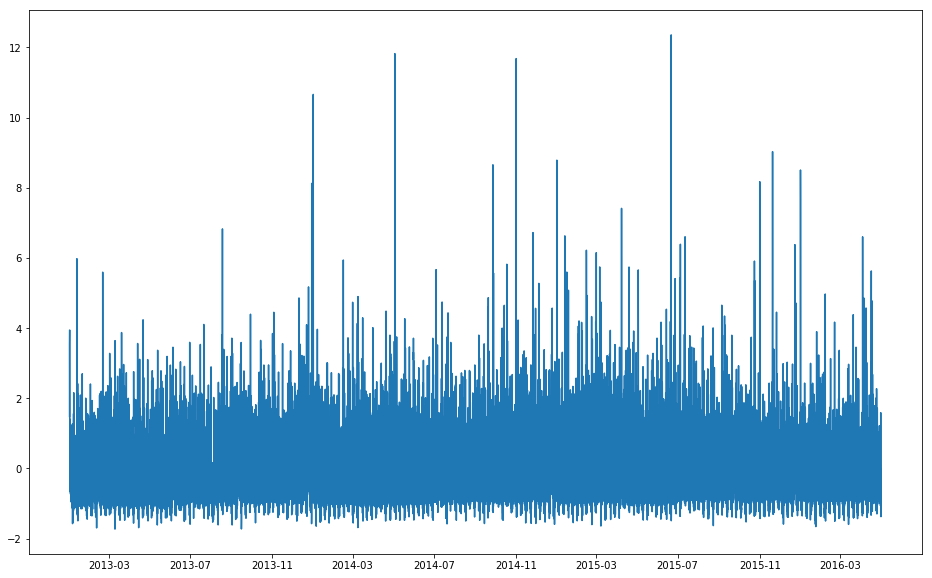

cluster_15 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + sin_week_5 + sin_week_6 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + cos_week_5 + cos_week_6 + sin_year_1 + sin_year_2 + sin_year_3 + cos_year_1 + cos_year_2 + cos_year_3 + Trend
                            OLS Regression Results                            
Dep. Variable:             cluster_15   R-squared:                       0.094
Model:                            OLS   Adj. R-squared:                  0.094
Method:                 Least Squares   F-statistic:                     160.1
Date:                Fri, 08 Dec 2017   Prob (F-statistic):               0.00
Time:                        07:25:09   Log-Likelihood:                -39962.
No. Observations:               29184   AIC:                         7.996e+04
Df Residuals:                   29164   BIC:                         8.013e+04
Df Model:                          19                                         
Covariance Type:            nonrobus

In [165]:
resid_16, attr_16 = set_attributes(t_series.cluster_15, 6, 3)

In [167]:
resid_16 = resid_16 - resid_16.shift(24)

Критерий Дики-Фуллера 0.00000000


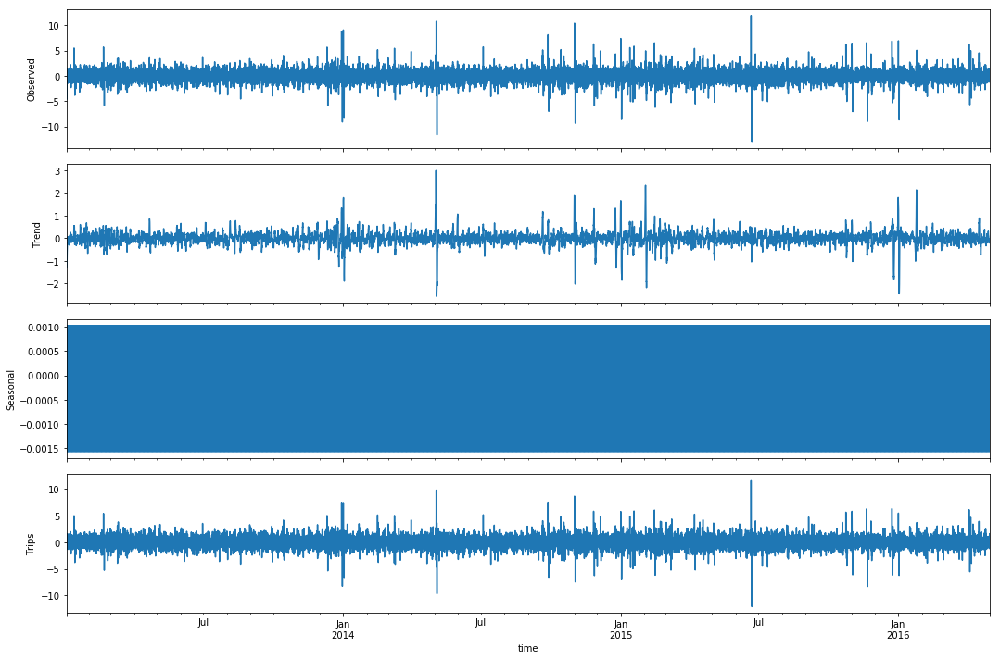

In [168]:
s_dec = resid_seasonal_decompose(resid_16)

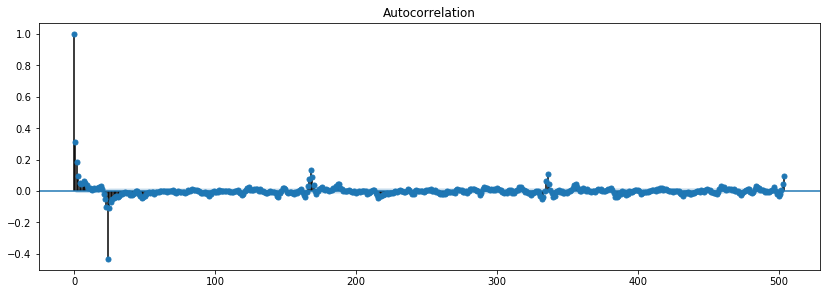

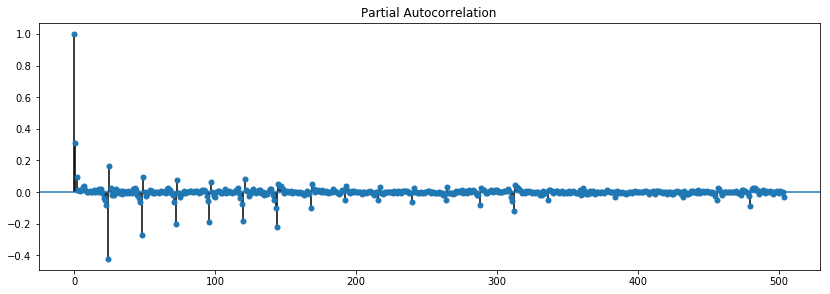

In [169]:
show_acf_pacf(resid_16, 24 * 7 * 3)

### Подбор параметров 17-го кластера



/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:652: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  return safe_is_pandas_categorical_dtype(data.dtype)
/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:679: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  if safe_is_pandas_categorical_dtype(dt1):


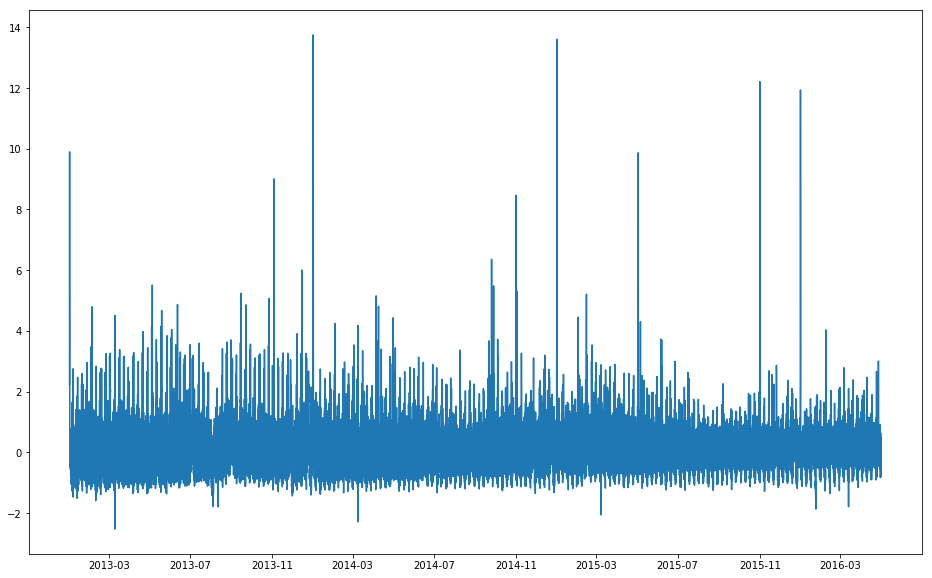

cluster_16 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + sin_week_5 + sin_week_6 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + cos_week_5 + cos_week_6 + sin_year_1 + cos_year_1 + Trend
                            OLS Regression Results                            
Dep. Variable:             cluster_16   R-squared:                       0.260
Model:                            OLS   Adj. R-squared:                  0.259
Method:                 Least Squares   F-statistic:                     681.6
Date:                Fri, 08 Dec 2017   Prob (F-statistic):               0.00
Time:                        07:28:28   Log-Likelihood:                -34758.
No. Observations:               29184   AIC:                         6.955e+04
Df Residuals:                   29168   BIC:                         6.968e+04
Df Model:                          15                                         
Covariance Type:            nonrobust                                         
         

In [181]:
resid_17, attr_17 = set_attributes(t_series.cluster_16, 6, 1)

In [183]:
resid_17 = resid_17 - resid_17.shift(24)

Критерий Дики-Фуллера 0.00000000


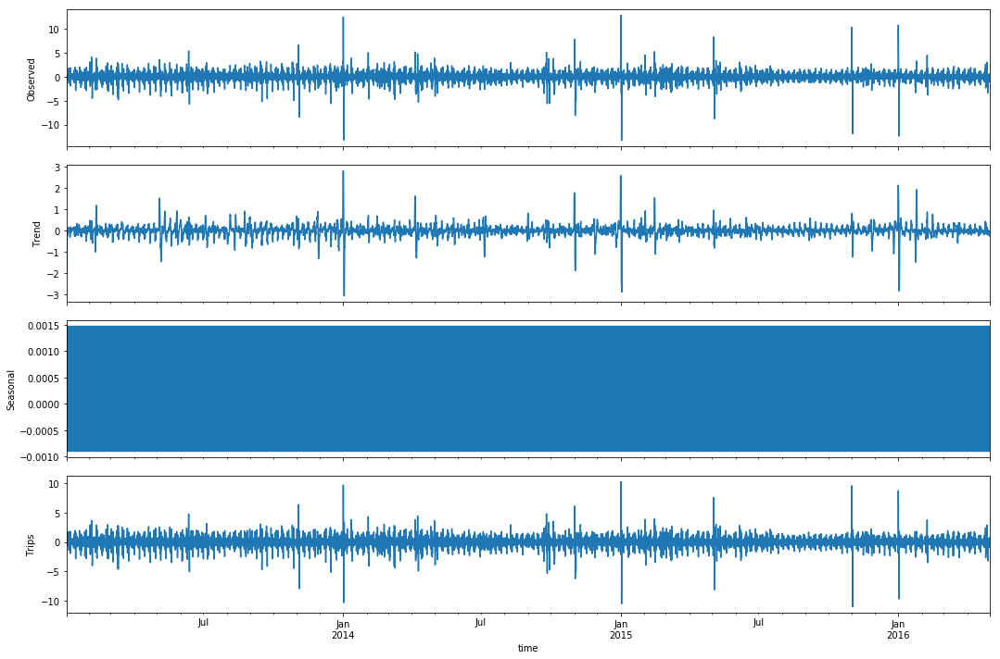

In [184]:
s_dec = resid_seasonal_decompose(resid_17)

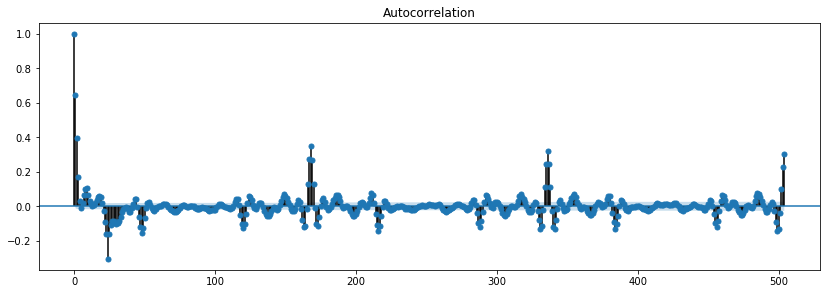

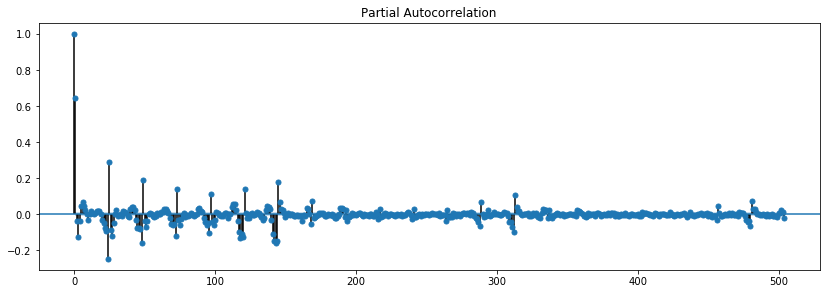

In [185]:
show_acf_pacf(resid_17, 24 * 7 * 3)

### Подбор параметров 18-го кластера


/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:652: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  return safe_is_pandas_categorical_dtype(data.dtype)
/Users/Ar4eBaT/anaconda/lib/python3.6/site-packages/patsy/util.py:679: DeprecationWarning: pandas.core.common.is_categorical_dtype is deprecated. import from the public API: pandas.api.types.is_categorical_dtype instead
  if safe_is_pandas_categorical_dtype(dt1):


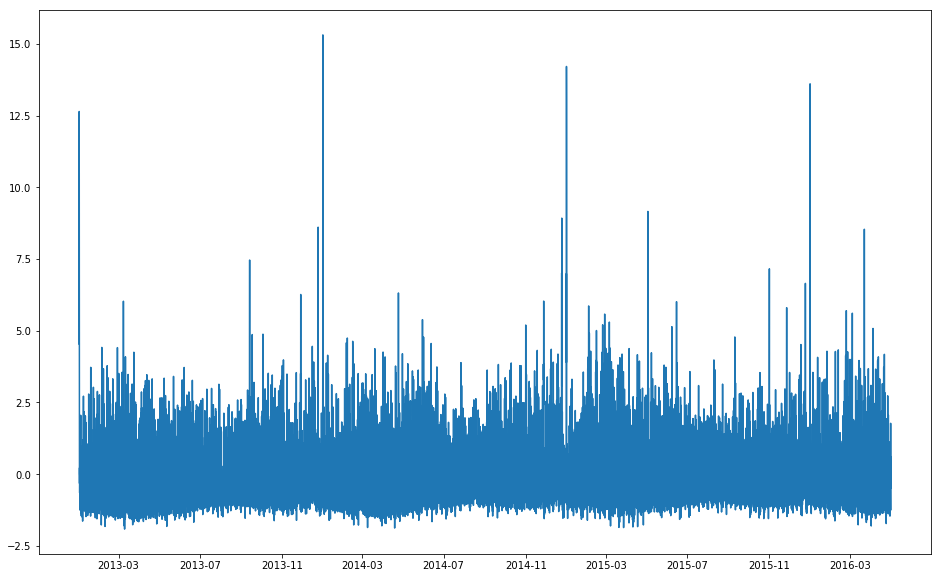

cluster_17 ~ sin_week_1 + sin_week_2 + sin_week_3 + sin_week_4 + sin_week_5 + cos_week_1 + cos_week_2 + cos_week_3 + cos_week_4 + cos_week_5 + sin_year_1 + sin_year_2 + sin_year_3 + cos_year_1 + cos_year_2 + cos_year_3 + Trend
                            OLS Regression Results                            
Dep. Variable:             cluster_17   R-squared:                       0.055
Model:                            OLS   Adj. R-squared:                  0.055
Method:                 Least Squares   F-statistic:                     100.2
Date:                Fri, 08 Dec 2017   Prob (F-statistic):               0.00
Time:                        07:32:01   Log-Likelihood:                -40581.
No. Observations:               29184   AIC:                         8.120e+04
Df Residuals:                   29166   BIC:                         8.135e+04
Df Model:                          17                                         
Covariance Type:            nonrobust                         

In [193]:
resid_18, attr_18 = set_attributes(t_series.cluster_17, 5, 3)

In [195]:
resid_18 = resid_18 - resid_18.shift(24)

Критерий Дики-Фуллера 0.00000000


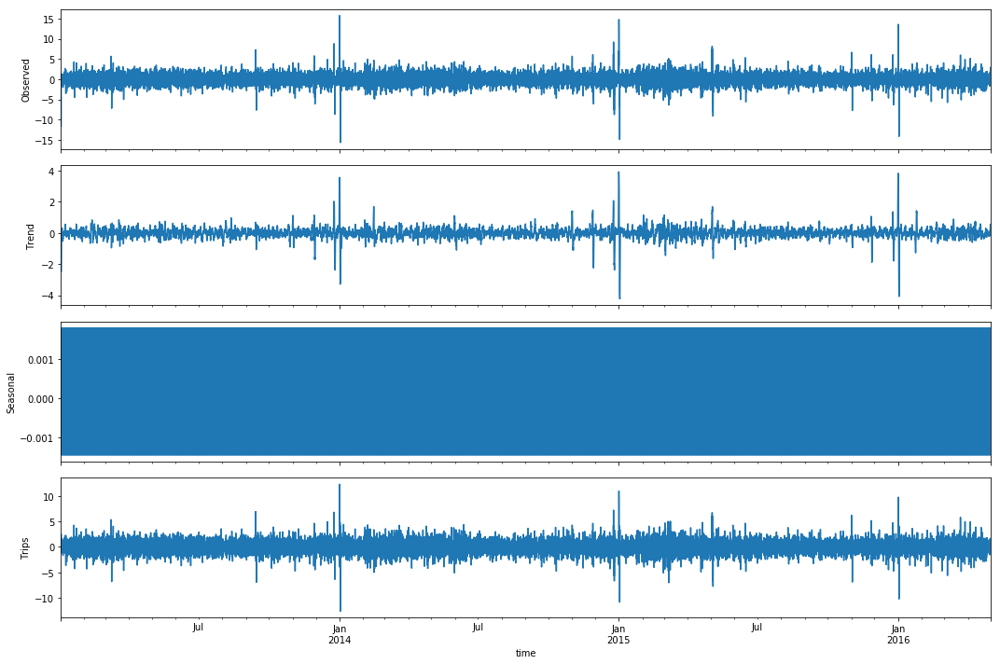

In [196]:
s_dec = resid_seasonal_decompose(resid_18)

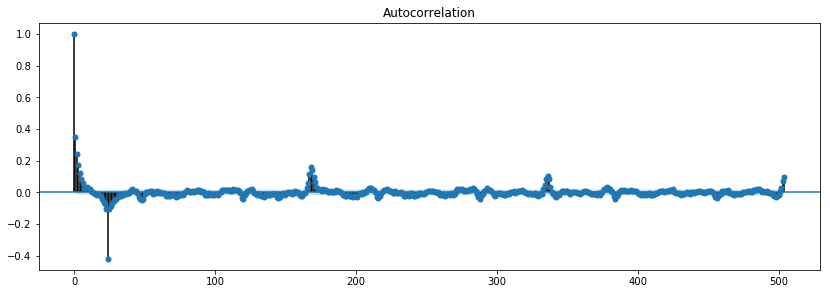

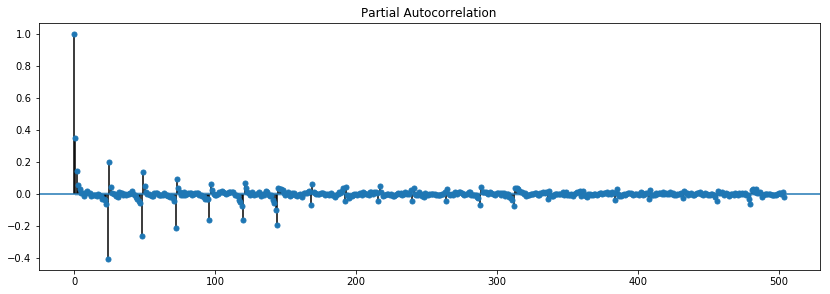

In [197]:
show_acf_pacf(resid_18, 24 * 7 * 3)

## Задание № 6

Для каждой из $R$ географических зон настройте на данных до апреля 2016 включительно модель ARIMA с гиперпараметрами, соответствующими кластеру этой зоны. Для каждого конца истории от 2016.04.30 23:00 до 2016.05.31 17:00 постройте прогноз на 6 часов вперёд.

In [26]:
from scipy import stats
from itertools import product

def train_time_series(col_name, attributes, p, q, P, Q, d, D, is_product=True):
    if is_product is True:
        print("product...")
        parameters = product(range(p, p + 1),
                             range(q, q + 1),
                             range(0, P + 1),
                             range(0, Q + 1))
        parameters_list = list(parameters)
    else:
        print("not product")
        parameters_list = [(p, q, P, Q)]

    results = []
    best_aic = float("inf")
    warnings.filterwarnings('ignore')

    for param in parameters_list:
        #try except нужен, потому что на некоторых наборах параметров модель не обучается
        try:
            print(param)
            model = sm.tsa.statespace.SARIMAX(train_data[col_name].values,
                                                attributes.get_values(),
                                                order=(param[0], d, param[1]), 
                                                seasonal_order=(param[2], D, param[3], 24)).fit(disp=-1)
            aic = model.aic
        #выводим параметры, на которых модель не обучается и переходим к следующему набору
        except ValueError:
            print('wrong parameters:', param, d, D)
            continue

        #сохраняем лучшую модель, aic, параметры
        if aic < best_aic:
            best_model = model
            best_aic = aic
            best_param = param
        results.append([param, model.aic])
    
    warnings.filterwarnings('default')

    print(best_model.summary())
    
    plt.figure(figsize(15,8))
    plt.subplot(211)
    plt.plot(train_data.index, best_model.resid)
    plt.ylabel(u'Residuals')

    print("Критерий Стьюдента: p=%f" % stats.ttest_1samp(best_model.resid, 0)[1])
    print("Критерий Дики-Фуллера: p=%f" % sm.tsa.stattools.adfuller(best_model.resid)[1])
    
    cluster_data = pd.DataFrame(train_data[col_name])
    cluster_data['model'] = best_model.fittedvalues
    plt.figure(figsize(15,7))
    cluster_data[col_name].plot()
    cluster_data.model.plot(color='r')
    plt.ylabel('Trips')
    pylab.show()

    return best_model, best_param

In [27]:
def forecast_future(model, col_name, arguments, start_date, end_date):
    new_data = pd.DataFrame(train_data[col_name])
    future = pd.DataFrame(test_data[col_name], columns = new_data.columns)
    new_data = pd.concat([new_data, future])

    cycle_len = data.loc[start_date:end_date].shape[0]
    cluster_predictions = []
    real_data = []
    for n_start in range(cycle_len):
        forecast = model.predict(start=(train_data.shape[0] + n_start),
                                      end=(train_data.shape[0] + n_start + 5),
                                      exog=arguments[:n_start + 6].values)
    
        cluster_predictions.append(forecast)
        real_data.append(test_data[col_name].values[n_start:n_start + 6])
    
    return cluster_predictions, real_data

In [28]:
def cluster_forecast(regions, attributes, p, q, P, Q, d, D, week_k, year_k, start_date, end_date, param_dict=None):
    result = []
    errors = []
    for region in regions:
        print("Start " + region + ":")
        print("1. Train")
        is_product = True
        if param_dict is not None:
            print("geting params")
            is_product = False
            params = param_dict[region]
            p = int(params[0])
            q = int(params[1])
            P = int(params[2])
            Q = int(params[3])
            d = int(params[4])
            D = int(params[5])
            print(p, q, P, Q, d, D)
        try:
            best_model, best_param = train_time_series(region, attributes, p, q, P, Q, d, D, is_product)
        except LinAlgError:
            print(LinAlgError.args, region)
            errors.append(region)
            continue
            
        res, attr = set_attributes(test_data[region], week_k, year_k, False, 
                                   start=(train_data.shape[0] + 1),
                                   end=(train_data.shape[0] + test_data.shape[0]))
        print("2. Forecast")
        cluster_predictions, real_data = forecast_future(best_model, region, attr,
                                                         start_date, end_date)
        cluster_predictions_round = np.abs(np.array(cluster_predictions, dtype=np.int16))
        result.append((region, best_param, cluster_predictions_round, real_data))
        print("End.")
    return result, errors

In [29]:
def regions_forecast(cluster_num, attributes, p, q, P, Q, d, D, week_k, year_k, start_date, end_date, param_dict=None):
    if type(cluster_num) is int:
        regions = data_trans[preds == cluster_num].index.values
    else:
        regions = cluster_num
    
    return cluster_forecast(regions, attributes, p, q, P, Q, d, D, week_k, year_k, start_date, end_date, param_dict)

In [30]:
def write_best_params(cluster_num, result, d, D):
    params = [res[0] + "_" + "_".join(str(param) for param in res[1]) + "_" + str(d) + "_" + str(D) for res in result]
    with open("params/params_" + str(cluster_num + 1) + ".txt", "w") as f:
        f.write(" ".join([str(param) for param in params]))

In [31]:
import datetime

def time_range(_from, _to, delta):
    delta = datetime.timedelta(hours=delta)
    curr = _from
    while curr < _to:
        yield curr
        curr += delta

In [266]:
def create_id(region, date, iterat):
    region = int(region.split("_")[1])
    ind = date.find(":")
    date = date[:ind].split(" ")
    date = date[0] + "_" + str(int(date[1]))
    res_id = str(region) + "_" + date + "_" + str(iterat)
    return res_id

In [181]:
def generate_id(region, date, num_iter, stand_iter, reverse):
    ids = []
    for j in range(1, num_iter + 1):
        iterat = stand_iter - j + 1 if reverse is True else j
        new_id = create_id(region, date, iterat)
        ids.append(new_id)
    return reversed(ids) if reverse is True else ids

In [243]:
def ids_from_region(region, result, date_range):
    ids = []
    n_res = len(result)
    for i in range(n_res):
        forecast = result[i]
        n_forecast = len(forecast)
        #if i == 0:
        #    for j in range(0, 5):
        #        ids.extend(generate_id(region, date_range[j], j + 1, n_forecast, True))
        ids.extend(generate_id(region, date_range[i + 5], n_forecast, n_forecast, False))
        #if i == (n_res - 1):
         #   for j in range(1, 6):
         #       ids.extend(generate_id(region, date_range[i + j + 5], n_forecast - j, n_forecast, False))
    return ids

In [242]:
def result_order(result, real=False):
    ind = 2
    if real is True:
        ind = 3
    result = np.array(result[ind])
    res_shape = result.shape
    #start_res = result[0]

    res_ord = []
    #for i in range(1, len(start_res)):
    #    res_ord.extend(start_res[:i])
    
    res_ord.extend(result.reshape(res_shape[0] * res_shape[1]))

    #end_res = result[-1]
    #for i in range(1, len(end_res)):
    #    res_ord.extend(end_res[i:])
        
    return res_ord

In [187]:
def result_df(results, from_datetime, to_datetime, add_real_data=False):
    from_datetime = from_datetime - datetime.timedelta(hours=5)
    to_datetime = to_datetime + datetime.timedelta(hours=5)
    date_range = [str(x) for x in time_range(from_datetime,
                                             to_datetime,
                                             1)]
    ids = []
    all_res = []
    
    [ids.extend(ids_from_region(result[0], result[2], date_range)) for result in results]
    [all_res.extend(result_order(result)) for result in results]
    
    if add_real_data is True:
        real_res = []
        [real_res.extend(result_order(result, True)) for result in results]
        return pd.DataFrame({"id":ids, "y":all_res, "y_real":real_res})
    else:
        return pd.DataFrame({"id":ids, "y":all_res})

In [267]:
results = [result_1, result_2, result_3, result_4, result_5, result_6, result_7, result_8, result_9, result_10, result_11,
          result_12, result_13, result_14, result_15, result_16, result_17, result_18]

for cluster_num in np.arange(0, 18):
    result = results[cluster_num]
    res_df = result_df(result, datetime.datetime(2016, 5, 31, 23), datetime.datetime(2016, 6, 30, 18), True)
    res_df.to_csv("result/res_" + str(cluster_num + 1) + ".csv", sep=",", index=False)

### Прогнозирование значений рядов 1-го кластера

Start region_1175:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood              -94987.235
Date:                            Thu, 30 Nov 2017   AIC                         190058.470
Time:                                    23:12:31   BIC                         190406.288
Sample:                                         0   HQIC                        190170.218
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -1.0104  

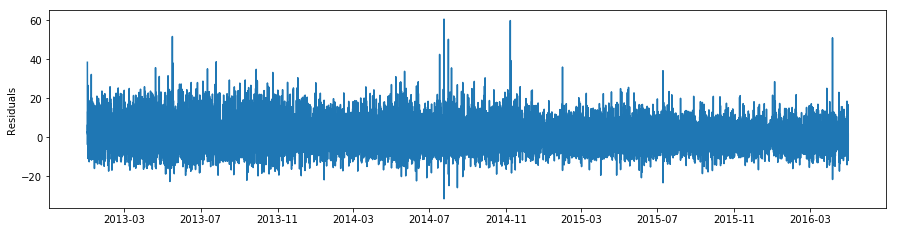

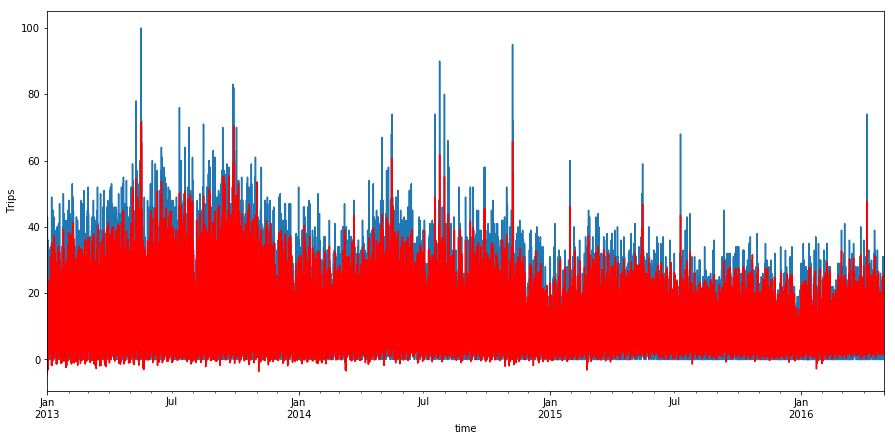

2. Forecast
End.
Start region_1337:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -125624.340
Date:                            Fri, 01 Dec 2017   AIC                         251332.680
Time:                                    00:08:08   BIC                         251680.497
Sample:                                         0   HQIC                        251444.428
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

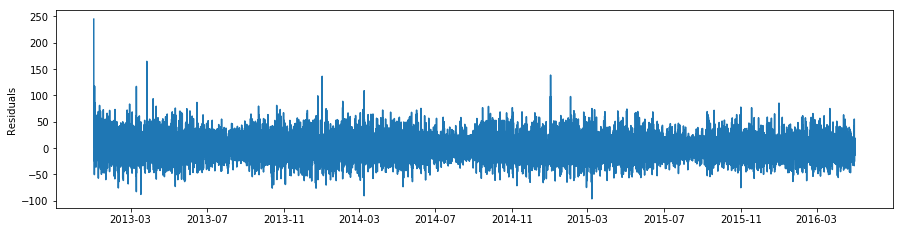

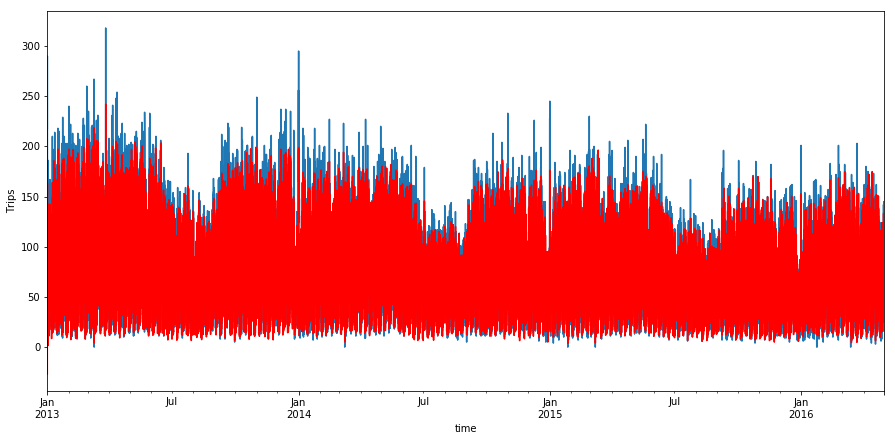

2. Forecast
End.
Start region_1338:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -119435.492
Date:                            Fri, 01 Dec 2017   AIC                         238954.984
Time:                                    01:06:04   BIC                         239302.802
Sample:                                         0   HQIC                        239066.732
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

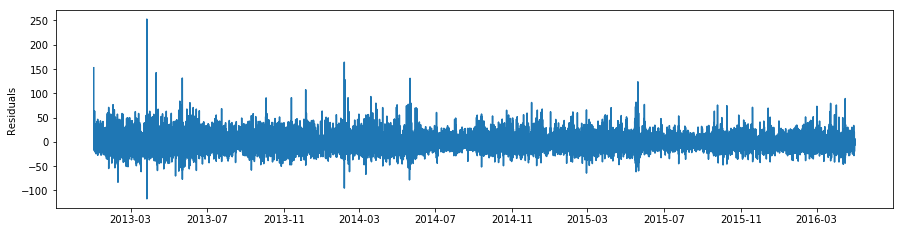

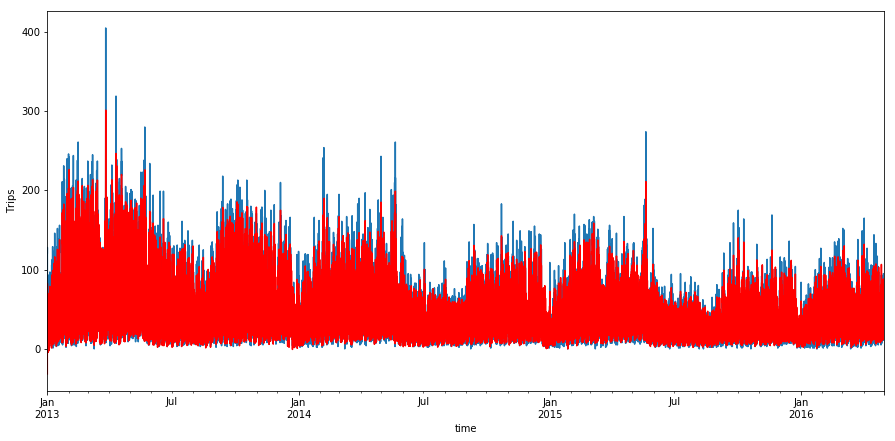

2. Forecast
End.
Start region_1339:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood              -88649.144
Date:                            Fri, 01 Dec 2017   AIC                         177382.288
Time:                                    01:53:44   BIC                         177730.106
Sample:                                         0   HQIC                        177494.036
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

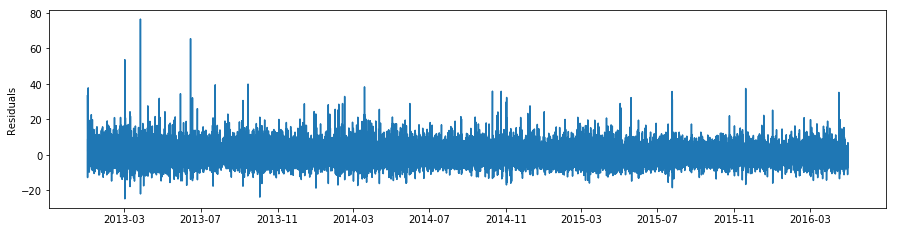

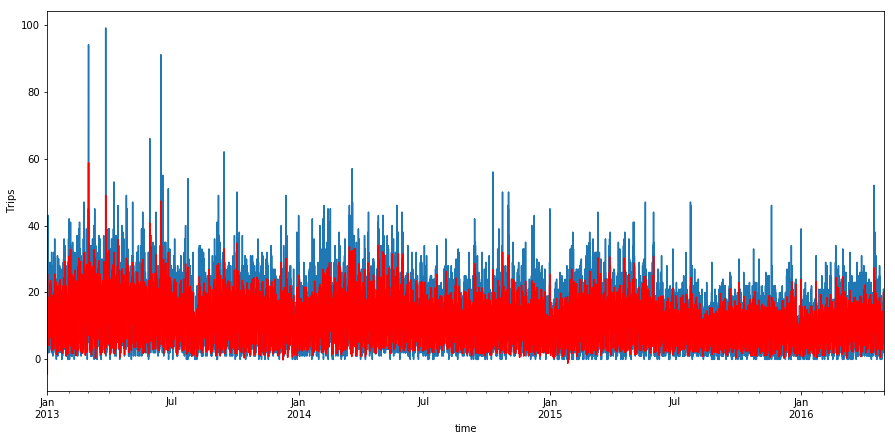

2. Forecast
End.
Start region_1386:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -112687.516
Date:                            Fri, 01 Dec 2017   AIC                         225459.032
Time:                                    02:47:21   BIC                         225806.850
Sample:                                         0   HQIC                        225570.780
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

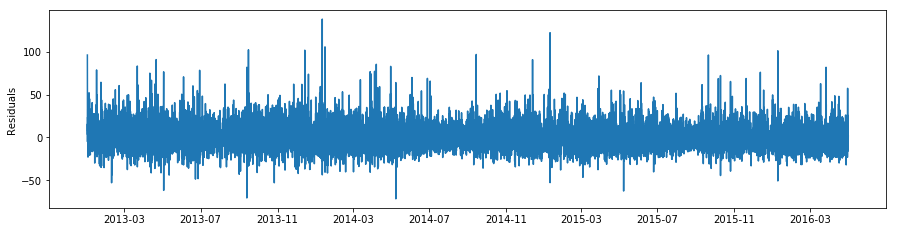

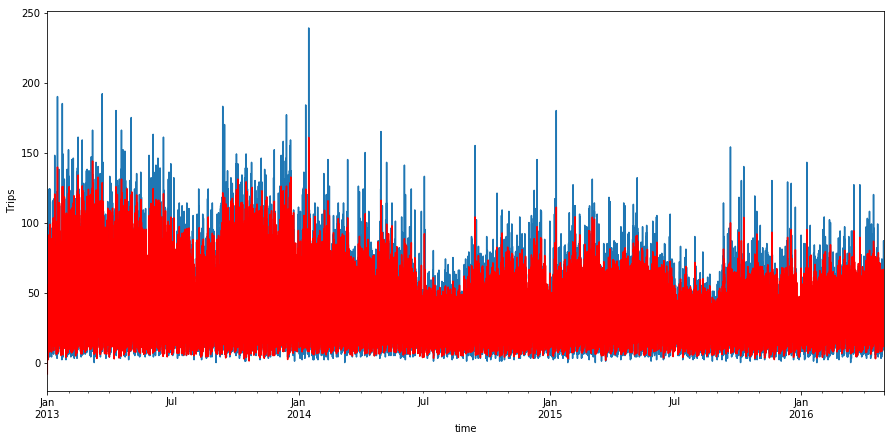

2. Forecast
End.
Start region_1442:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood              -80835.958
Date:                            Fri, 01 Dec 2017   AIC                         161755.917
Time:                                    03:24:53   BIC                         162103.735
Sample:                                         0   HQIC                        161867.665
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

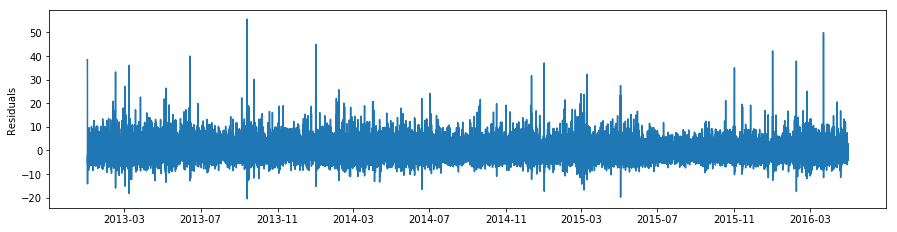

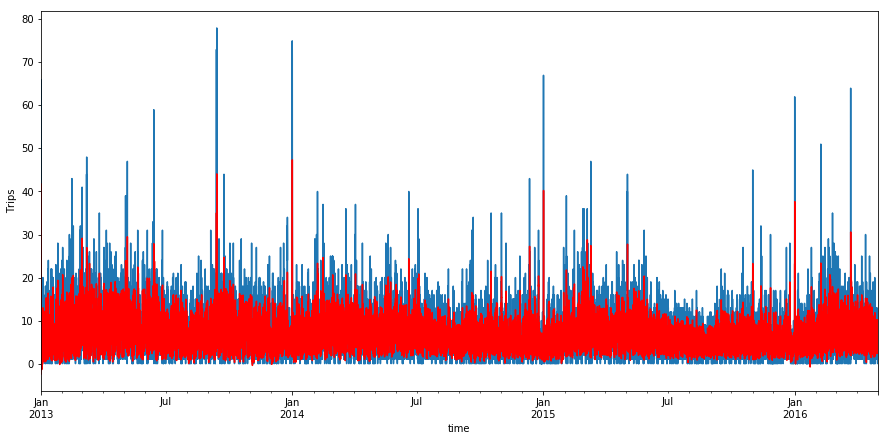

2. Forecast
End.
CPU times: user 10h 26min 12s, sys: 2h 29min 37s, total: 12h 55min 49s
Wall time: 5h 3min 8s


In [55]:
%%time
result_1, errors_1 = regions_forecast(0, attr_1, 1, 1, 1, 1, 0, 0, 6, 12, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [59]:
write_best_params(0, result_1, 0, 0)

In [68]:
res_1_df = result_df(result_1, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_1_df.to_csv("test_result/res_1.csv", sep=",", index=False)

### Прогнозирование значений рядов 2-го кластера

Start region_1129:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -166930.651
Date:                            Fri, 01 Dec 2017   AIC                         333945.302
Time:                                    07:38:59   BIC                         334293.119
Sample:                                         0   HQIC                        334057.050
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           -52.1996  

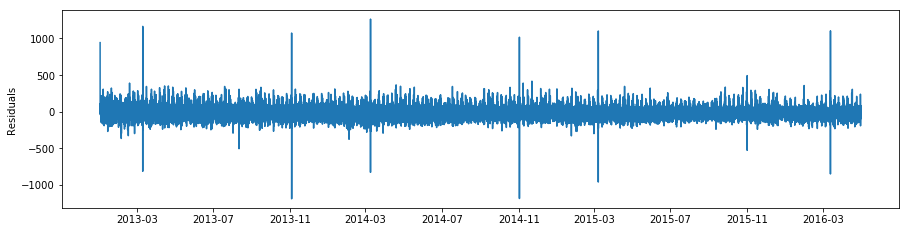

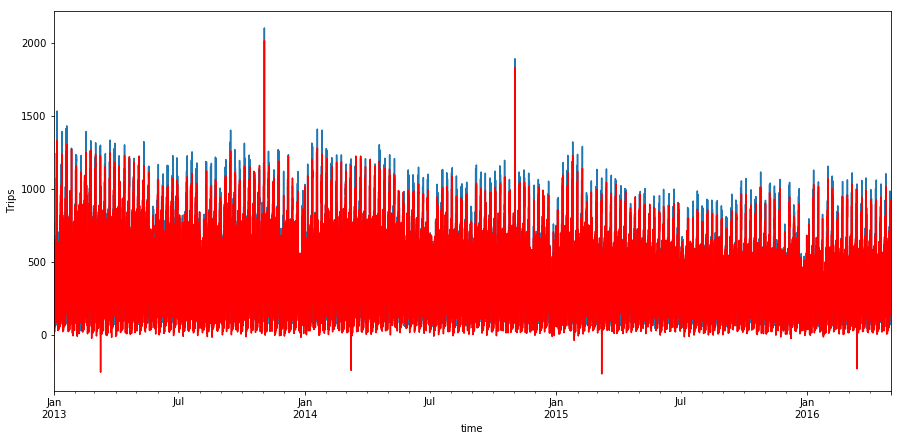

2. Forecast
End.
Start region_1130:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -170687.308
Date:                            Fri, 01 Dec 2017   AIC                         341458.616
Time:                                    08:23:48   BIC                         341806.434
Sample:                                         0   HQIC                        341570.364
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

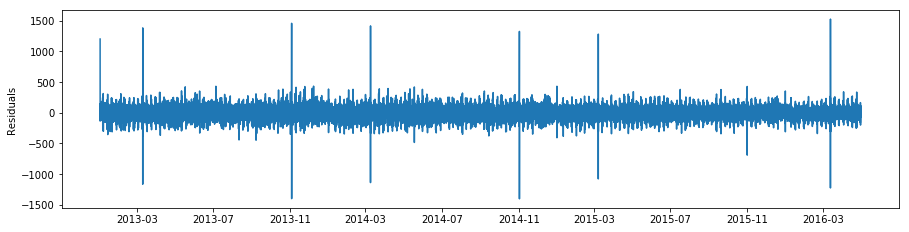

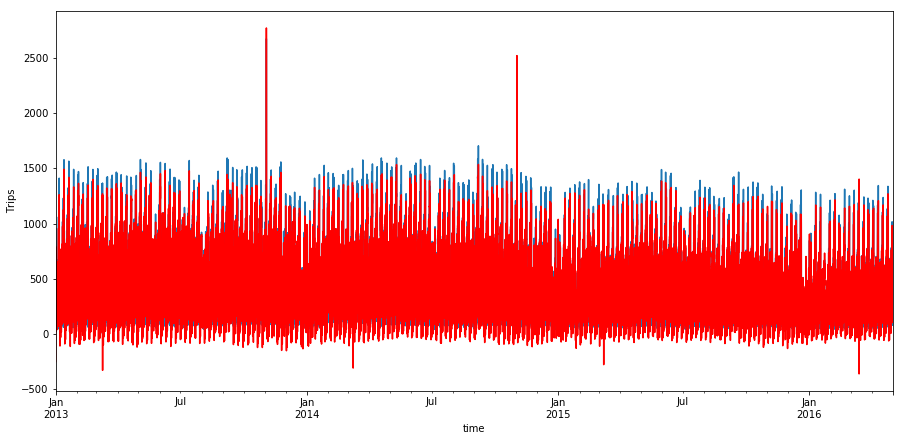

2. Forecast
End.
Start region_1176:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -102847.105
Date:                            Fri, 01 Dec 2017   AIC                         205778.210
Time:                                    09:15:13   BIC                         206126.028
Sample:                                         0   HQIC                        205889.958
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

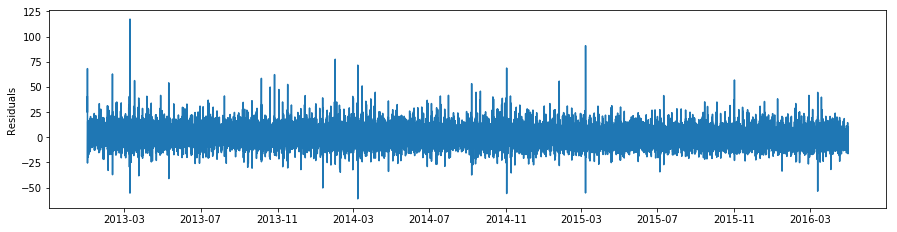

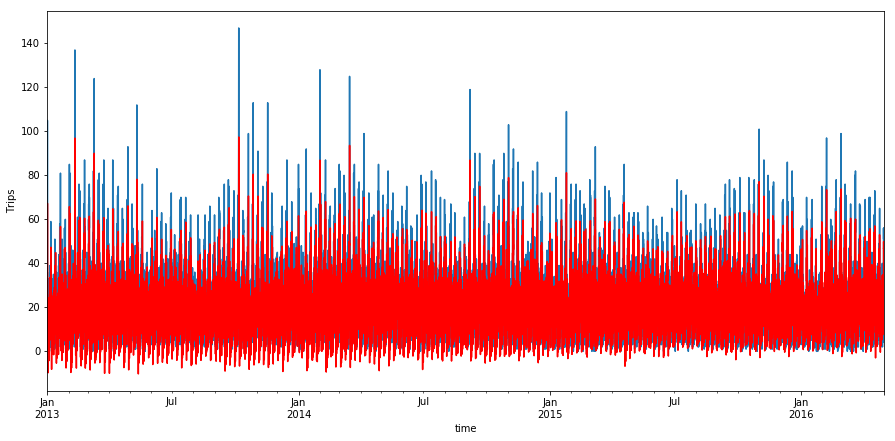

2. Forecast
End.
Start region_1177:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -169214.778
Date:                            Fri, 01 Dec 2017   AIC                         338513.556
Time:                                    10:12:02   BIC                         338861.373
Sample:                                         0   HQIC                        338625.304
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

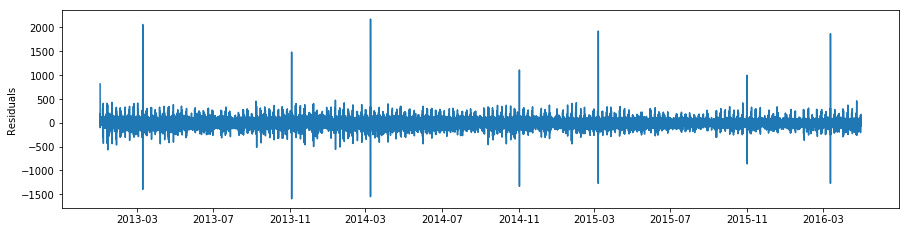

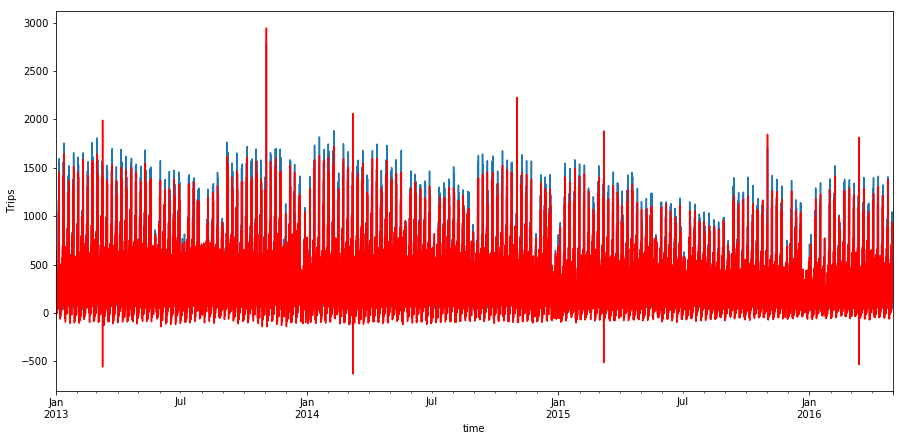

2. Forecast
End.
Start region_1178:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -172417.190
Date:                            Fri, 01 Dec 2017   AIC                         344918.380
Time:                                    10:58:39   BIC                         345266.198
Sample:                                         0   HQIC                        345030.128
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

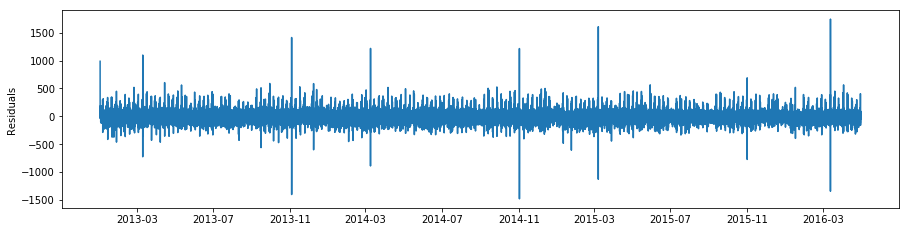

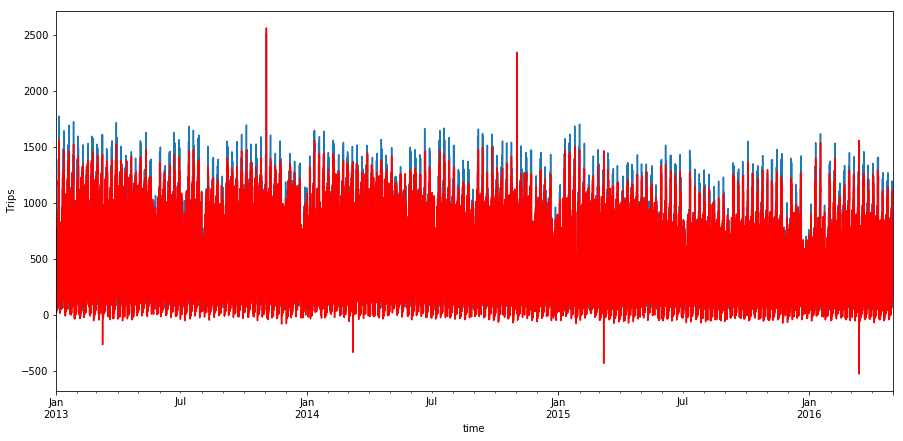

2. Forecast
End.
Start region_1227:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -159449.187
Date:                            Fri, 01 Dec 2017   AIC                         318982.374
Time:                                    11:42:23   BIC                         319330.192
Sample:                                         0   HQIC                        319094.122
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

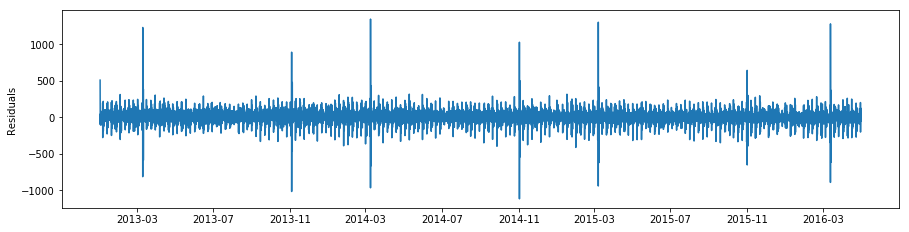

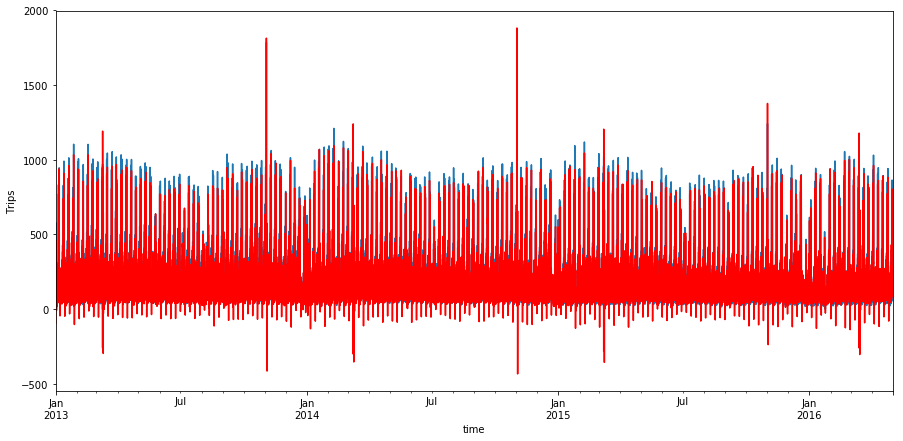

2. Forecast
End.
Start region_1228:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -169461.914
Date:                            Fri, 01 Dec 2017   AIC                         339007.829
Time:                                    12:28:56   BIC                         339355.647
Sample:                                         0   HQIC                        339119.577
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

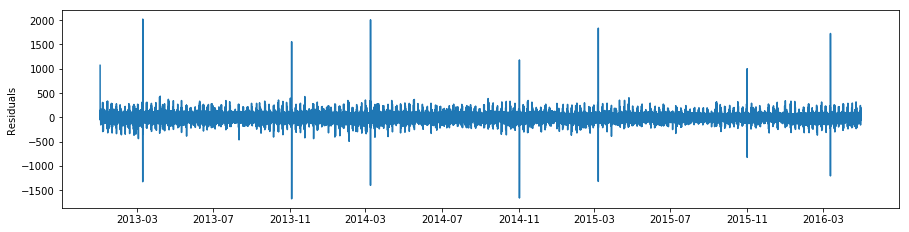

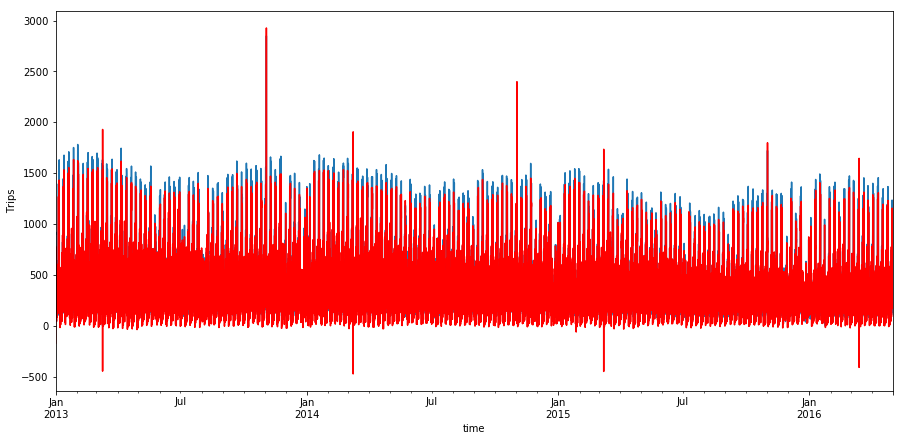

2. Forecast
End.
Start region_1278:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood              -94926.572
Date:                            Fri, 01 Dec 2017   AIC                         189937.143
Time:                                    13:09:50   BIC                         190284.961
Sample:                                         0   HQIC                        190048.892
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

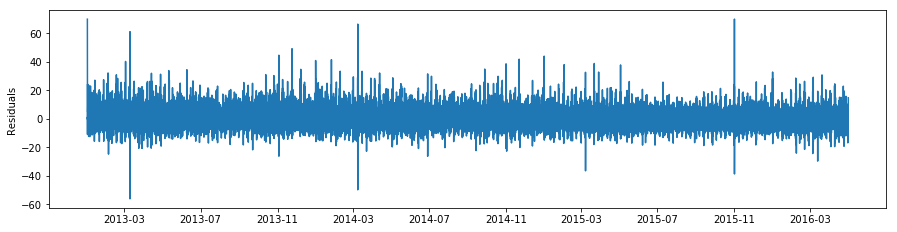

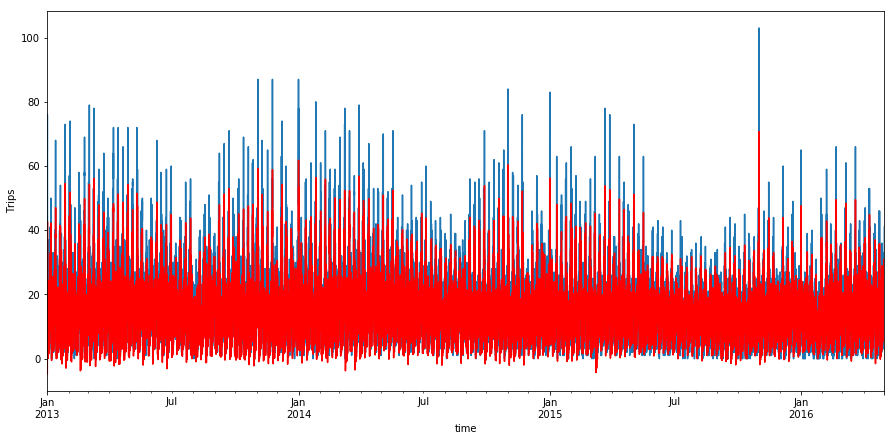

2. Forecast
End.
CPU times: user 13h 2min 4s, sys: 3h 8min 48s, total: 16h 10min 52s
Wall time: 6h 7min 45s


In [69]:
%%time
result_2, errors_2 = regions_forecast(1, attr_2, 1, 1, 1, 1, 0, 0, 4, 14, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [72]:
write_best_params(1, result_2, 0, 0)

In [73]:
res_2_df = result_df(result_2, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_2_df.to_csv("test_result/res_2.csv", sep=",", index=False)

### Прогнозирование значений рядов 3-го кластера

Start region_1127:
1. Train
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -153569.088
Date:                            Mon, 27 Nov 2017   AIC                         307214.177
Time:                                    19:57:25   BIC                         307528.869
Sample:                                         0   HQIC                        307315.282
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            21.1195      2.371  

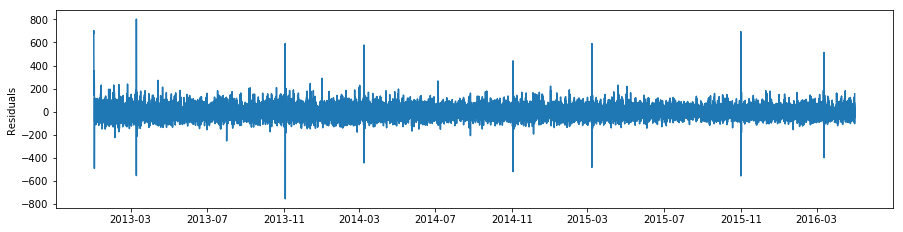

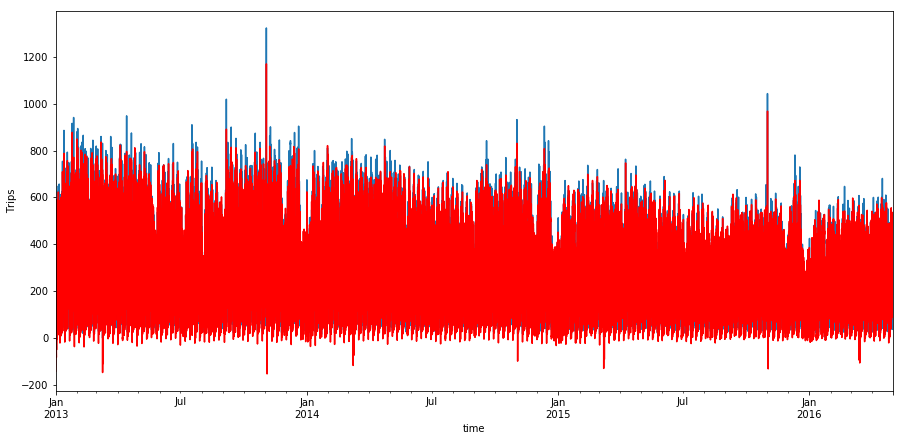

2. Forecast
End.
Start region_1128:
1. Train
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -159271.677
Date:                            Mon, 27 Nov 2017   AIC                         318619.354
Time:                                    21:47:52   BIC                         318934.047
Sample:                                         0   HQIC                        318720.460
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -4.

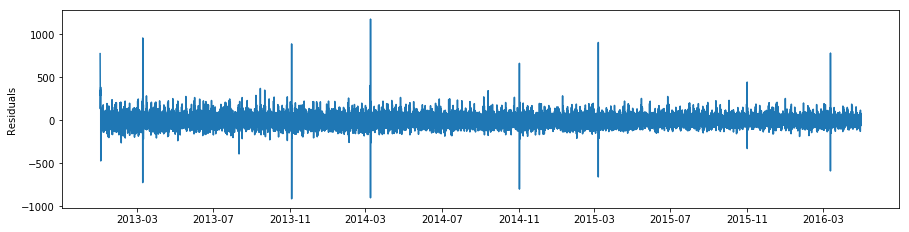

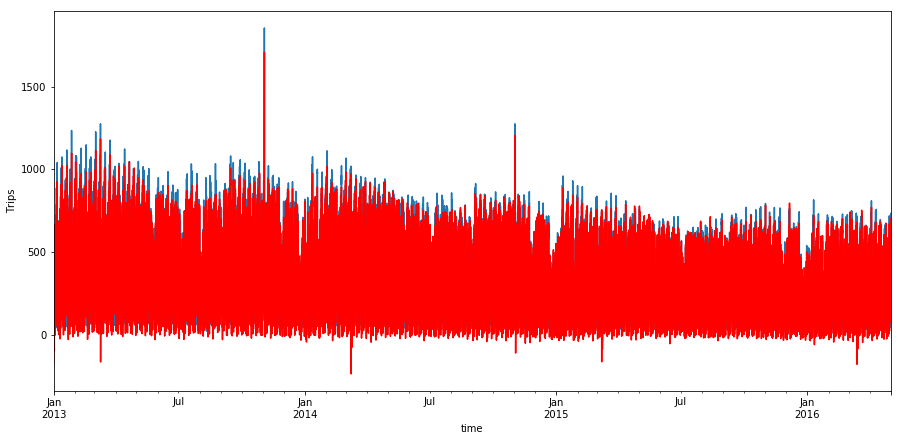

2. Forecast
End.
Start region_1131:
1. Train
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -144631.558
Date:                            Tue, 28 Nov 2017   AIC                         289339.116
Time:                                    00:00:19   BIC                         289653.809
Sample:                                         0   HQIC                        289440.222
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            10.

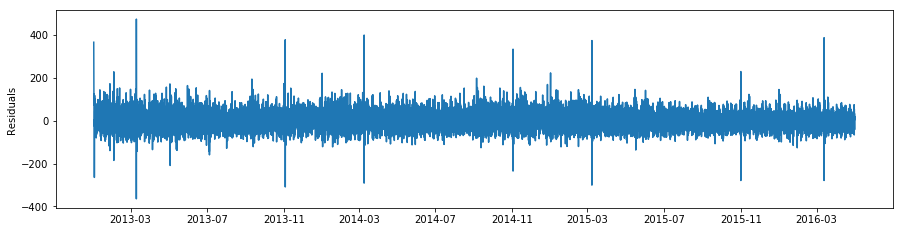

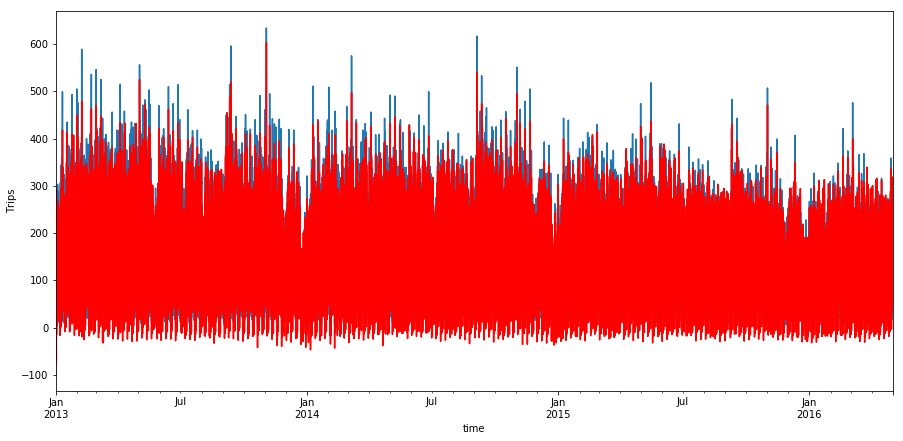

2. Forecast
End.
Start region_1179:
1. Train
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -167638.154
Date:                            Tue, 28 Nov 2017   AIC                         335352.308
Time:                                    02:15:33   BIC                         335667.000
Sample:                                         0   HQIC                        335453.414
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             3.

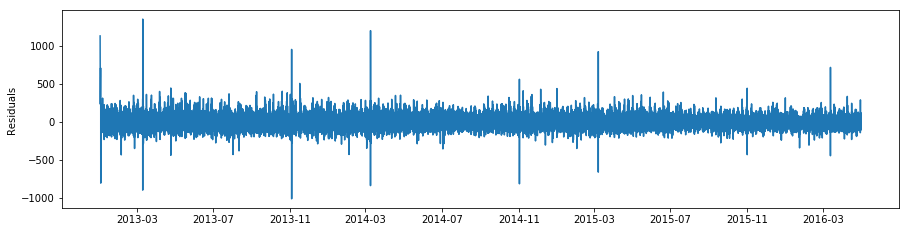

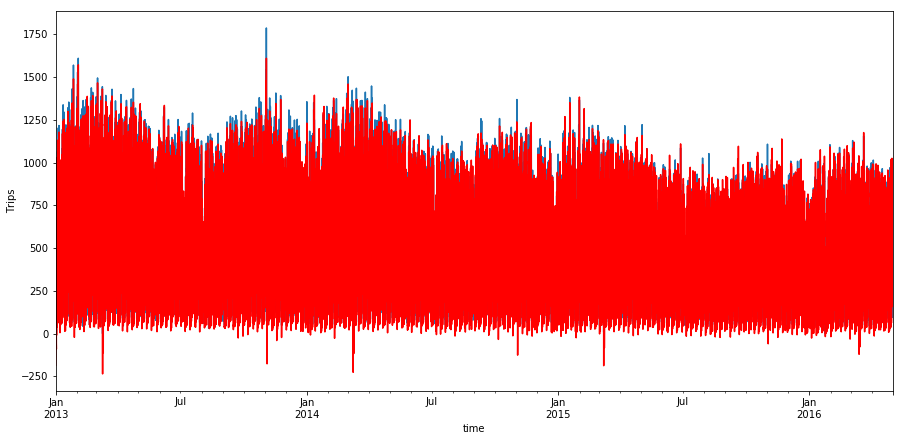

2. Forecast
End.
Start region_1182:
1. Train
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -167436.435
Date:                            Tue, 28 Nov 2017   AIC                         334948.869
Time:                                    04:05:08   BIC                         335263.562
Sample:                                         0   HQIC                        335049.975
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           -34.

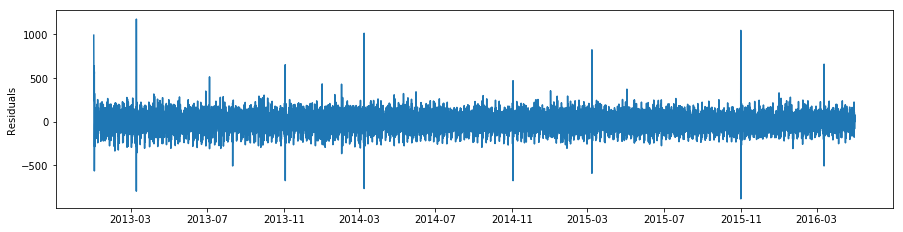

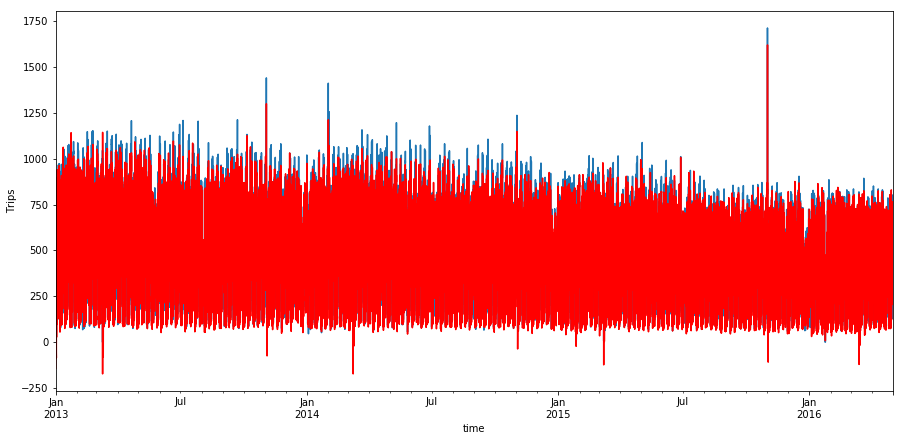

2. Forecast
End.
Start region_1224:
1. Train
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -102879.273
Date:                            Tue, 28 Nov 2017   AIC                         205834.547
Time:                                    05:36:29   BIC                         206149.239
Sample:                                         0   HQIC                        205935.652
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -3.

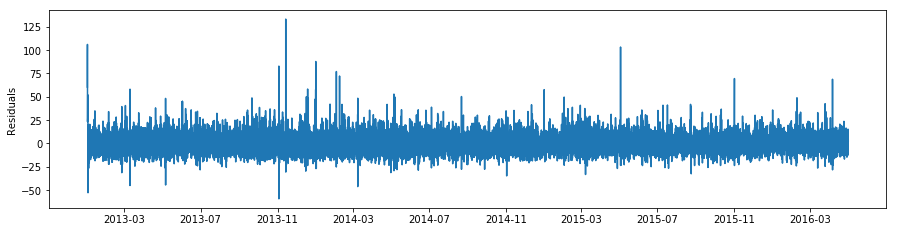

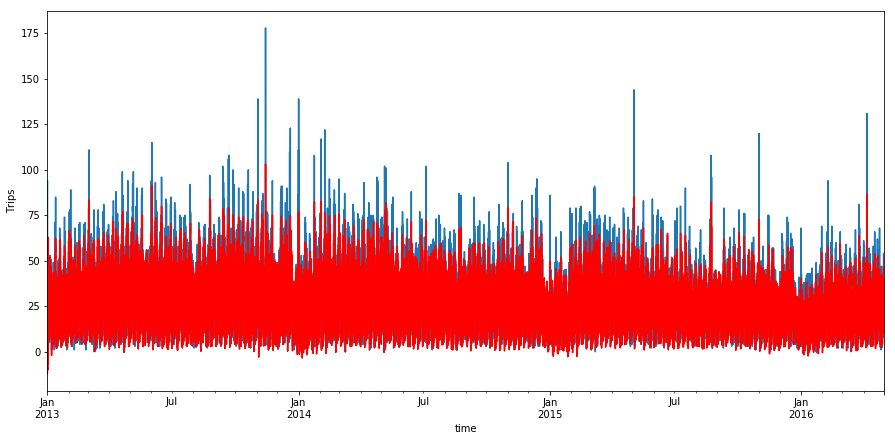

2. Forecast
End.
Start region_1229:
1. Train
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -168720.872
Date:                            Tue, 28 Nov 2017   AIC                         337517.744
Time:                                    07:26:25   BIC                         337832.437
Sample:                                         0   HQIC                        337618.850
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           -36.

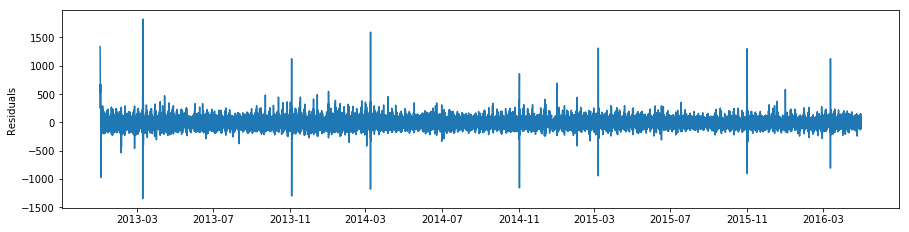

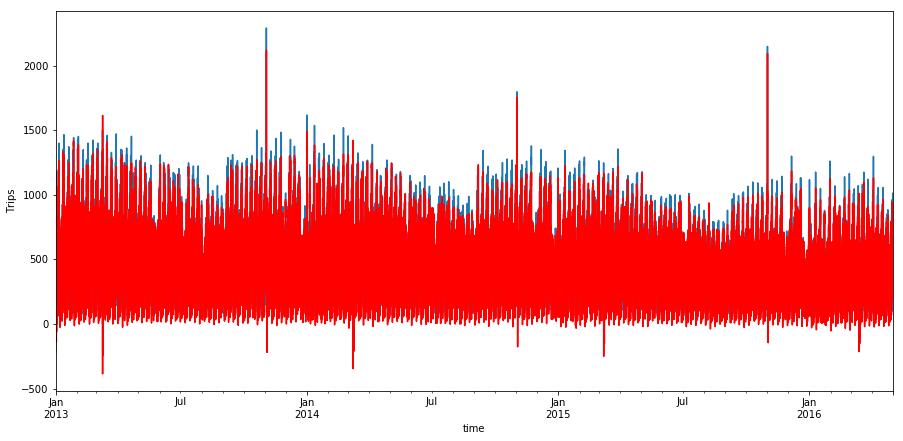

2. Forecast
End.
Start region_1230:
1. Train
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -176541.889
Date:                            Tue, 28 Nov 2017   AIC                         353159.777
Time:                                    09:23:50   BIC                         353474.470
Sample:                                         0   HQIC                        353260.883
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            32.

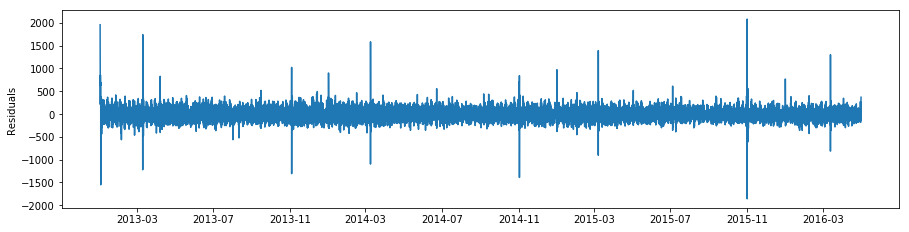

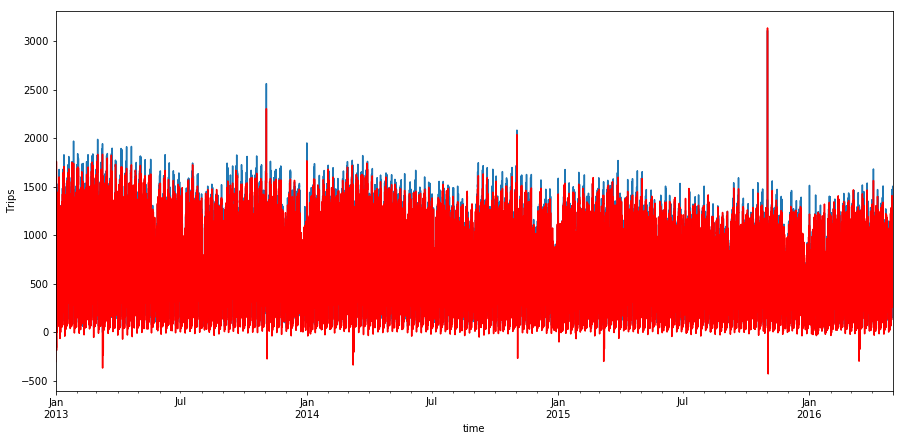

2. Forecast
End.
CPU times: user 2d 22min 55s, sys: 9h 5min 26s, total: 2d 9h 28min 21s
Wall time: 15h 34min 48s


In [43]:
%%time
result_3, errors_3 = regions_forecast(2, attr_3, 1, 1, 1, 1, 0, 1, 6, 10, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [287]:
write_best_params(2, result_3, 0, 1)

In [213]:
res_3_df = result_df(result_3, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)

In [216]:
res_3_df.to_csv("test_result/res_3.csv", sep=",", index=False)

### Прогнозирование значений рядов 4-го кластера

Start region_1076:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -134601.095
Date:                            Tue, 28 Nov 2017   AIC                         269282.190
Time:                                    17:40:38   BIC                         269613.445
Sample:                                         0   HQIC                        269388.617
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             6.5739  

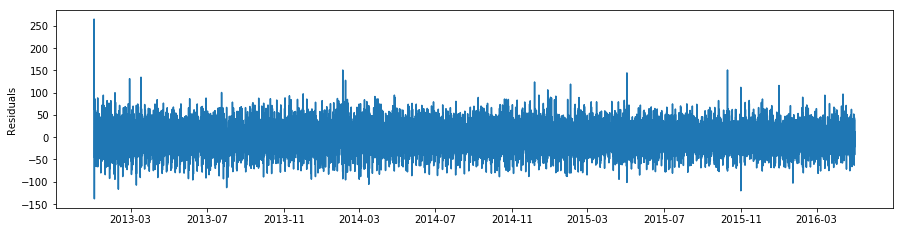

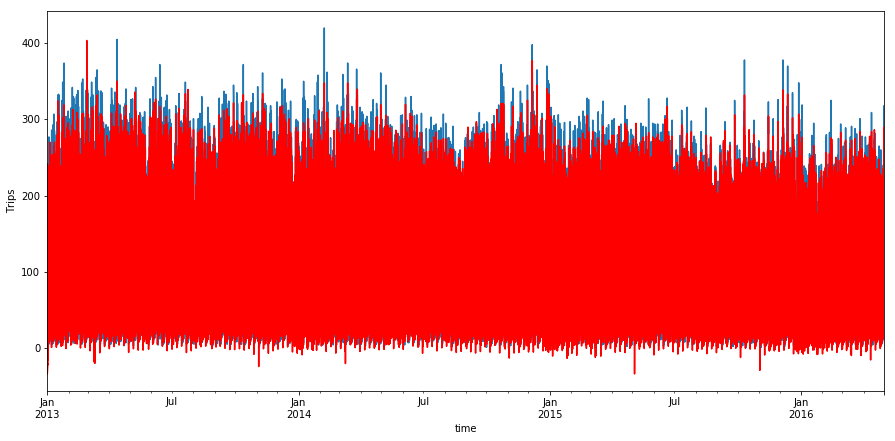

2. Forecast
End.
Start region_1077:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -130986.053
Date:                            Tue, 28 Nov 2017   AIC                         262052.105
Time:                                    20:07:12   BIC                         262383.360
Sample:                                         0   HQIC                        262158.532
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

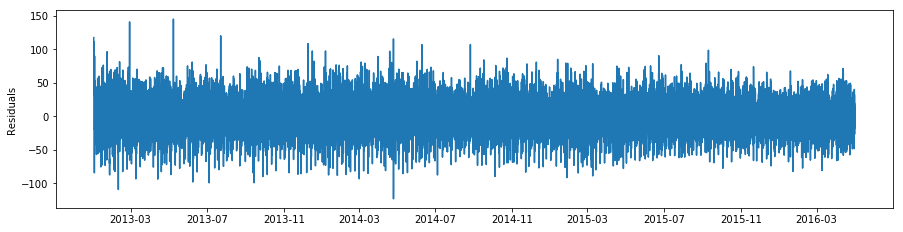

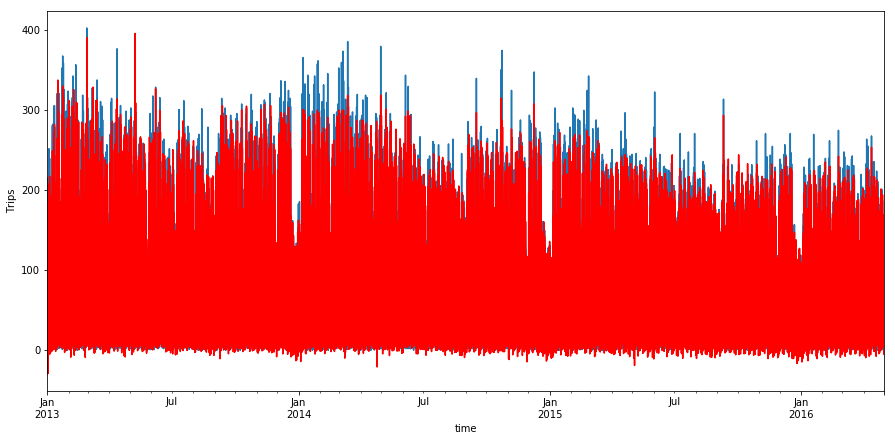

2. Forecast
End.
Start region_1132:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -126033.773
Date:                            Tue, 28 Nov 2017   AIC                         252147.547
Time:                                    21:53:15   BIC                         252478.802
Sample:                                         0   HQIC                        252253.973
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

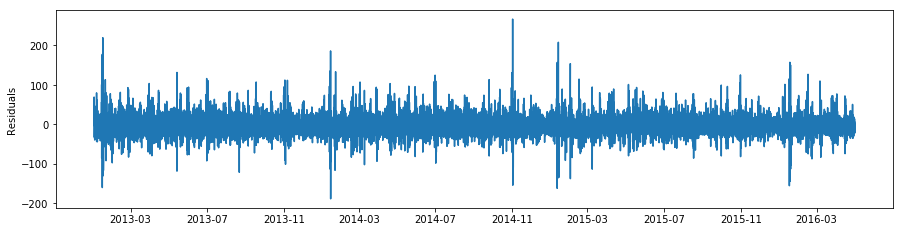

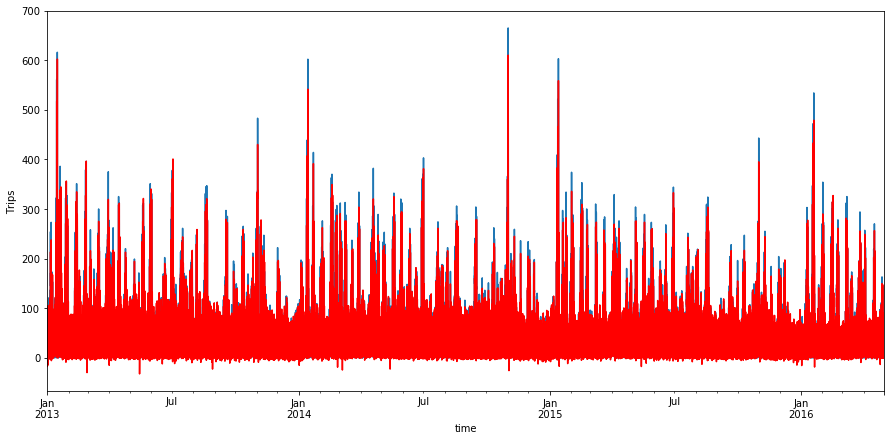

2. Forecast
End.
Start region_1181:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -181219.794
Date:                            Tue, 28 Nov 2017   AIC                         362519.588
Time:                                    23:48:48   BIC                         362850.843
Sample:                                         0   HQIC                        362626.015
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

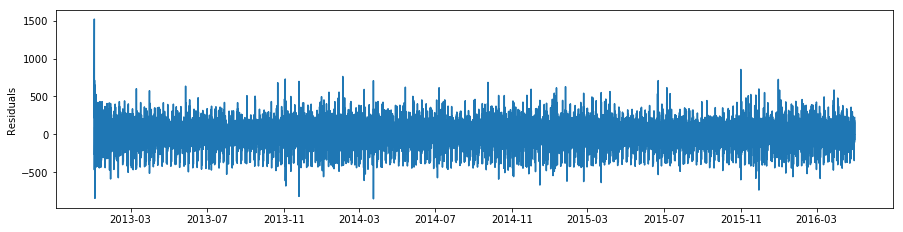

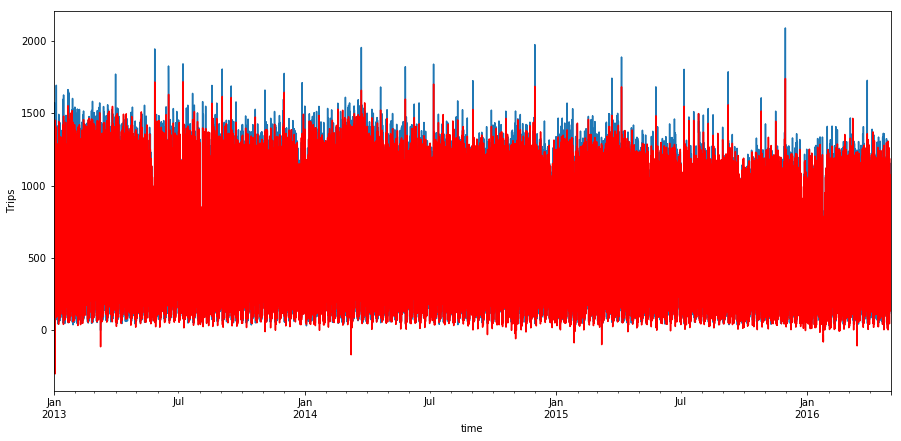

2. Forecast
End.
Start region_1183:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -144658.887
Date:                            Wed, 29 Nov 2017   AIC                         289397.774
Time:                                    01:47:06   BIC                         289729.029
Sample:                                         0   HQIC                        289504.201
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

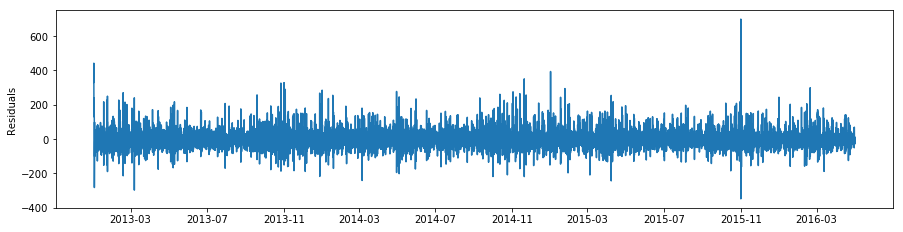

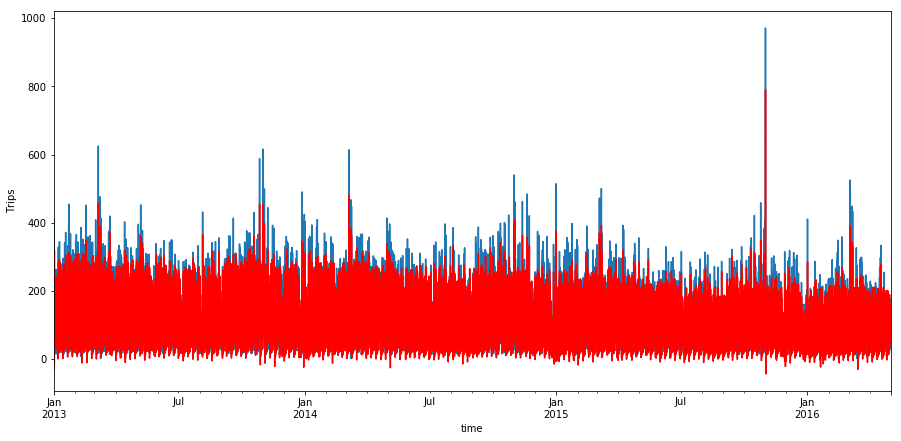

2. Forecast
End.
Start region_1184:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -100781.400
Date:                            Wed, 29 Nov 2017   AIC                         201642.801
Time:                                    04:11:55   BIC                         201974.056
Sample:                                         0   HQIC                        201749.227
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

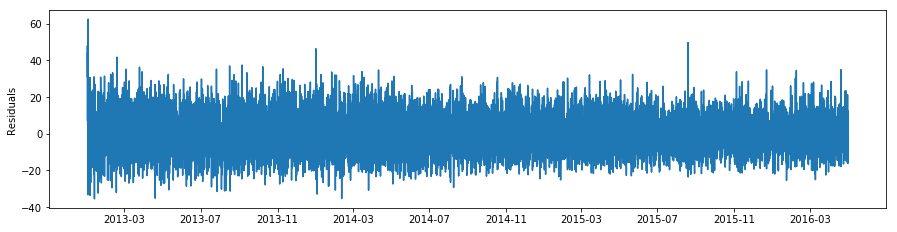

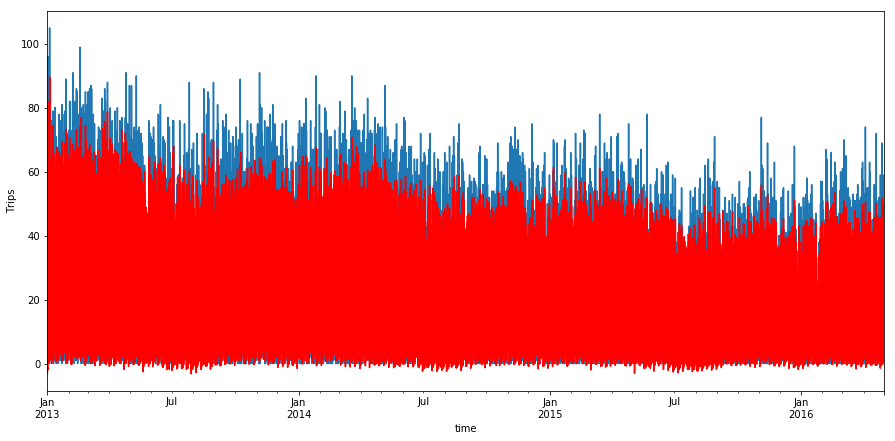

2. Forecast
End.
Start region_1234:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -161577.771
Date:                            Wed, 29 Nov 2017   AIC                         323235.542
Time:                                    06:12:17   BIC                         323566.798
Sample:                                         0   HQIC                        323341.969
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

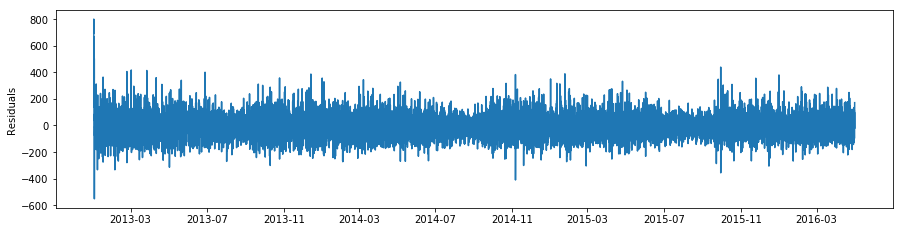

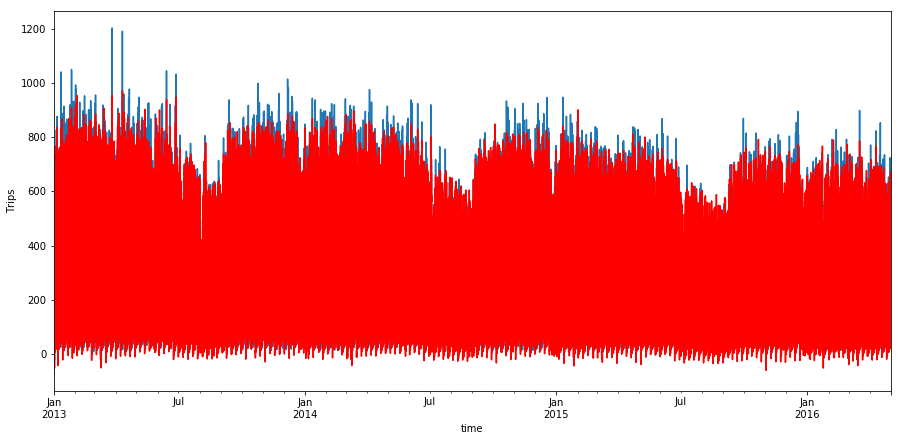

2. Forecast
End.
Start region_1235:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -137966.134
Date:                            Wed, 29 Nov 2017   AIC                         276012.269
Time:                                    08:36:58   BIC                         276343.524
Sample:                                         0   HQIC                        276118.696
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

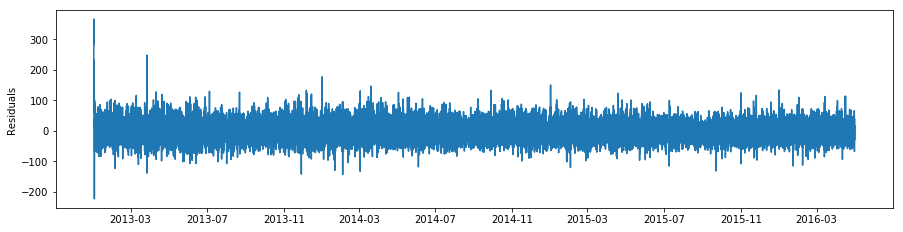

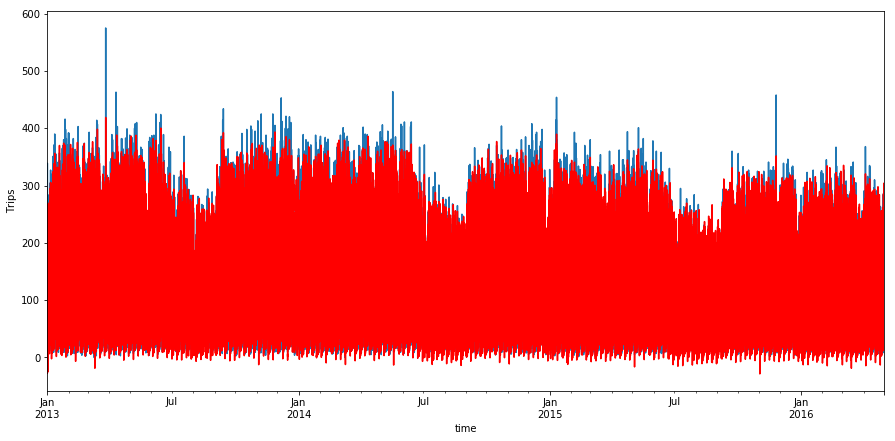

2. Forecast
End.
Start region_1279:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -108898.351
Date:                            Wed, 29 Nov 2017   AIC                         217876.702
Time:                                    11:23:35   BIC                         218207.957
Sample:                                         0   HQIC                        217983.129
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

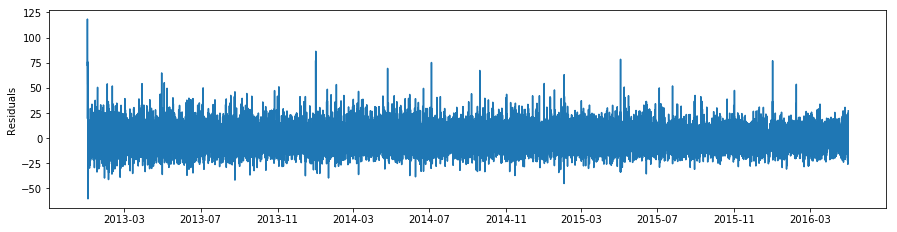

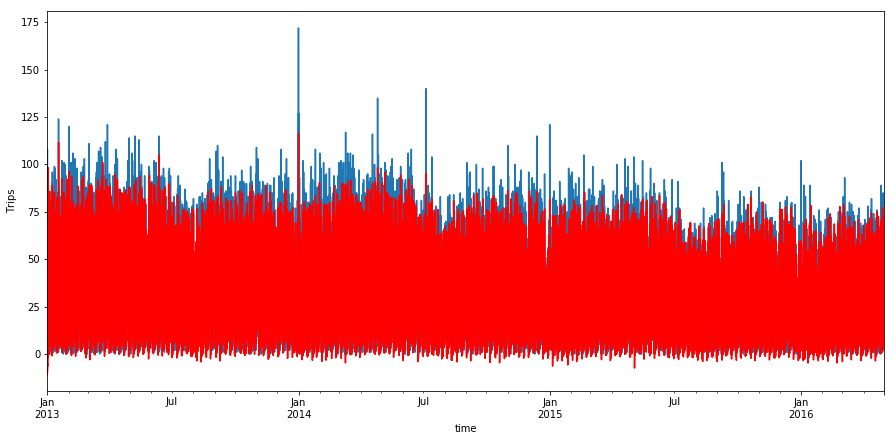

2. Forecast
End.
Start region_1280:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -145560.018
Date:                            Wed, 29 Nov 2017   AIC                         291200.036
Time:                                    13:31:10   BIC                         291531.291
Sample:                                         0   HQIC                        291306.463
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

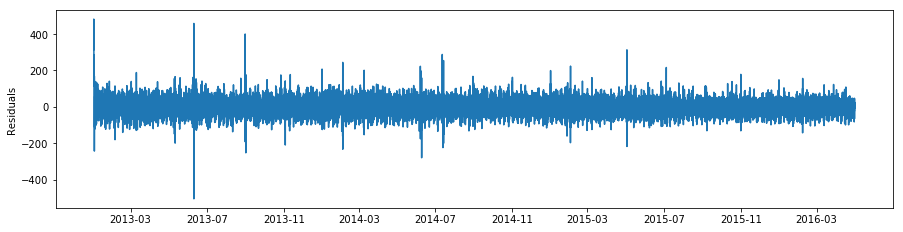

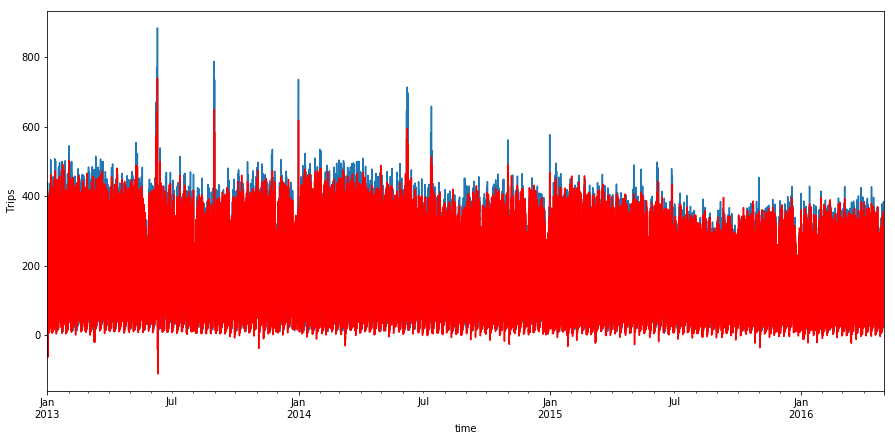

2. Forecast
End.
Start region_1284:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -129367.936
Date:                            Wed, 29 Nov 2017   AIC                         258815.871
Time:                                    16:15:26   BIC                         259147.126
Sample:                                         0   HQIC                        258922.298
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

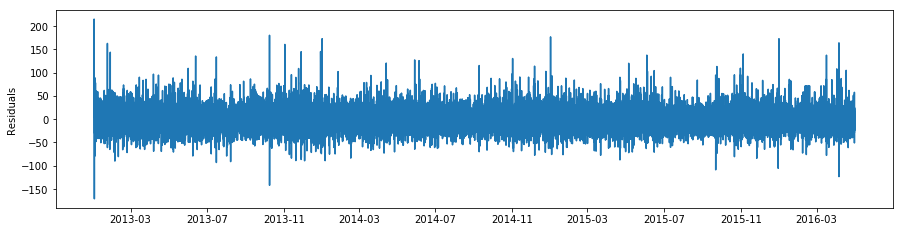

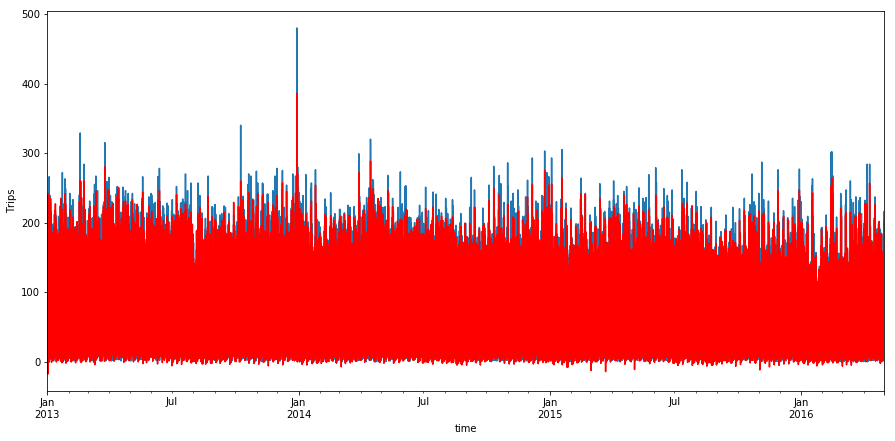

2. Forecast
End.
Start region_1285:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -150061.083
Date:                            Wed, 29 Nov 2017   AIC                         300202.165
Time:                                    18:48:54   BIC                         300533.420
Sample:                                         0   HQIC                        300308.592
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

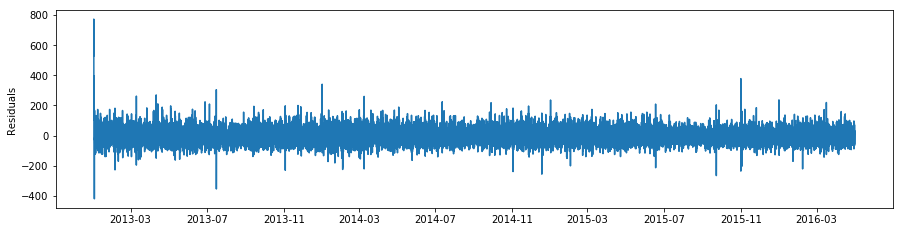

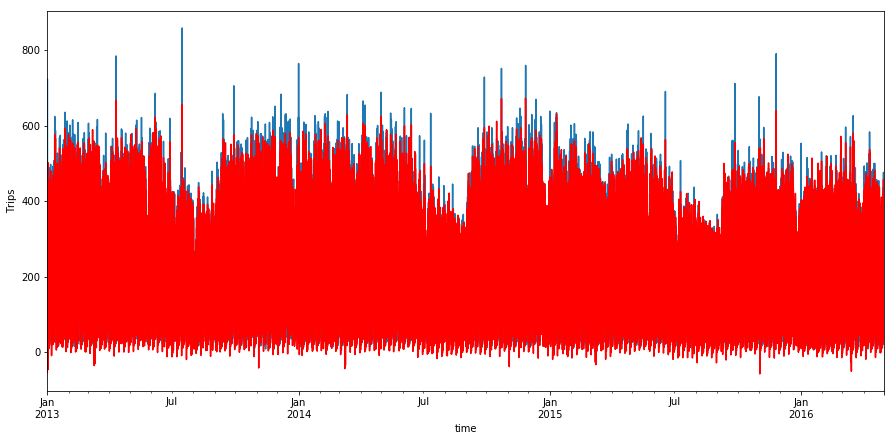

2. Forecast
End.
Start region_1286:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -146108.285
Date:                            Wed, 29 Nov 2017   AIC                         292296.570
Time:                                    20:48:24   BIC                         292627.825
Sample:                                         0   HQIC                        292402.996
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

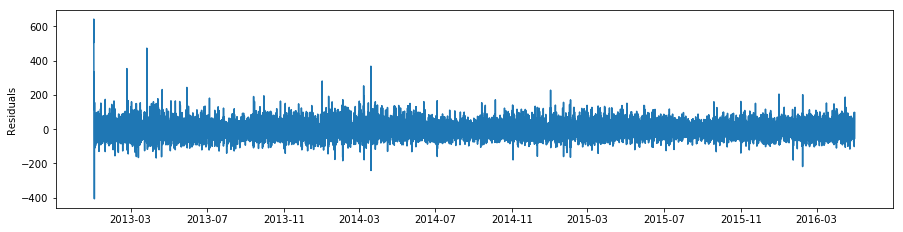

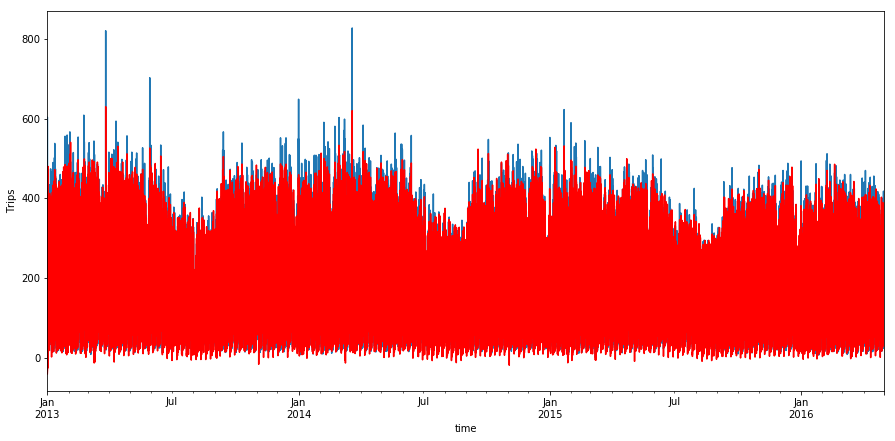

2. Forecast
End.
Start region_1287:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -123822.753
Date:                            Wed, 29 Nov 2017   AIC                         247725.506
Time:                                    23:16:24   BIC                         248056.761
Sample:                                         0   HQIC                        247831.933
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

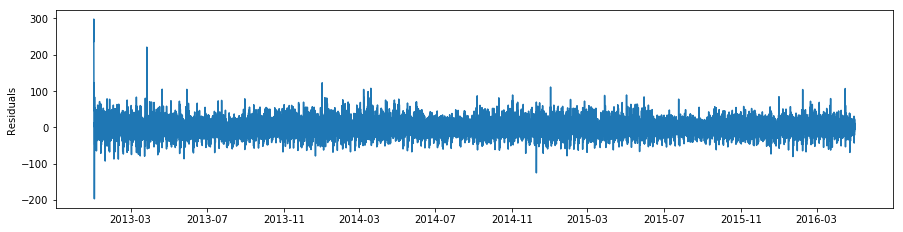

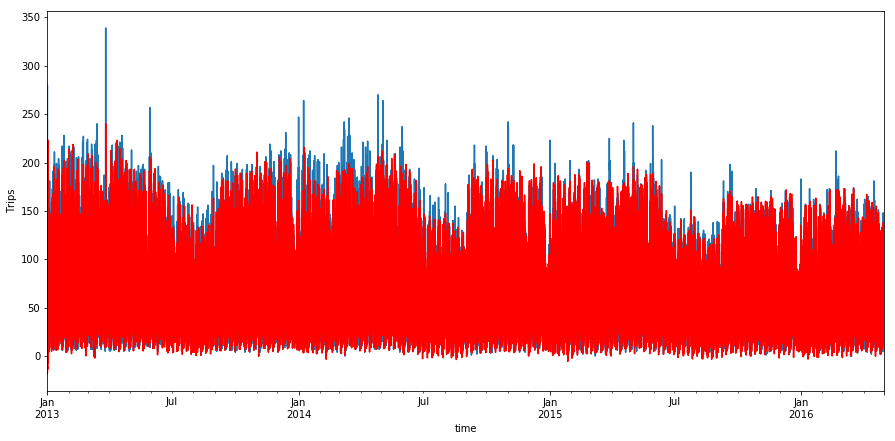

2. Forecast
End.
Start region_1331:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -116979.932
Date:                            Thu, 30 Nov 2017   AIC                         234039.864
Time:                                    02:06:44   BIC                         234371.119
Sample:                                         0   HQIC                        234146.290
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

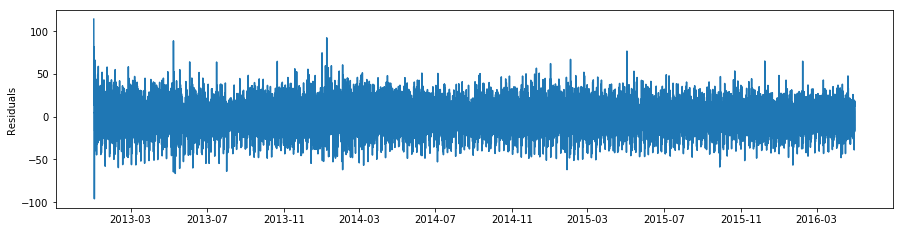

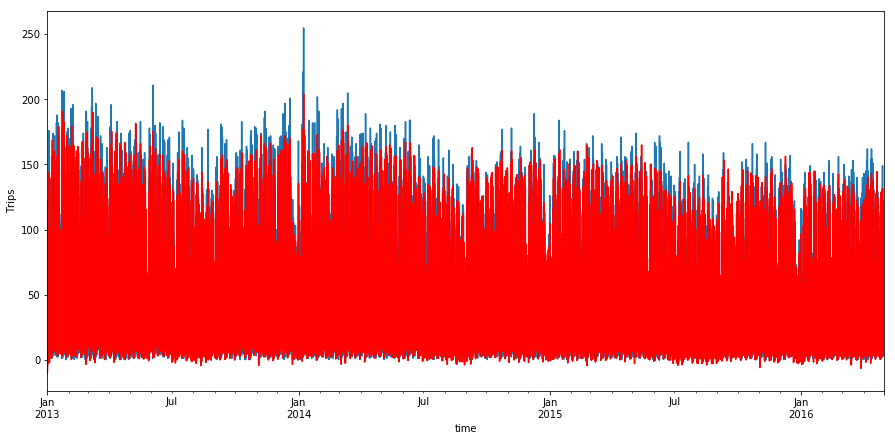

2. Forecast
End.
Start region_1332:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -160523.547
Date:                            Thu, 30 Nov 2017   AIC                         321127.095
Time:                                    04:14:52   BIC                         321458.350
Sample:                                         0   HQIC                        321233.521
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

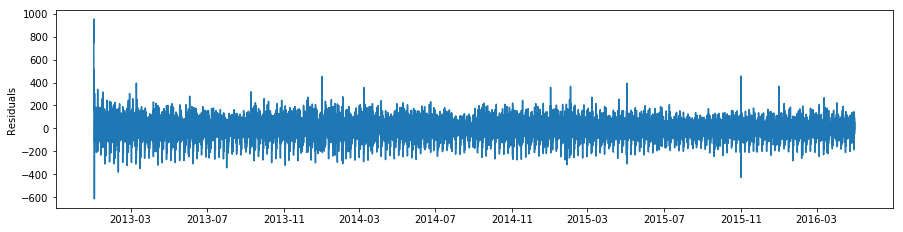

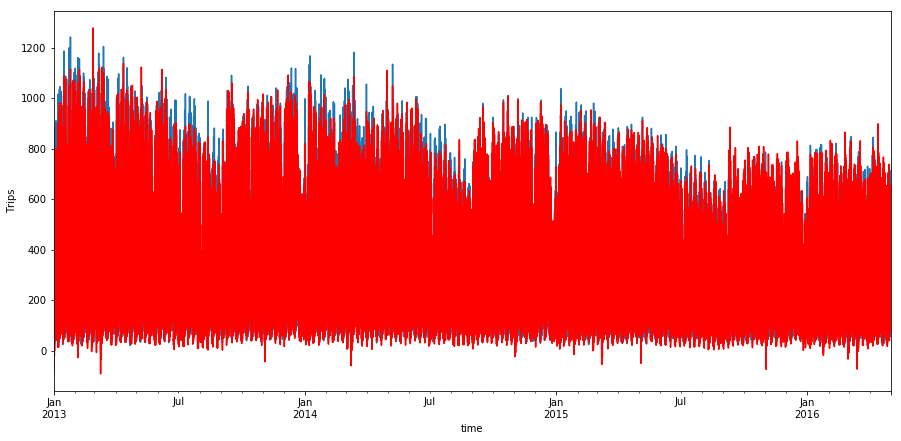

2. Forecast
End.
Start region_1333:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -169235.496
Date:                            Thu, 30 Nov 2017   AIC                         338550.991
Time:                                    06:32:13   BIC                         338882.246
Sample:                                         0   HQIC                        338657.418
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

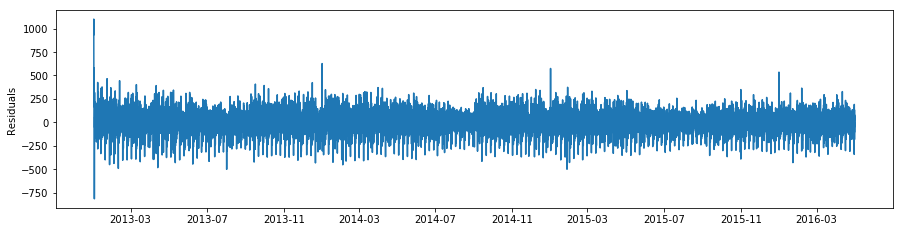

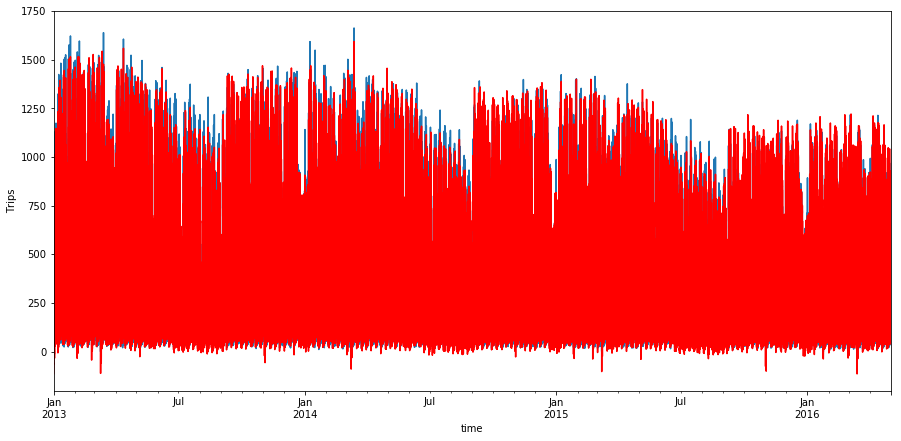

2. Forecast
End.
Start region_1334:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -163935.673
Date:                            Thu, 30 Nov 2017   AIC                         327951.347
Time:                                    08:47:24   BIC                         328282.602
Sample:                                         0   HQIC                        328057.773
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

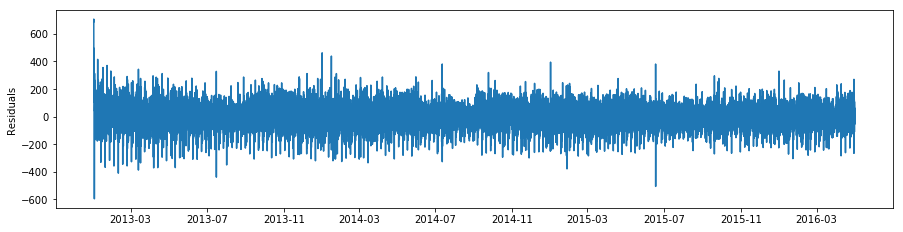

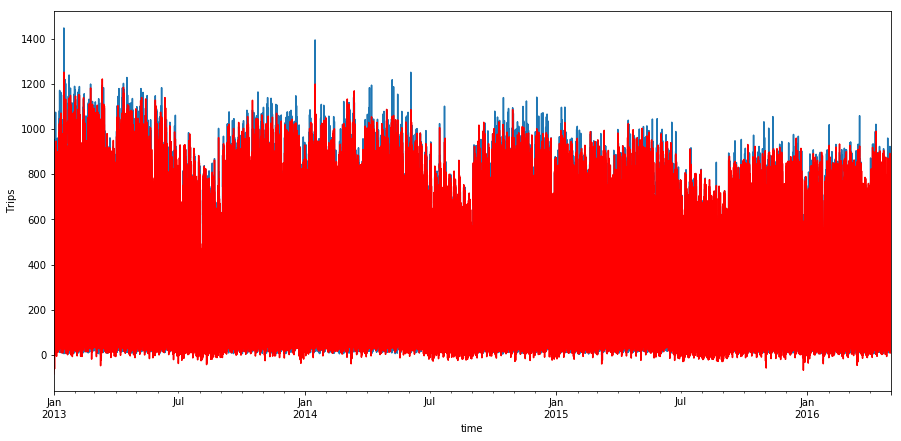

2. Forecast
End.
Start region_1335:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -134447.248
Date:                            Thu, 30 Nov 2017   AIC                         268974.497
Time:                                    10:29:44   BIC                         269305.752
Sample:                                         0   HQIC                        269080.923
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

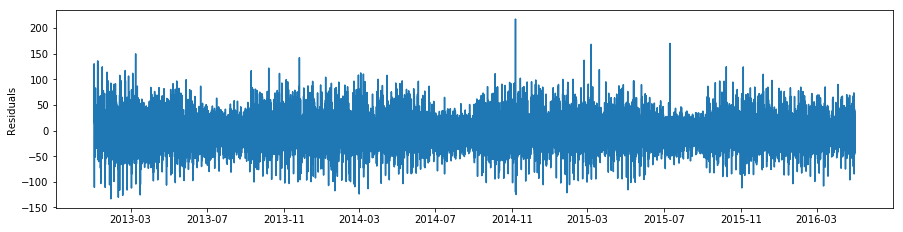

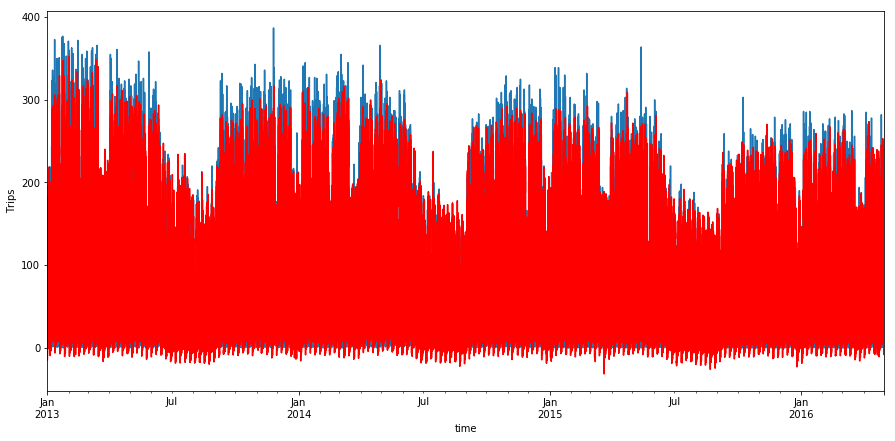

2. Forecast
End.
Start region_1336:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -119395.434
Date:                            Thu, 30 Nov 2017   AIC                         238870.867
Time:                                    12:40:34   BIC                         239202.122
Sample:                                         0   HQIC                        238977.294
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

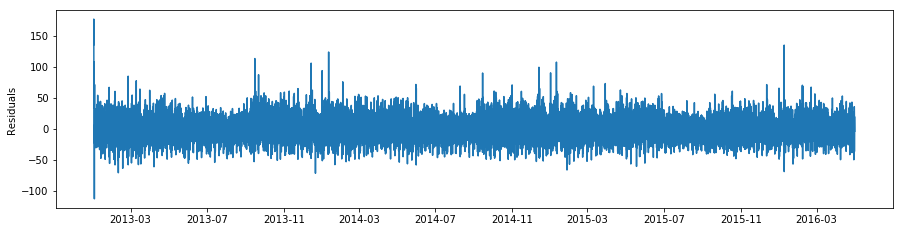

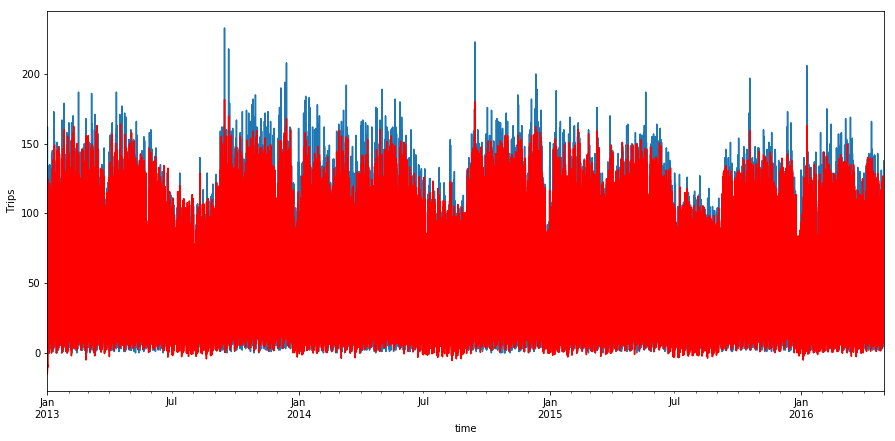

2. Forecast
End.
Start region_1383:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -151909.465
Date:                            Thu, 30 Nov 2017   AIC                         303898.930
Time:                                    14:47:26   BIC                         304230.185
Sample:                                         0   HQIC                        304005.356
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

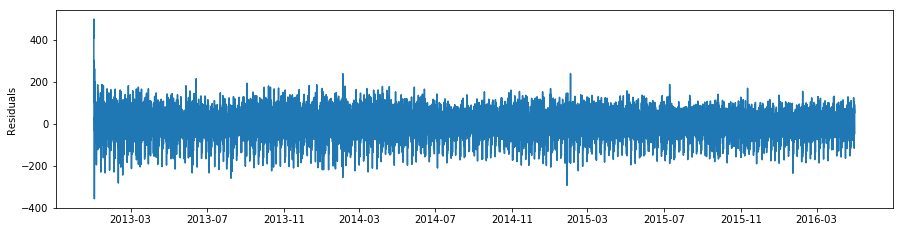

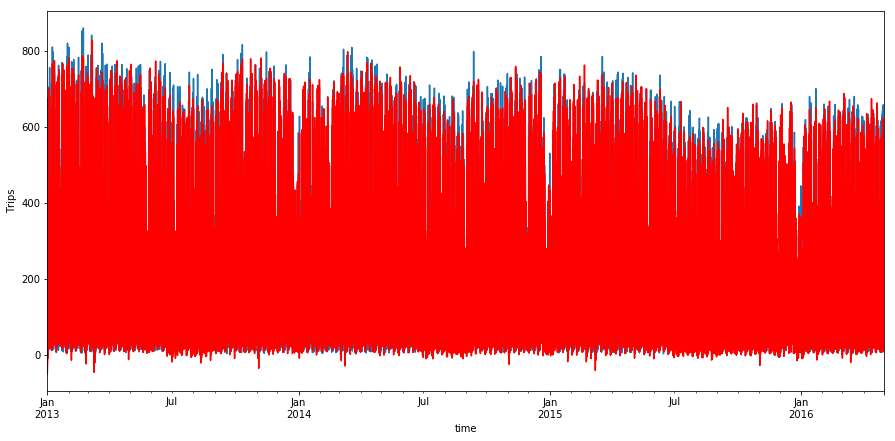

2. Forecast
End.
Start region_1384:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -166197.283
Date:                            Thu, 30 Nov 2017   AIC                         332474.566
Time:                                    17:11:05   BIC                         332805.821
Sample:                                         0   HQIC                        332580.992
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

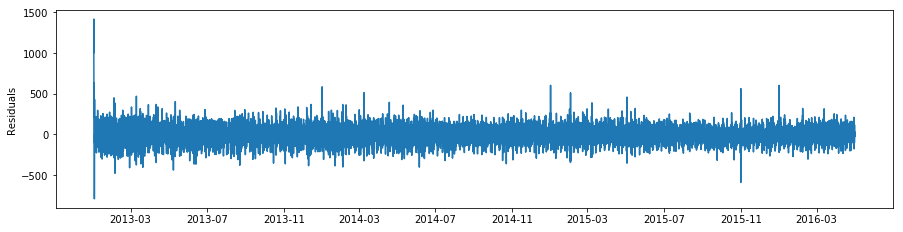

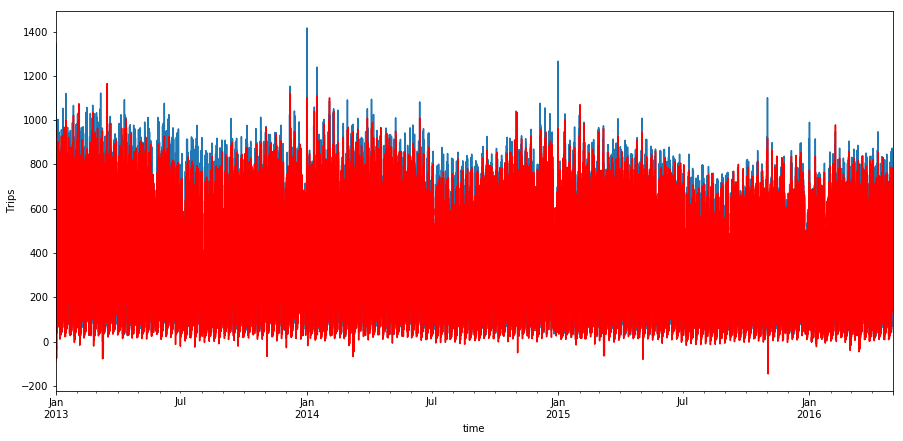

2. Forecast
End.
Start region_1385:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -151381.122
Date:                            Thu, 30 Nov 2017   AIC                         302842.245
Time:                                    19:14:06   BIC                         303173.500
Sample:                                         0   HQIC                        302948.671
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

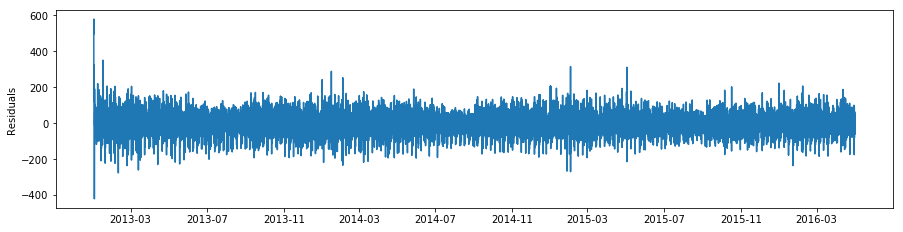

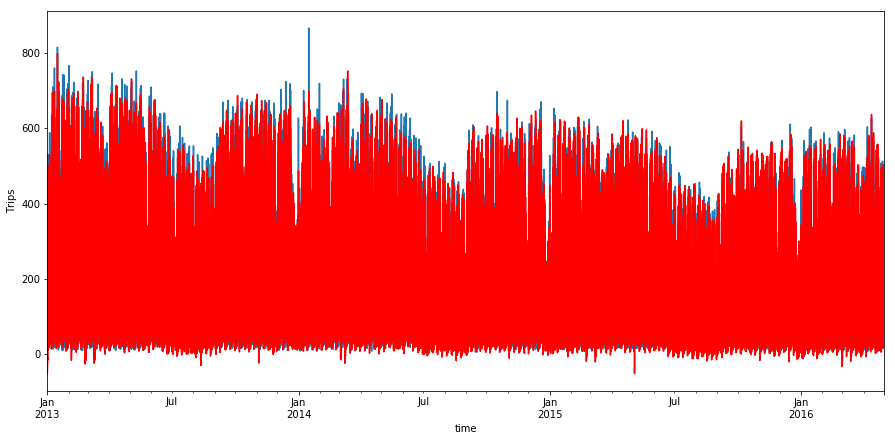

2. Forecast
End.
Start region_1434:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -82950.352
Date:                            Thu, 30 Nov 2017   AIC                         165980.704
Time:                                    21:30:23   BIC                         166311.959
Sample:                                         0   HQIC                        166087.131
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

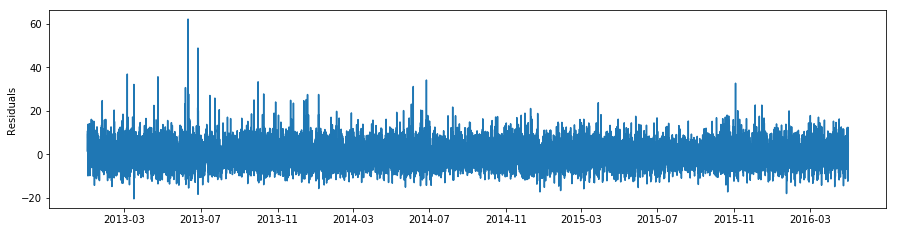

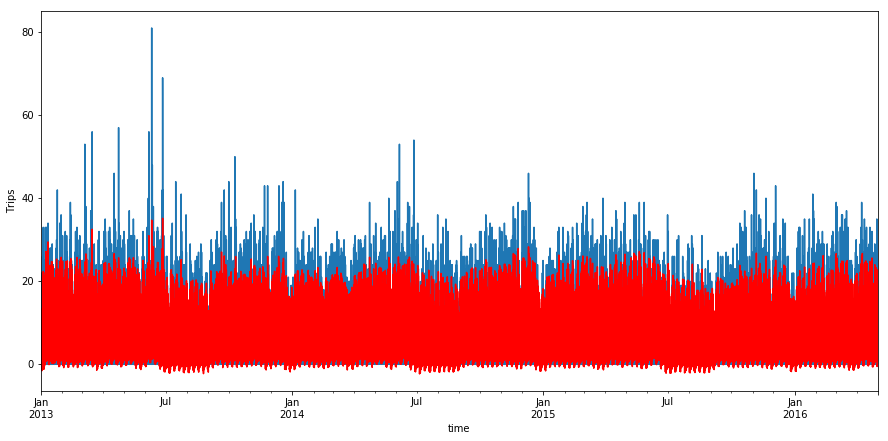

2. Forecast
End.


In [278]:
result_4, errors_4 = regions_forecast(3, attr_4, 1, 1, 1, 1, 0, 1, 5, 12, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [288]:
write_best_params(3, result_4, 0, 1)

In [290]:
res_4_df = result_df(result_4, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_4_df.to_csv("test_result/res_4.csv", sep=",", index=False)

### Прогнозирование значений рядов 5-го кластера

Start region_1480:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -89399.596
Date:                            Fri, 01 Dec 2017   AIC                         178871.192
Time:                                    19:05:34   BIC                         179169.321
Sample:                                         0   HQIC                        178966.976
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -2.0391  

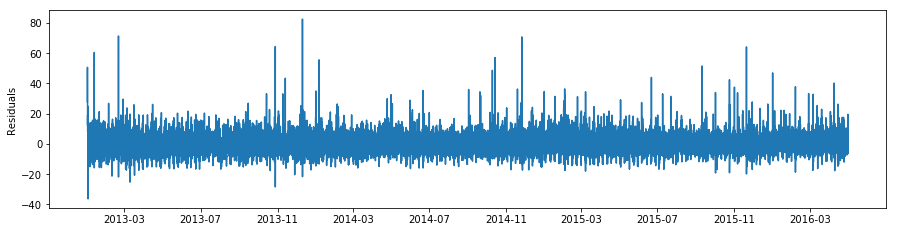

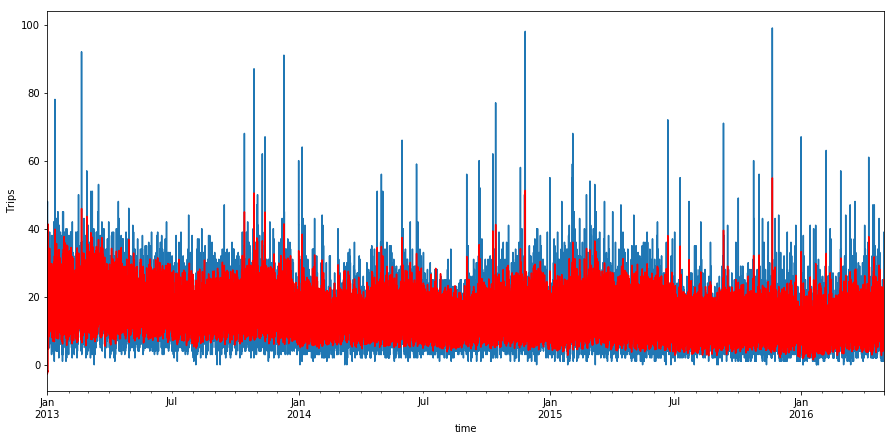

2. Forecast
End.
Start region_1483:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -88526.416
Date:                            Fri, 01 Dec 2017   AIC                         177124.831
Time:                                    21:22:40   BIC                         177422.961
Sample:                                         0   HQIC                        177220.615
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

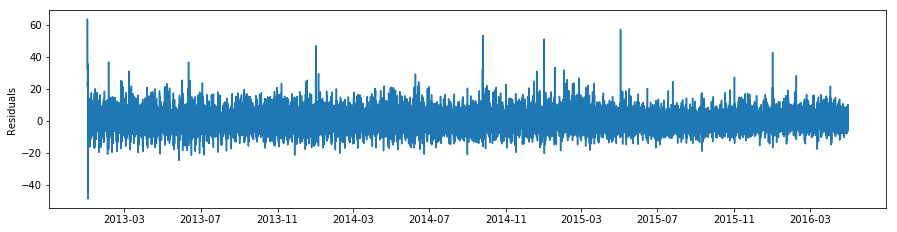

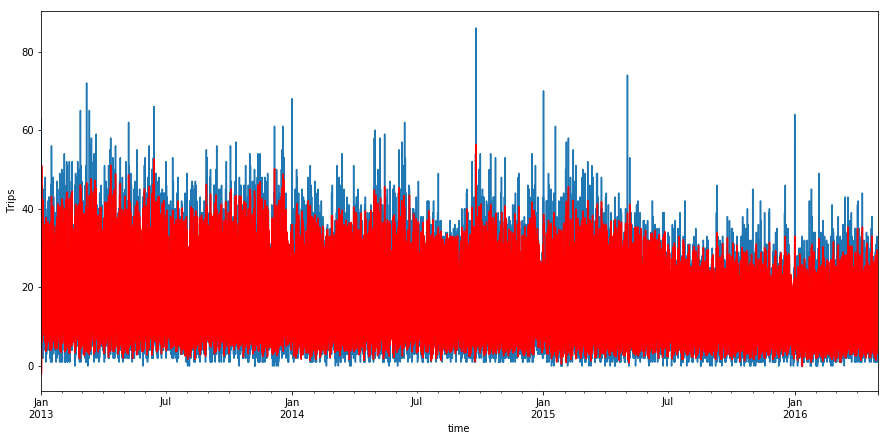

2. Forecast
End.
Start region_1530:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -95046.256
Date:                            Fri, 01 Dec 2017   AIC                         190164.513
Time:                                    23:00:08   BIC                         190462.642
Sample:                                         0   HQIC                        190260.297
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

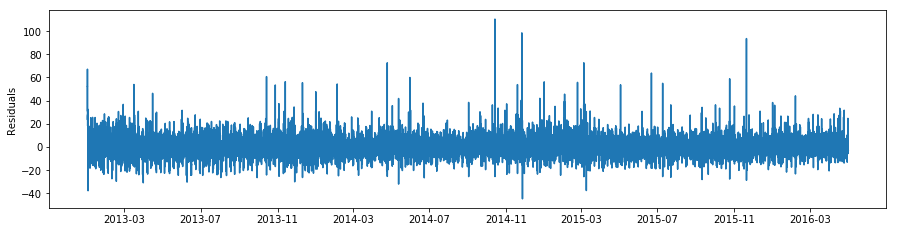

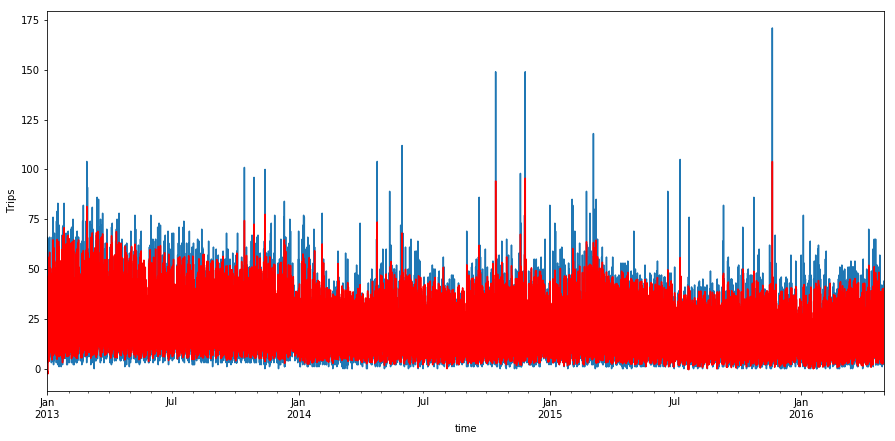

2. Forecast
End.
Start region_1580:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -75294.521
Date:                            Sat, 02 Dec 2017   AIC                         150661.041
Time:                                    02:07:11   BIC                         150959.171
Sample:                                         0   HQIC                        150756.825
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

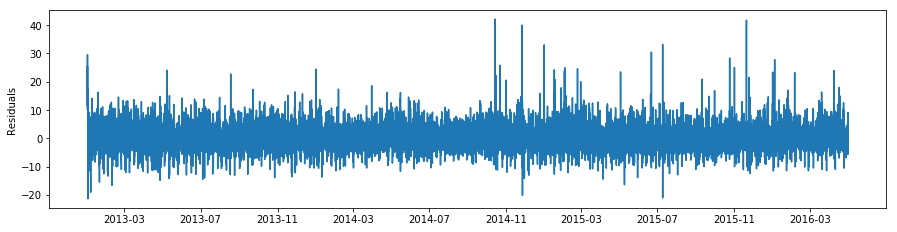

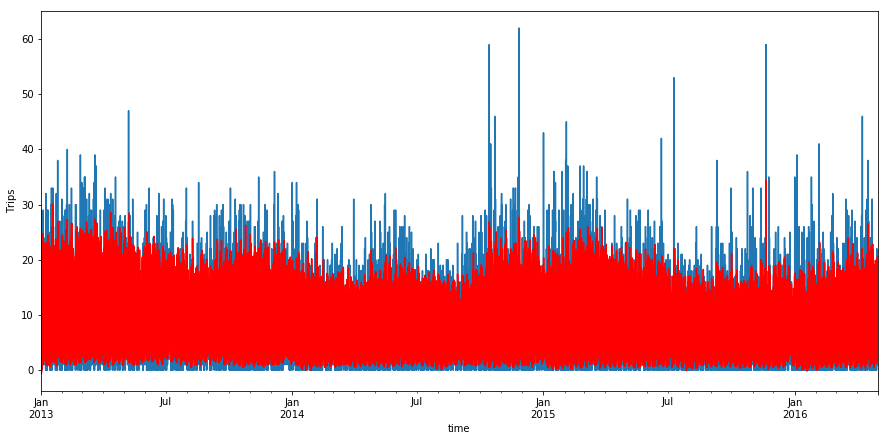

2. Forecast
End.
CPU times: user 1d 5h 16min 2s, sys: 5h 45min 43s, total: 1d 11h 1min 45s
Wall time: 9h 29min 19s


In [118]:
%%time
result_5, errors_5 = regions_forecast(4, attr_5, 1, 1, 1, 1, 0, 1, 6, 9, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [121]:
write_best_params(4, result_5, 0, 1)

In [122]:
res_5_df = result_df(result_5, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_5_df.to_csv("test_result/res_5.csv", sep=",", index=False)

### Прогнозирование значений рядов 6-го кластера

Start region_1075:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -119036.877
Date:                            Sat, 02 Dec 2017   AIC                         238161.754
Time:                                    21:21:55   BIC                         238526.134
Sample:                                         0   HQIC                        238278.823
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             4.7274  

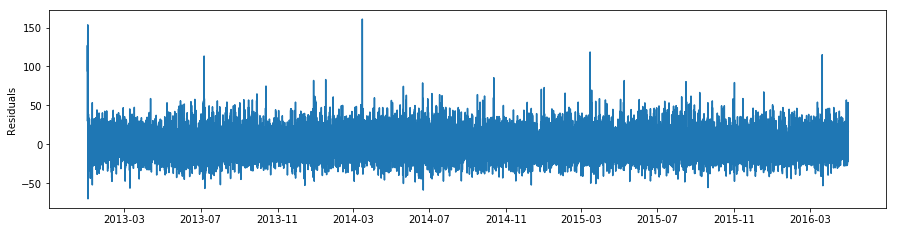

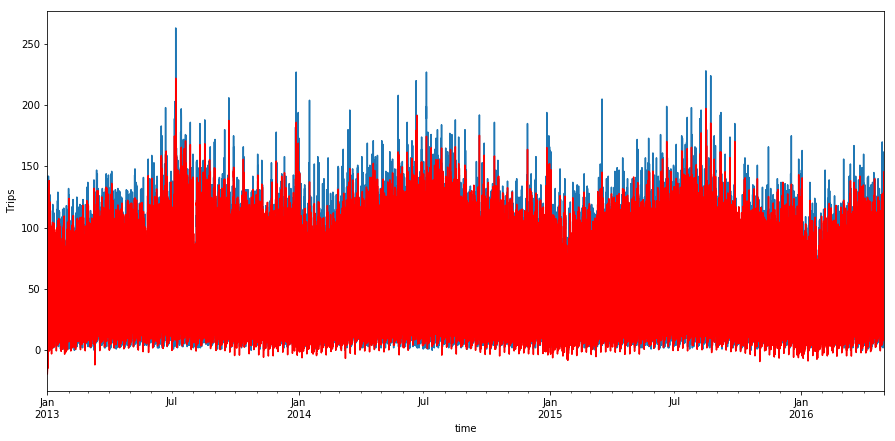

2. Forecast
End.
Start region_1125:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -122428.883
Date:                            Sun, 03 Dec 2017   AIC                         244945.766
Time:                                    00:29:55   BIC                         245310.147
Sample:                                         0   HQIC                        245062.836
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

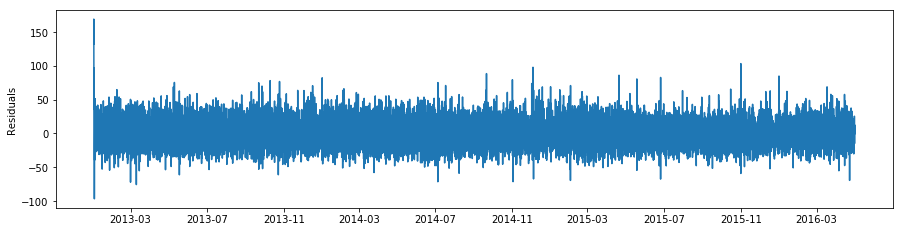

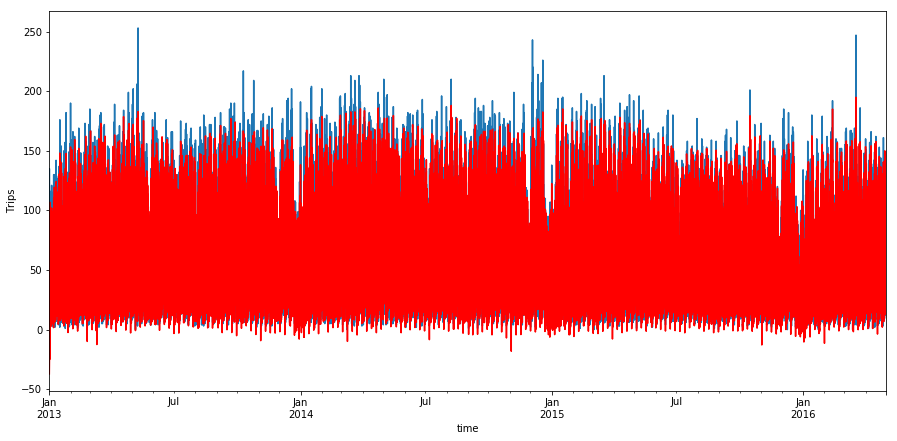

2. Forecast
End.
Start region_1126:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -141832.444
Date:                            Sun, 03 Dec 2017   AIC                         283752.889
Time:                                    03:36:33   BIC                         284117.269
Sample:                                         0   HQIC                        283869.958
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

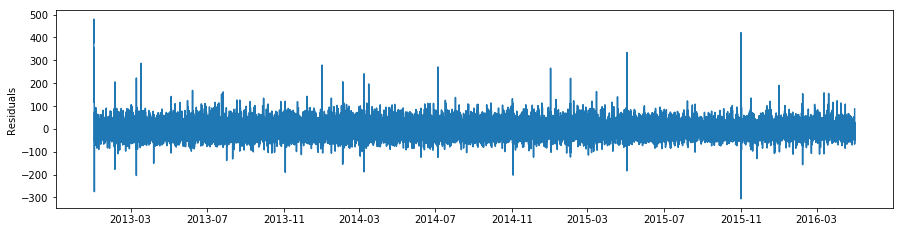

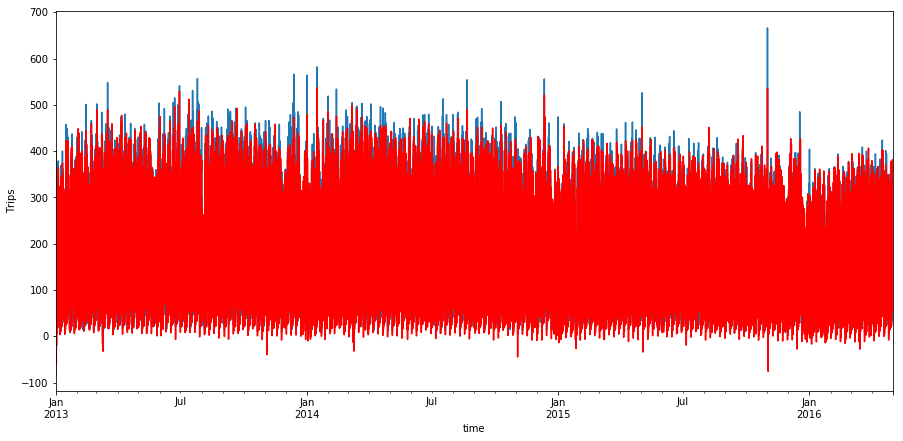

2. Forecast
End.
Start region_1180:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -169018.164
Date:                            Sun, 03 Dec 2017   AIC                         338124.328
Time:                                    06:12:20   BIC                         338488.709
Sample:                                         0   HQIC                        338241.398
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

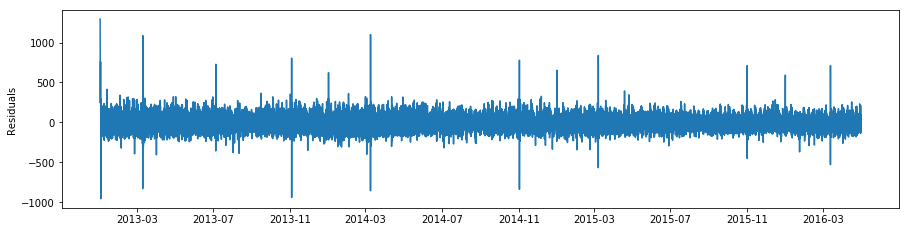

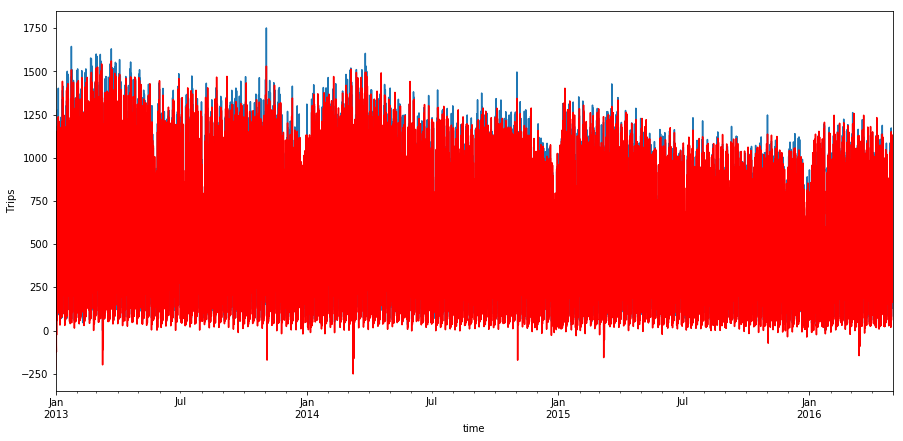

2. Forecast
End.
Start region_1231:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -173858.057
Date:                            Sun, 03 Dec 2017   AIC                         347804.114
Time:                                    08:43:58   BIC                         348168.494
Sample:                                         0   HQIC                        347921.183
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

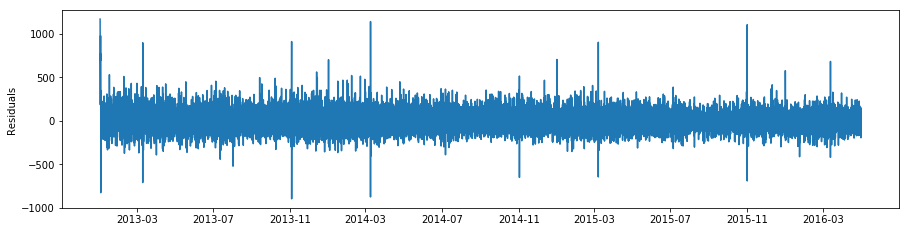

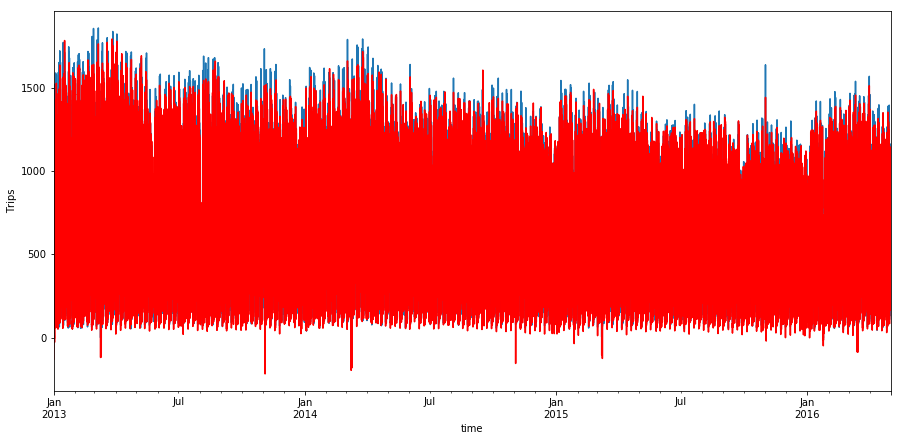

2. Forecast
End.
Start region_1232:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -179226.713
Date:                            Sun, 03 Dec 2017   AIC                         358541.427
Time:                                    11:36:24   BIC                         358905.807
Sample:                                         0   HQIC                        358658.496
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

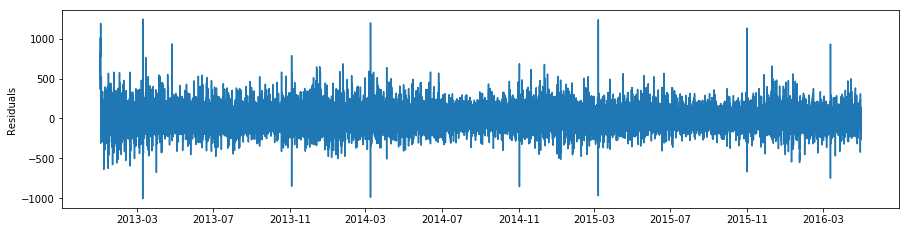

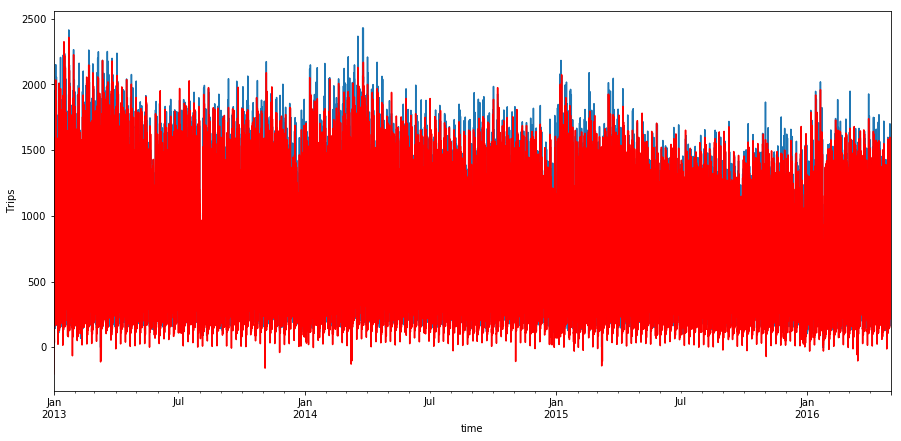

2. Forecast
End.
Start region_1233:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -171086.511
Date:                            Sun, 03 Dec 2017   AIC                         342261.021
Time:                                    14:45:11   BIC                         342625.402
Sample:                                         0   HQIC                        342378.091
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

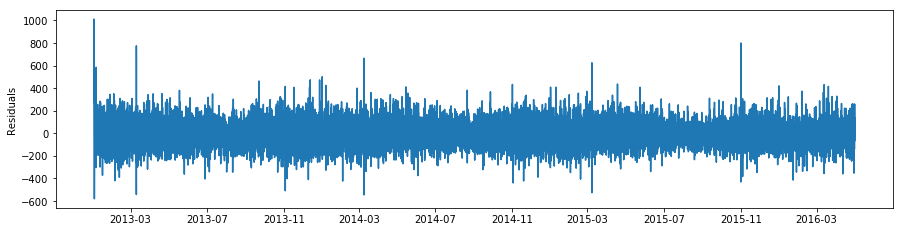

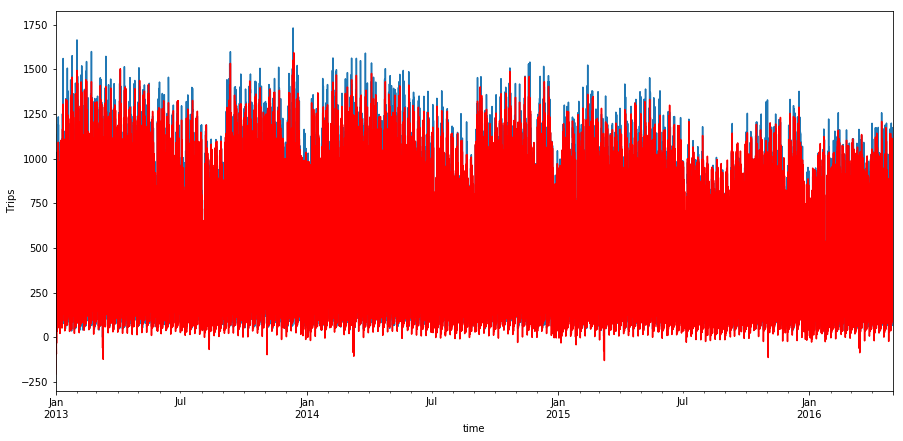

2. Forecast
End.
Start region_1281:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -175223.026
Date:                            Sun, 03 Dec 2017   AIC                         350534.051
Time:                                    18:17:35   BIC                         350898.432
Sample:                                         0   HQIC                        350651.120
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

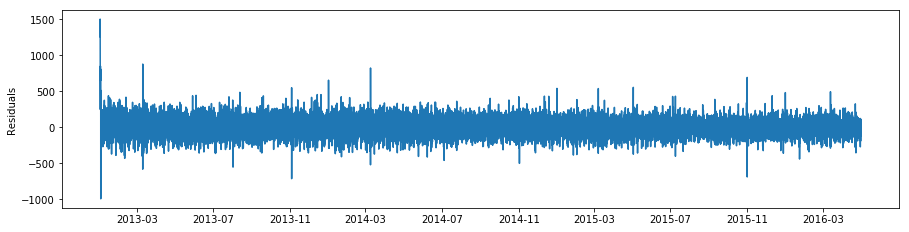

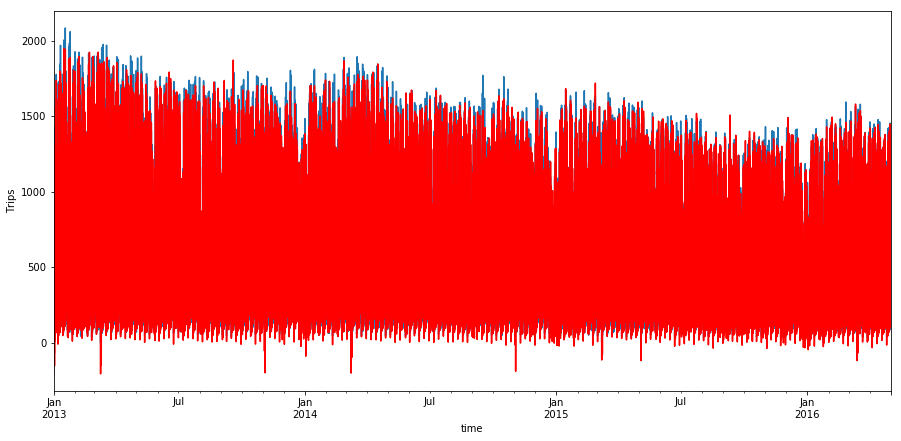

2. Forecast
End.
Start region_1282:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -182553.444
Date:                            Sun, 03 Dec 2017   AIC                         365194.889
Time:                                    21:16:57   BIC                         365559.269
Sample:                                         0   HQIC                        365311.958
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

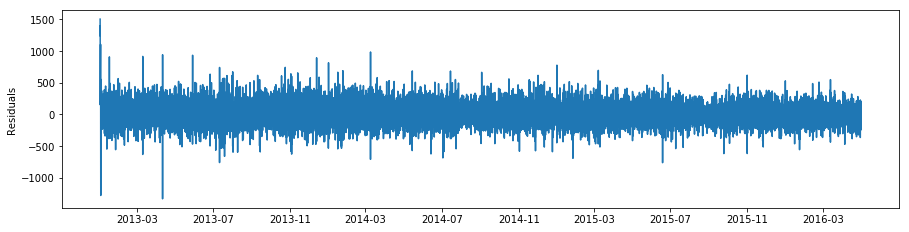

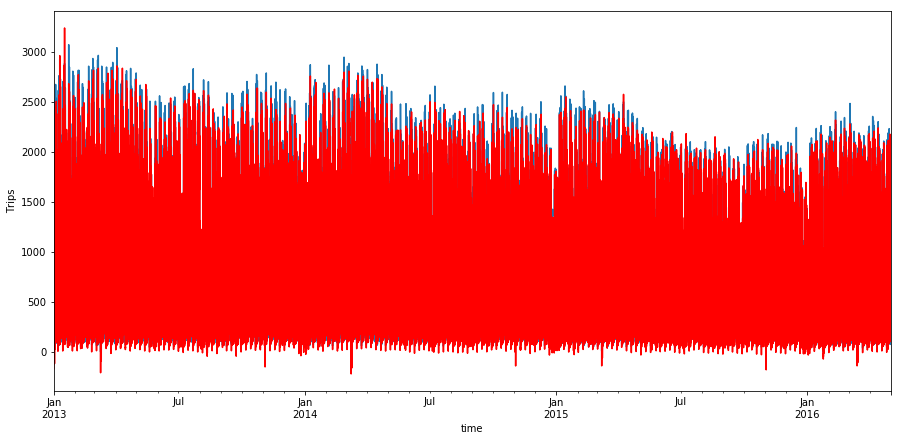

2. Forecast
End.
Start region_1283:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -147871.016
Date:                            Mon, 04 Dec 2017   AIC                         295830.031
Time:                                    00:03:39   BIC                         296194.412
Sample:                                         0   HQIC                        295947.100
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

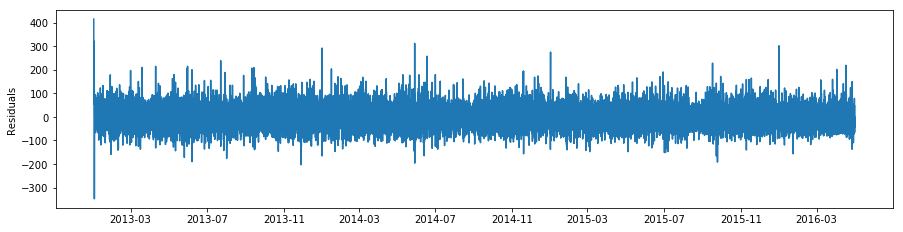

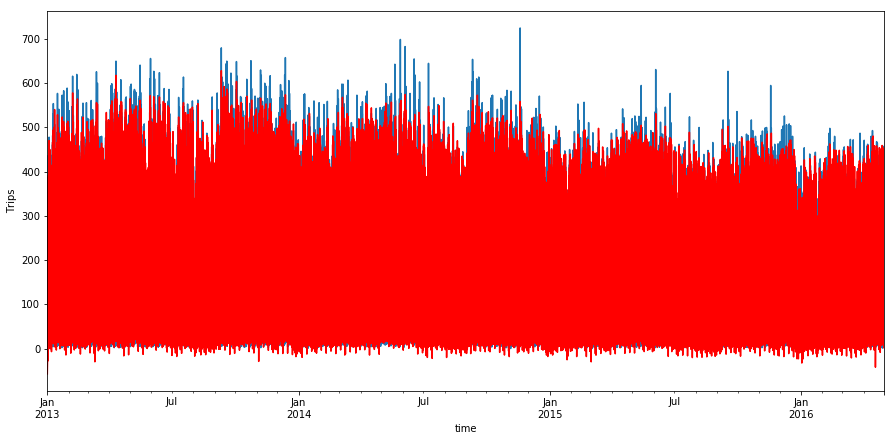

2. Forecast
End.
Start region_1382:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -97862.308
Date:                            Mon, 04 Dec 2017   AIC                         195812.617
Time:                                    03:05:30   BIC                         196176.997
Sample:                                         0   HQIC                        195929.686
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

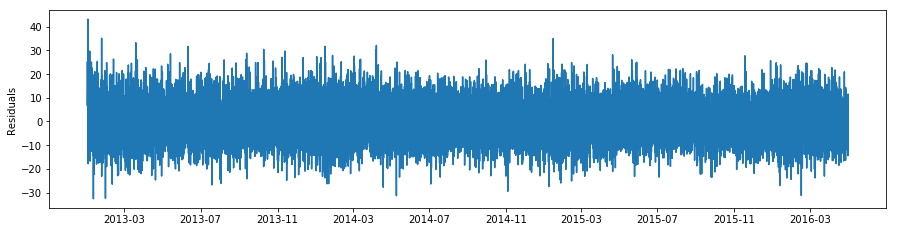

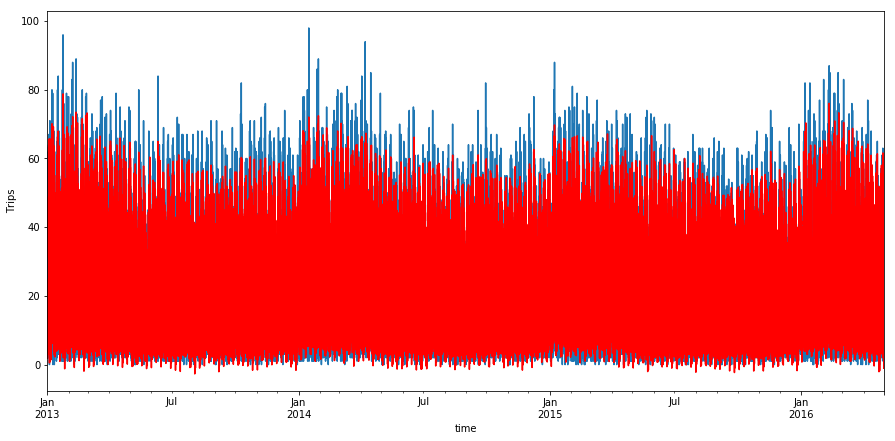

2. Forecast
End.


In [186]:
result_6, errors_6 = regions_forecast(5, attr_6, 1, 1, 1, 1, 0, 1, 6, 13, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [189]:
write_best_params(5, result_6, 0, 1)

In [190]:
res_6_df = result_df(result_6, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_6_df.to_csv("test_result/res_6.csv", sep=",", index=False)

### Прогнозирование значений рядов 7-го кластера

Start region_1172:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -82779.644
Date:                            Mon, 04 Dec 2017   AIC                         165655.289
Time:                                    12:56:34   BIC                         166052.795
Sample:                                         0   HQIC                        165783.001
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -1.3626  

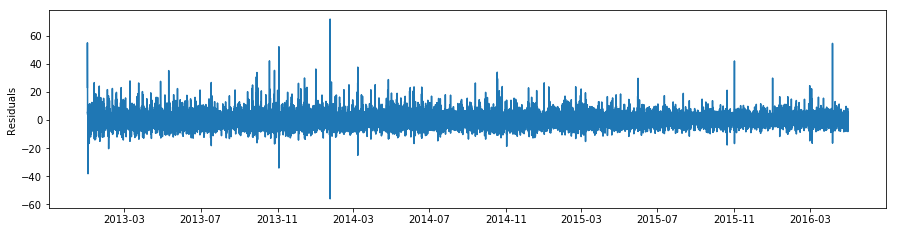

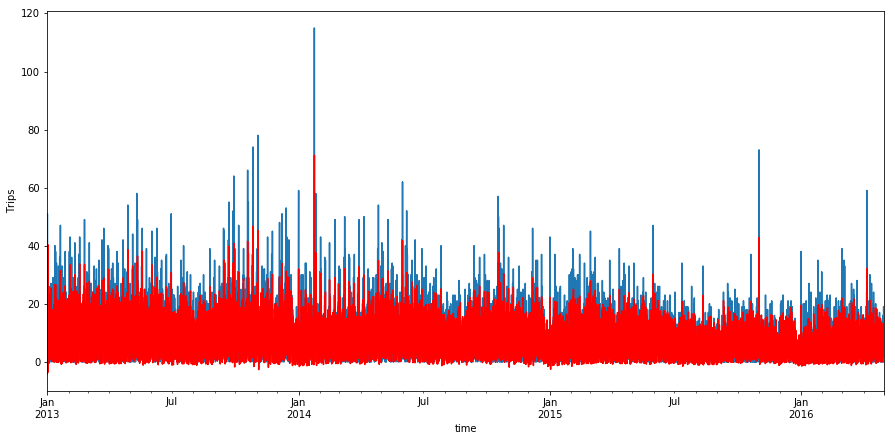

2. Forecast
End.
Start region_1173:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -109608.856
Date:                            Mon, 04 Dec 2017   AIC                         219313.713
Time:                                    16:12:54   BIC                         219711.219
Sample:                                         0   HQIC                        219441.425
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

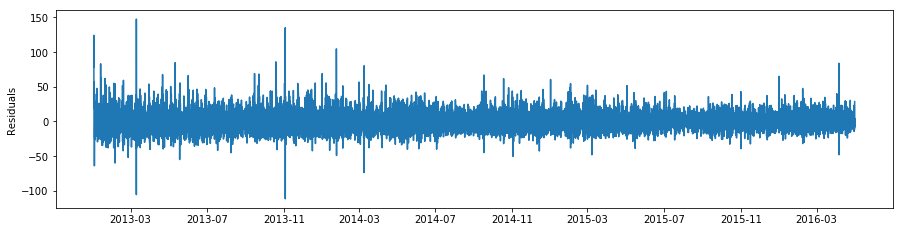

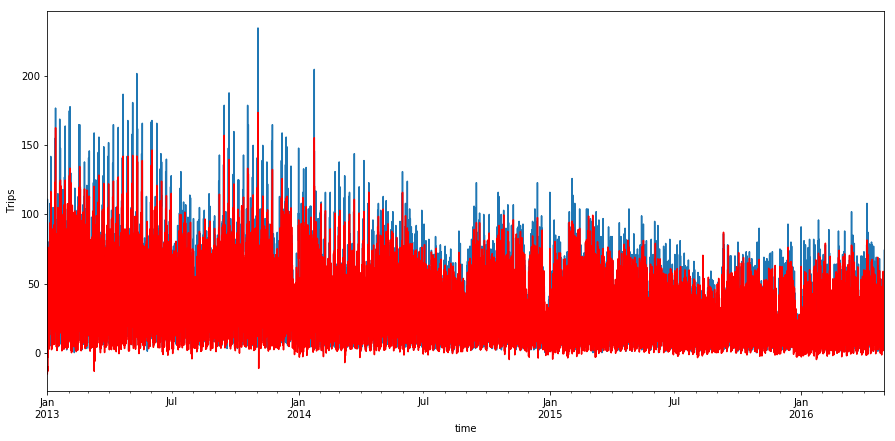

2. Forecast
End.
Start region_1174:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -110365.181
Date:                            Mon, 04 Dec 2017   AIC                         220826.362
Time:                                    19:39:32   BIC                         221223.868
Sample:                                         0   HQIC                        220954.074
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

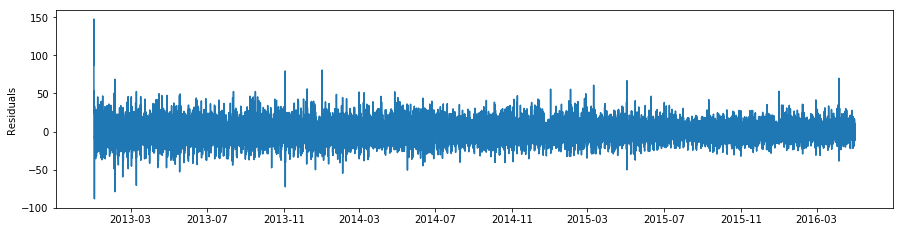

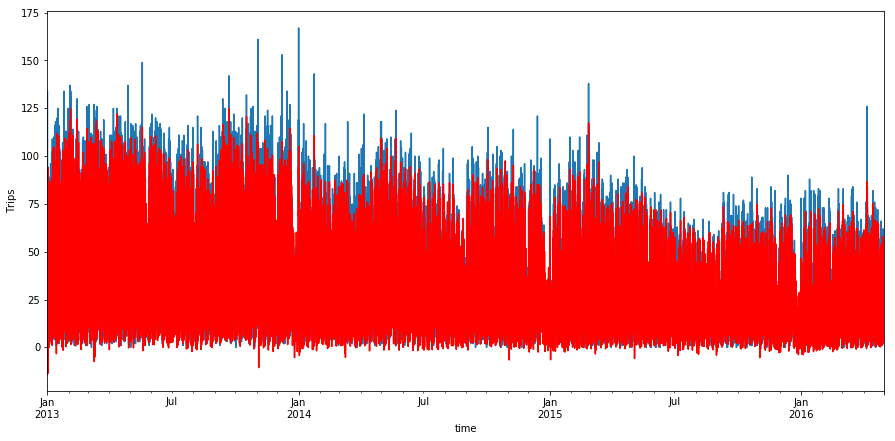

2. Forecast
End.
Start region_1225:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -82025.230
Date:                            Mon, 04 Dec 2017   AIC                         164146.459
Time:                                    23:25:40   BIC                         164543.965
Sample:                                         0   HQIC                        164274.171
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

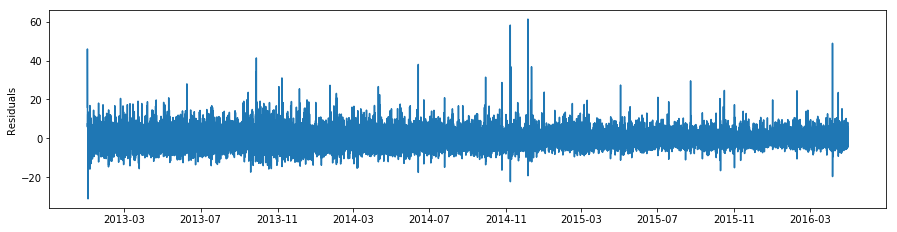

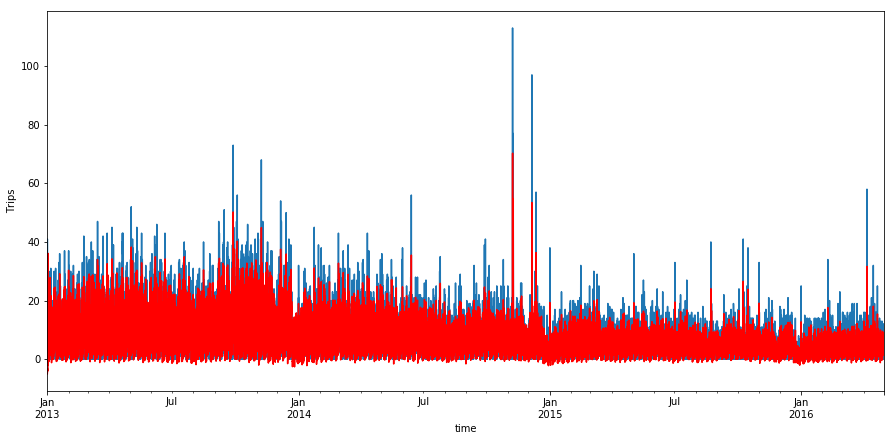

2. Forecast
End.


In [214]:
result_7, errors_7 = regions_forecast(6, attr_7, 1, 1, 1, 1, 0, 1, 6, 15, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [217]:
write_best_params(6, result_7, 0, 1)

In [218]:
res_7_df = result_df(result_7, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_7_df.to_csv("test_result/res_7.csv", sep=",", index=False)

### Прогнозирование значений рядов 8-го кластера

Start region_1326:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -119292.377
Date:                            Tue, 05 Dec 2017   AIC                         238640.754
Time:                                    07:20:42   BIC                         238872.633
Sample:                                         0   HQIC                        238715.253
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           -15.3926  

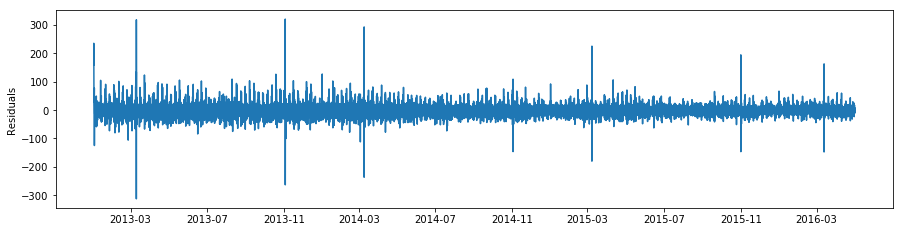

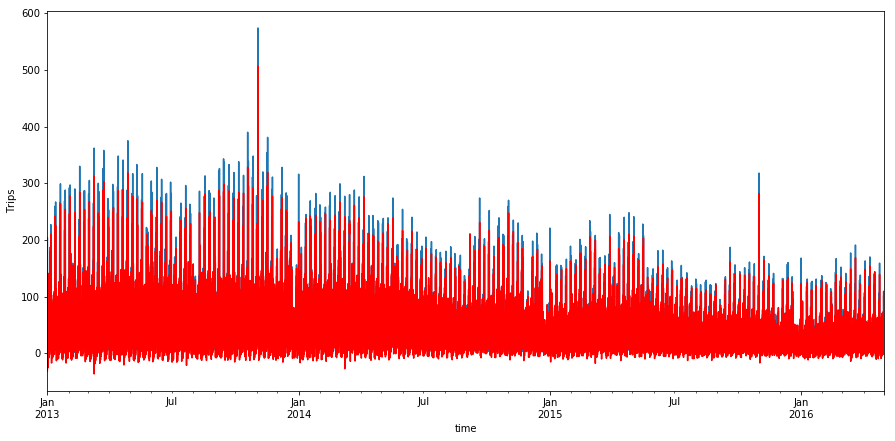

2. Forecast
End.
Start region_1327:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -129416.956
Date:                            Tue, 05 Dec 2017   AIC                         258889.912
Time:                                    09:47:48   BIC                         259121.791
Sample:                                         0   HQIC                        258964.411
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

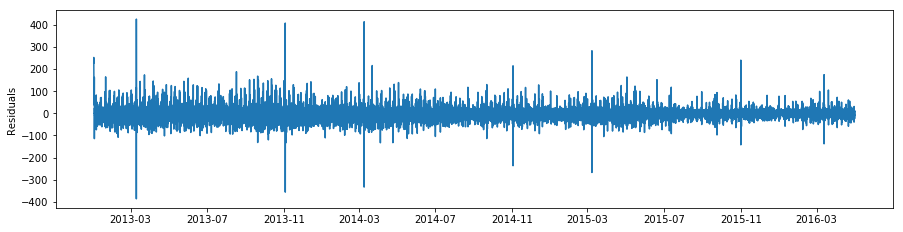

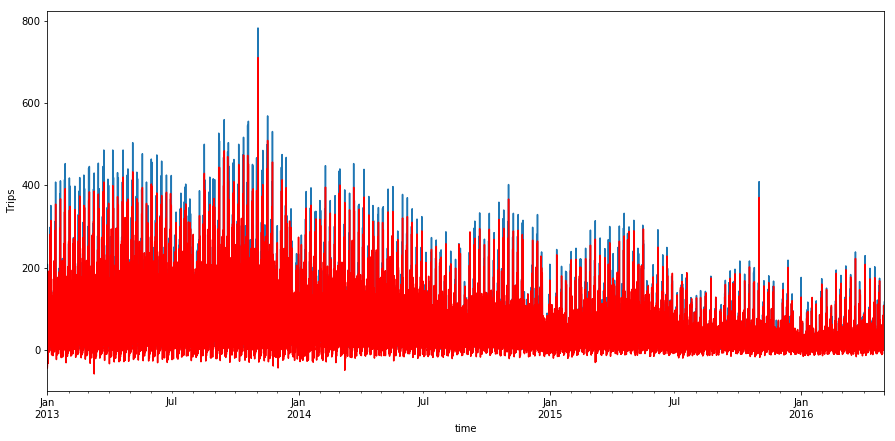

2. Forecast
End.
Start region_1376:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -110126.684
Date:                            Tue, 05 Dec 2017   AIC                         220309.369
Time:                                    12:13:11   BIC                         220541.247
Sample:                                         0   HQIC                        220383.868
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

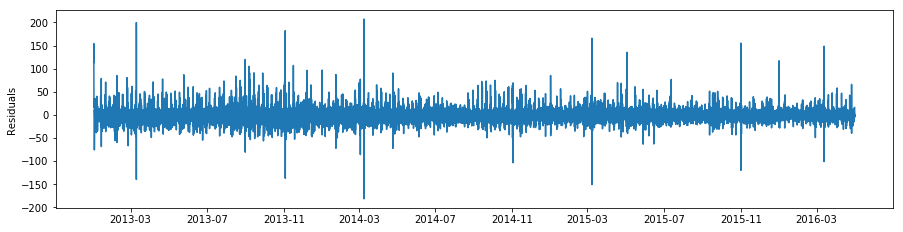

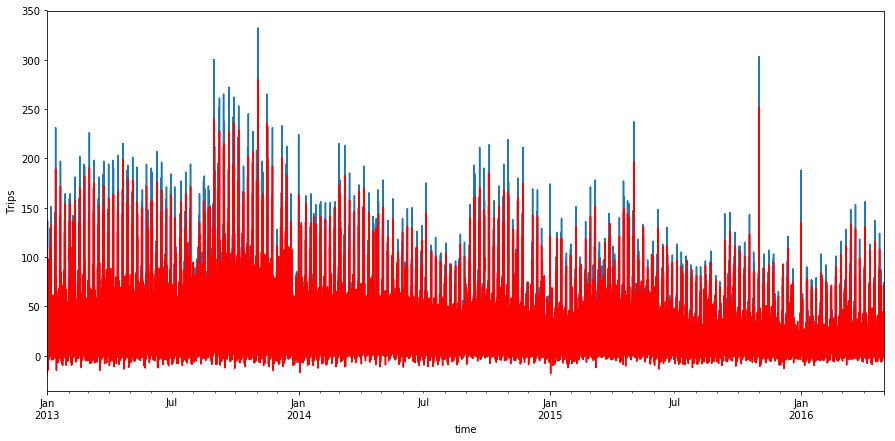

2. Forecast
End.
Start region_1377:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -104777.230
Date:                            Tue, 05 Dec 2017   AIC                         209610.461
Time:                                    14:29:05   BIC                         209842.340
Sample:                                         0   HQIC                        209684.960
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

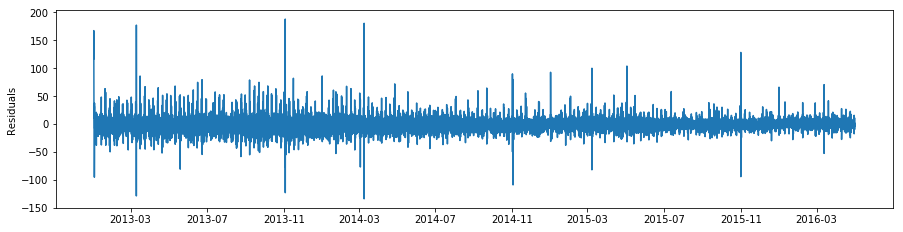

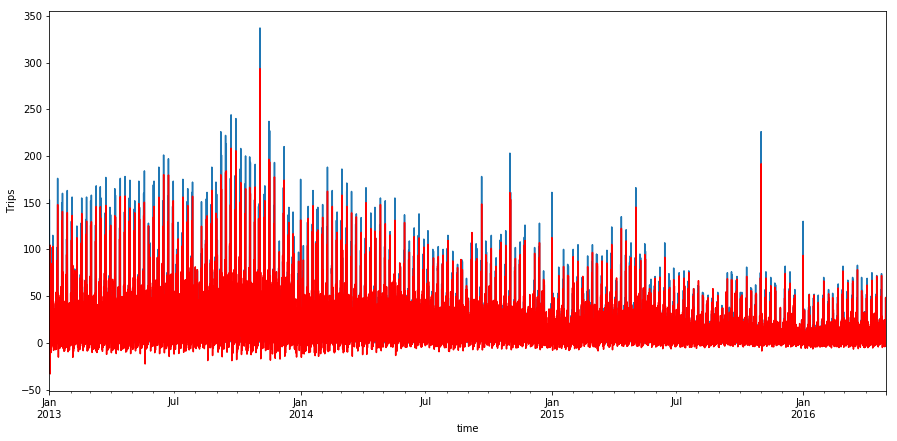

2. Forecast
End.
Start region_1378:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -95968.197
Date:                            Tue, 05 Dec 2017   AIC                         191992.394
Time:                                    16:30:59   BIC                         192224.272
Sample:                                         0   HQIC                        192066.892
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

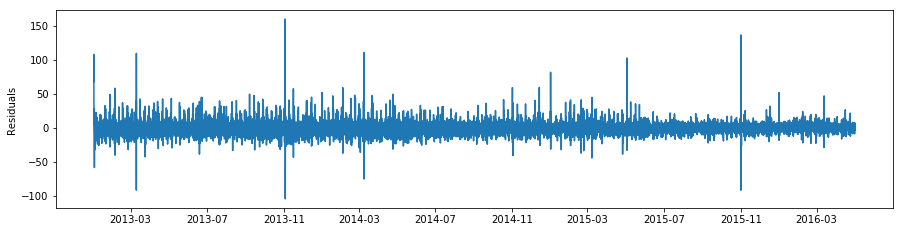

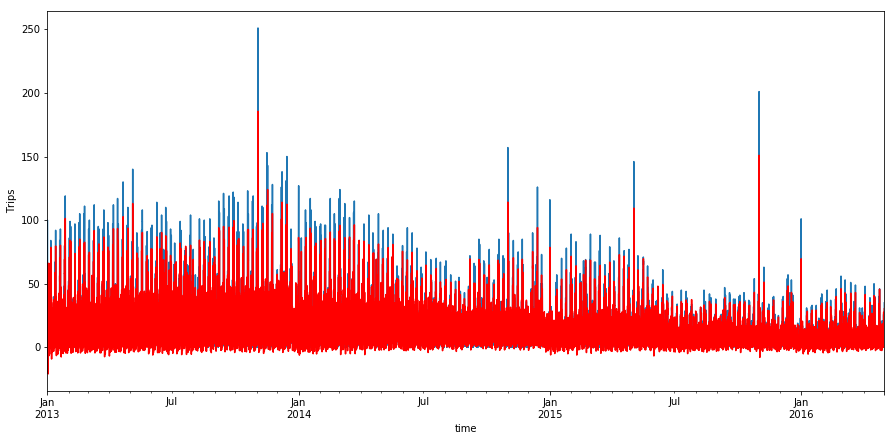

2. Forecast
End.
Start region_1426:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -89303.022
Date:                            Tue, 05 Dec 2017   AIC                         178662.044
Time:                                    19:13:55   BIC                         178893.922
Sample:                                         0   HQIC                        178736.542
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

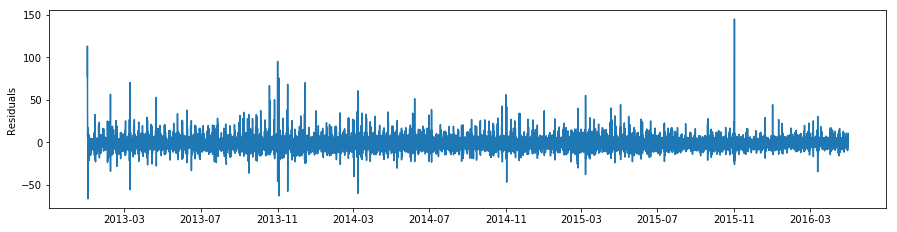

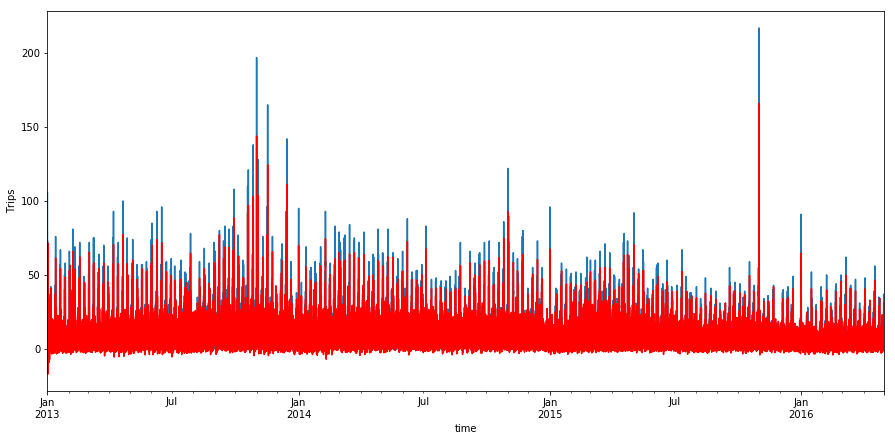

2. Forecast


In [ ]:
result_8, errors_8 = regions_forecast(7, attr_8, 1, 1, 1, 1, 0, 1, 6, 5, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [ ]:
write_best_params(7, result_8, 0, 1)

In [ ]:
res_8_df = result_df(result_8, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_8_df.to_csv("test_result/res_8.csv", sep=",", index=False)

### Прогнозирование значений рядов 9-го кластера

In [ ]:
result_9, errors_9 = regions_forecast(8, attr_9, 1, 1, 2, 1, 0, 1, 4, 10, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [ ]:
write_best_params(8, result_9, 0, 1)

In [ ]:
res_9_df = result_df(result_9, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_9_df.to_csv("test_result/res_9.csv", sep=",", index=False)

### Прогнозирование значений рядов 10-го кластера

Start region_1221:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -85755.990
Date:                            Wed, 06 Dec 2017   AIC                         171563.980
Time:                                    09:05:56   BIC                         171779.295
Sample:                                         0   HQIC                        171633.157
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -2.5424  

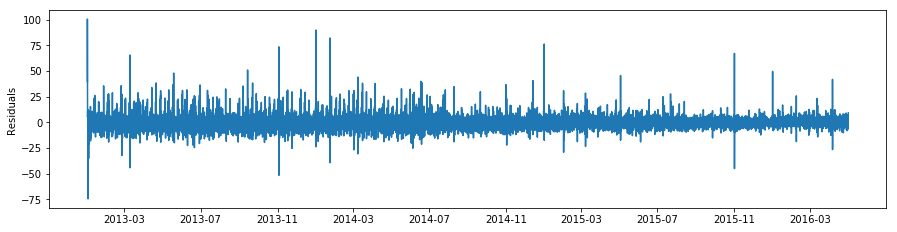

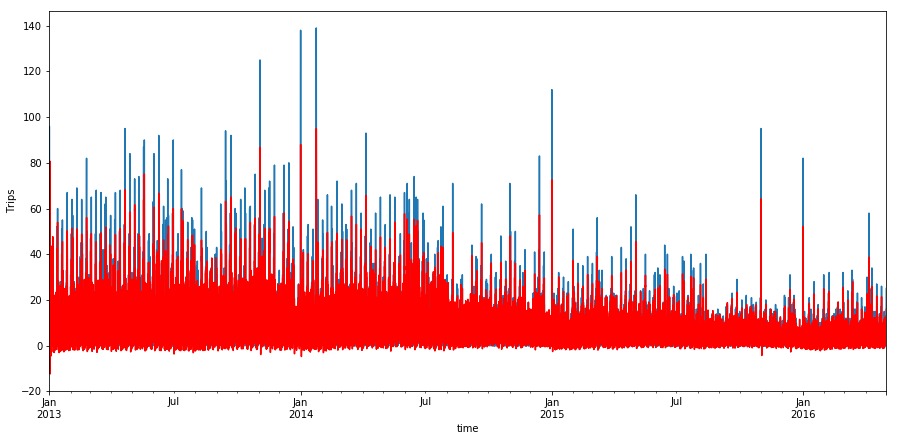

2. Forecast
End.
Start region_1222:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -96748.896
Date:                            Wed, 06 Dec 2017   AIC                         193549.791
Time:                                    10:49:14   BIC                         193765.107
Sample:                                         0   HQIC                        193618.969
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

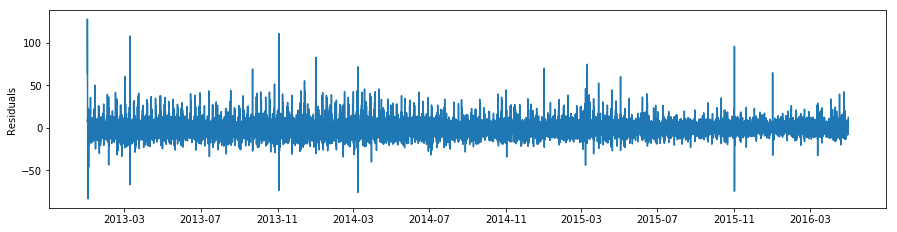

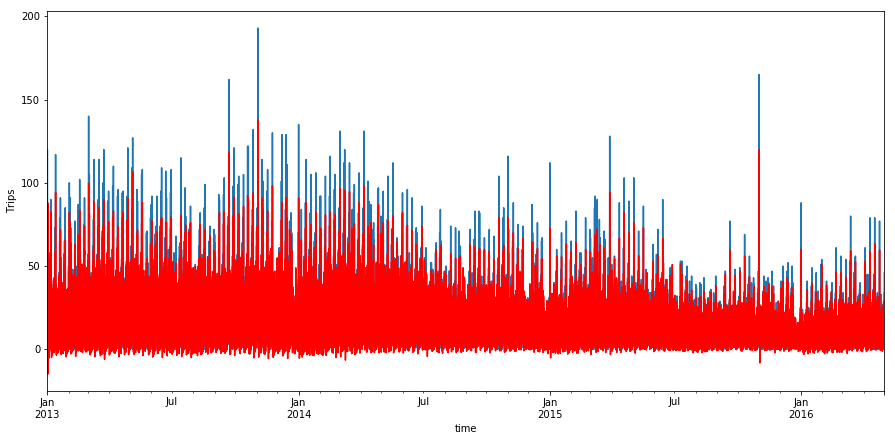

2. Forecast
End.
Start region_1223:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -101919.118
Date:                            Wed, 06 Dec 2017   AIC                         203890.237
Time:                                    12:42:13   BIC                         204105.552
Sample:                                         0   HQIC                        203959.414
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

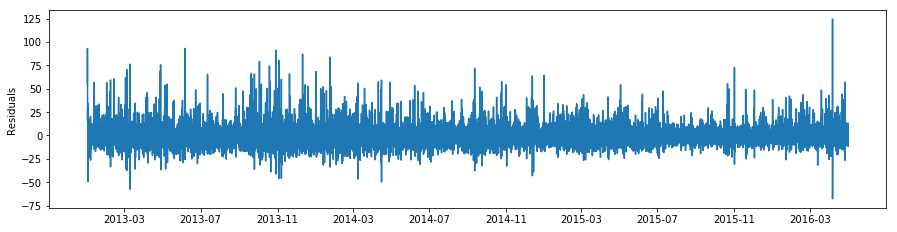

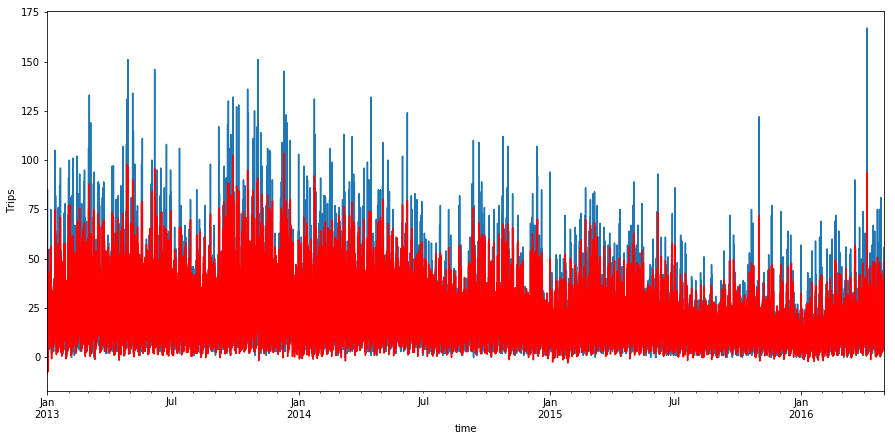

2. Forecast
End.
Start region_1272:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -90749.716
Date:                            Wed, 06 Dec 2017   AIC                         181551.432
Time:                                    14:37:32   BIC                         181766.748
Sample:                                         0   HQIC                        181620.609
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

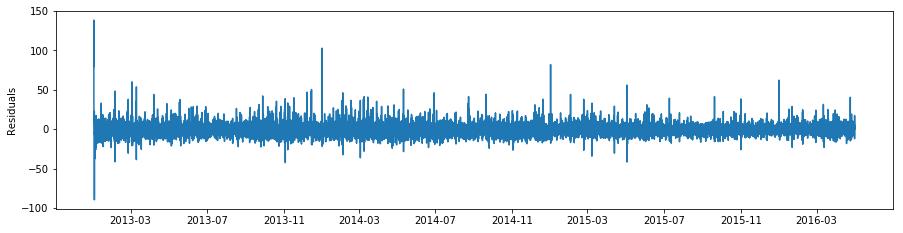

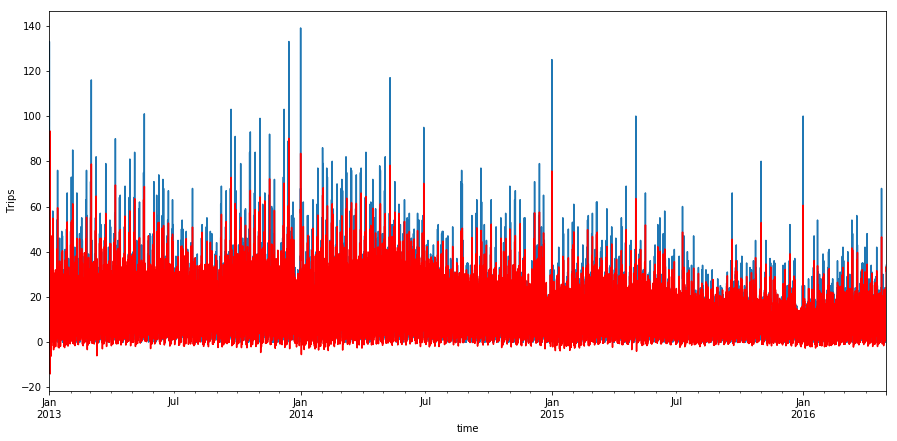

2. Forecast
End.
Start region_1273:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 24)   Log Likelihood             -114740.667
Date:                            Wed, 06 Dec 2017   AIC                         229531.334
Time:                                    16:11:58   BIC                         229738.369
Sample:                                         0   HQIC                        229597.851
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

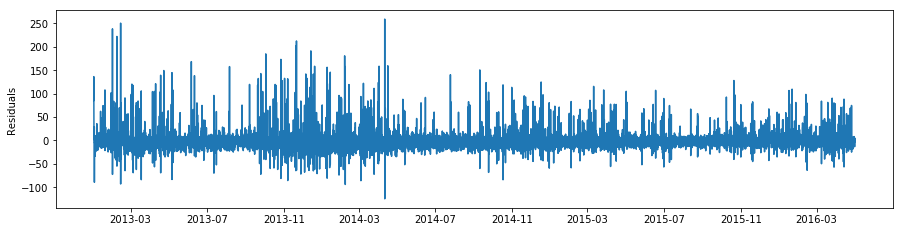

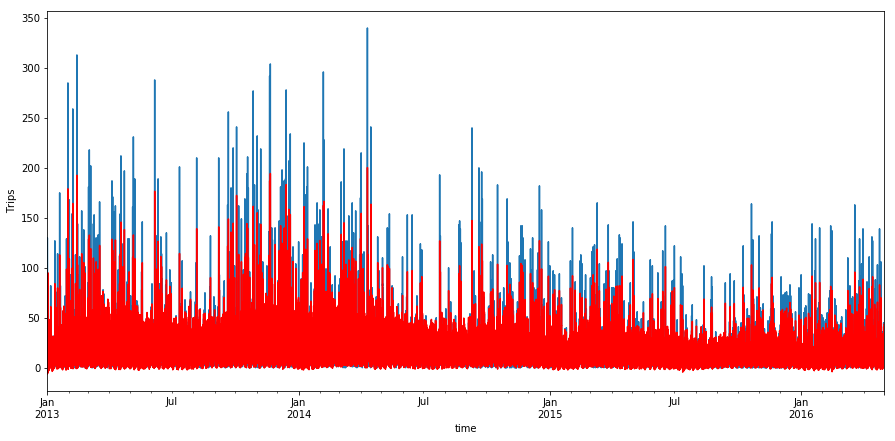

2. Forecast
End.
Start region_1274:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -84055.883
Date:                            Wed, 06 Dec 2017   AIC                         168163.766
Time:                                    17:52:36   BIC                         168379.082
Sample:                                         0   HQIC                        168232.943
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

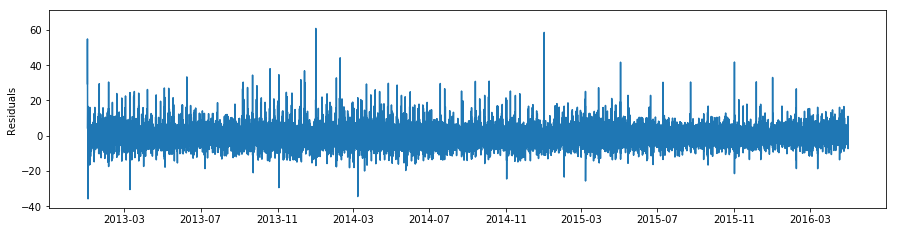

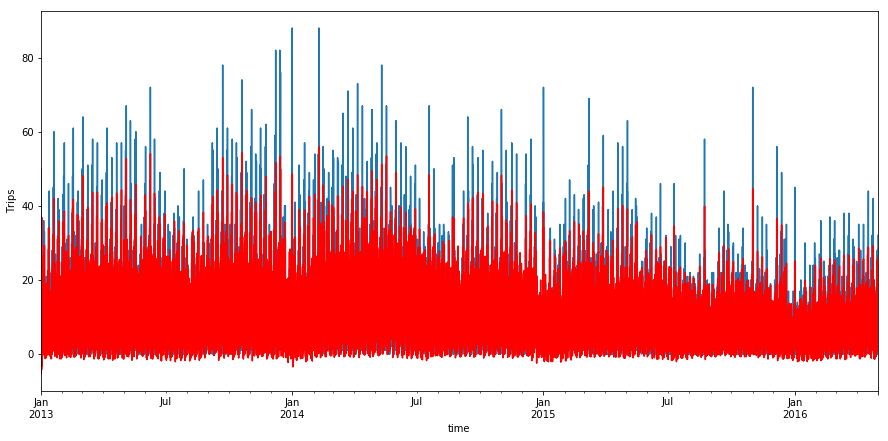

2. Forecast
End.
Start region_1380:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -89190.124
Date:                            Wed, 06 Dec 2017   AIC                         178432.247
Time:                                    19:42:39   BIC                         178647.563
Sample:                                         0   HQIC                        178501.425
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

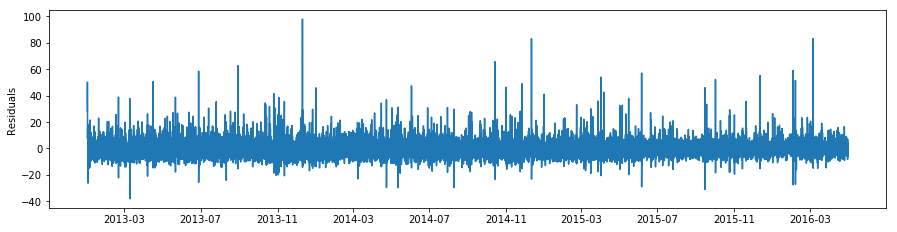

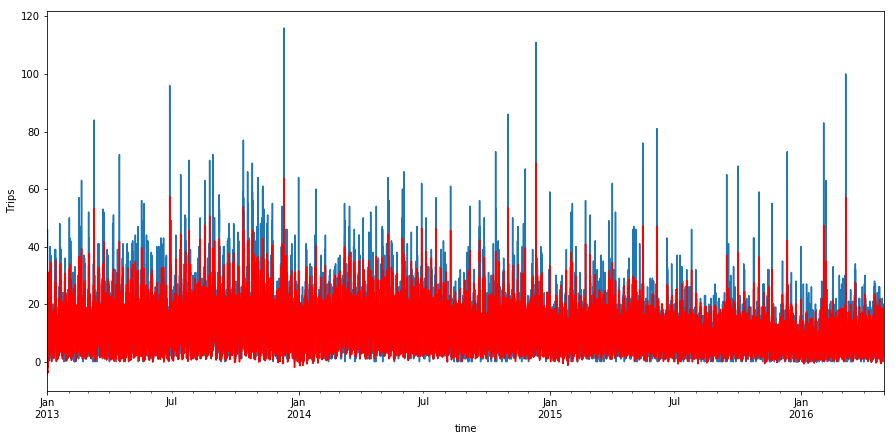

2. Forecast
End.


In [42]:
result_10, errors_10 = regions_forecast(9, attr_10, 1, 1, 1, 1, 0, 1, 6, 4, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [45]:
write_best_params(9, result_10, 0, 1)

In [46]:
res_10_df = result_df(result_10, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_10_df.to_csv("test_result/res_10.csv", sep=",", index=False)

### Прогнозирование значений рядов 11-го кластера

Start region_1389:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -90602.676
Date:                            Wed, 06 Dec 2017   AIC                         181261.352
Time:                                    23:11:50   BIC                         181493.230
Sample:                                         0   HQIC                        181335.851
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -2.3690  

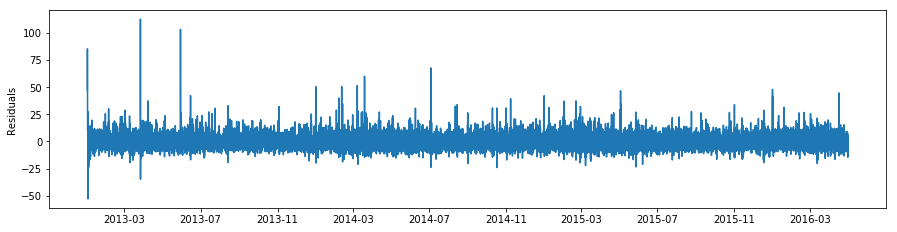

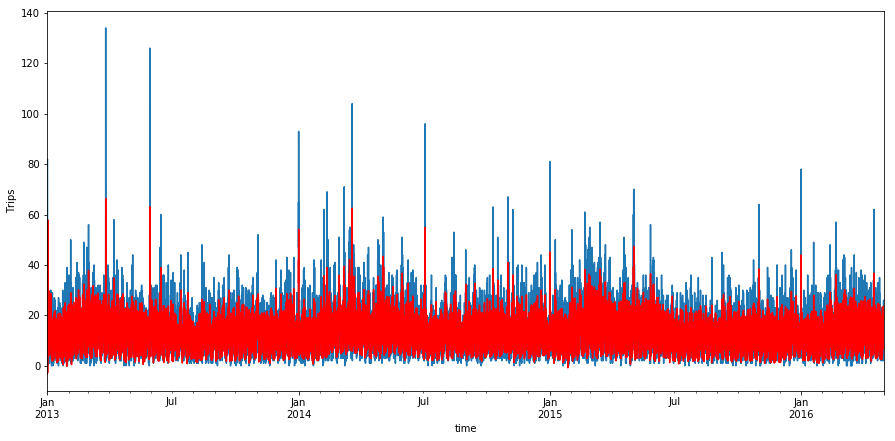

2. Forecast
End.
Start region_1390:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -91957.715
Date:                            Thu, 07 Dec 2017   AIC                         183971.430
Time:                                    01:15:06   BIC                         184203.309
Sample:                                         0   HQIC                        184045.929
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

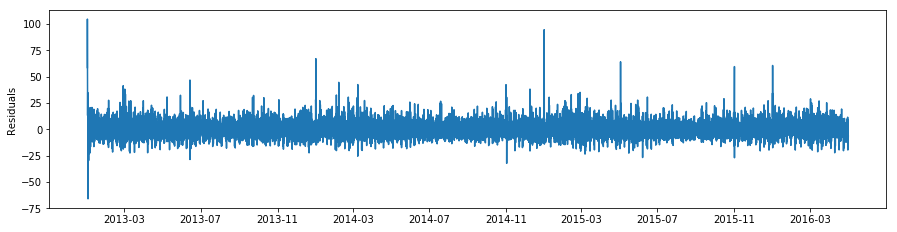

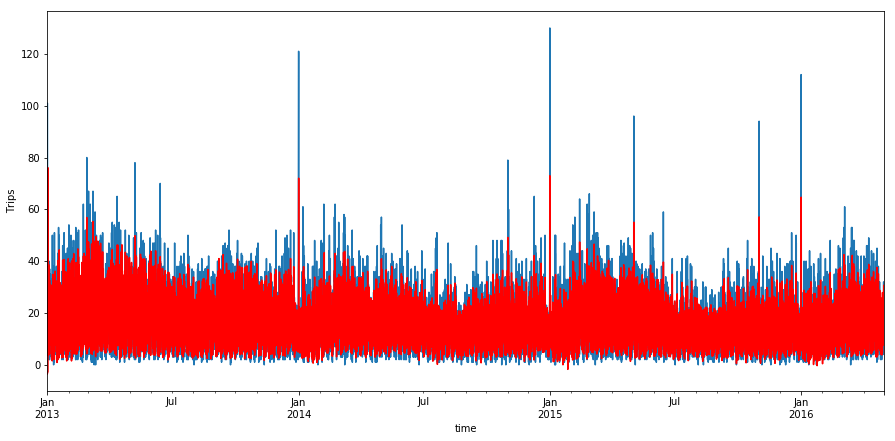

2. Forecast
End.
Start region_1439:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -77475.325
Date:                            Thu, 07 Dec 2017   AIC                         155006.649
Time:                                    03:23:34   BIC                         155238.528
Sample:                                         0   HQIC                        155081.148
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

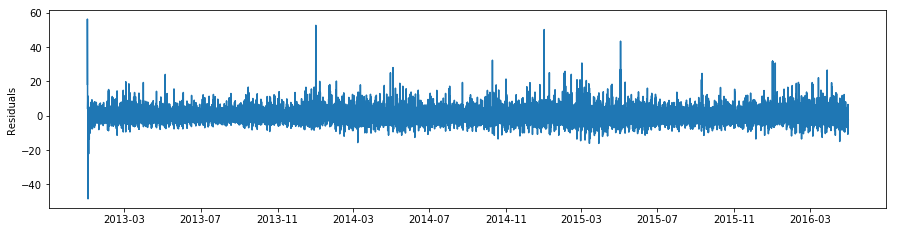

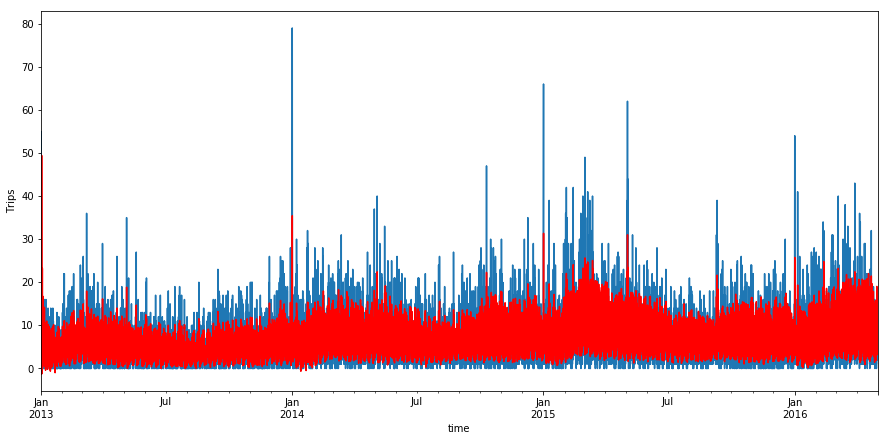

2. Forecast
End.


In [115]:
result_11, errors_11 = regions_forecast(10, attr_11, 1, 1, 1, 1, 0, 1, 4, 7, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [118]:
write_best_params(10, result_11, 0, 1)

In [119]:
res_11_df = result_df(result_11, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_11_df.to_csv("test_result/res_11.csv", sep=",", index=False)

### Прогнозирование значений рядов 12-го кластера

Start region_2068:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 24)   Log Likelihood             -129686.753
Date:                            Thu, 07 Dec 2017   AIC                         259427.505
Time:                                    05:36:29   BIC                         259651.102
Sample:                                         0   HQIC                        259499.343
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -3.3634  

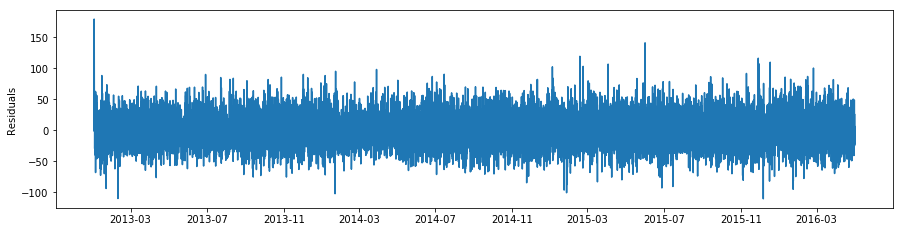

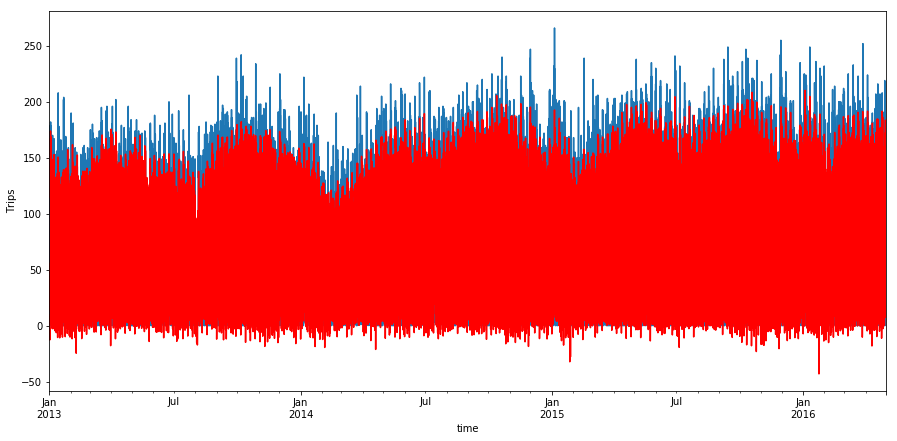

2. Forecast
End.
Start region_2069:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 24)   Log Likelihood              -89223.274
Date:                            Thu, 07 Dec 2017   AIC                         178500.548
Time:                                    07:59:12   BIC                         178724.145
Sample:                                         0   HQIC                        178572.386
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

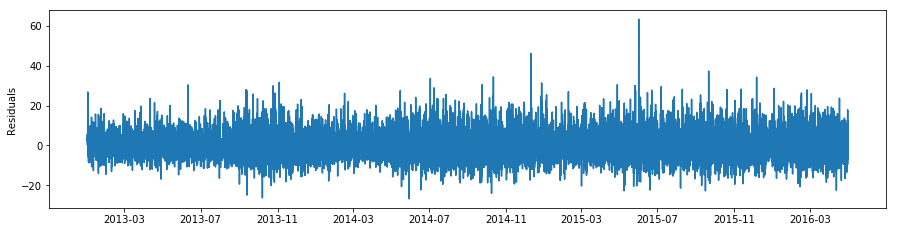

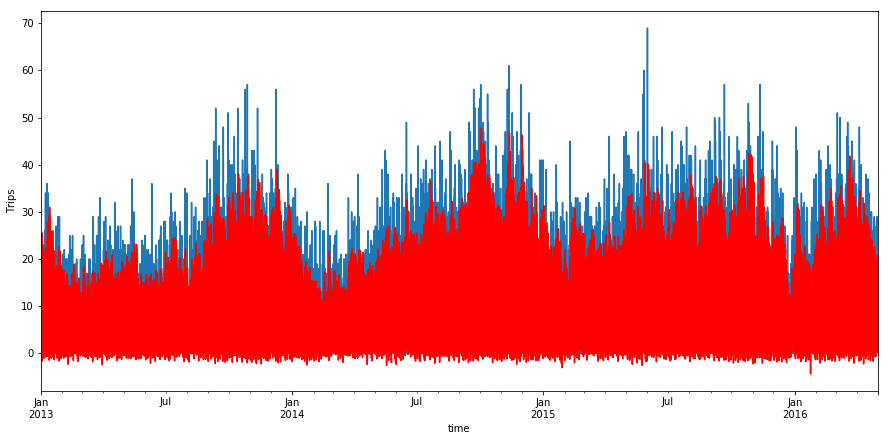

2. Forecast
End.
Start region_2118:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -139231.468
Date:                            Thu, 07 Dec 2017   AIC                         278518.936
Time:                                    09:49:11   BIC                         278750.814
Sample:                                         0   HQIC                        278593.434
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

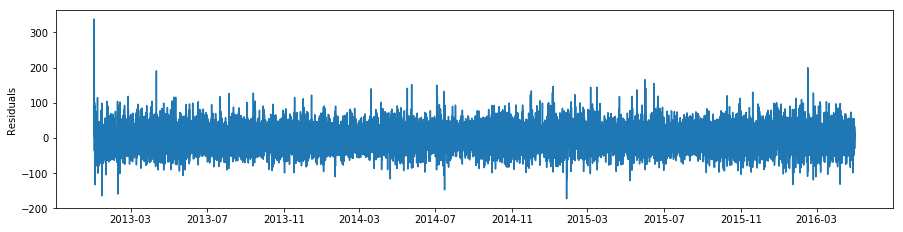

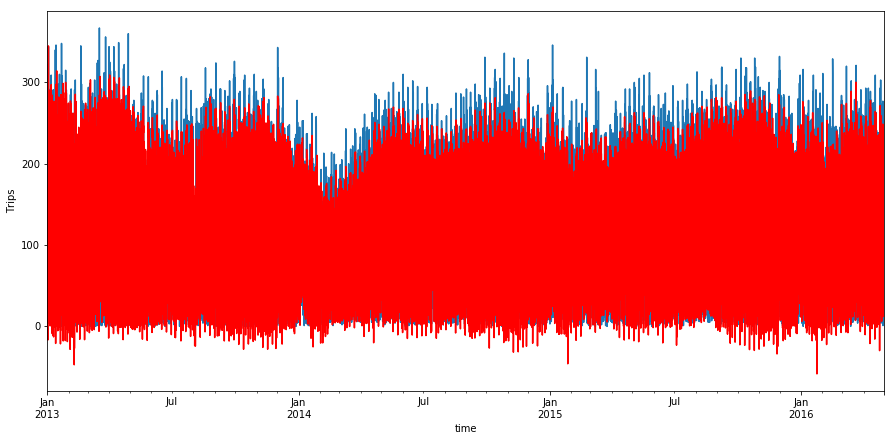

2. Forecast
End.
Start region_2119:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -123462.645
Date:                            Thu, 07 Dec 2017   AIC                         246981.291
Time:                                    12:11:17   BIC                         247213.169
Sample:                                         0   HQIC                        247055.789
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

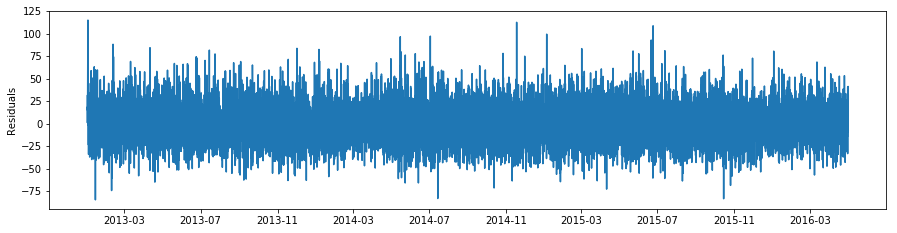

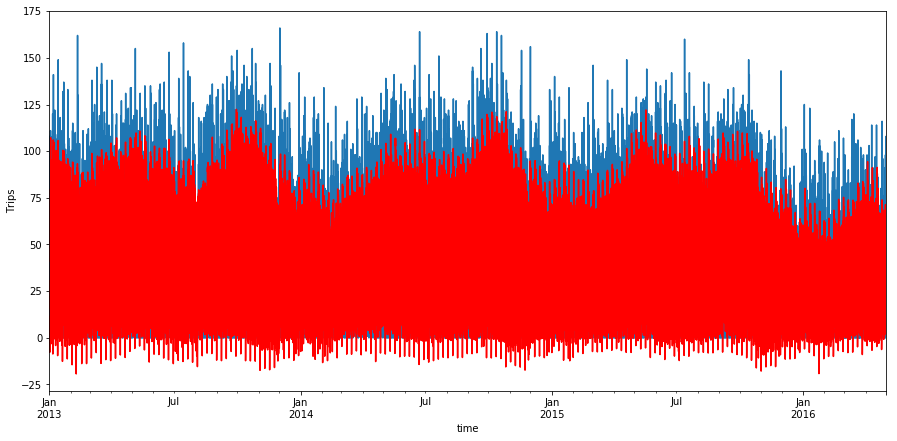

2. Forecast
End.


In [120]:
result_12, errors_12 = regions_forecast(11, attr_12, 1, 1, 1, 1, 0, 1, 6, 5, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [123]:
write_best_params(11, result_12, 0, 1)

In [124]:
res_12_df = result_df(result_12, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_12_df.to_csv("test_result/res_12.csv", sep=",", index=False)

### Прогнозирование значений рядов 13-го кластера

Start region_1684:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 24)   Log Likelihood             -109001.496
Date:                            Thu, 07 Dec 2017   AIC                         218052.992
Time:                                    14:32:08   BIC                         218260.026
Sample:                                         0   HQIC                        218119.508
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             4.4338  

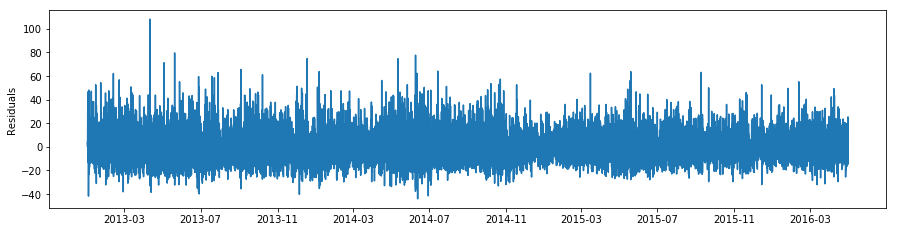

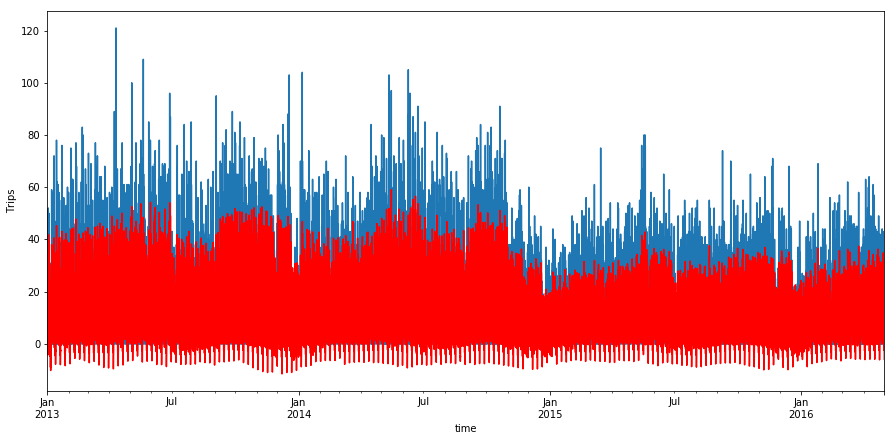

2. Forecast
End.
Start region_1733:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -82680.546
Date:                            Thu, 07 Dec 2017   AIC                         165413.092
Time:                                    16:00:35   BIC                         165628.408
Sample:                                         0   HQIC                        165482.269
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

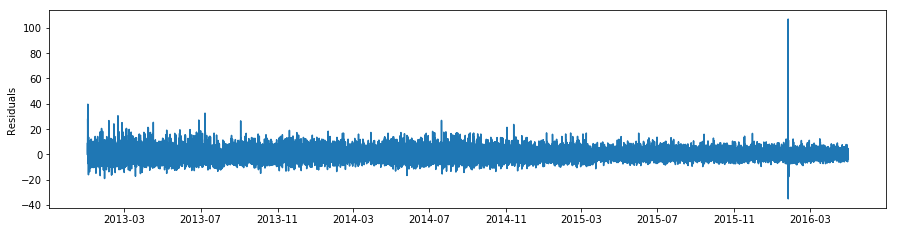

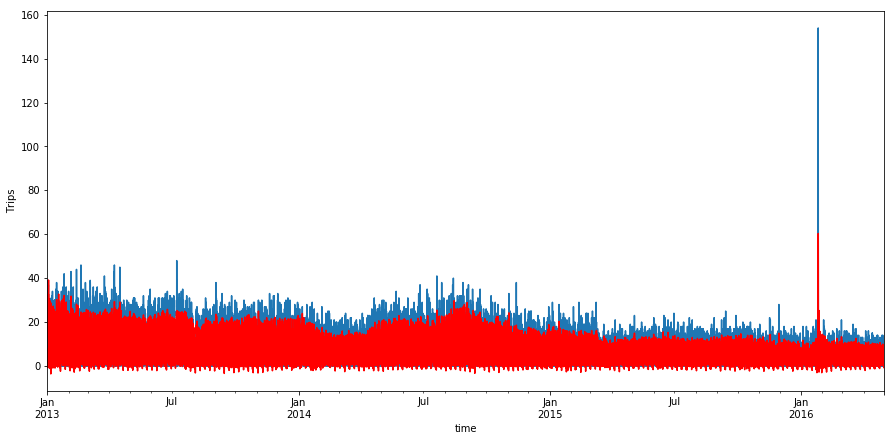

2. Forecast
End.
Start region_1734:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -160913.572
Date:                            Thu, 07 Dec 2017   AIC                         321879.143
Time:                                    17:26:43   BIC                         322094.459
Sample:                                         0   HQIC                        321948.320
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

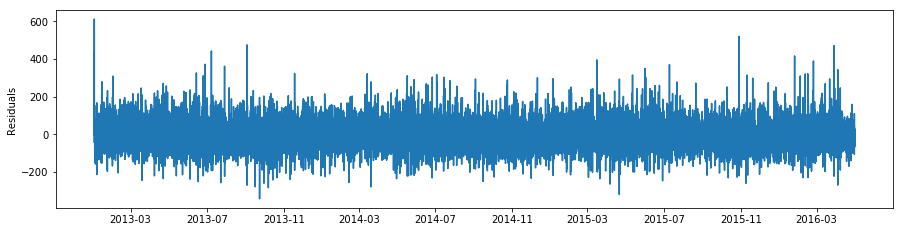

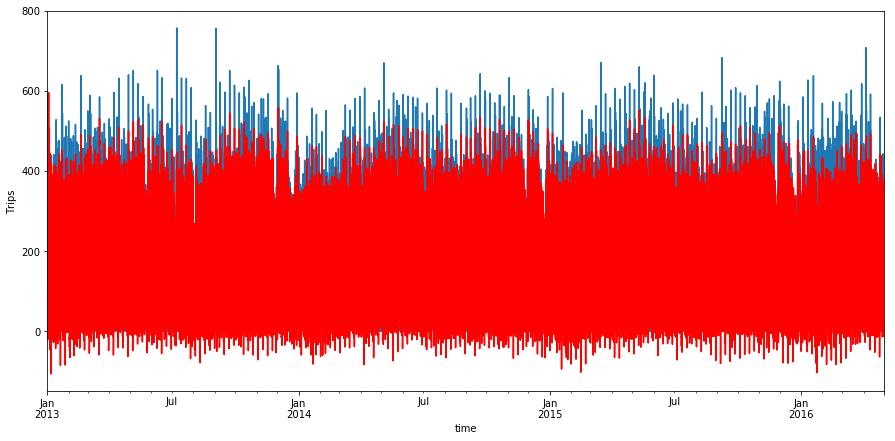

2. Forecast
End.
Start region_1783:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -156154.749
Date:                            Thu, 07 Dec 2017   AIC                         312361.498
Time:                                    19:12:44   BIC                         312576.814
Sample:                                         0   HQIC                        312430.675
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

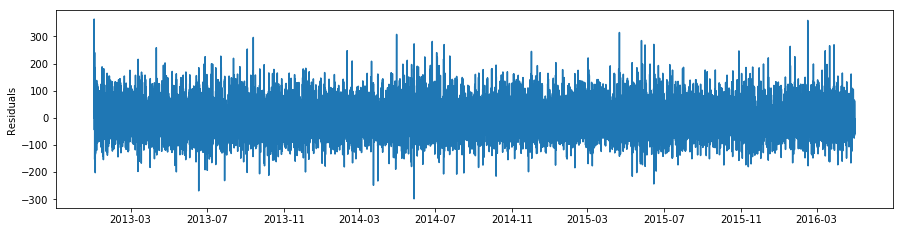

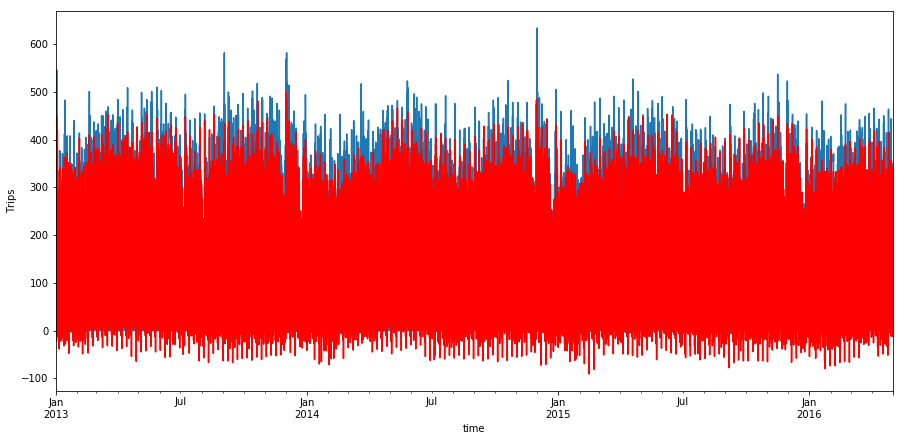

2. Forecast
End.


In [125]:
result_13, errors_13 = regions_forecast(12, attr_13, 1, 1, 1, 1, 0, 1, 6, 4, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [128]:
write_best_params(12, result_13, 0, 1)

In [129]:
res_13_df = result_df(result_13, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_13_df.to_csv("test_result/res_13.csv", sep=",", index=False)

### Прогнозирование значений рядов 14-го кластера

Start region_1431:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
(1, 1, 2, 0)
(1, 1, 2, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -103077.743
Date:                            Thu, 07 Dec 2017   AIC                         206203.486
Time:                                    23:00:18   BIC                         206402.239
Sample:                                         0   HQIC                        206267.342
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------

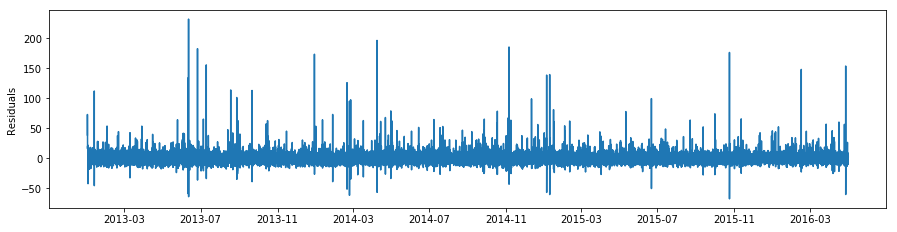

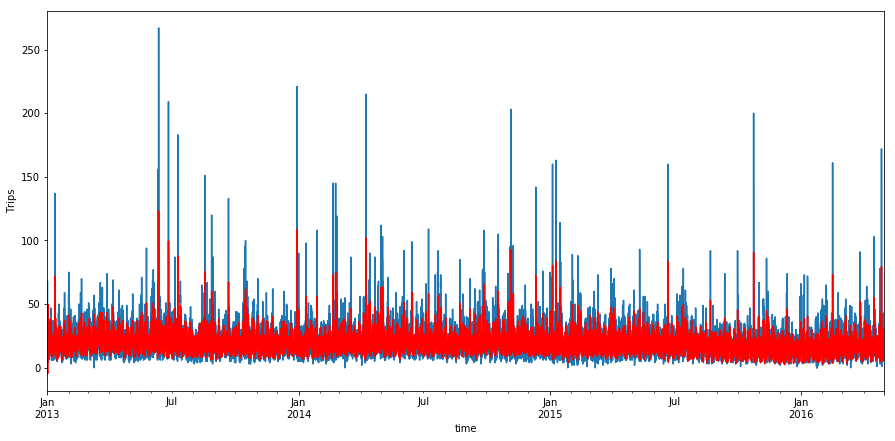

2. Forecast
End.


In [130]:
result_14, errors_14 = regions_forecast(13, attr_14, 1, 1, 2, 1, 0, 1, 6, 3, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [133]:
write_best_params(13, result_14, 0, 1)

In [134]:
res_14_df = result_df(result_14, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_14_df.to_csv("test_result/res_14.csv", sep=",", index=False)

### Прогнозирование значений рядов 15-го кластера

Start region_1387:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -105911.901
Date:                            Fri, 08 Dec 2017   AIC                         211875.801
Time:                                    09:12:04   BIC                         212091.117
Sample:                                         0   HQIC                        211944.978
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -4.7256  

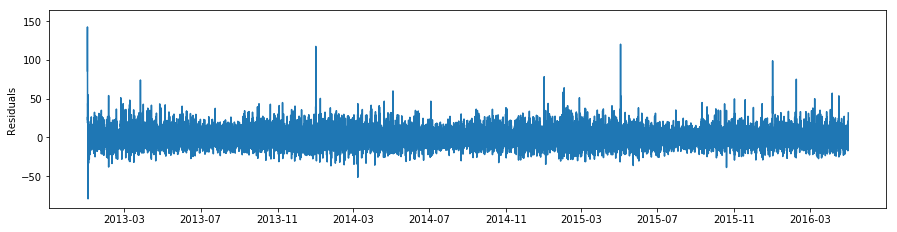

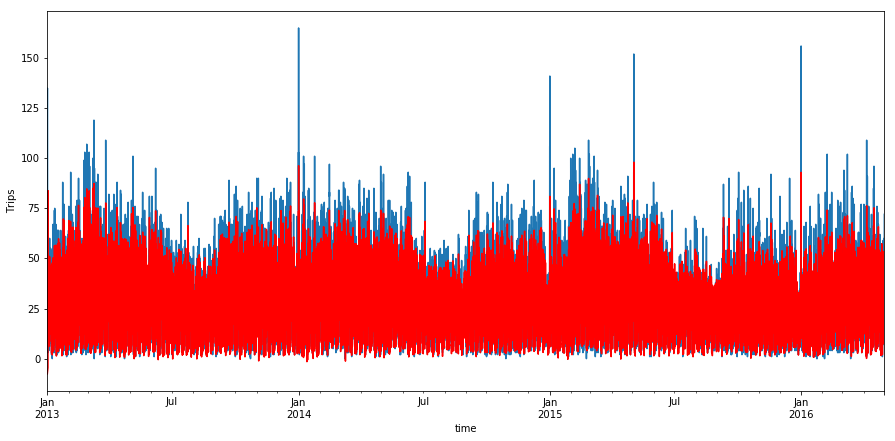

2. Forecast
End.
Start region_1388:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -98659.028
Date:                            Fri, 08 Dec 2017   AIC                         197370.056
Time:                                    11:08:52   BIC                         197585.372
Sample:                                         0   HQIC                        197439.234
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

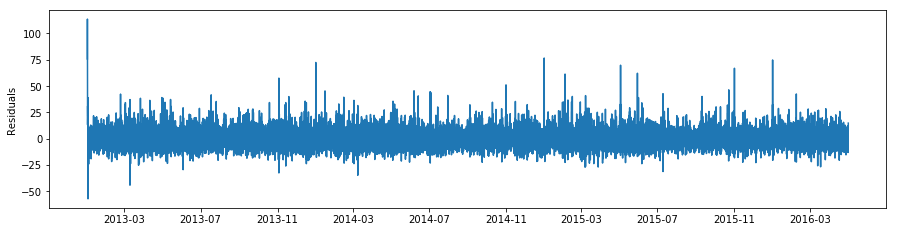

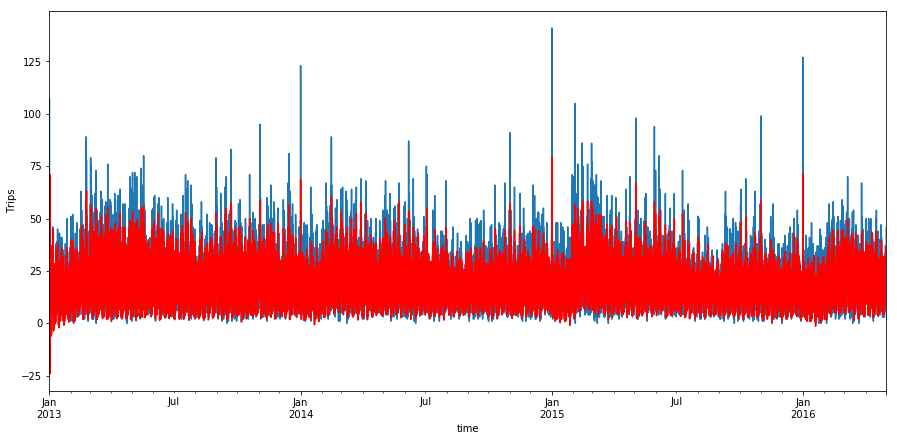

2. Forecast
End.
Start region_1435:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -80948.052
Date:                            Fri, 08 Dec 2017   AIC                         161948.104
Time:                                    13:07:03   BIC                         162163.420
Sample:                                         0   HQIC                        162017.282
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

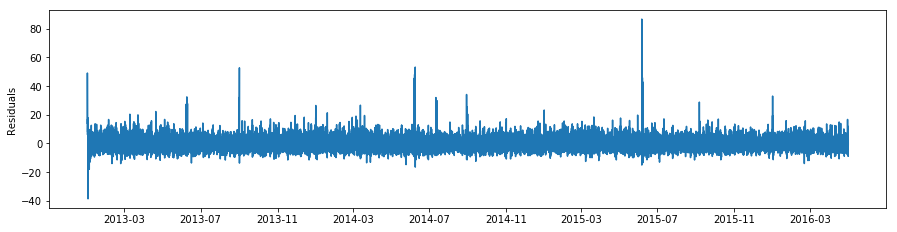

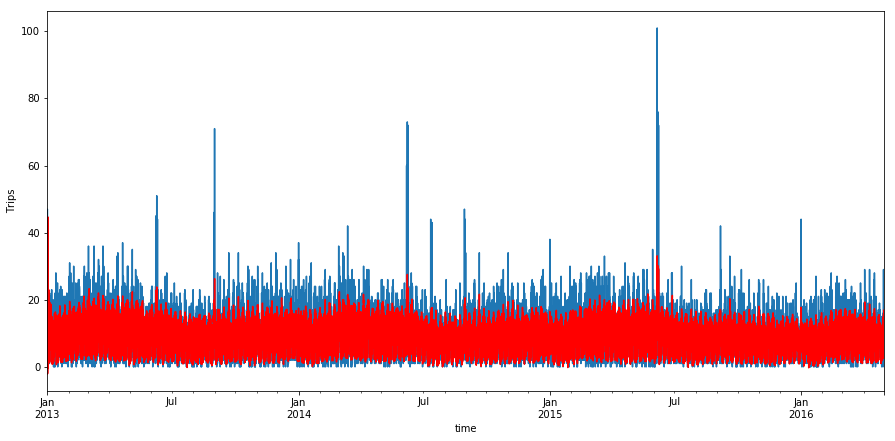

2. Forecast
End.
Start region_1436:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -102989.853
Date:                            Fri, 08 Dec 2017   AIC                         206031.705
Time:                                    15:18:10   BIC                         206247.021
Sample:                                         0   HQIC                        206100.883
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

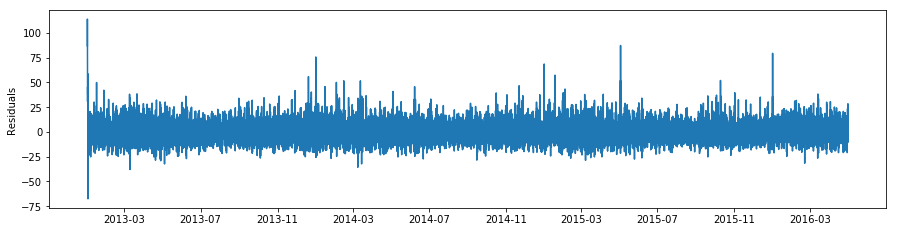

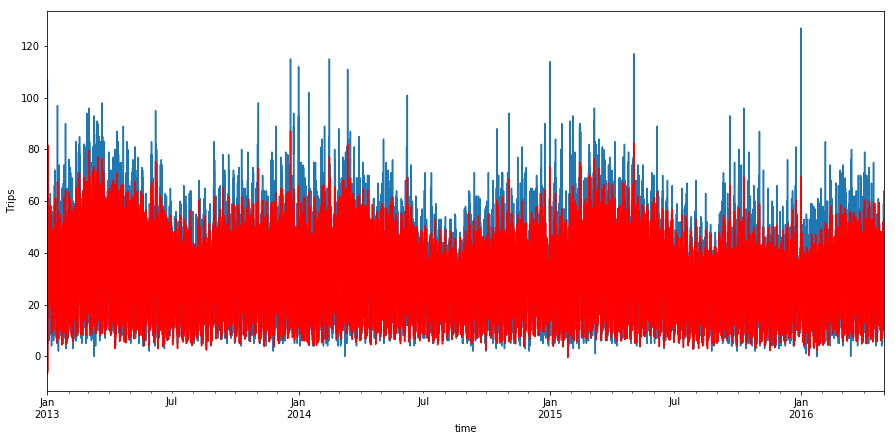

2. Forecast
End.
Start region_1437:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -109795.559
Date:                            Fri, 08 Dec 2017   AIC                         219643.119
Time:                                    17:07:51   BIC                         219858.435
Sample:                                         0   HQIC                        219712.296
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

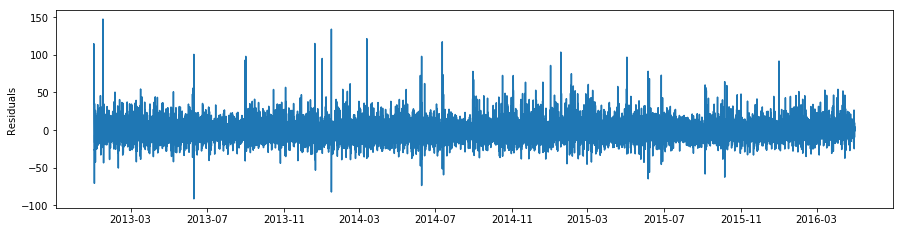

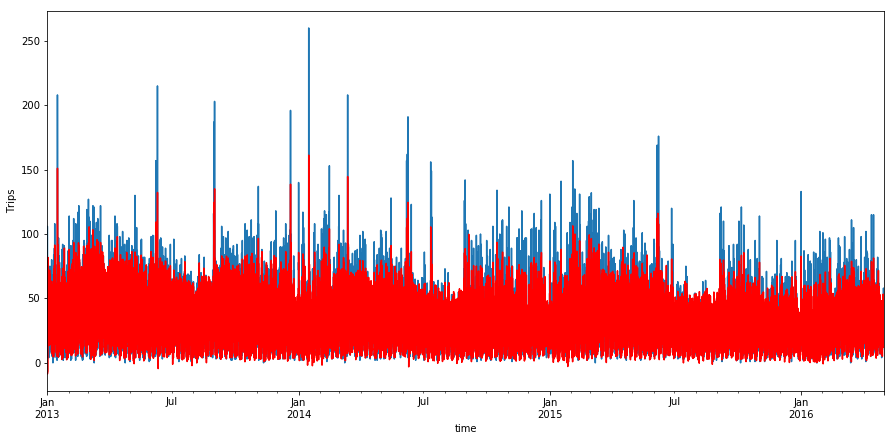

2. Forecast
End.
Start region_1438:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -86564.886
Date:                            Fri, 08 Dec 2017   AIC                         173181.773
Time:                                    18:41:52   BIC                         173397.088
Sample:                                         0   HQIC                        173250.950
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

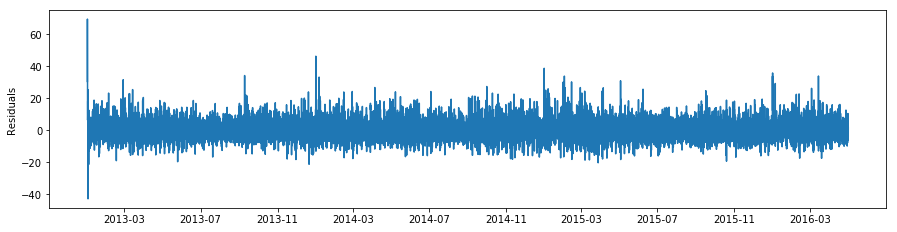

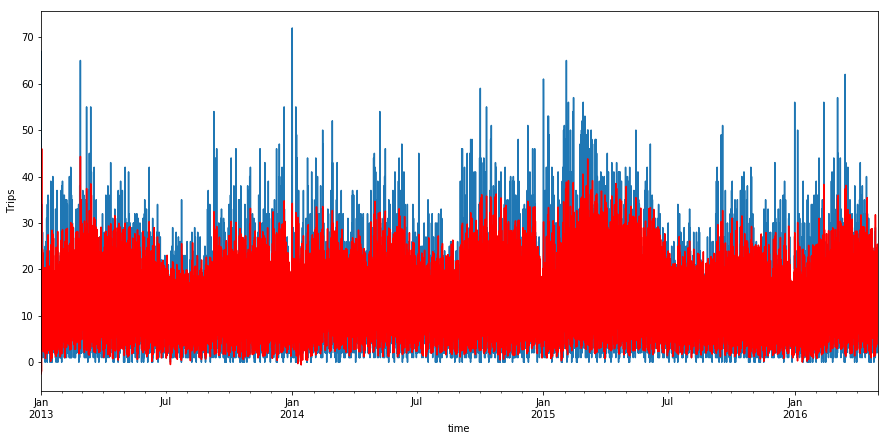

2. Forecast
End.


In [198]:
result_15, errors_15 = regions_forecast(14, attr_15, 1, 1, 1, 1, 0, 1, 3, 7, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [201]:
write_best_params(14, result_15, 0, 1)

In [202]:
res_15_df = result_df(result_15, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_15_df.to_csv("test_result/res_15.csv", sep=",", index=False)

### Прогнозирование значений рядов 16-го кластера

Start region_1630:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -75367.526
Date:                            Fri, 08 Dec 2017   AIC                         150783.053
Time:                                    20:55:40   BIC                         150981.806
Sample:                                         0   HQIC                        150846.909
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -1.6552  

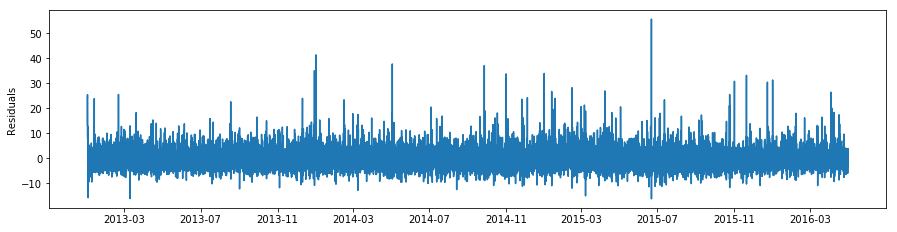

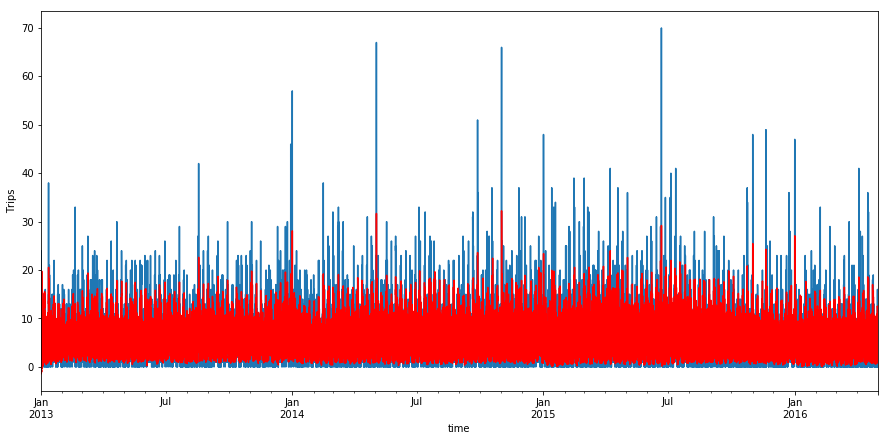

2. Forecast
End.


In [203]:
result_16, errors_16 = regions_forecast(15, attr_16, 1, 1, 1, 1, 0, 1, 6, 3, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [206]:
write_best_params(15, result_16, 0, 1)

In [207]:
res_16_df = result_df(result_16, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_16_df.to_csv("test_result/res_16.csv", sep=",", index=False)

### Прогнозирование значений рядов 17-го кластера

Start region_1482:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -94419.233
Date:                            Fri, 08 Dec 2017   AIC                         188878.465
Time:                                    22:25:17   BIC                         189044.093
Sample:                                         0   HQIC                        188931.678
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -4.5831  

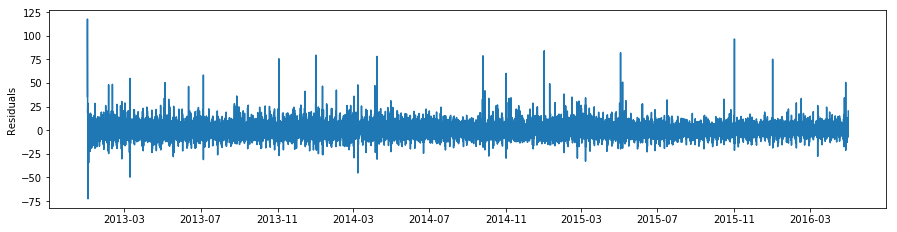

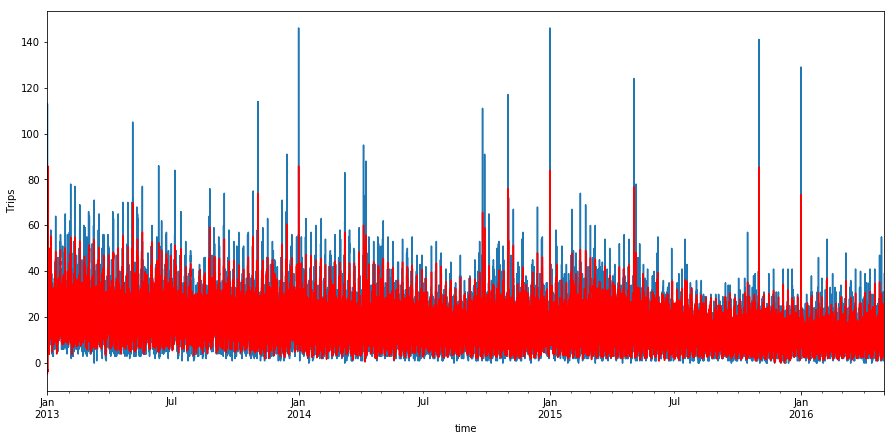

2. Forecast
End.
Start region_1532:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -85821.863
Date:                            Sat, 09 Dec 2017   AIC                         171683.727
Time:                                    00:18:20   BIC                         171849.354
Sample:                                         0   HQIC                        171736.940
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

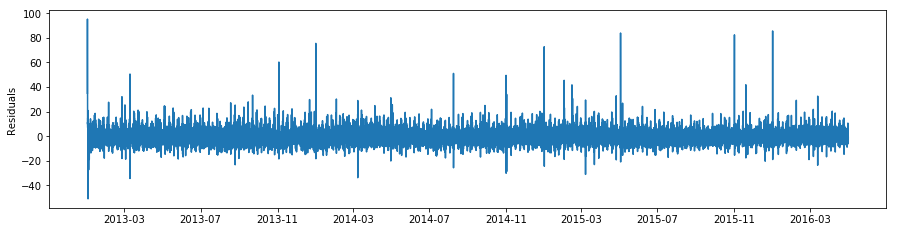

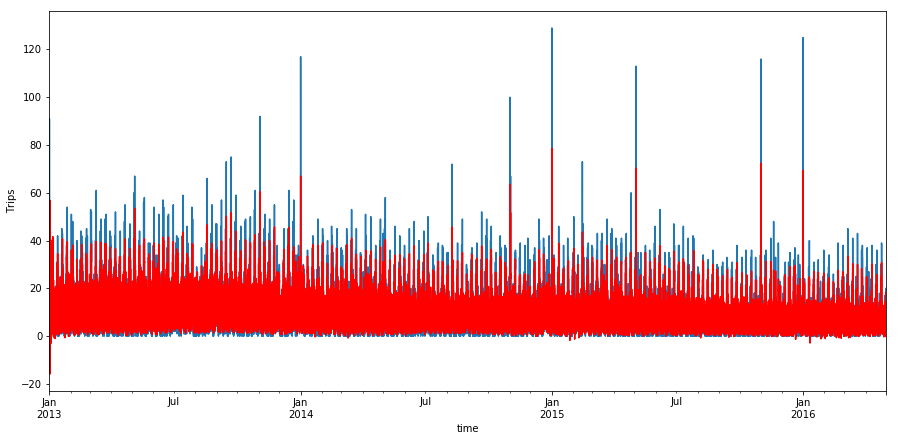

2. Forecast
End.
Start region_1533:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -96152.278
Date:                            Sat, 09 Dec 2017   AIC                         192344.556
Time:                                    02:32:53   BIC                         192510.184
Sample:                                         0   HQIC                        192397.770
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1    

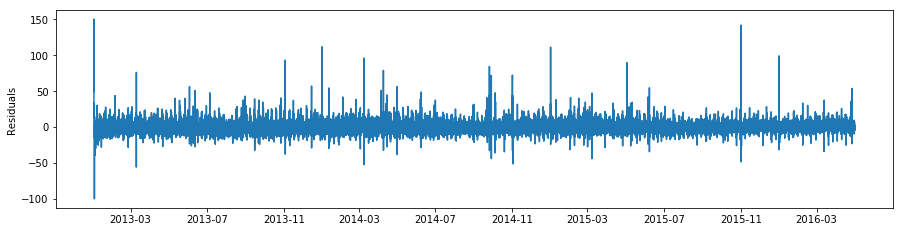

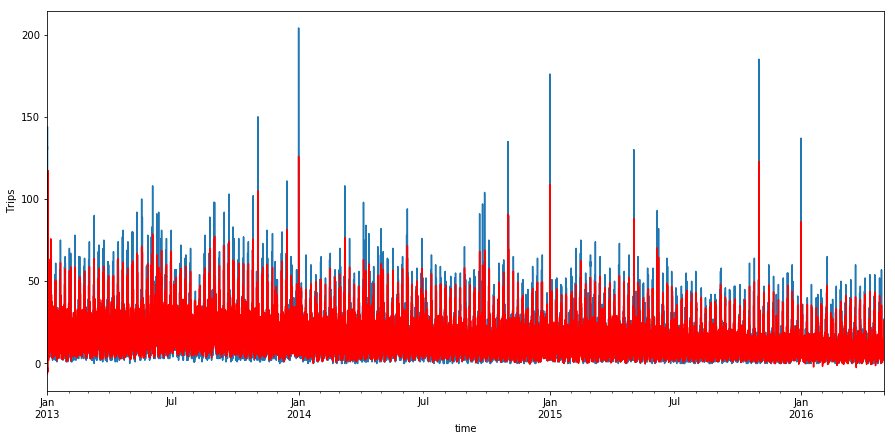

2. Forecast
End.


In [208]:
result_17, errors_17 = regions_forecast(16, attr_17, 1, 1, 1, 1, 0, 1, 6, 1, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [211]:
write_best_params(16, result_17, 0, 1)

In [212]:
res_17_df = result_df(result_17, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_17_df.to_csv("test_result/res_17.csv", sep=",", index=False)

### Прогнозирование значений рядов 18-го кластера

Start region_1441:
1. Train
product...
(1, 1, 0, 0)
(1, 1, 0, 1)
(1, 1, 1, 0)
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29184
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -71437.220
Date:                            Sat, 09 Dec 2017   AIC                         142918.439
Time:                                    04:40:02   BIC                         143100.630
Sample:                                         0   HQIC                        142976.974
                                          - 29184                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.5156  

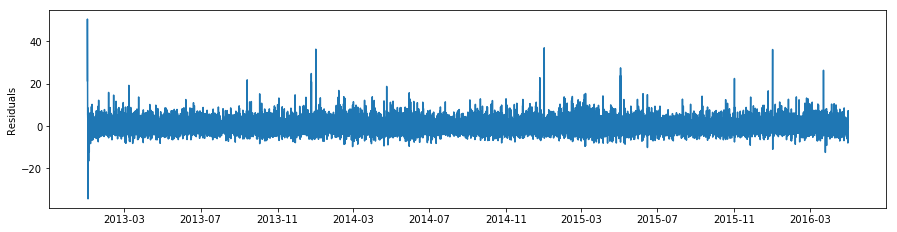

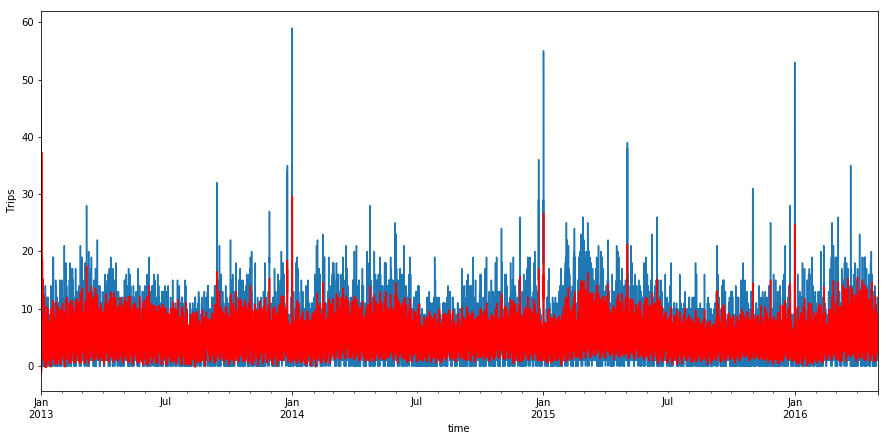

2. Forecast
End.


In [213]:
result_18, errors_18 = regions_forecast(17, attr_18, 1, 1, 1, 1, 0, 1, 5, 3, '2016.04.30 23:00:00', '2016.05.31 17:00')

In [216]:
write_best_params(17, result_18, 0, 1)

In [217]:
res_18_df = result_df(result_18, datetime.datetime(2016, 4, 30, 23), datetime.datetime(2016, 5, 31, 18), True)
res_18_df.to_csv("test_result/res_18.csv", sep=",", index=False)

Посчитайте в ноутбуке ошибку прогноза по следующему функционалу:

<center>$Q_{june}=\frac{1}{R∗739∗6}\sum_{r=1}^R\sum_{T=2016.04.30-23:00}^{2016.05.31-17:00}\sum_{i=1}^6\mid{\widehat{y}}^r_{T|T+i}−{\widehat{y}}^r_{T+i}\mid.$</center>

In [38]:
def check_result(f_path):
    file_path = glob(f_path, recursive=True)
    data_array = []
    for path in file_path:
        res = pd.read_csv(path, sep=",")
        data_array.append(res)
    
    res_data = pd.concat(data_array)
    
    abs_diff = (res_data.y - res_data.y_real).abs()
    sum_diff = abs_diff.sum()
    R_all = res_data.shape[0]
    result = sum_diff / R_all
    return result

In [39]:
check_result("test_result/*.csv")

35.283533214819535

## Задание № 7

Для каждой из $R$ географических зон настройте на данных до мая 2016 включительно модель ARIMA с гиперпараметрами, соответствующими кластеру этой зоны. Для каждого конца истории от 2016.05.31 23:00 до 2016.06.30 17:00 постройте прогноз на 6 часов вперёд и запишите все прогнозы в файл в формате id,y, где столбец id состоит из склеенных через подчёркивание идентификатора географической зоны, даты конца истории, часа конца истории и номера отсчёта, на который делается предсказание (1-6); столбец y — ваш прогноз.

In [40]:
def read_params(f_path):
    file_path = glob(f_path, recursive=True)
    lines = []
    for path in file_path:
        with open(path) as f:
            lines.append(f.readlines()[0].split(" "))

    par_list = dict()
    for line in lines:
        for param in line:
            p_list = param.split("_")
            par_list[p_list[0] + "_" + p_list[1]] = p_list[2:]
    return par_list

In [41]:
params = read_params("params/*.txt")

In [46]:
train_data, test_data = prepare_train_test_data('2016.05.31 23:00:00', '2016.06.01 00:00:00')

Дата и время начала тренировочных наблюдений:  2013-01-01 00:00:00
Дата и время окончания тренировочных наблюдений:  2016-05-31 23:00:00

Дата и время начала тестовых наблюдений:  2016-06-01 00:00:00
Дата и время окончания тестовых наблюдений:  2016-06-30 23:00:00


In [50]:
def control_forecast(cluster_num, week_k, year_k, params, start_date='2016.05.31 23:00:00', end_date='2016.06.30 17:00'):
    attr = set_attributes(train_data.iloc[:,0], week_k, year_k, False)[1]
    results, errors = regions_forecast(cluster_num, attr, 0, 0, 0, 0, 0, 0, week_k, year_k, start_date, end_date, params)
    res_df = result_df(results, datetime.datetime(2016, 5, 31, 23), datetime.datetime(2016, 6, 30, 18), True)
    res_df.to_csv("result/res_" + str(cluster_num + 1) + ".csv", sep=",", index=False)
    return results

### Контрольный прогноз

Start region_1175:
1. Train
geting params
1 1 1 1 0 0
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood              -97191.263
Date:                            Sat, 09 Dec 2017   AIC                         194466.525
Time:                                    14:35:33   BIC                         194815.400
Sample:                                         0   HQIC                        194578.479
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -1.0029      0.124   

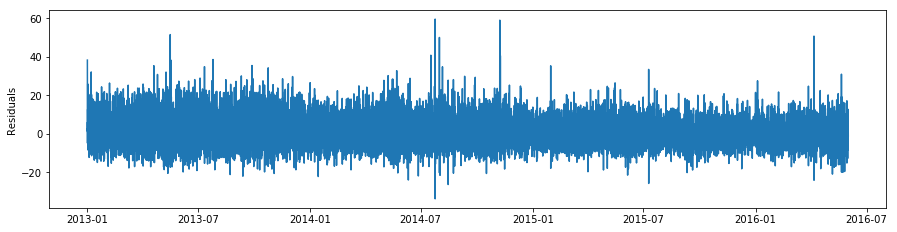

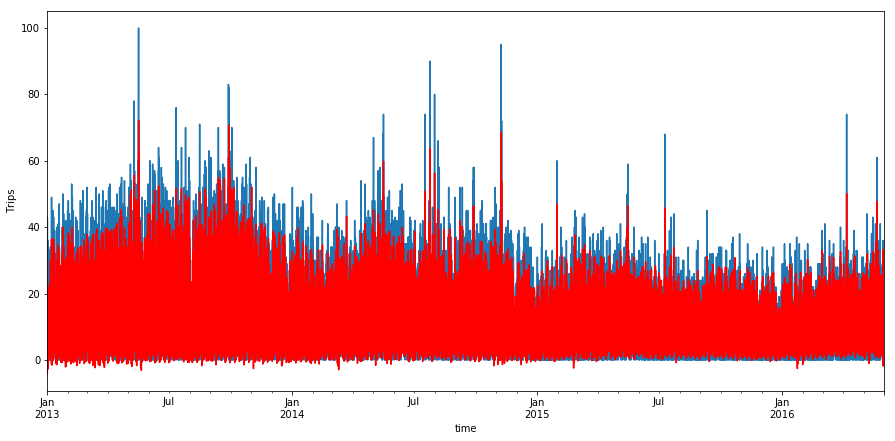

2. Forecast
End.
Start region_1337:
1. Train
geting params
1 1 1 1 0 0
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -128829.769
Date:                            Sat, 09 Dec 2017   AIC                         257743.537
Time:                                    15:03:36   BIC                         258092.412
Sample:                                         0   HQIC                        257855.491
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -3.6

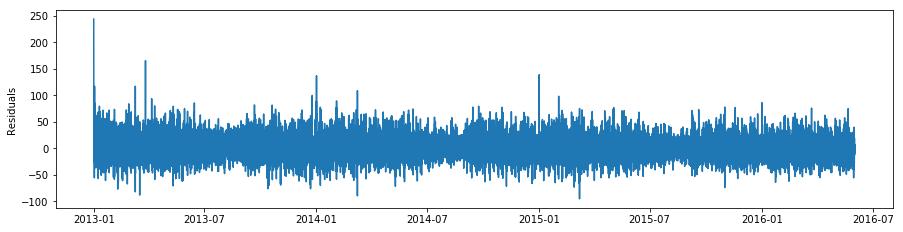

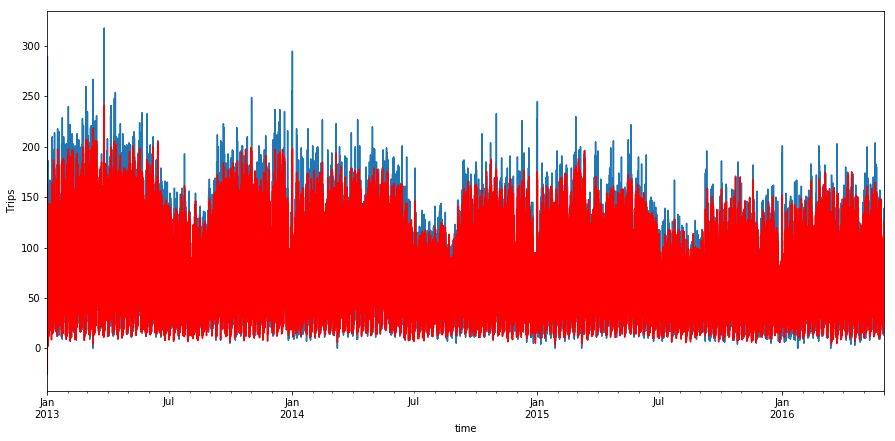

2. Forecast
End.
Start region_1338:
1. Train
geting params
1 1 1 1 0 0
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -122288.808
Date:                            Sat, 09 Dec 2017   AIC                         244661.616
Time:                                    15:35:01   BIC                         245010.492
Sample:                                         0   HQIC                        244773.570
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             5.8

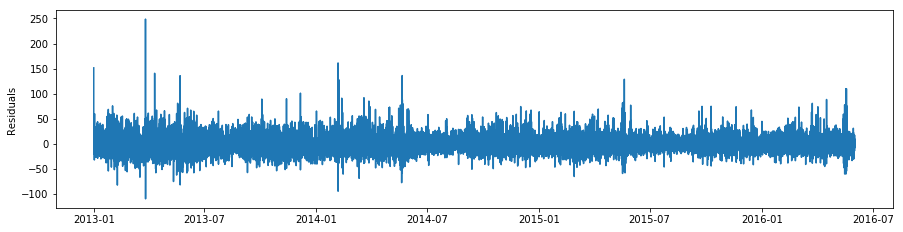

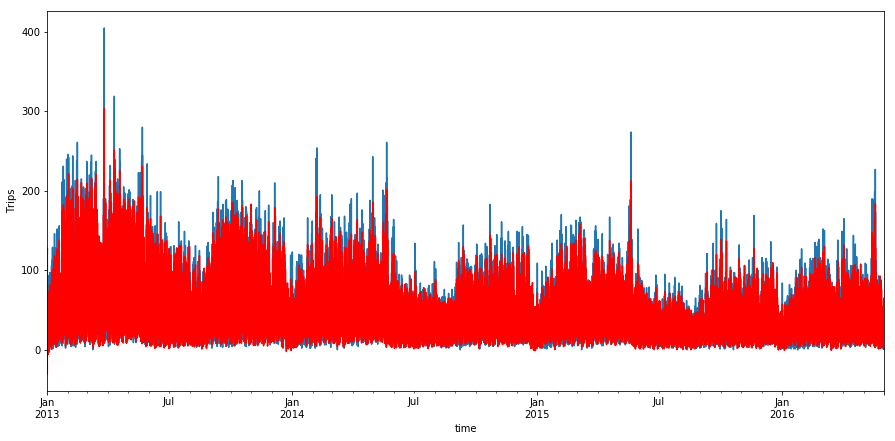

2. Forecast
End.
Start region_1339:
1. Train
geting params
1 1 1 1 0 0
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood              -91469.983
Date:                            Sat, 09 Dec 2017   AIC                         183023.966
Time:                                    15:53:49   BIC                         183372.841
Sample:                                         0   HQIC                        183135.919
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -1.3

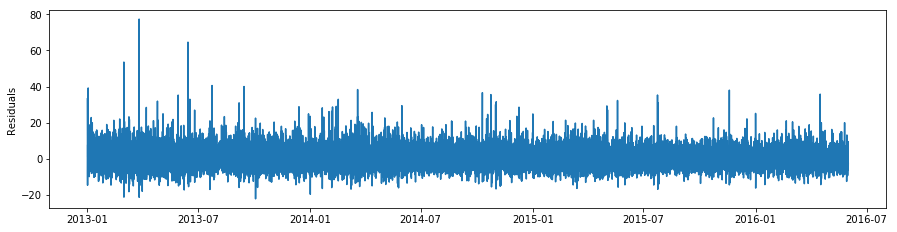

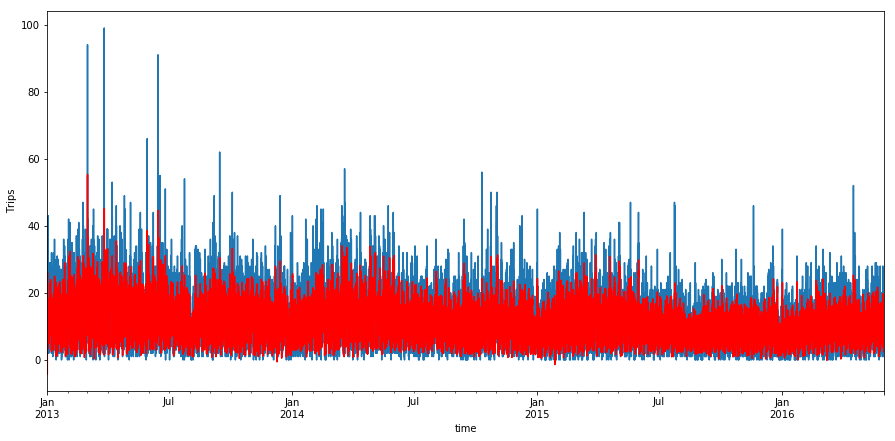

2. Forecast
End.
Start region_1386:
1. Train
geting params
1 1 1 1 0 0
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -115464.329
Date:                            Sat, 09 Dec 2017   AIC                         231012.658
Time:                                    16:19:17   BIC                         231361.533
Sample:                                         0   HQIC                        231124.611
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             1.7

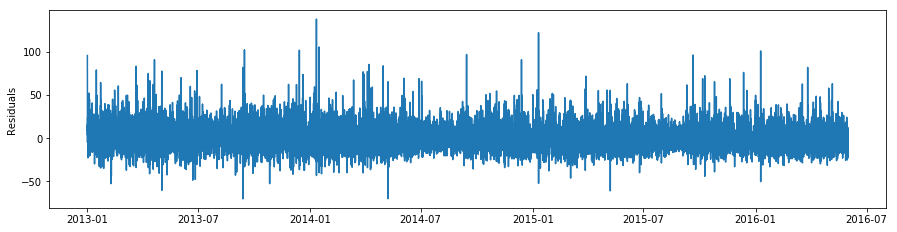

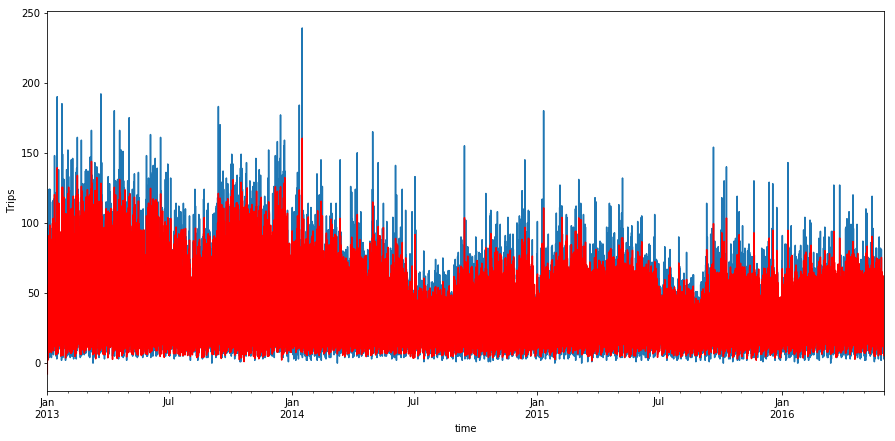

2. Forecast
End.
Start region_1442:
1. Train
geting params
1 1 1 1 0 0
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood              -82408.565
Date:                            Sat, 09 Dec 2017   AIC                         164901.130
Time:                                    16:46:24   BIC                         165250.005
Sample:                                         0   HQIC                        165013.083
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.4

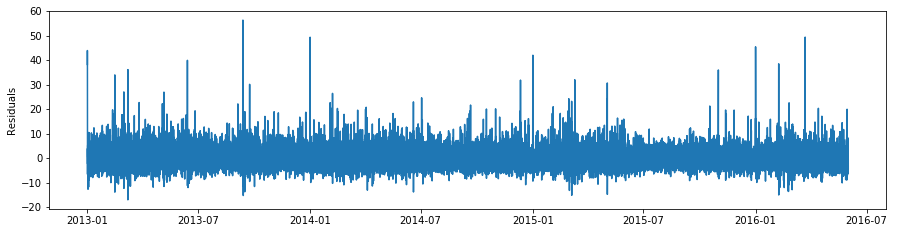

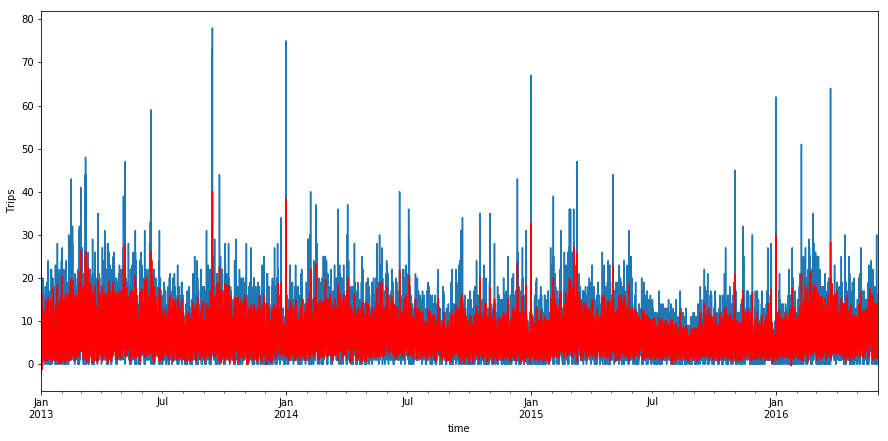

2. Forecast
End.


In [47]:
result_1 = control_forecast(0, 6, 12, params)

Start region_1129:
1. Train
geting params
1 1 1 1 0 0
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -170540.712
Date:                            Sat, 09 Dec 2017   AIC                         341165.423
Time:                                    21:48:46   BIC                         341514.298
Sample:                                         0   HQIC                        341277.377
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           -51.6440      3.949   

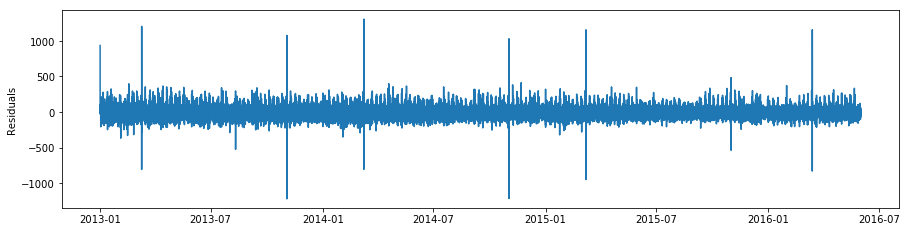

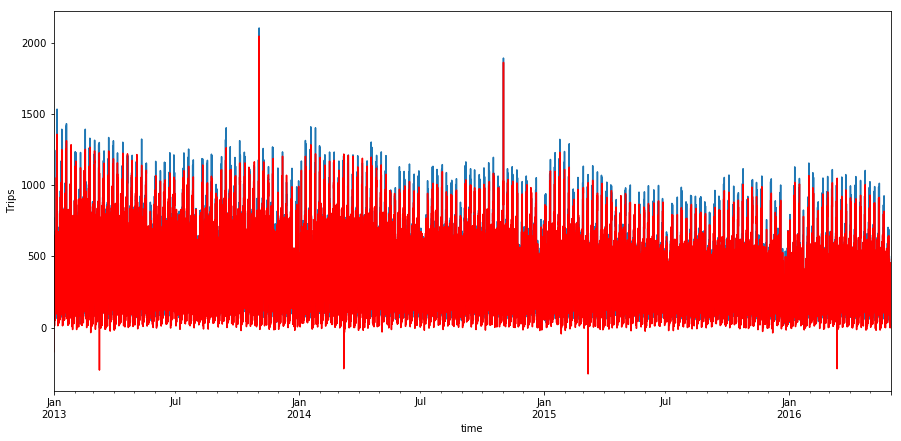

2. Forecast
End.
Start region_1130:
1. Train
geting params
1 1 1 1 0 0
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -174932.145
Date:                            Sat, 09 Dec 2017   AIC                         349948.291
Time:                                    22:15:43   BIC                         350297.166
Sample:                                         0   HQIC                        350060.244
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           -44.4

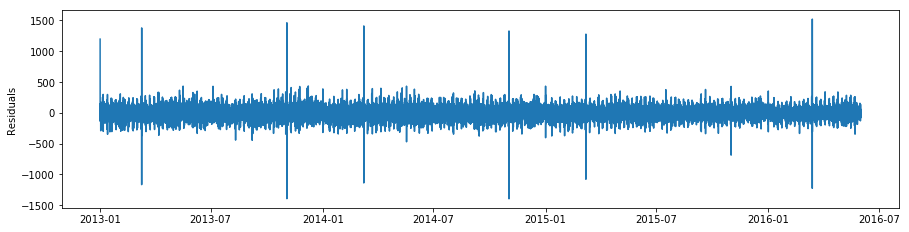

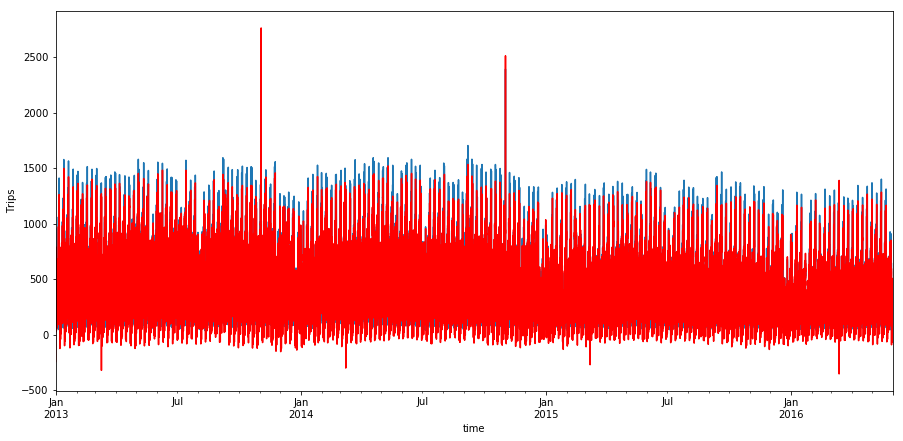

2. Forecast
End.
Start region_1176:
1. Train
geting params
1 1 1 1 0 0
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -104642.485
Date:                            Sat, 09 Dec 2017   AIC                         209368.970
Time:                                    22:43:07   BIC                         209717.845
Sample:                                         0   HQIC                        209480.923
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -5.1

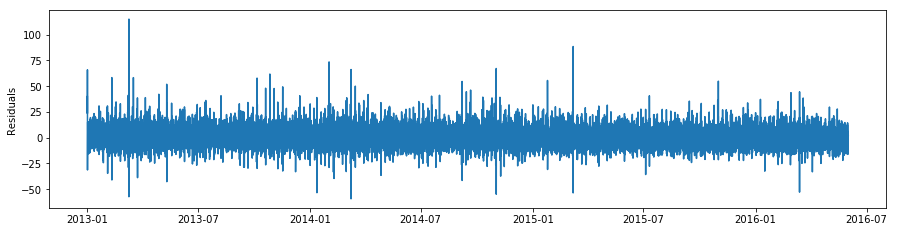

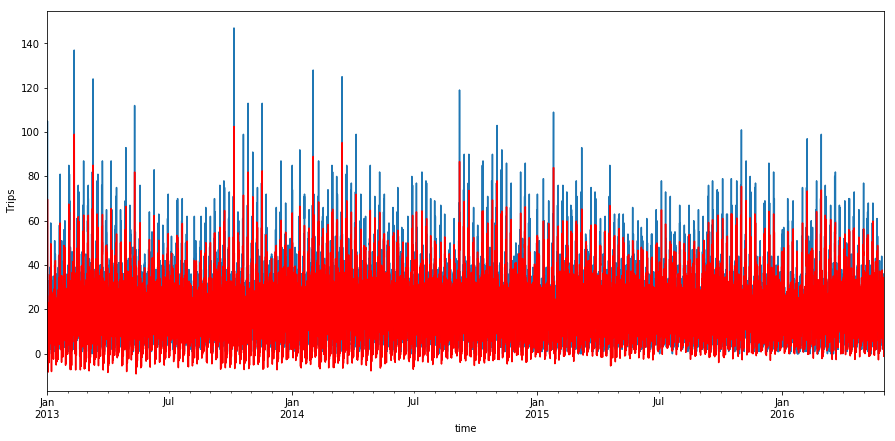

2. Forecast
End.
Start region_1177:
1. Train
geting params
1 1 1 1 0 0
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -173489.204
Date:                            Sat, 09 Dec 2017   AIC                         347062.407
Time:                                    23:13:21   BIC                         347411.282
Sample:                                         0   HQIC                        347174.361
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           -83.8

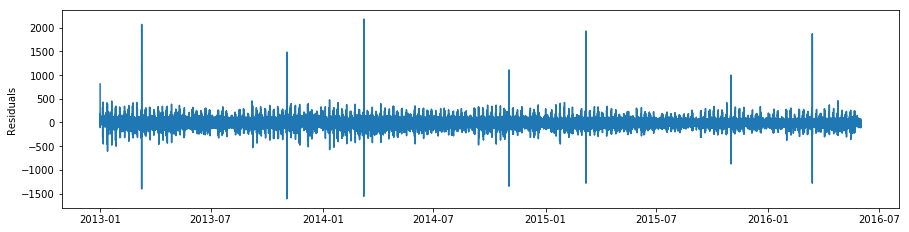

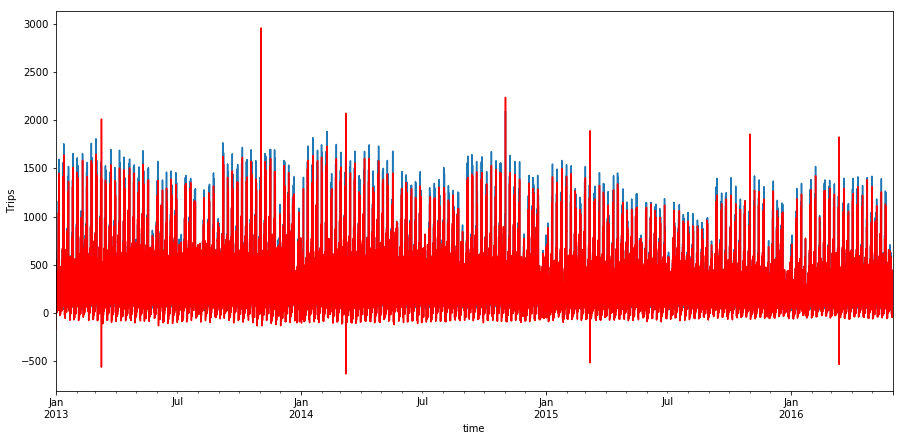

2. Forecast
End.
Start region_1178:
1. Train
geting params
1 1 1 1 0 0
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -176690.445
Date:                            Sat, 09 Dec 2017   AIC                         353464.889
Time:                                    23:41:19   BIC                         353813.764
Sample:                                         0   HQIC                        353576.843
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           -49.7

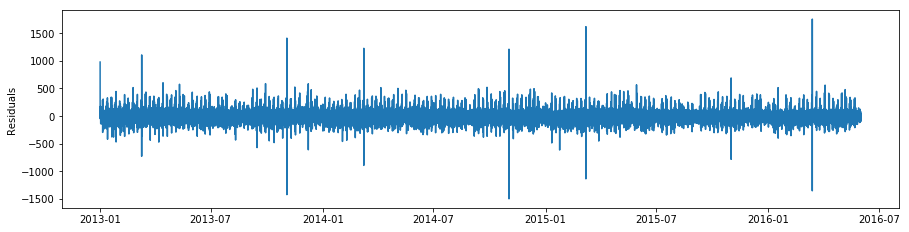

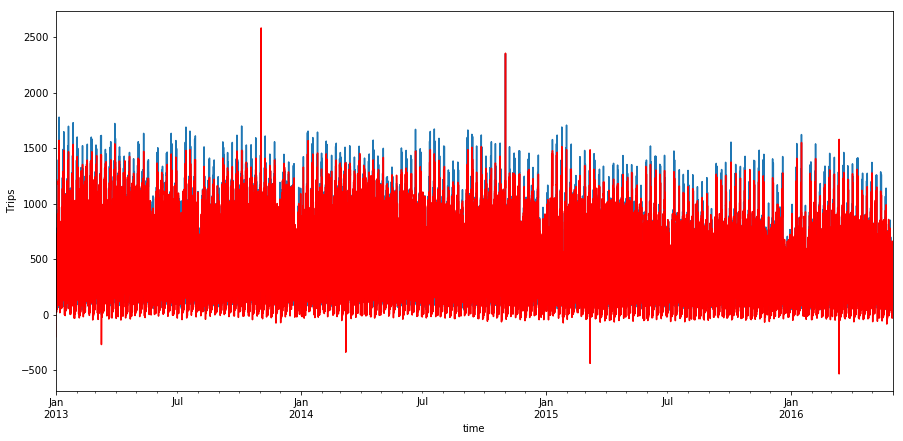

2. Forecast
End.
Start region_1227:
1. Train
geting params
1 1 1 1 0 0
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -163400.905
Date:                            Sun, 10 Dec 2017   AIC                         326885.810
Time:                                    00:11:04   BIC                         327234.685
Sample:                                         0   HQIC                        326997.763
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           -64.3

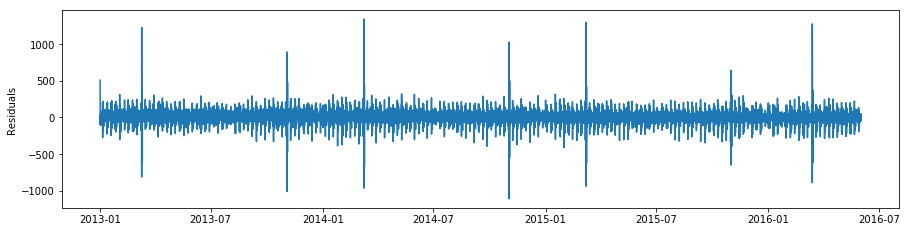

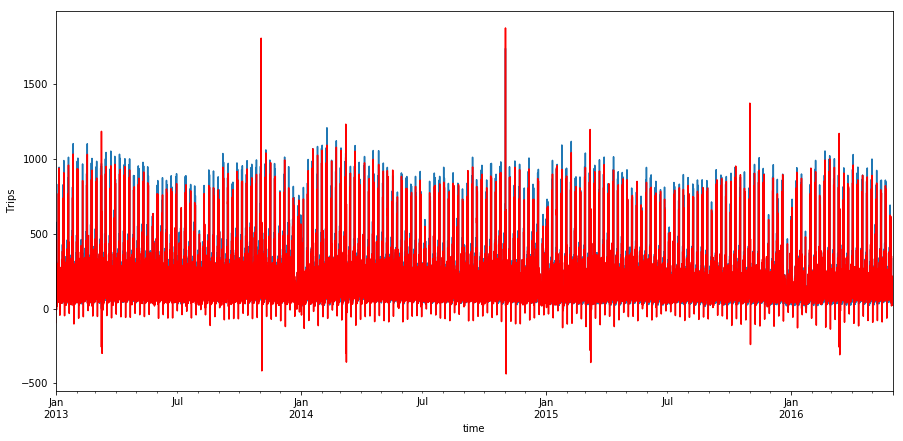

2. Forecast
End.
Start region_1228:
1. Train
geting params
1 1 1 1 0 0
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood             -173686.148
Date:                            Sun, 10 Dec 2017   AIC                         347456.297
Time:                                    00:43:45   BIC                         347805.172
Sample:                                         0   HQIC                        347568.250
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1          -111.7

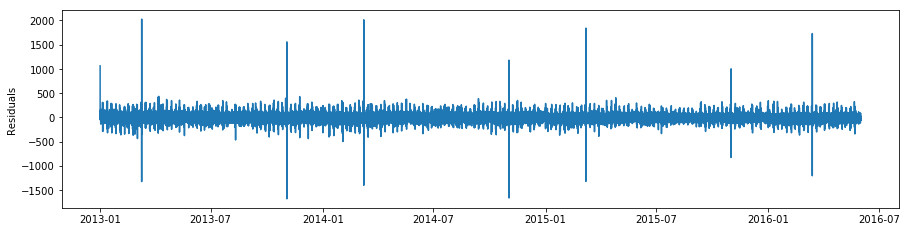

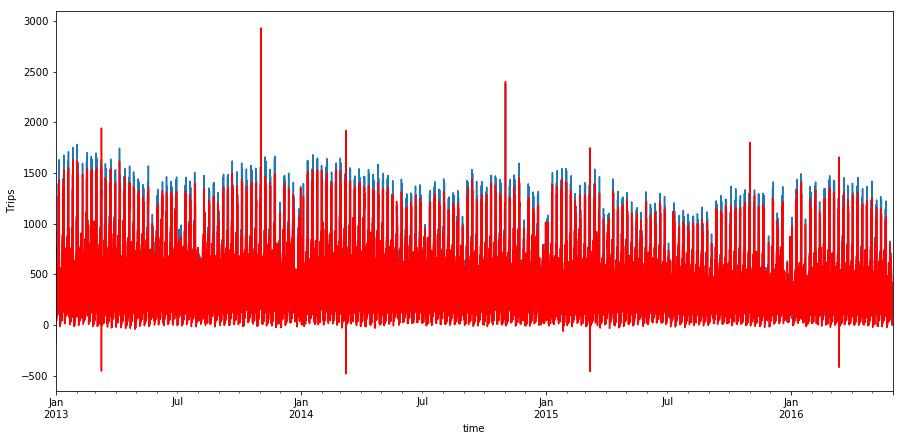

2. Forecast
End.
Start region_1278:
1. Train
geting params
1 1 1 1 0 0
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 0, 1, 24)   Log Likelihood              -97247.375
Date:                            Sun, 10 Dec 2017   AIC                         194578.750
Time:                                    01:13:15   BIC                         194927.625
Sample:                                         0   HQIC                        194690.703
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -4.6

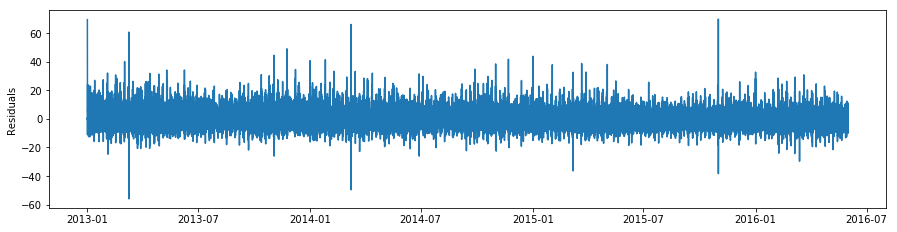

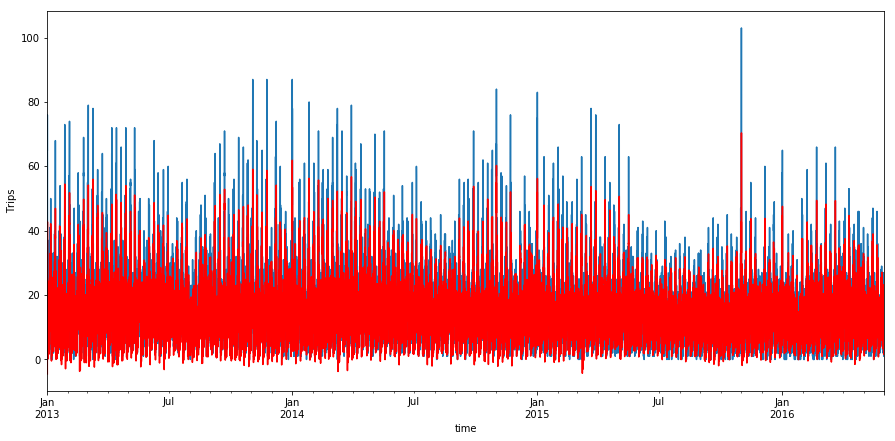

2. Forecast
End.


In [51]:
result_2 = control_forecast(1, 4, 14, params)

Start region_1127:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -157387.517
Date:                            Sun, 10 Dec 2017   AIC                         314851.035
Time:                                    02:20:02   BIC                         315166.684
Sample:                                         0   HQIC                        314952.326
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            21.1847      2.335   

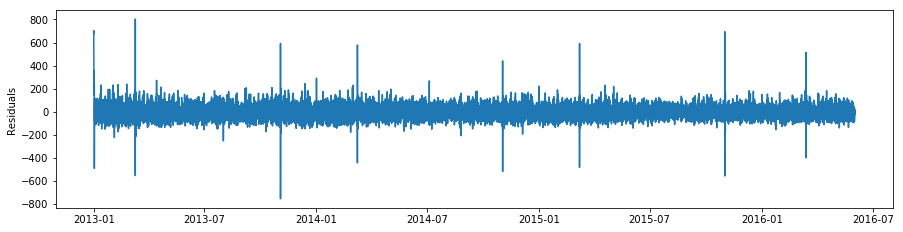

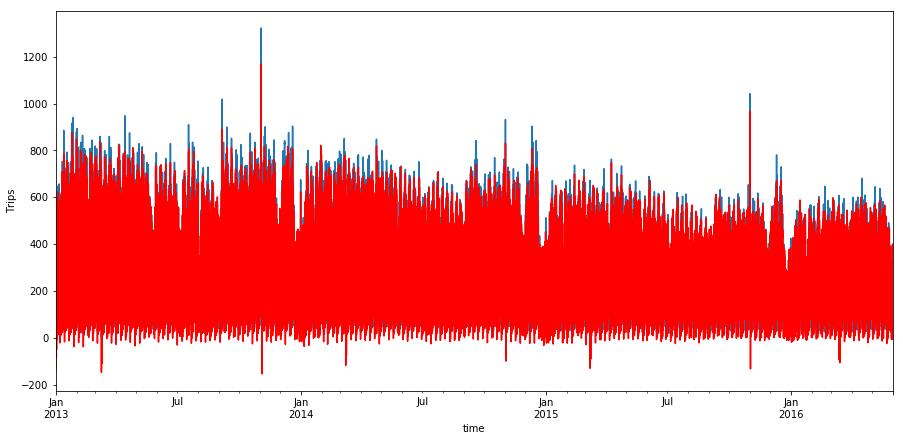

2. Forecast
End.
Start region_1128:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -163207.191
Date:                            Sun, 10 Dec 2017   AIC                         326490.382
Time:                                    03:50:46   BIC                         326806.031
Sample:                                         0   HQIC                        326591.673
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -4.2

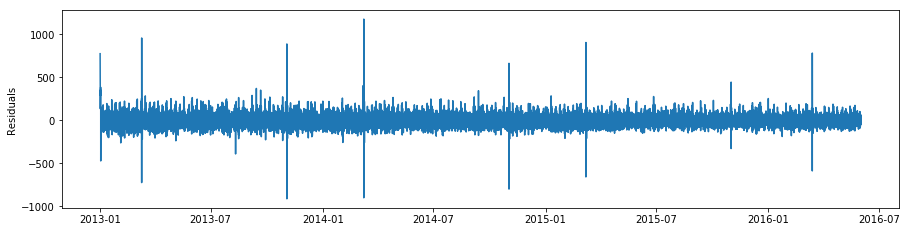

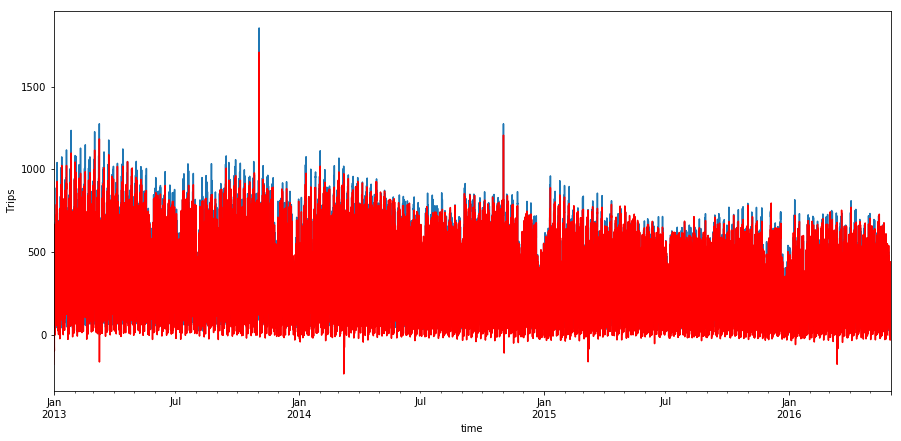

2. Forecast
End.
Start region_1131:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -148237.787
Date:                            Sun, 10 Dec 2017   AIC                         296551.575
Time:                                    05:22:26   BIC                         296867.224
Sample:                                         0   HQIC                        296652.866
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            10.0

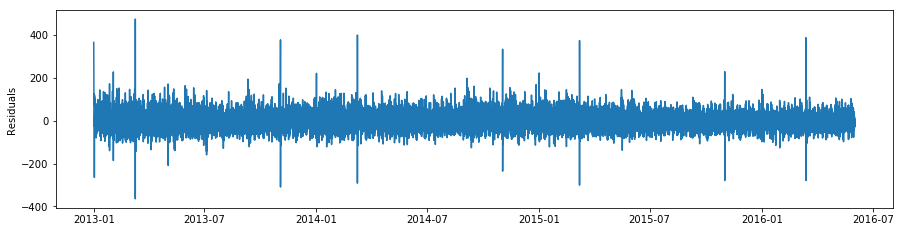

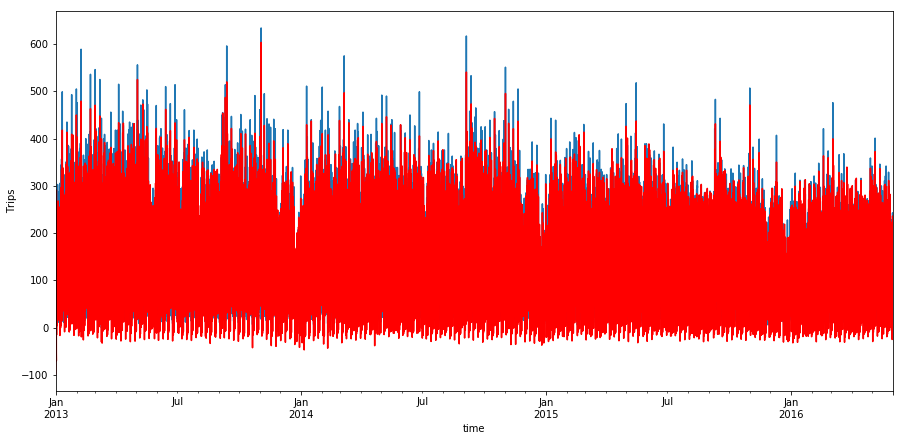

2. Forecast
End.
Start region_1179:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -171772.197
Date:                            Sun, 10 Dec 2017   AIC                         343620.395
Time:                                    06:41:01   BIC                         343936.043
Sample:                                         0   HQIC                        343721.686
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             3.9

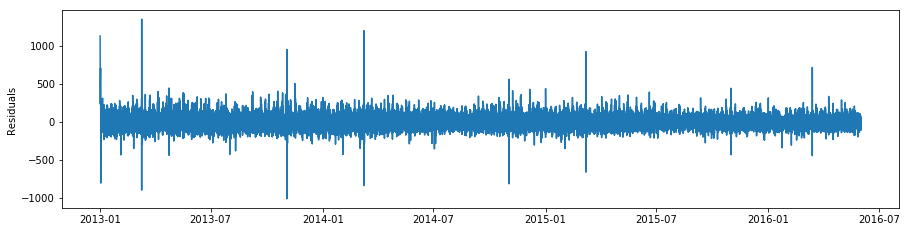

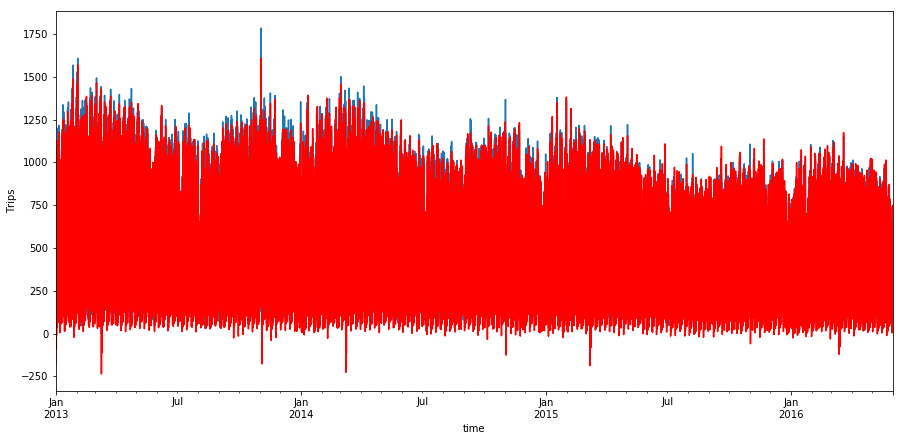

2. Forecast
End.
Start region_1182:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -171624.555
Date:                            Sun, 10 Dec 2017   AIC                         343325.110
Time:                                    07:57:51   BIC                         343640.759
Sample:                                         0   HQIC                        343426.401
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           -33.9

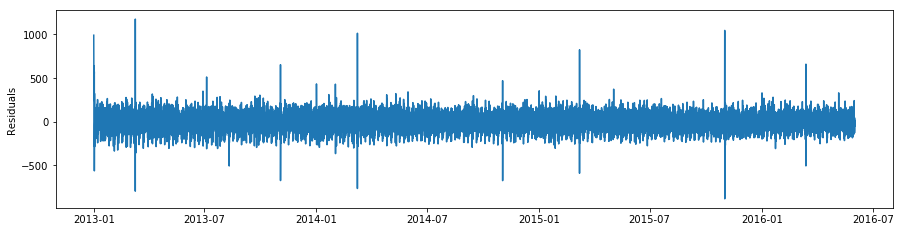

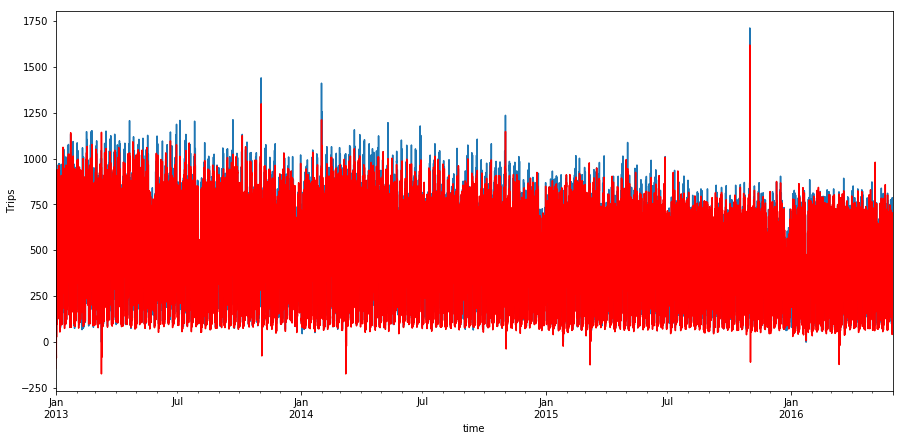

2. Forecast
End.
Start region_1224:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -105476.209
Date:                            Sun, 10 Dec 2017   AIC                         211028.418
Time:                                    09:11:14   BIC                         211344.067
Sample:                                         0   HQIC                        211129.709
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -3.3

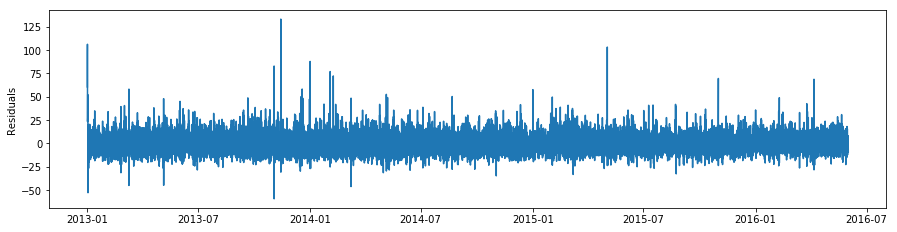

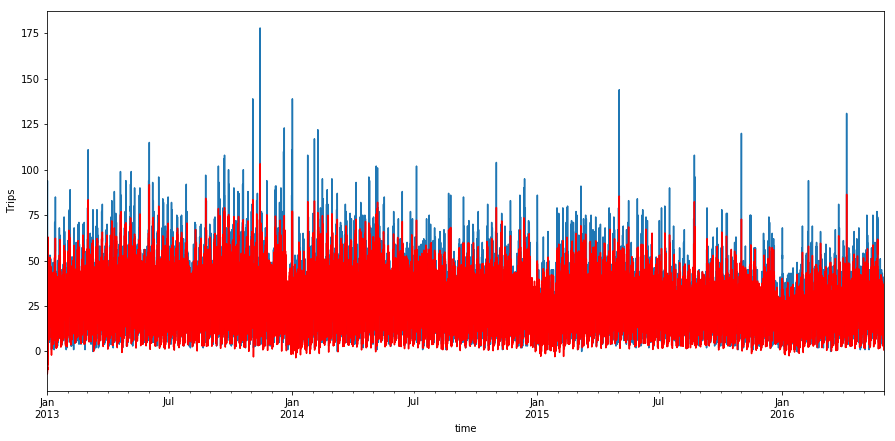

2. Forecast
End.
Start region_1229:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -172871.210
Date:                            Sun, 10 Dec 2017   AIC                         345818.419
Time:                                    10:25:10   BIC                         346134.068
Sample:                                         0   HQIC                        345919.710
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           -35.9

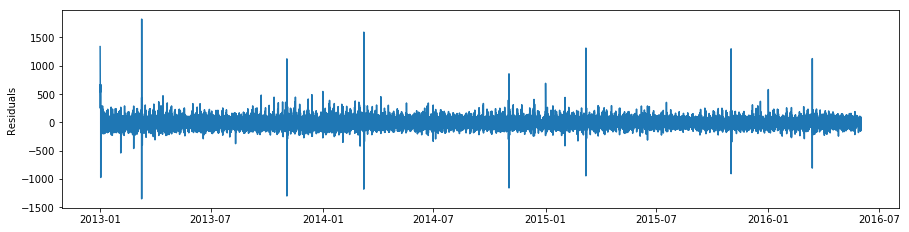

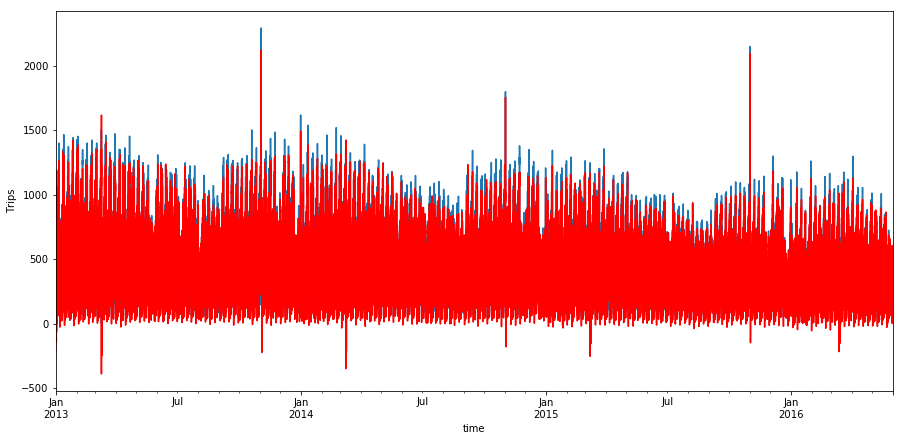

2. Forecast
End.
Start region_1230:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -180905.865
Date:                            Sun, 10 Dec 2017   AIC                         361887.730
Time:                                    11:48:57   BIC                         362203.379
Sample:                                         0   HQIC                        361989.021
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            32.8

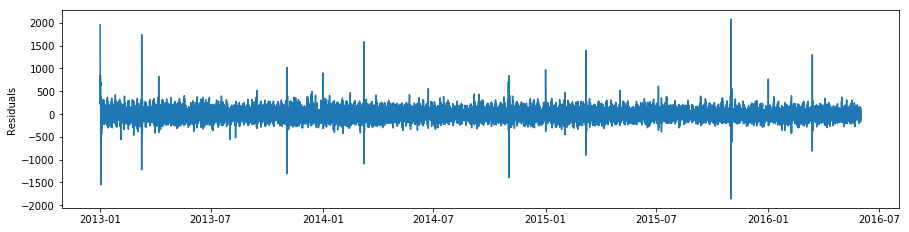

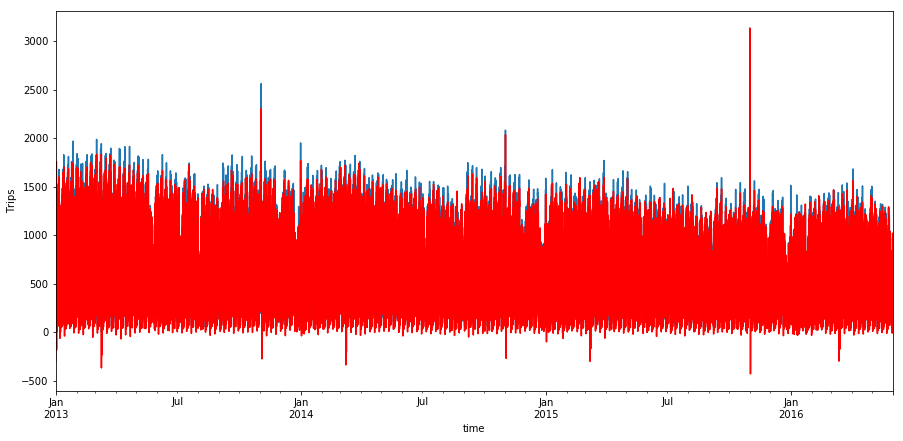

2. Forecast
End.


In [52]:
result_3 = control_forecast(2, 6, 10, params)

Start region_1076:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -137997.986
Date:                            Sun, 10 Dec 2017   AIC                         276075.973
Time:                                    18:18:30   BIC                         276408.235
Sample:                                         0   HQIC                        276182.595
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             6.4983      0.810   

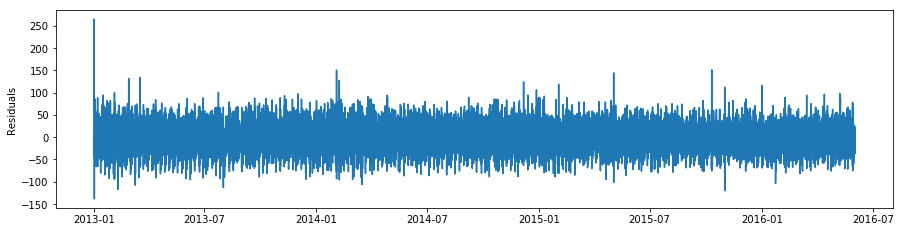

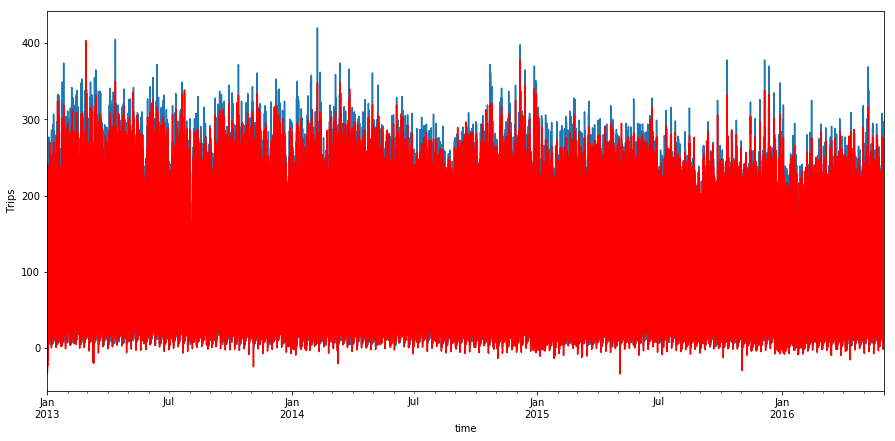

2. Forecast
End.
Start region_1077:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -134153.655
Date:                            Sun, 10 Dec 2017   AIC                         268387.311
Time:                                    20:22:12   BIC                         268719.573
Sample:                                         0   HQIC                        268493.933
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            17.1

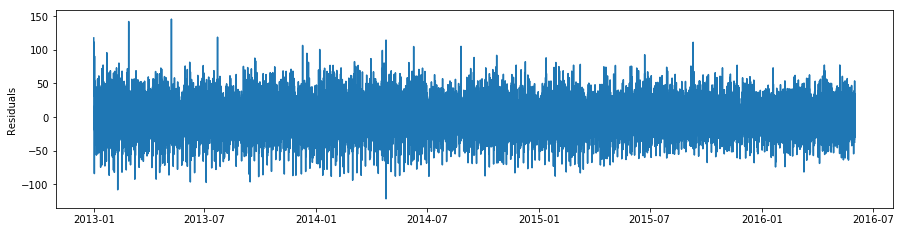

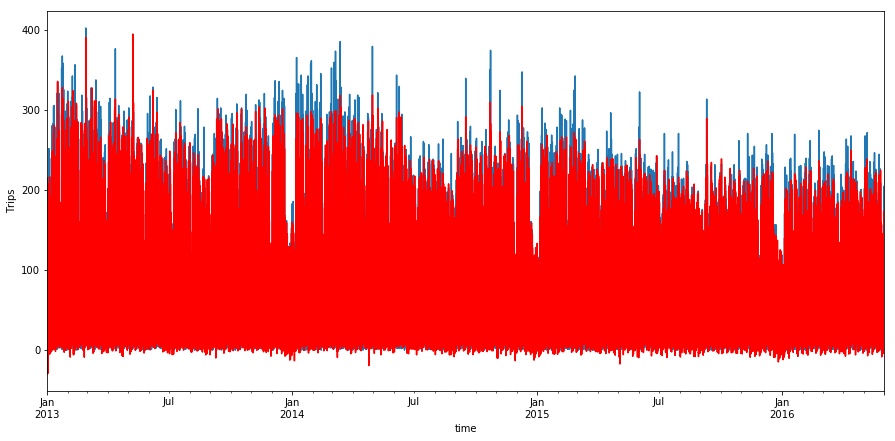

2. Forecast
End.
Start region_1132:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -129151.471
Date:                            Sun, 10 Dec 2017   AIC                         258382.943
Time:                                    22:36:05   BIC                         258715.205
Sample:                                         0   HQIC                        258489.565
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -2.9

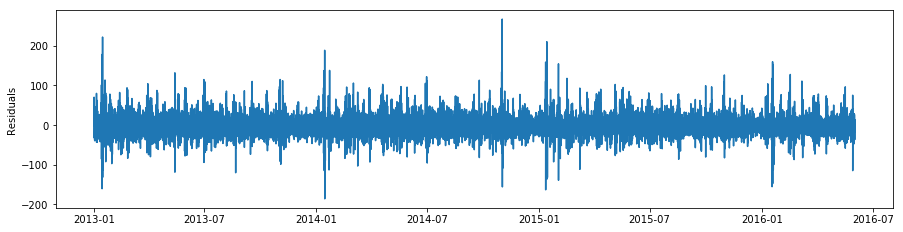

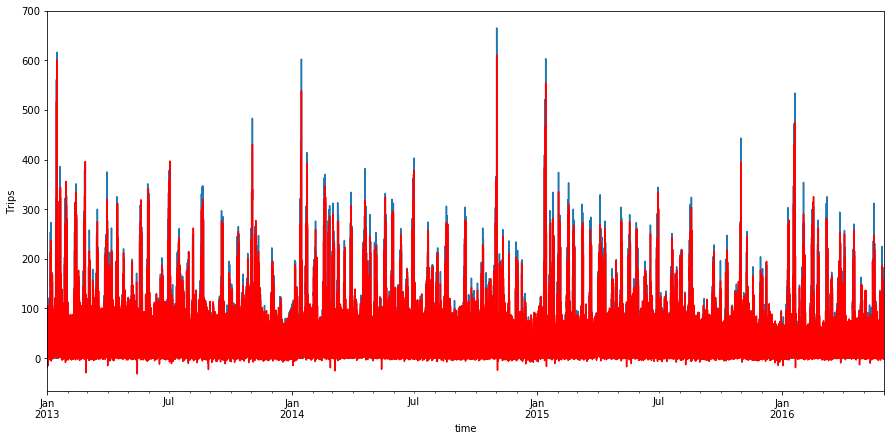

2. Forecast
End.
Start region_1181:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -185831.038
Date:                            Mon, 11 Dec 2017   AIC                         371742.076
Time:                                    00:36:03   BIC                         372074.338
Sample:                                         0   HQIC                        371848.699
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            29.8

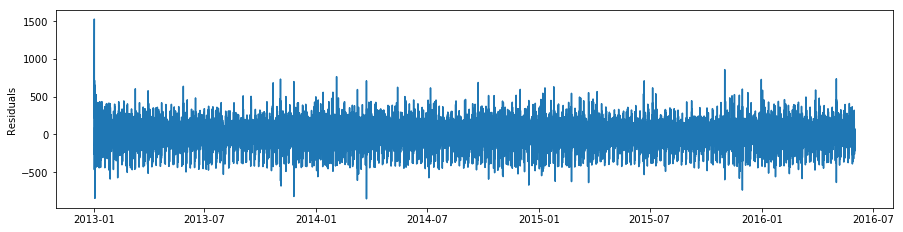

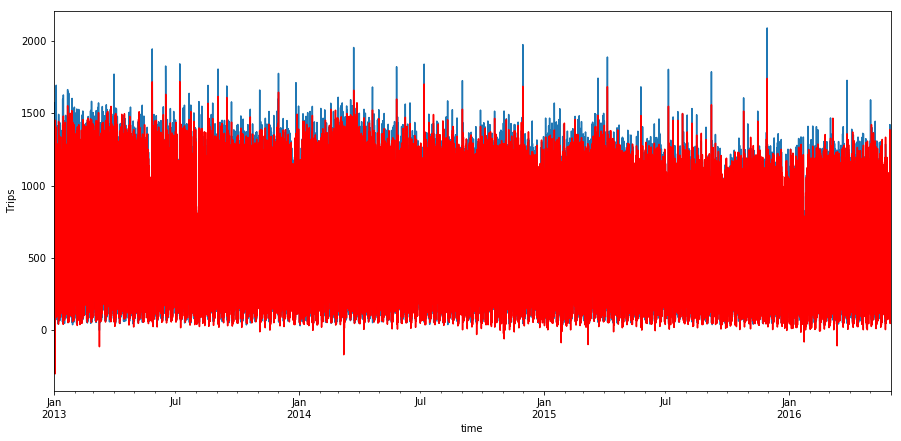

2. Forecast
End.
Start region_1183:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -148226.864
Date:                            Mon, 11 Dec 2017   AIC                         296533.729
Time:                                    02:57:44   BIC                         296865.991
Sample:                                         0   HQIC                        296640.351
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -3.2

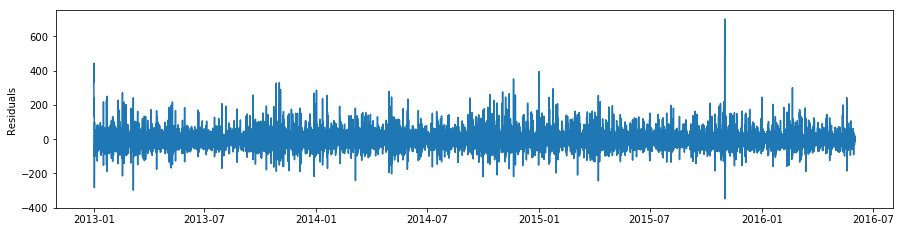

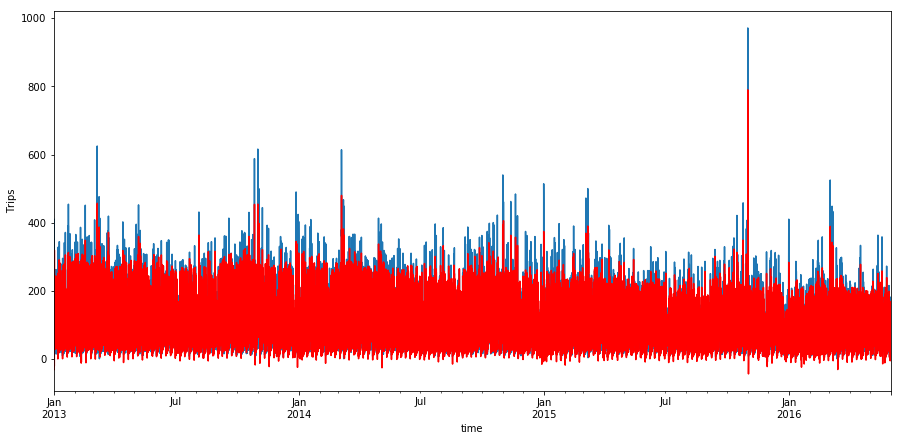

2. Forecast
End.
Start region_1184:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -103275.069
Date:                            Mon, 11 Dec 2017   AIC                         206630.139
Time:                                    04:46:08   BIC                         206962.401
Sample:                                         0   HQIC                        206736.761
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.0

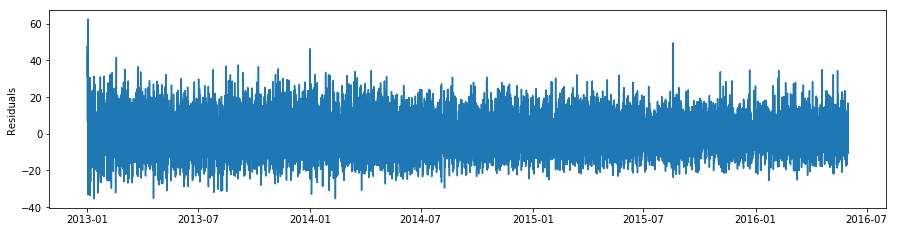

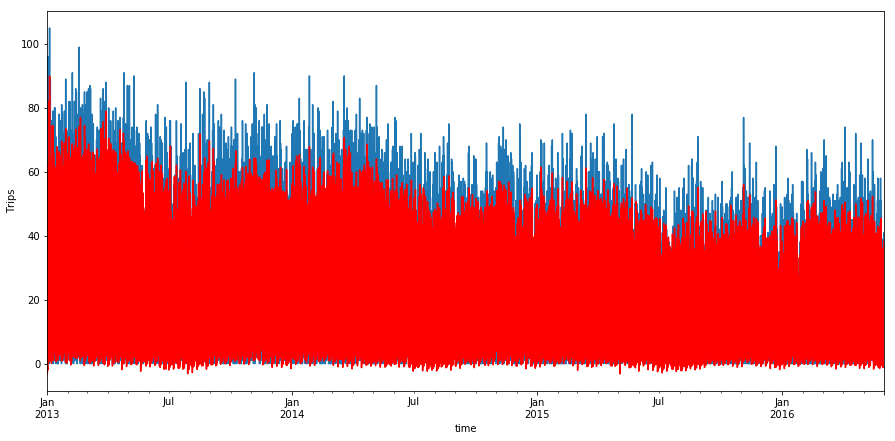

2. Forecast
End.
Start region_1234:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -165608.185
Date:                            Mon, 11 Dec 2017   AIC                         331296.370
Time:                                    06:12:22   BIC                         331628.632
Sample:                                         0   HQIC                        331402.992
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            10.0

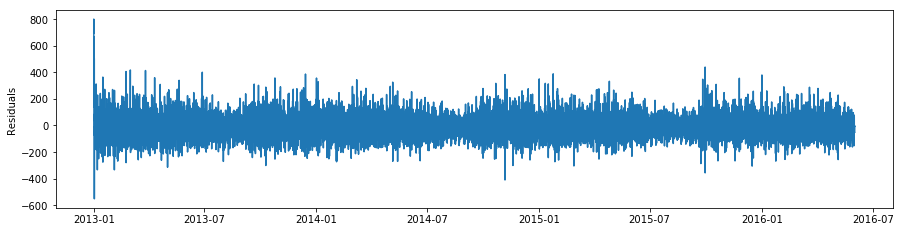

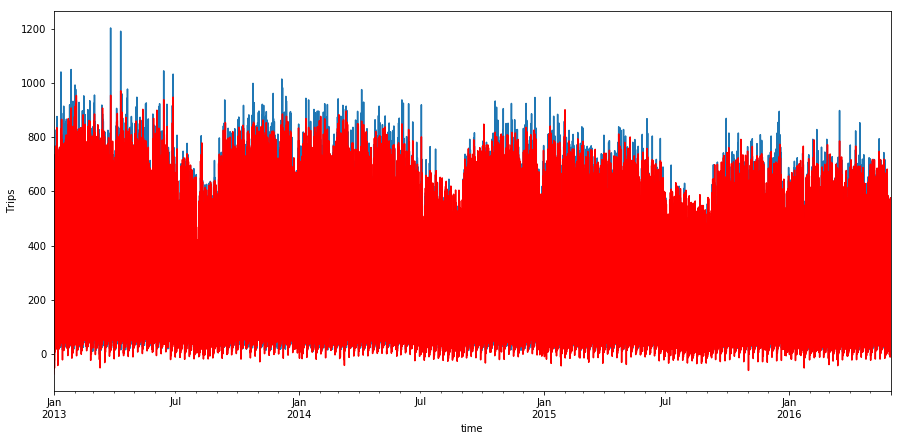

2. Forecast
End.
Start region_1235:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -141424.931
Date:                            Mon, 11 Dec 2017   AIC                         282929.862
Time:                                    07:41:39   BIC                         283262.124
Sample:                                         0   HQIC                        283036.484
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             2.8

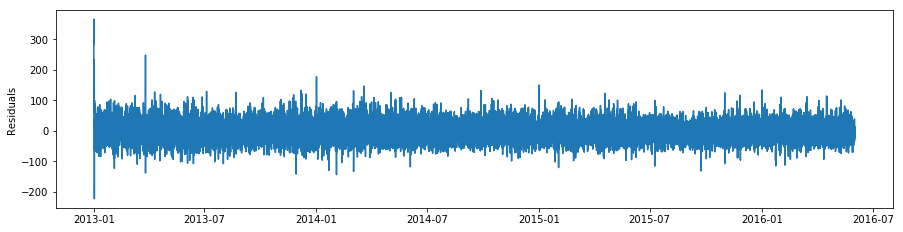

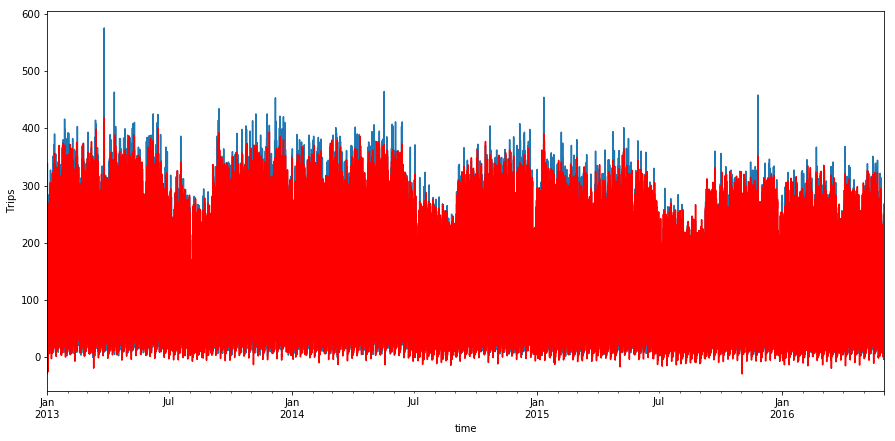

2. Forecast
End.
Start region_1279:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -111561.738
Date:                            Mon, 11 Dec 2017   AIC                         223203.477
Time:                                    09:37:38   BIC                         223535.739
Sample:                                         0   HQIC                        223310.099
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -2.0

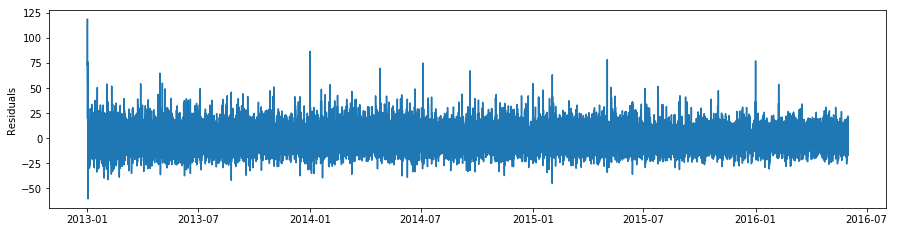

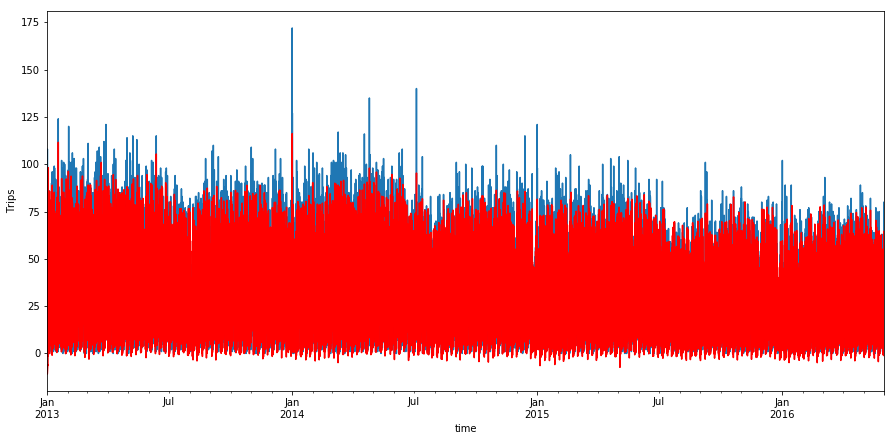

2. Forecast
End.
Start region_1280:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -149153.107
Date:                            Mon, 11 Dec 2017   AIC                         298386.214
Time:                                    11:14:16   BIC                         298718.476
Sample:                                         0   HQIC                        298492.837
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             3.9

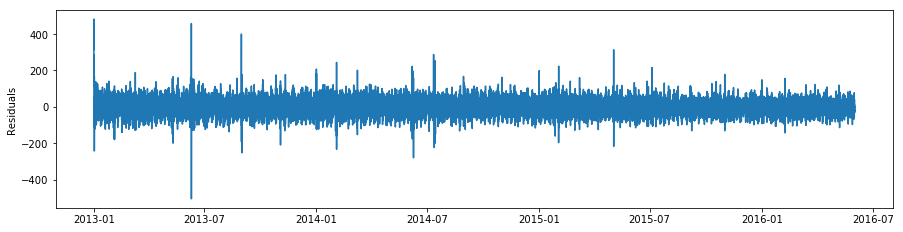

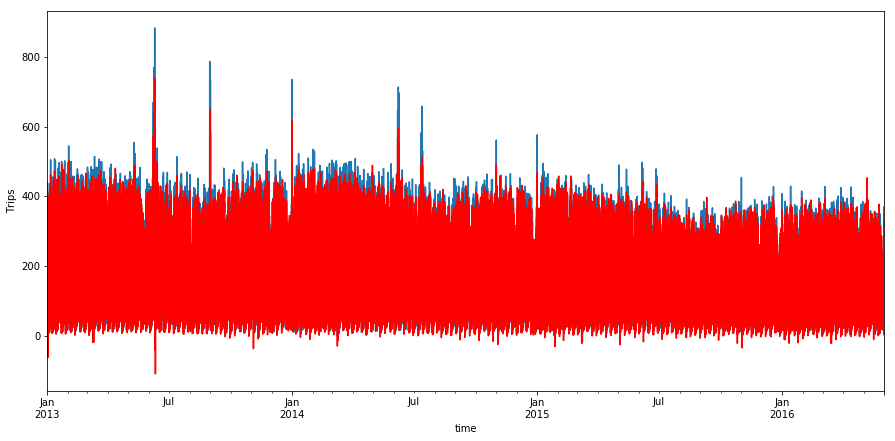

2. Forecast
End.
Start region_1284:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -132691.966
Date:                            Mon, 11 Dec 2017   AIC                         265463.932
Time:                                    12:33:41   BIC                         265796.194
Sample:                                         0   HQIC                        265570.554
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             1.0

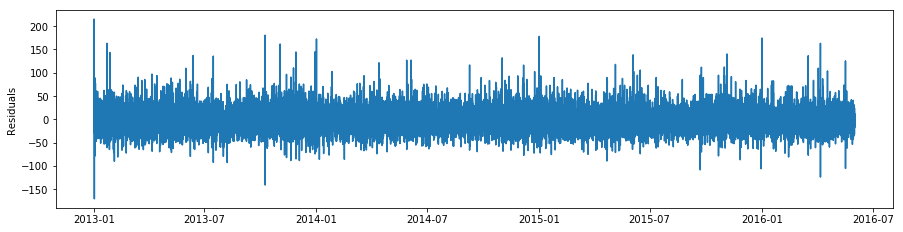

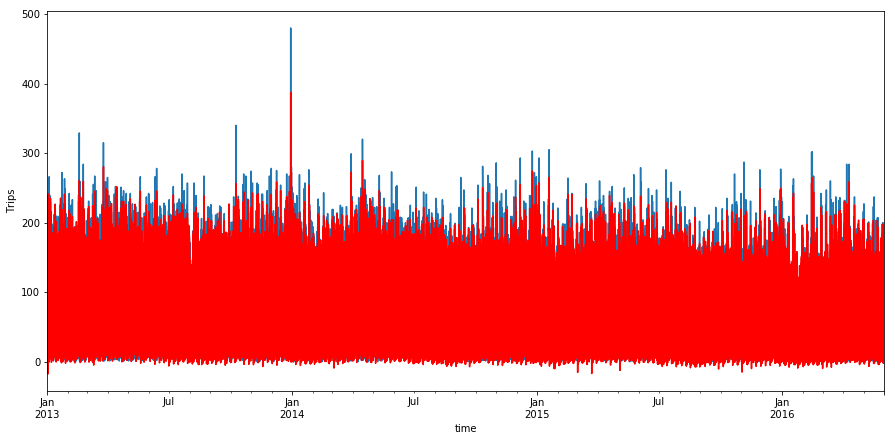

2. Forecast
End.
Start region_1285:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -153847.471
Date:                            Mon, 11 Dec 2017   AIC                         307774.942
Time:                                    13:58:56   BIC                         308107.204
Sample:                                         0   HQIC                        307881.564
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.8

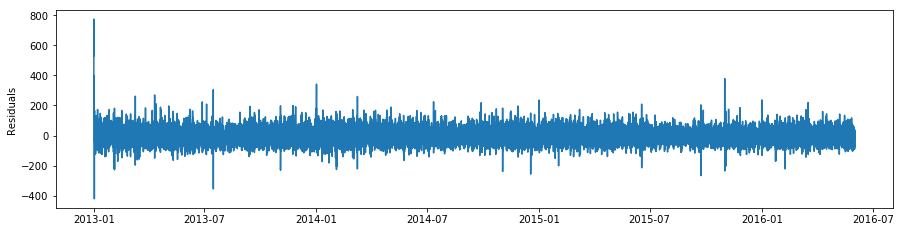

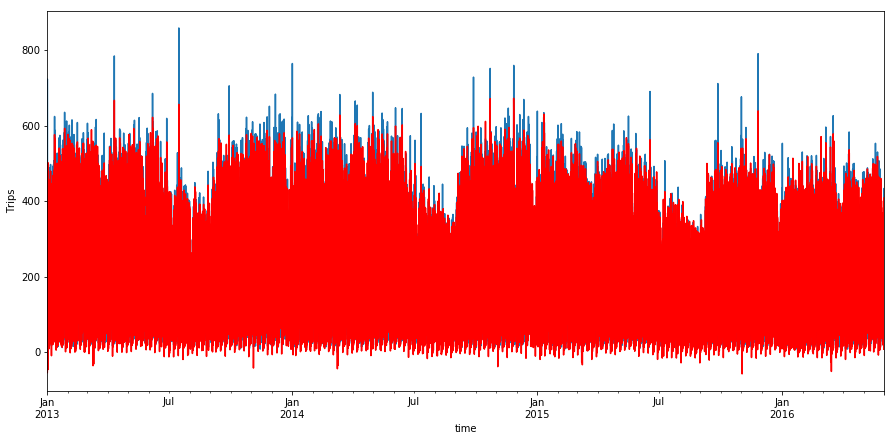

2. Forecast
End.
Start region_1286:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -149765.142
Date:                            Mon, 11 Dec 2017   AIC                         299610.284
Time:                                    15:28:38   BIC                         299942.546
Sample:                                         0   HQIC                        299716.907
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -2.4

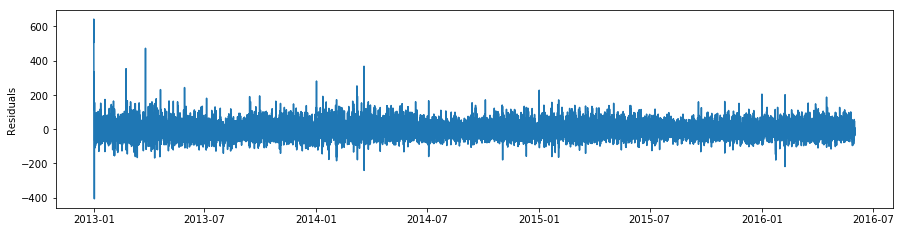

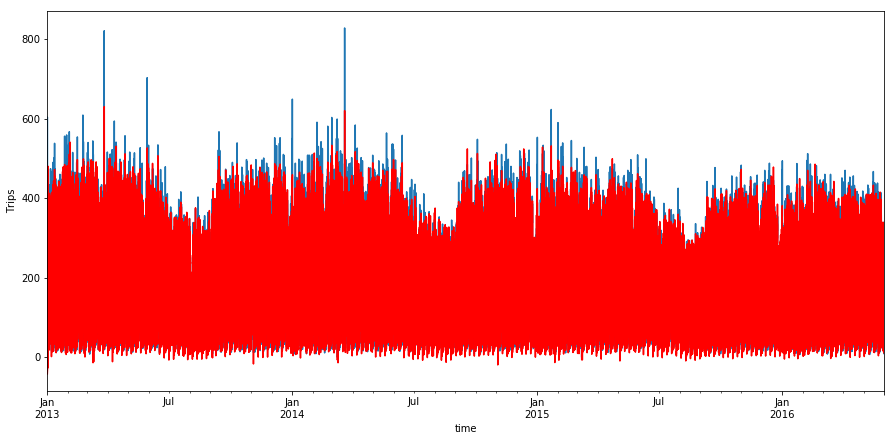

2. Forecast
End.
Start region_1287:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -126907.812
Date:                            Mon, 11 Dec 2017   AIC                         253895.625
Time:                                    16:59:15   BIC                         254227.886
Sample:                                         0   HQIC                        254002.247
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -2.7

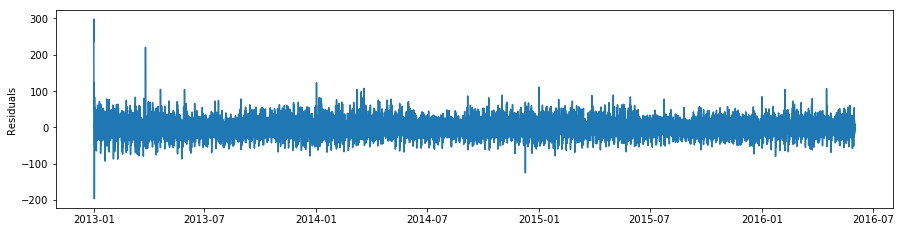

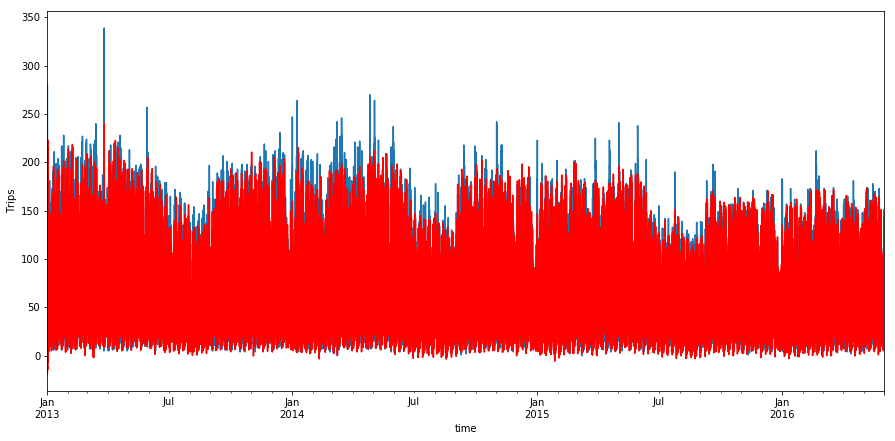

2. Forecast
End.
Start region_1331:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -119903.047
Date:                            Mon, 11 Dec 2017   AIC                         239886.094
Time:                                    18:23:04   BIC                         240218.356
Sample:                                         0   HQIC                        239992.716
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             7.1

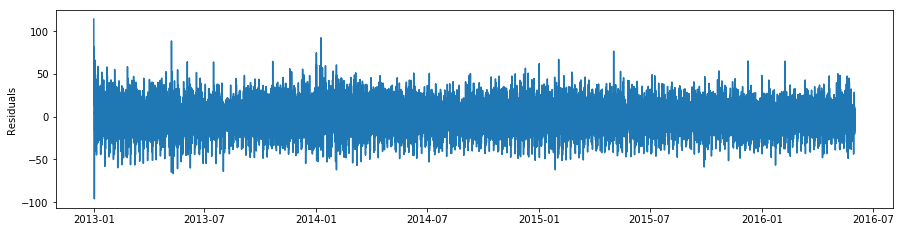

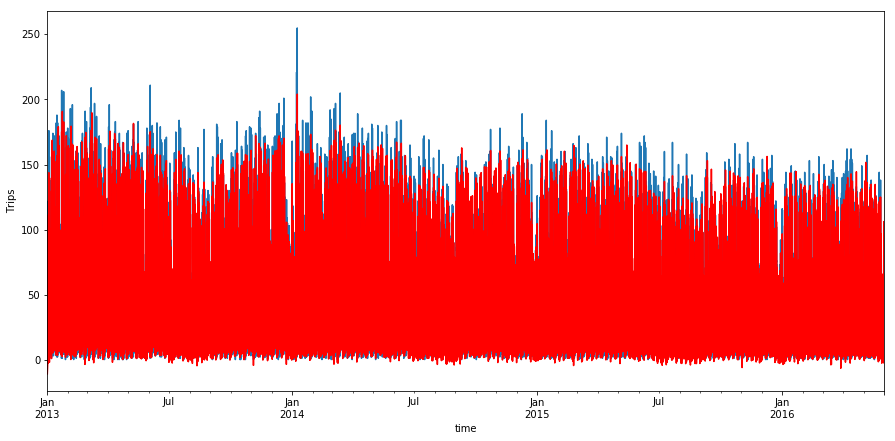

2. Forecast
End.
Start region_1332:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -164519.070
Date:                            Mon, 11 Dec 2017   AIC                         329118.141
Time:                                    19:33:31   BIC                         329450.403
Sample:                                         0   HQIC                        329224.763
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            26.1

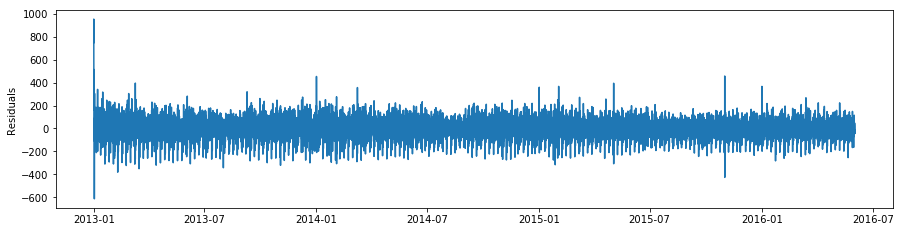

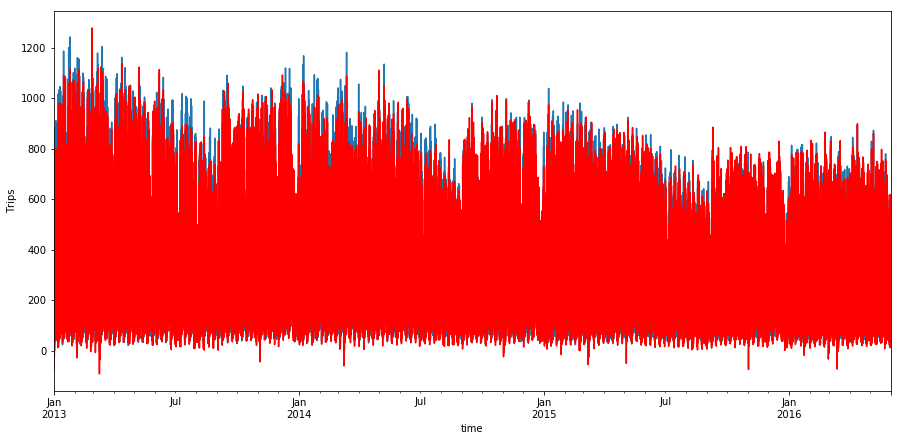

2. Forecast
End.
Start region_1333:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -173492.480
Date:                            Mon, 11 Dec 2017   AIC                         347064.960
Time:                                    20:34:24   BIC                         347397.222
Sample:                                         0   HQIC                        347171.582
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            78.8

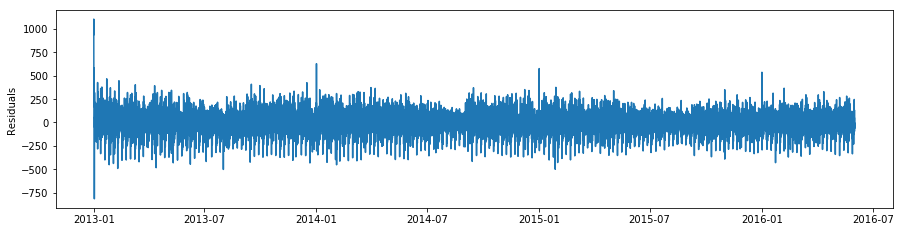

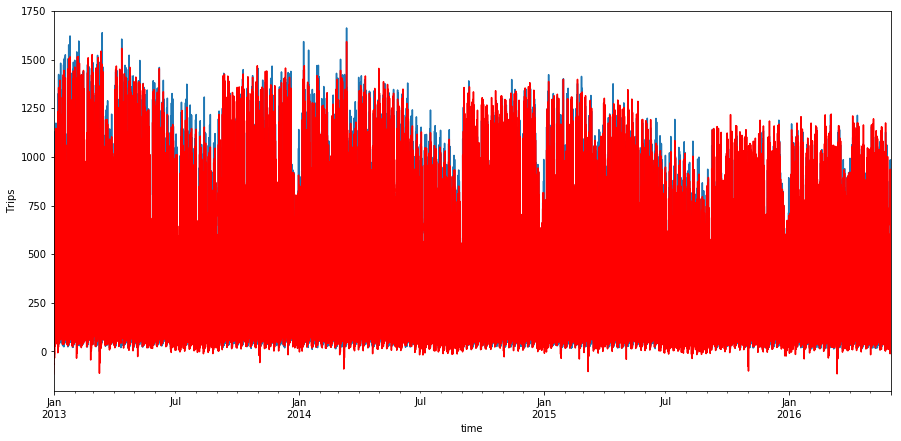

2. Forecast
End.
Start region_1334:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -168064.592
Date:                            Mon, 11 Dec 2017   AIC                         336209.185
Time:                                    22:01:11   BIC                         336541.447
Sample:                                         0   HQIC                        336315.807
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            73.0

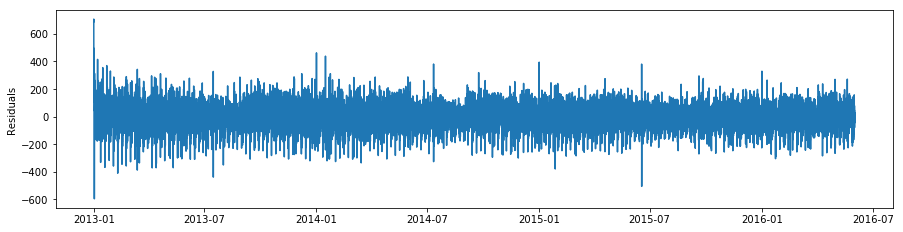

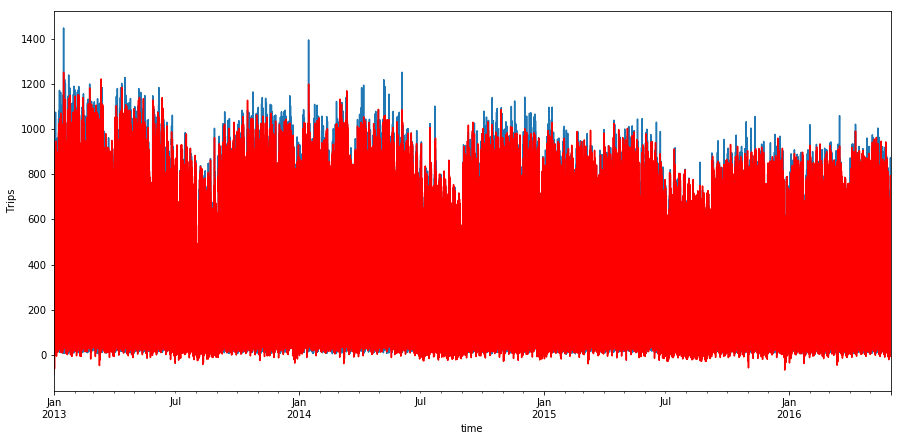

2. Forecast
End.
Start region_1335:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -137829.923
Date:                            Mon, 11 Dec 2017   AIC                         275739.846
Time:                                    23:47:32   BIC                         276072.108
Sample:                                         0   HQIC                        275846.468
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            25.9

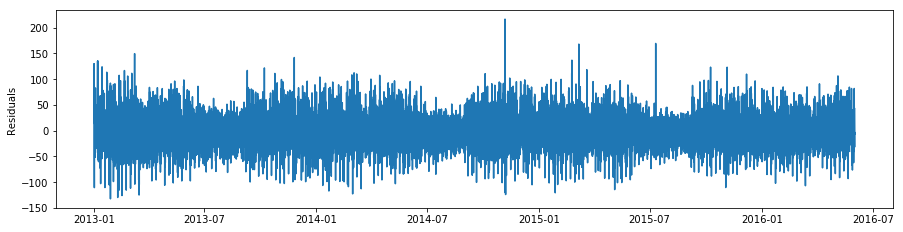

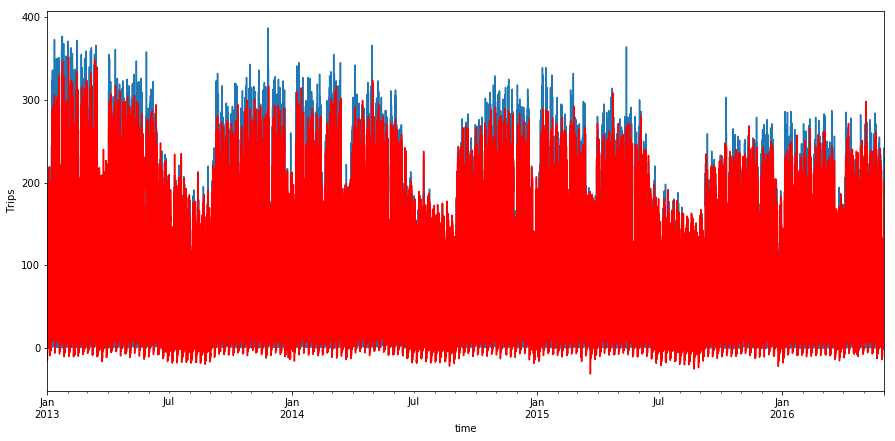

2. Forecast
End.
Start region_1336:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -122420.935
Date:                            Tue, 12 Dec 2017   AIC                         244921.871
Time:                                    01:16:56   BIC                         245254.133
Sample:                                         0   HQIC                        245028.493
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.2

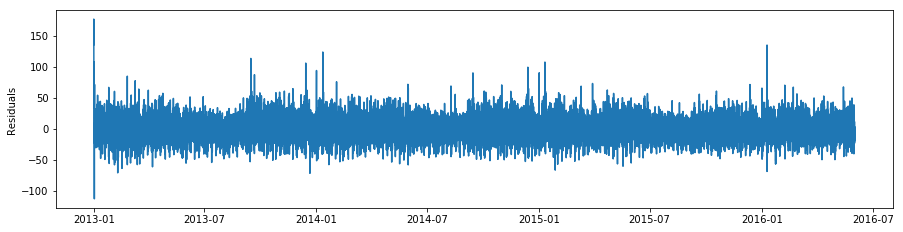

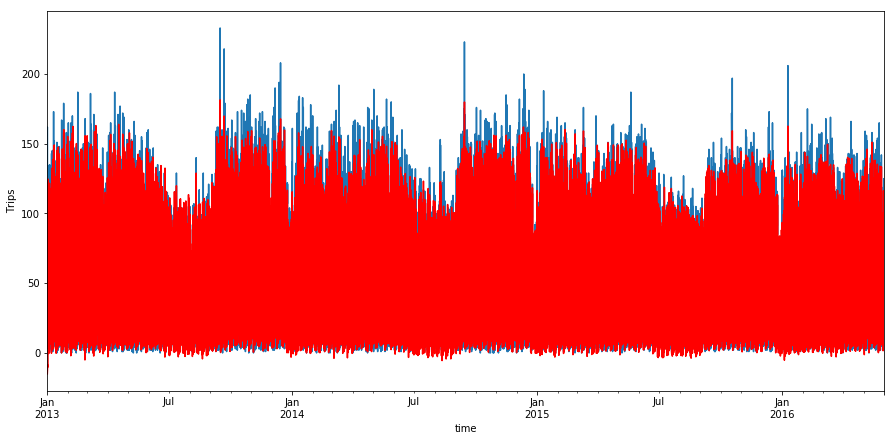

2. Forecast
End.
Start region_1383:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -155752.718
Date:                            Tue, 12 Dec 2017   AIC                         311585.435
Time:                                    02:34:44   BIC                         311917.697
Sample:                                         0   HQIC                        311692.058
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            44.2

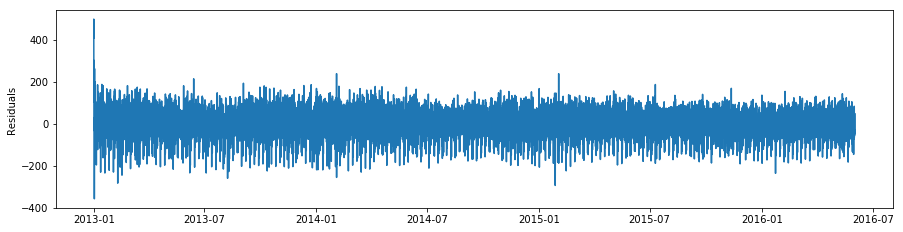

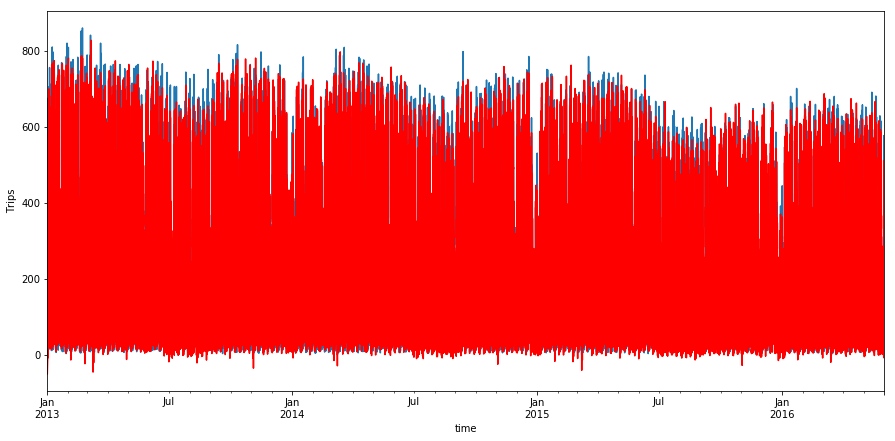

2. Forecast
End.
Start region_1384:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -170339.964
Date:                            Tue, 12 Dec 2017   AIC                         340759.928
Time:                                    03:58:46   BIC                         341092.190
Sample:                                         0   HQIC                        340866.551
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           -19.4

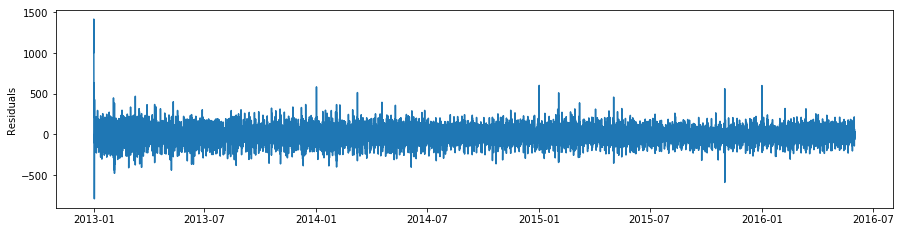

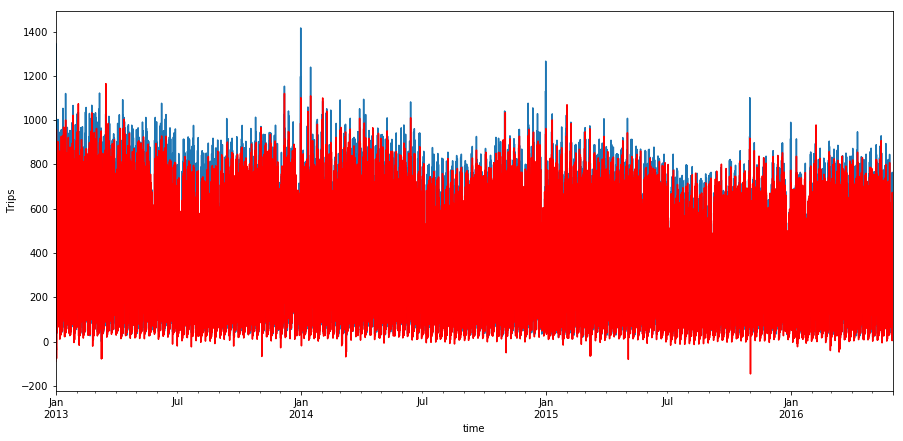

2. Forecast
End.
Start region_1385:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -155218.641
Date:                            Tue, 12 Dec 2017   AIC                         310517.283
Time:                                    05:17:09   BIC                         310849.545
Sample:                                         0   HQIC                        310623.905
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            23.7

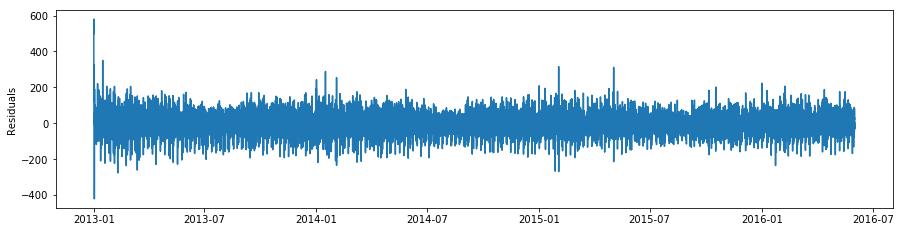

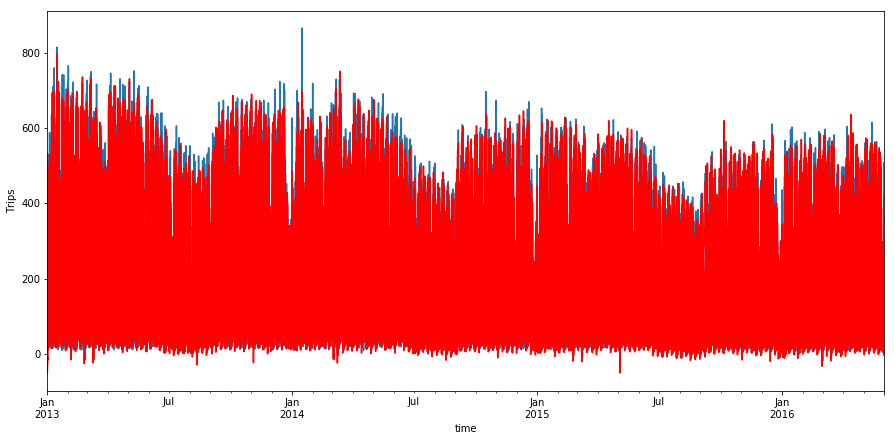

2. Forecast
End.
Start region_1434:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -85155.877
Date:                            Tue, 12 Dec 2017   AIC                         170391.753
Time:                                    07:06:25   BIC                         170724.015
Sample:                                         0   HQIC                        170498.375
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             1.5

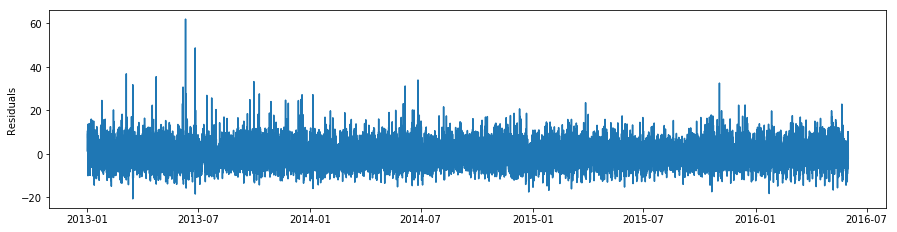

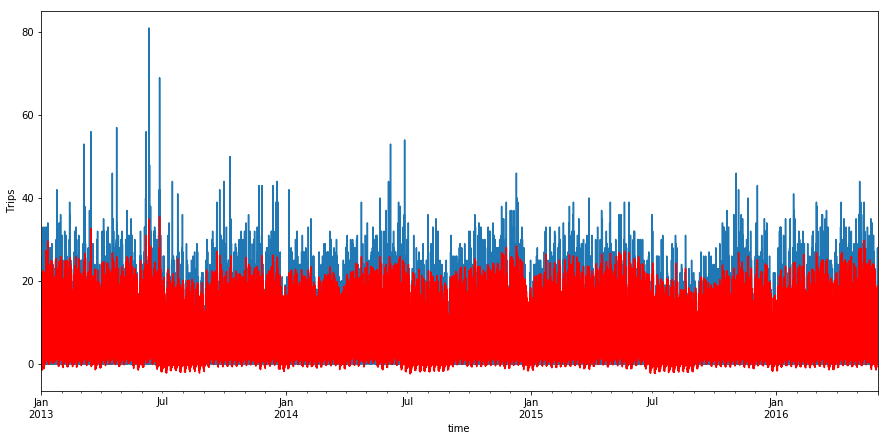

2. Forecast
End.


In [206]:
result_4 = control_forecast(3, 5, 12, params)

Start region_1480:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -91600.724
Date:                            Tue, 12 Dec 2017   AIC                         183273.448
Time:                                    09:27:44   BIC                         183572.484
Sample:                                         0   HQIC                        183369.408
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -2.0283      0.091   

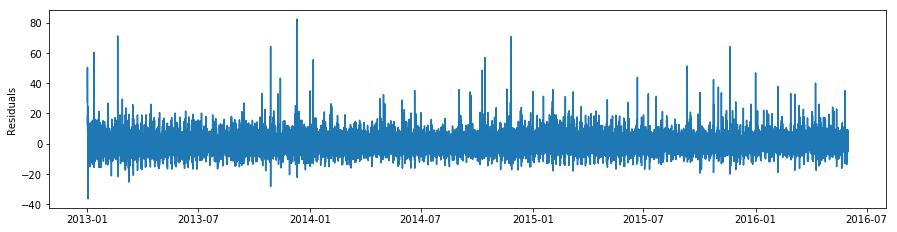

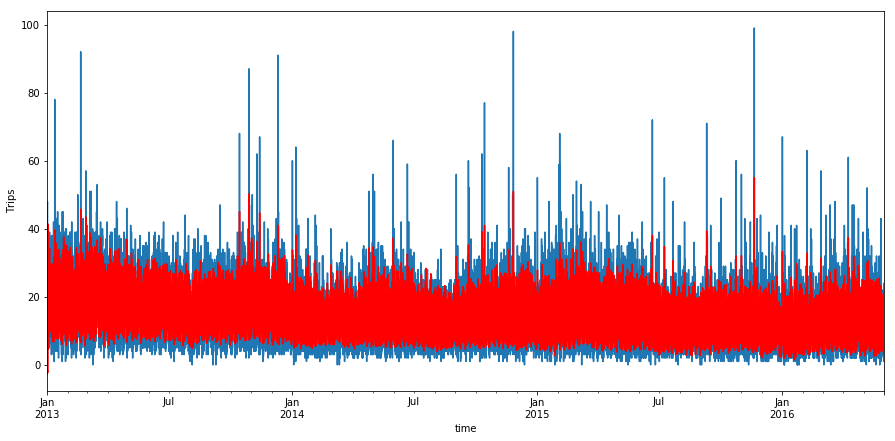

2. Forecast
End.
Start region_1483:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -90695.485
Date:                            Tue, 12 Dec 2017   AIC                         181462.969
Time:                                    11:13:49   BIC                         181762.005
Sample:                                         0   HQIC                        181558.929
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -1.8

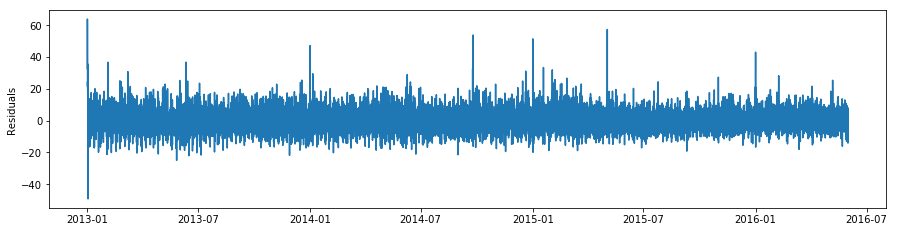

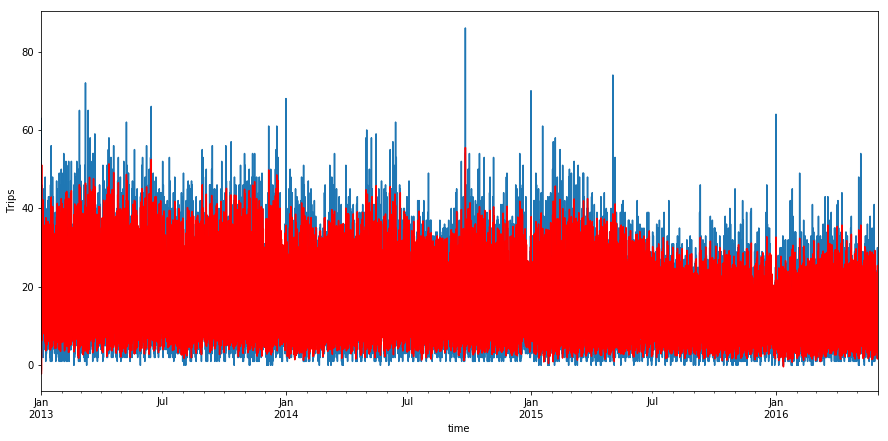

2. Forecast
End.
Start region_1530:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -97399.389
Date:                            Tue, 12 Dec 2017   AIC                         194870.777
Time:                                    13:03:47   BIC                         195169.813
Sample:                                         0   HQIC                        194966.737
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -2.4

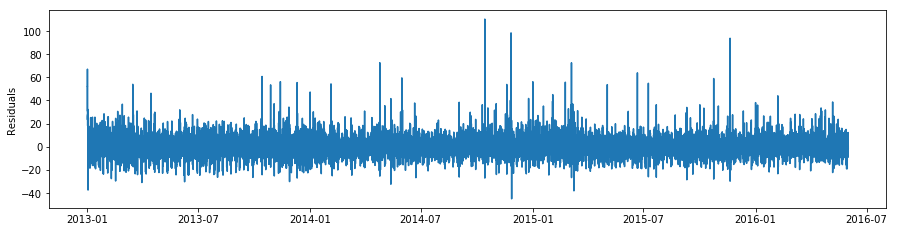

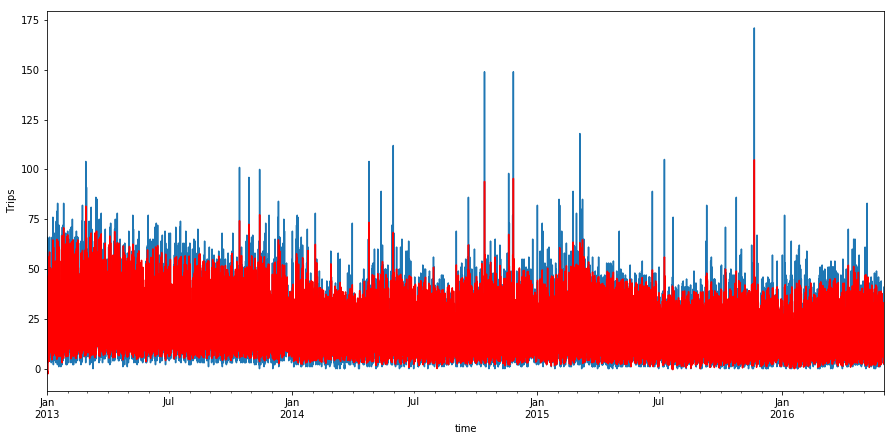

2. Forecast
End.
Start region_1580:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -77211.764
Date:                            Tue, 12 Dec 2017   AIC                         154495.528
Time:                                    14:34:24   BIC                         154794.564
Sample:                                         0   HQIC                        154591.488
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -1.0

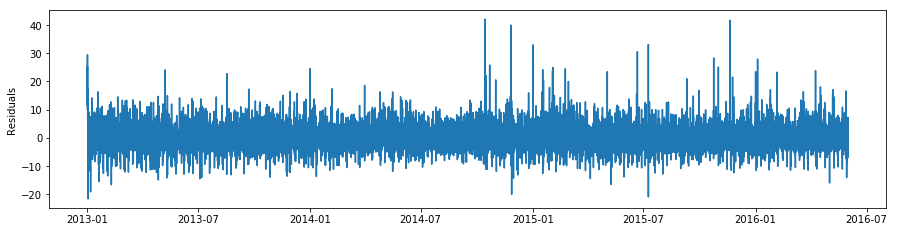

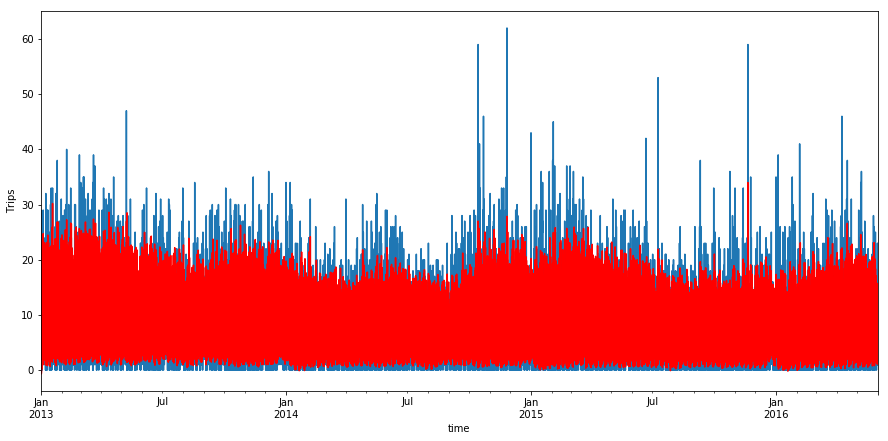

2. Forecast
End.


In [207]:
result_5 = control_forecast(4, 6, 9, params)

Start region_1075:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -122018.103
Date:                            Tue, 12 Dec 2017   AIC                         244124.207
Time:                                    16:31:00   BIC                         244489.695
Sample:                                         0   HQIC                        244241.491
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             4.6553      0.348   

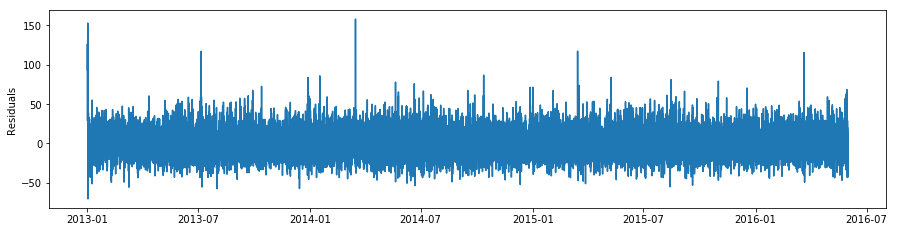

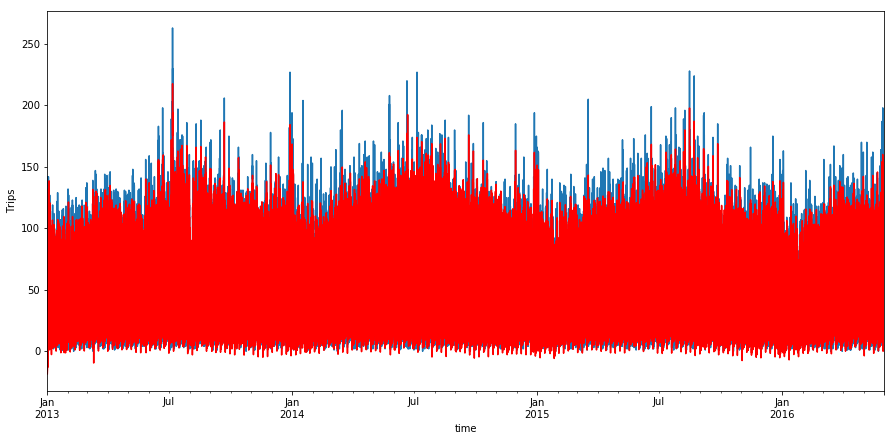

2. Forecast
End.
Start region_1125:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -125474.884
Date:                            Tue, 12 Dec 2017   AIC                         251037.769
Time:                                    18:33:32   BIC                         251403.257
Sample:                                         0   HQIC                        251155.053
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            11.6

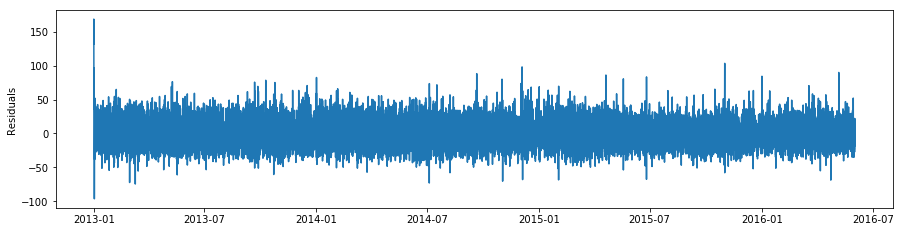

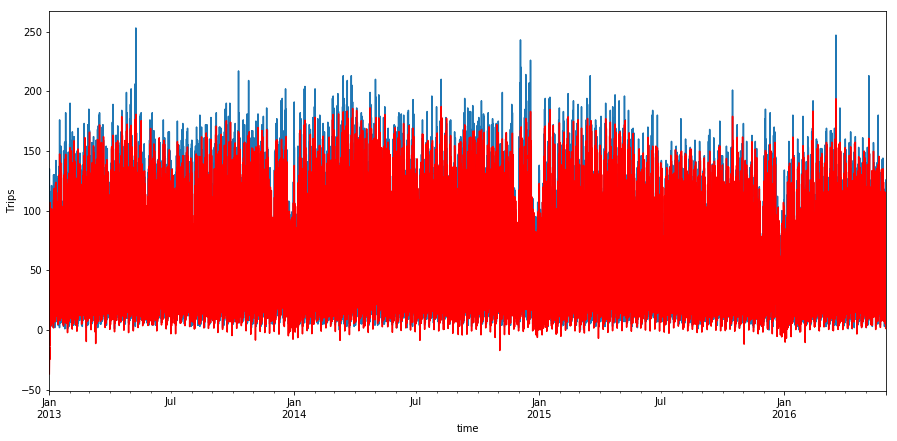

2. Forecast
End.
Start region_1126:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -145389.741
Date:                            Tue, 12 Dec 2017   AIC                         290867.481
Time:                                    20:04:33   BIC                         291232.970
Sample:                                         0   HQIC                        290984.766
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             6.9

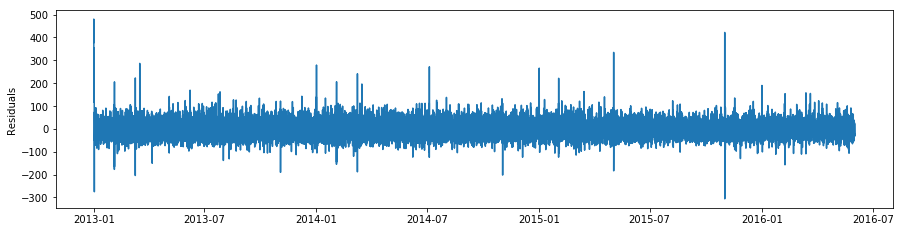

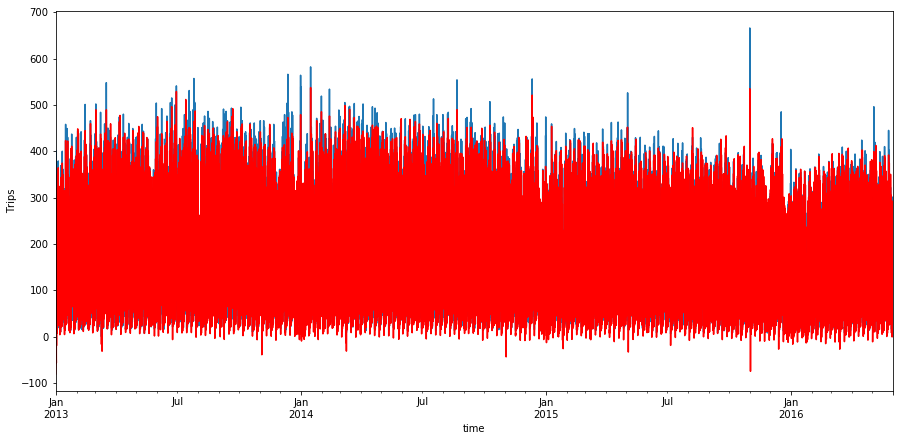

2. Forecast
End.
Start region_1180:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -173203.367
Date:                            Tue, 12 Dec 2017   AIC                         346494.733
Time:                                    21:28:01   BIC                         346860.221
Sample:                                         0   HQIC                        346612.018
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            13.3

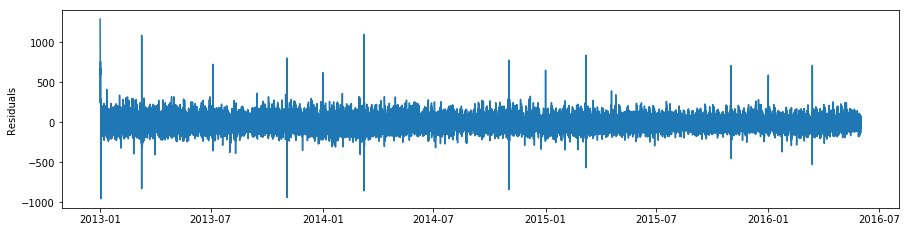

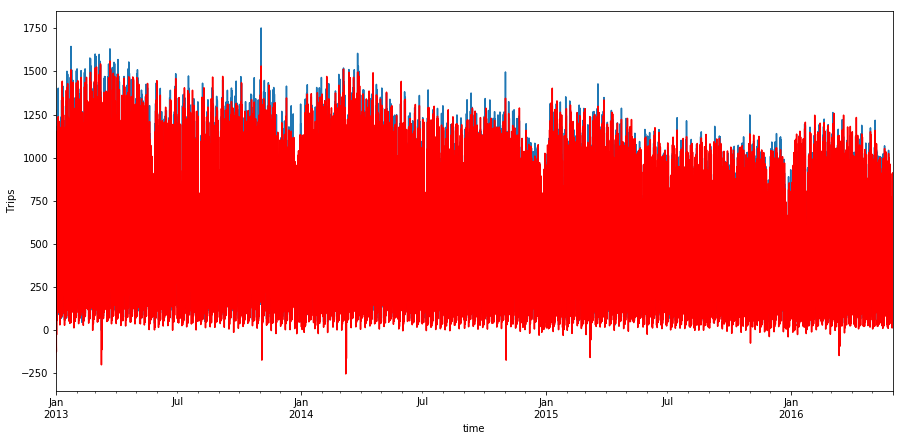

2. Forecast
End.
Start region_1231:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -178183.828
Date:                            Tue, 12 Dec 2017   AIC                         356455.656
Time:                                    23:23:53   BIC                         356821.144
Sample:                                         0   HQIC                        356572.940
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            88.3

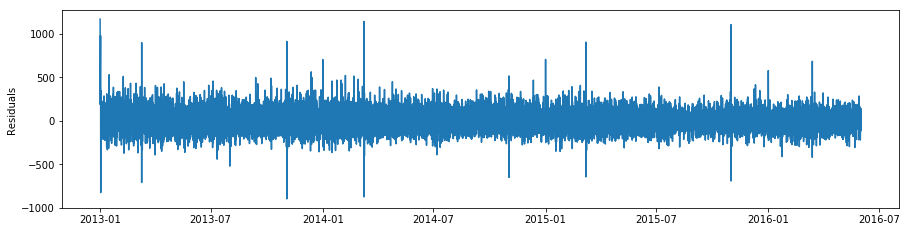

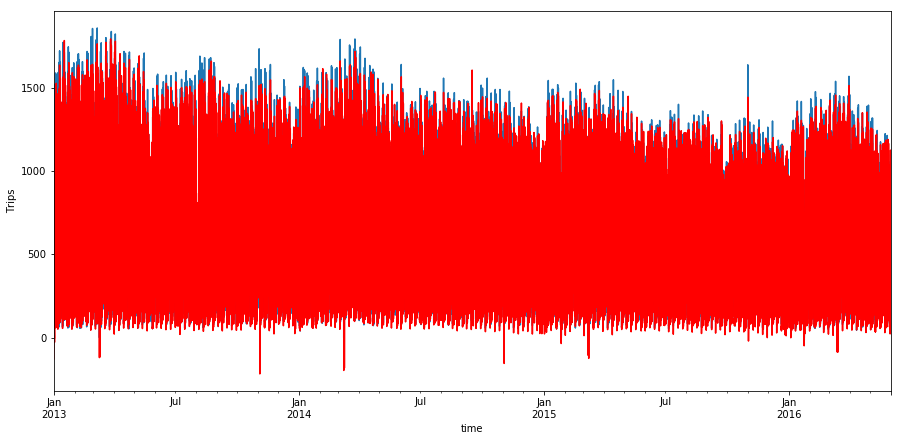

2. Forecast
End.
Start region_1232:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -183691.302
Date:                            Wed, 13 Dec 2017   AIC                         367470.604
Time:                                    01:26:38   BIC                         367836.092
Sample:                                         0   HQIC                        367587.888
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            63.8

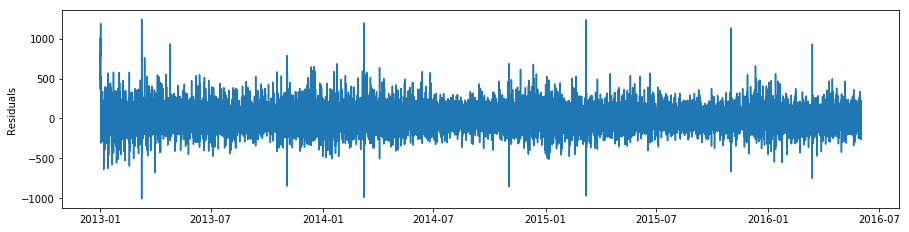

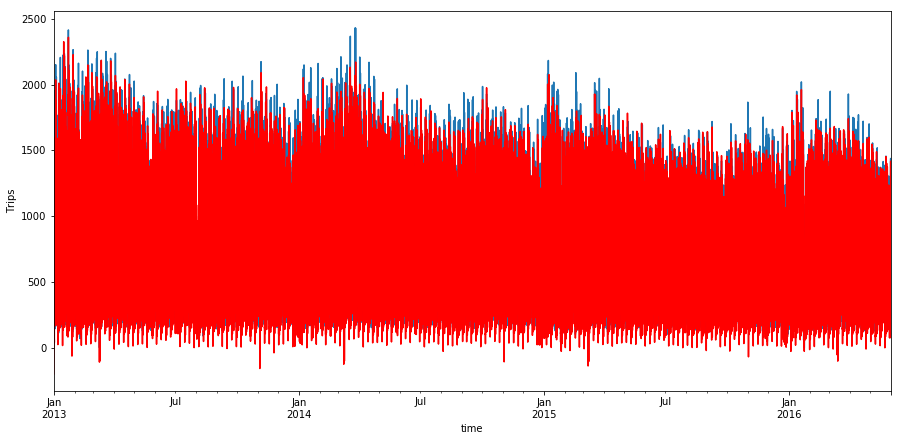

2. Forecast
End.
Start region_1233:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -175392.362
Date:                            Wed, 13 Dec 2017   AIC                         350872.723
Time:                                    03:08:46   BIC                         351238.212
Sample:                                         0   HQIC                        350990.008
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            55.4

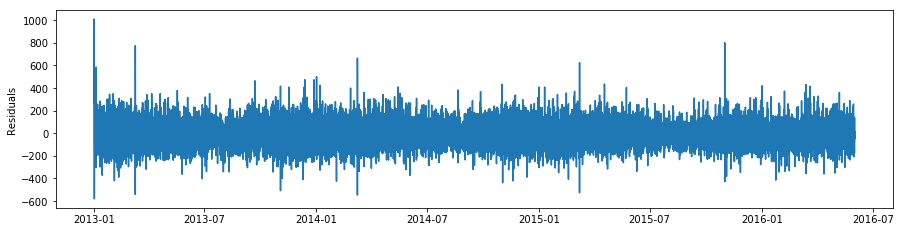

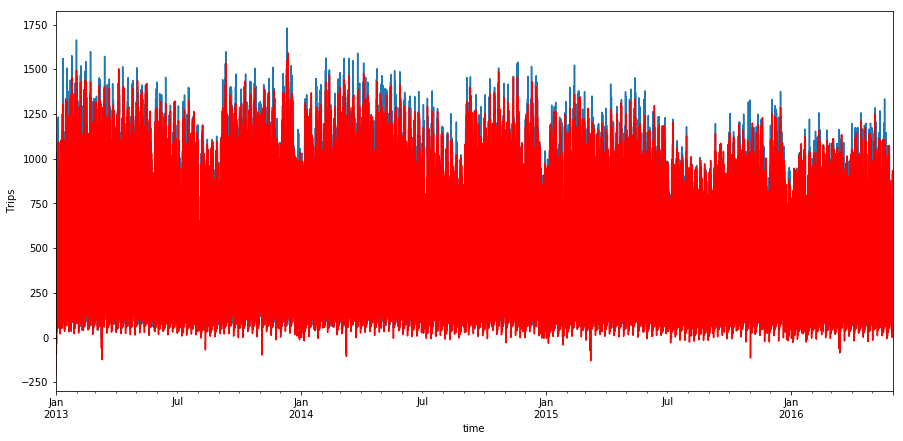

2. Forecast
End.
Start region_1281:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -179597.086
Date:                            Wed, 13 Dec 2017   AIC                         359282.173
Time:                                    04:42:12   BIC                         359647.661
Sample:                                         0   HQIC                        359399.457
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           122.9

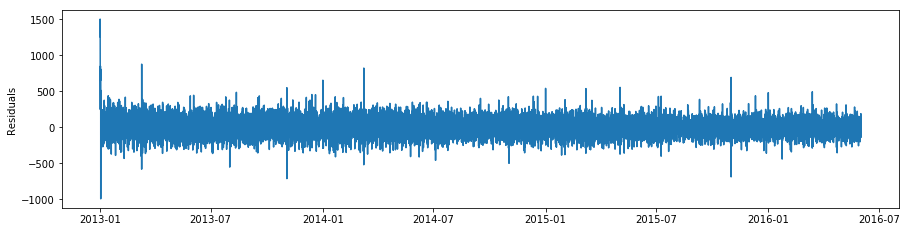

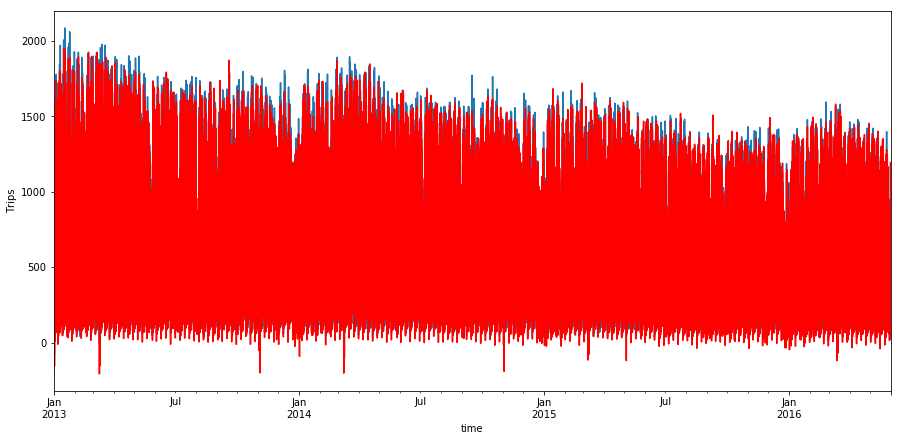

2. Forecast
End.
Start region_1282:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -187074.272
Date:                            Wed, 13 Dec 2017   AIC                         374236.543
Time:                                    06:15:09   BIC                         374602.031
Sample:                                         0   HQIC                        374353.828
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           202.0

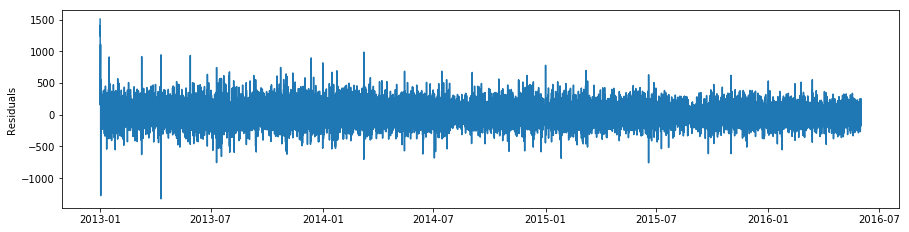

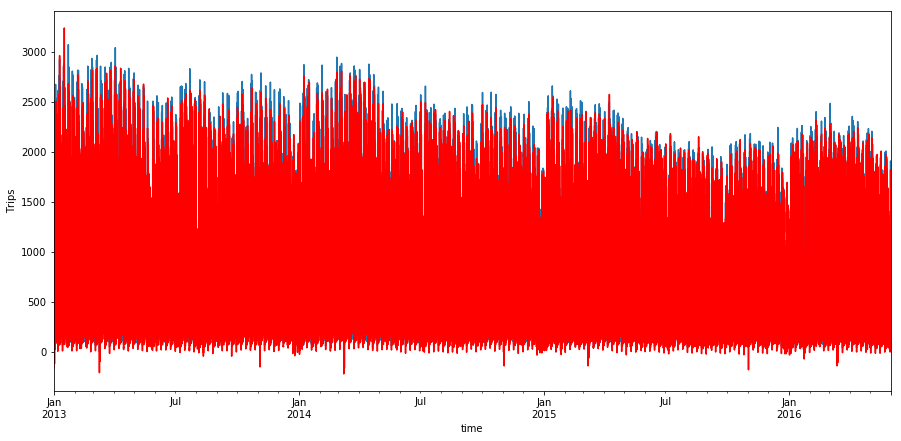

2. Forecast
End.
Start region_1283:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -151632.540
Date:                            Wed, 13 Dec 2017   AIC                         303353.081
Time:                                    08:14:35   BIC                         303718.569
Sample:                                         0   HQIC                        303470.365
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            40.4

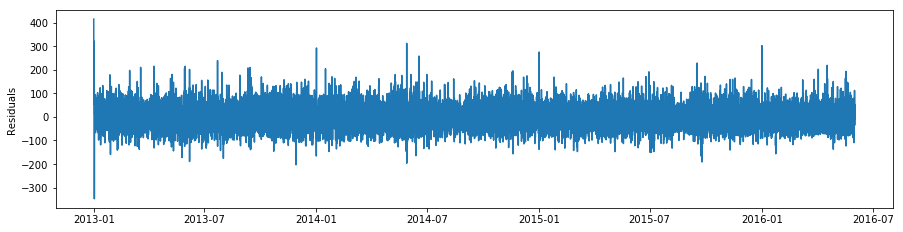

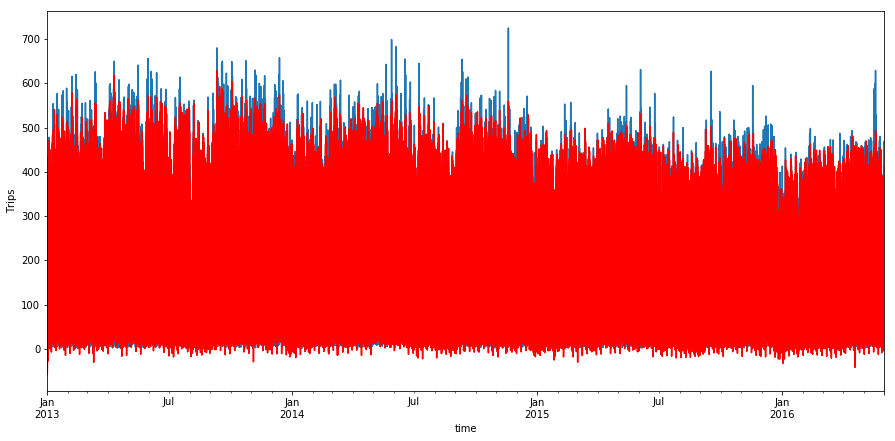

2. Forecast
End.
Start region_1382:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -100364.210
Date:                            Wed, 13 Dec 2017   AIC                         200816.420
Time:                                    10:23:01   BIC                         201181.908
Sample:                                         0   HQIC                        200933.705
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             7.0

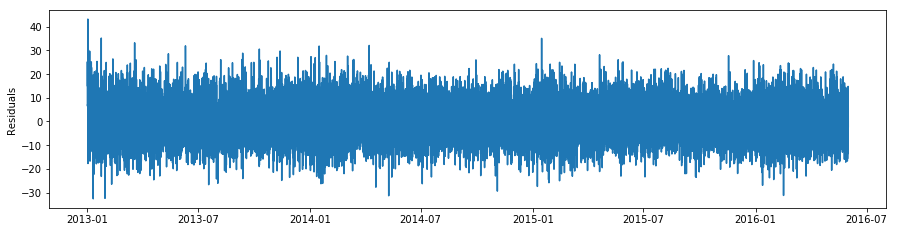

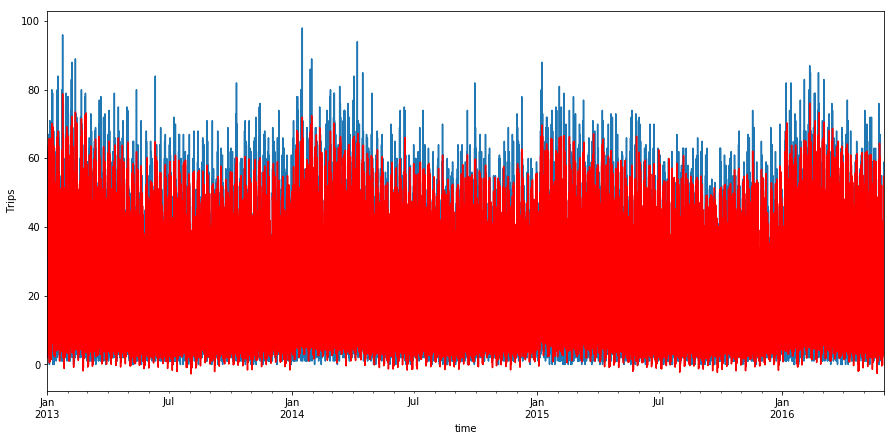

2. Forecast
End.


In [208]:
result_6 = control_forecast(5, 6, 13, params)

Start region_1172:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -84859.786
Date:                            Wed, 13 Dec 2017   AIC                         169815.572
Time:                                    12:49:25   BIC                         170214.286
Sample:                                         0   HQIC                        169943.519
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -1.3919      0.091   

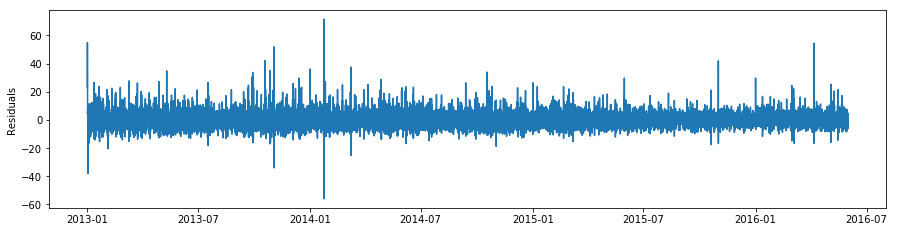

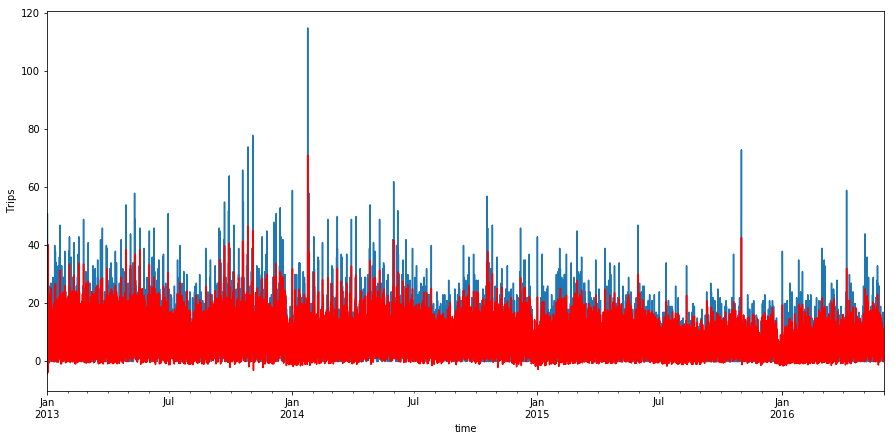

2. Forecast
End.
Start region_1173:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -112290.732
Date:                            Wed, 13 Dec 2017   AIC                         224677.465
Time:                                    16:04:53   BIC                         225076.179
Sample:                                         0   HQIC                        224805.412
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -4.3

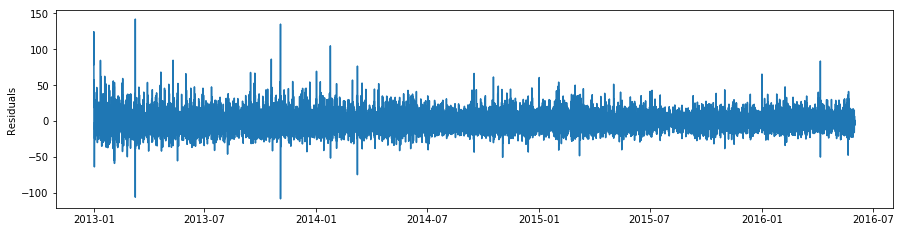

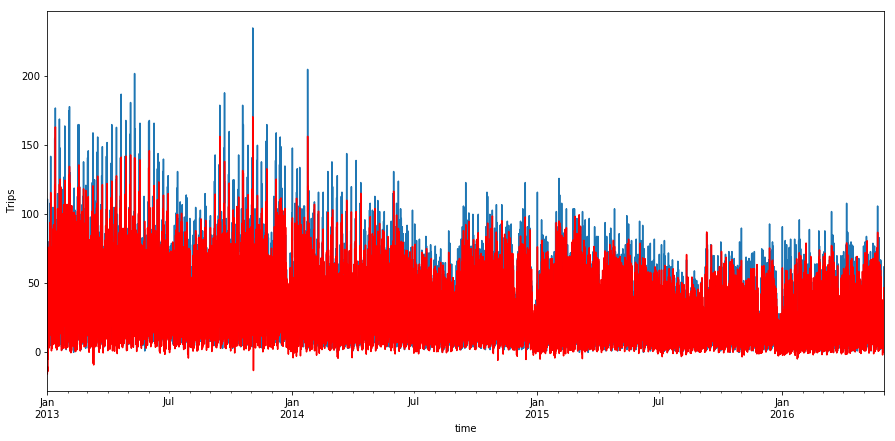

2. Forecast
End.
Start region_1174:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -113093.192
Date:                            Wed, 13 Dec 2017   AIC                         226282.383
Time:                                    18:10:02   BIC                         226681.098
Sample:                                         0   HQIC                        226410.330
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -1.2

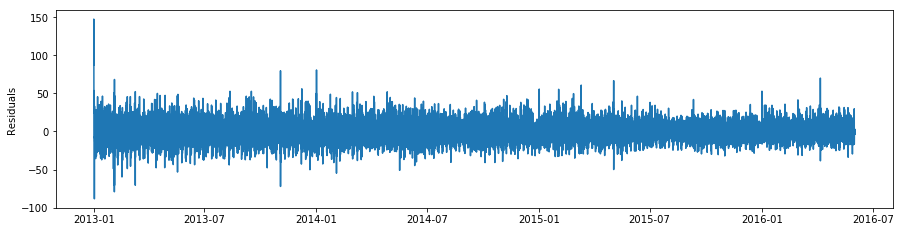

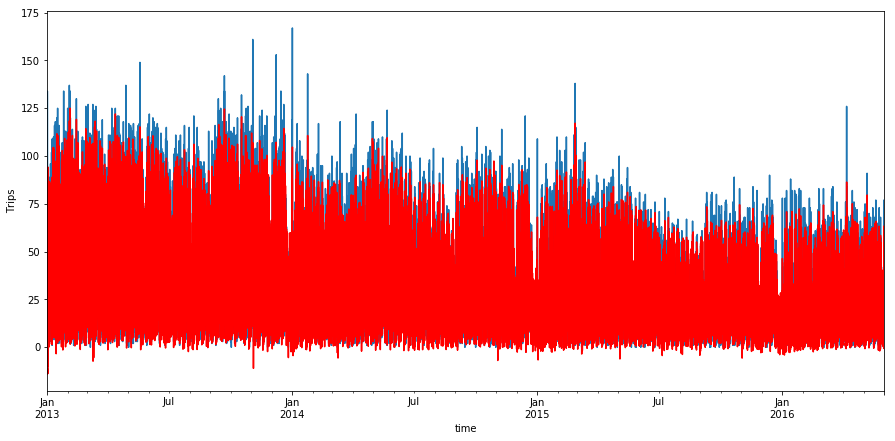

2. Forecast
End.
Start region_1225:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -84032.218
Date:                            Wed, 13 Dec 2017   AIC                         168160.436
Time:                                    20:21:32   BIC                         168559.150
Sample:                                         0   HQIC                        168288.383
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.2

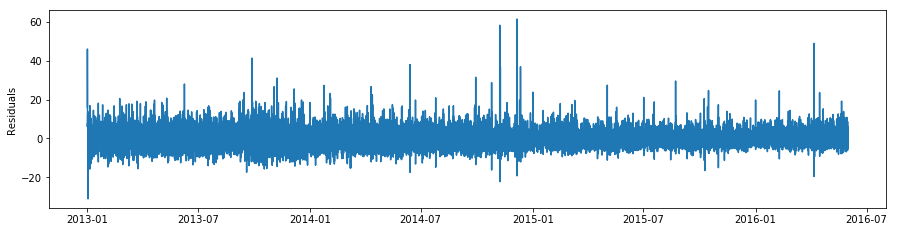

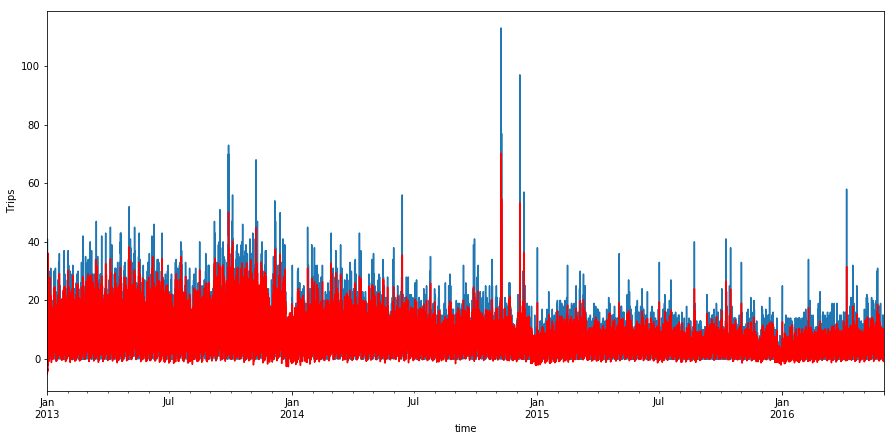

2. Forecast
End.


In [209]:
result_7 = control_forecast(6, 6, 15, params)

Start region_1326:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -122477.991
Date:                            Wed, 13 Dec 2017   AIC                         245011.983
Time:                                    22:01:19   BIC                         245244.566
Sample:                                         0   HQIC                        245086.619
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           -15.2495      0.892   

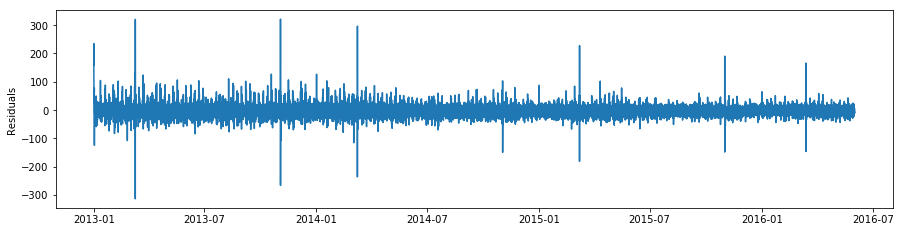

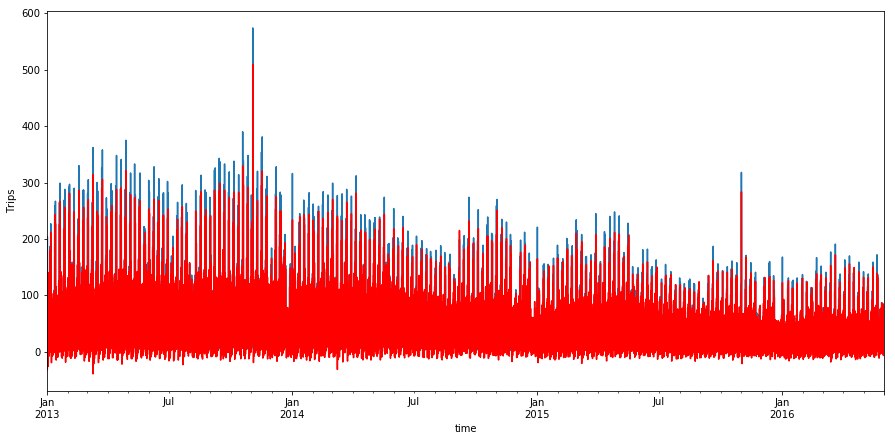

2. Forecast
End.
Start region_1327:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -132465.098
Date:                            Wed, 13 Dec 2017   AIC                         264986.196
Time:                                    23:52:52   BIC                         265218.779
Sample:                                         0   HQIC                        265060.832
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           -21.4

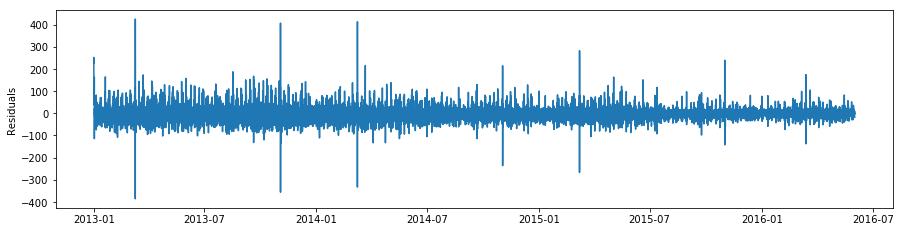

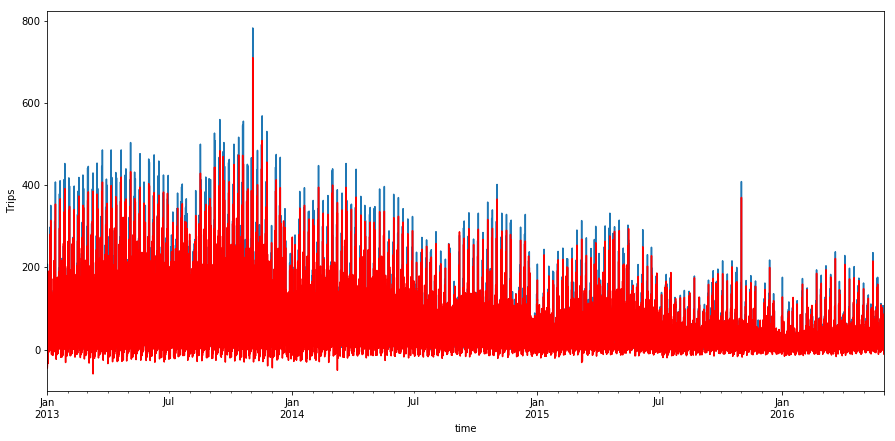

2. Forecast
End.
Start region_1376:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -112737.422
Date:                            Thu, 14 Dec 2017   AIC                         225530.844
Time:                                    01:25:39   BIC                         225763.427
Sample:                                         0   HQIC                        225605.480
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1           -10.2

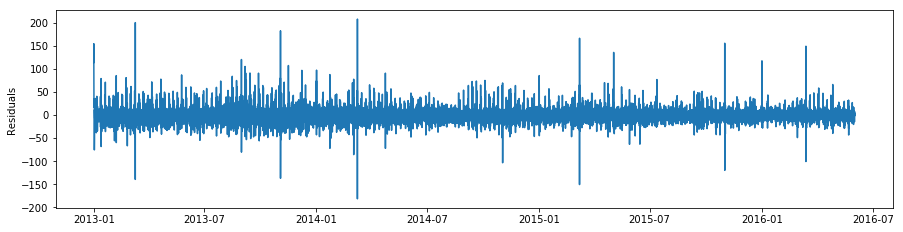

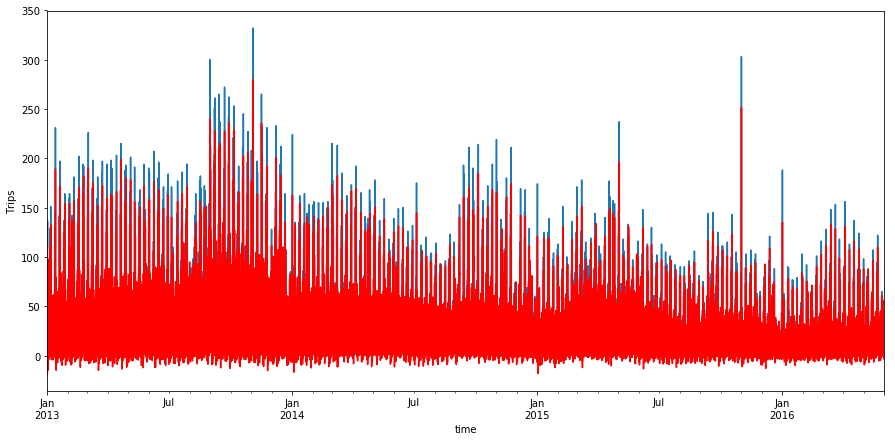

2. Forecast
End.
Start region_1377:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -107212.582
Date:                            Thu, 14 Dec 2017   AIC                         214481.165
Time:                                    03:12:32   BIC                         214713.748
Sample:                                         0   HQIC                        214555.800
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -7.6

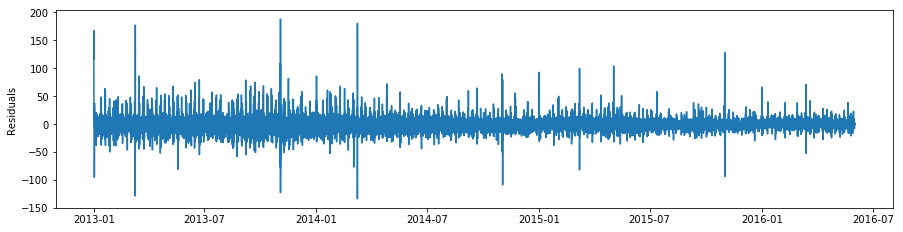

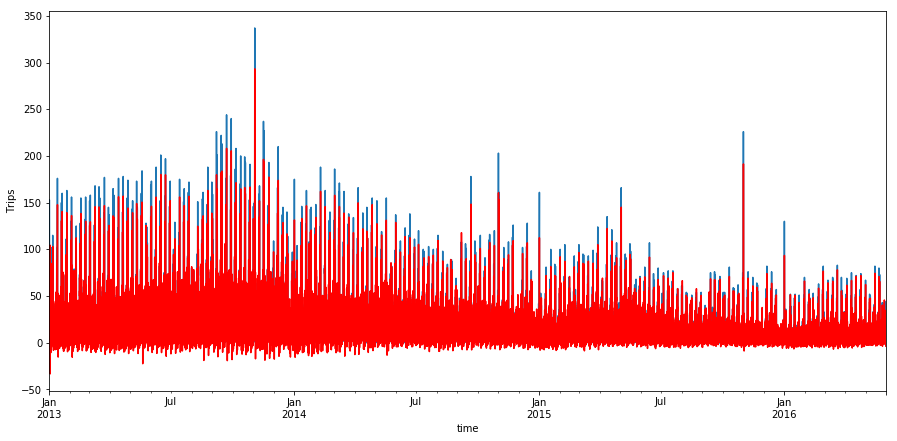

2. Forecast
End.
Start region_1378:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -98202.680
Date:                            Thu, 14 Dec 2017   AIC                         196461.361
Time:                                    04:38:47   BIC                         196693.944
Sample:                                         0   HQIC                        196535.996
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -5.2

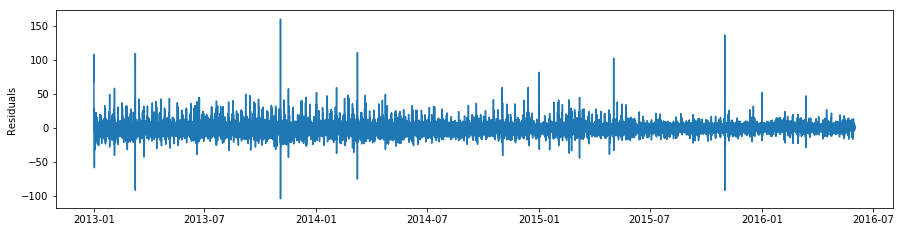

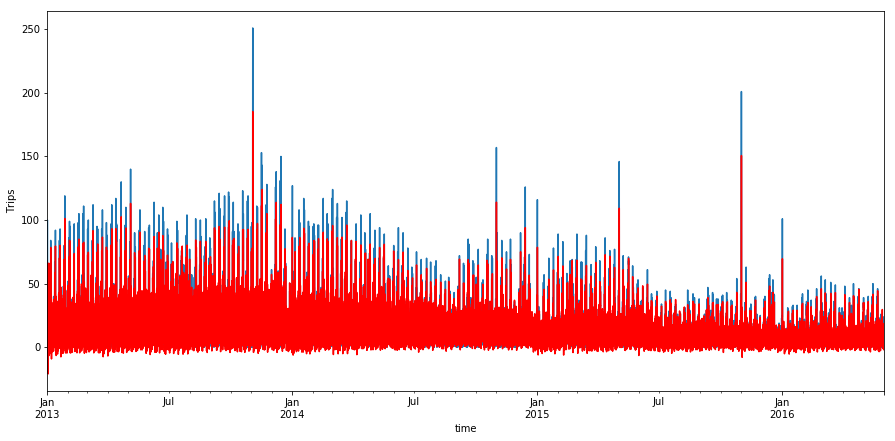

2. Forecast
End.
Start region_1426:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -91378.986
Date:                            Thu, 14 Dec 2017   AIC                         182813.973
Time:                                    06:16:33   BIC                         183046.556
Sample:                                         0   HQIC                        182888.608
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -4.0

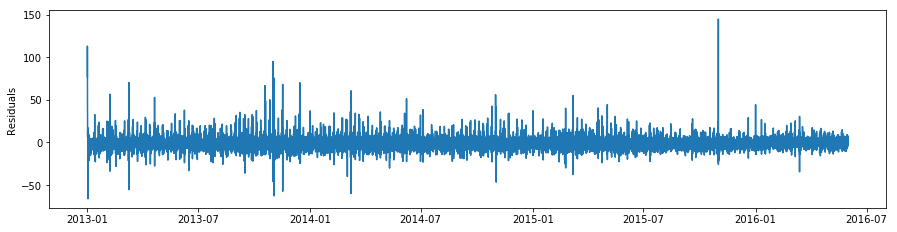

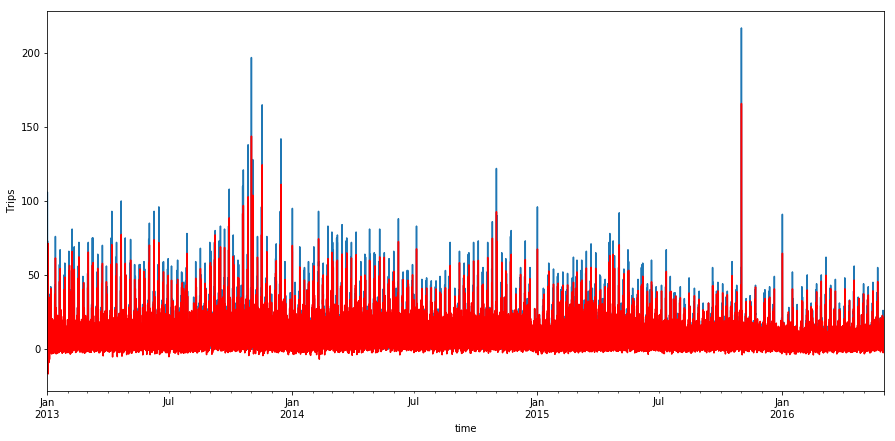

2. Forecast
End.


In [210]:
result_8 = control_forecast(7, 6, 5, params)

Start region_2168:
1. Train
geting params
1 1 0 1 0 1
not product
(1, 1, 0, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 24)   Log Likelihood             -131340.545
Date:                            Thu, 14 Dec 2017   AIC                         262747.090
Time:                                    07:55:29   BIC                         263021.206
Sample:                                         0   HQIC                        262835.053
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -1.3134      0.248   

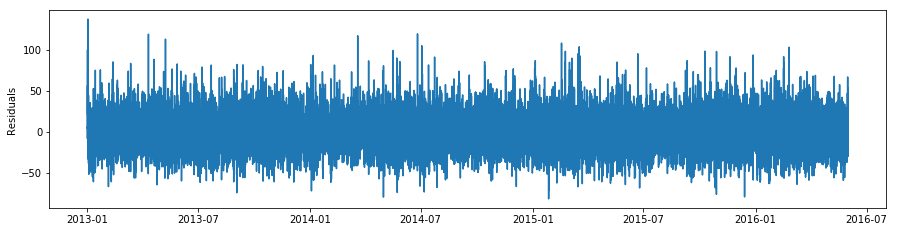

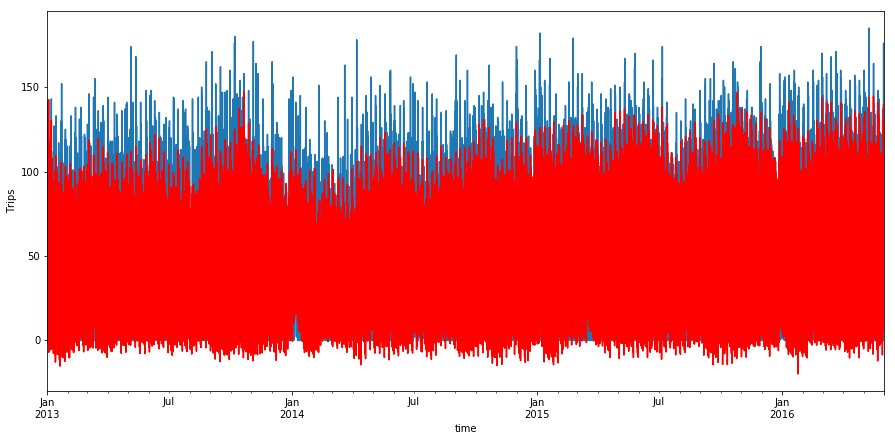

2. Forecast
End.


In [211]:
result_9 = control_forecast(8, 4, 10, params)

Start region_1221:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -87792.802
Date:                            Thu, 14 Dec 2017   AIC                         175637.605
Time:                                    12:31:38   BIC                         175853.575
Sample:                                         0   HQIC                        175706.909
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -2.5114      0.147   

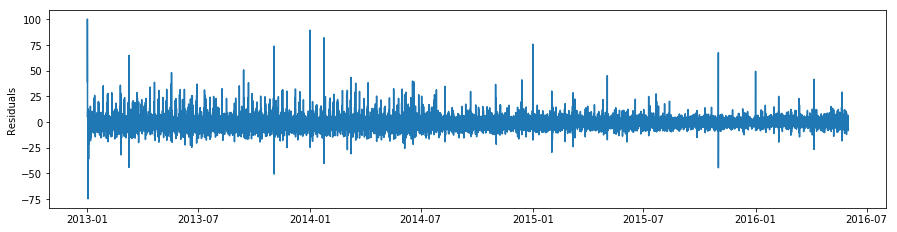

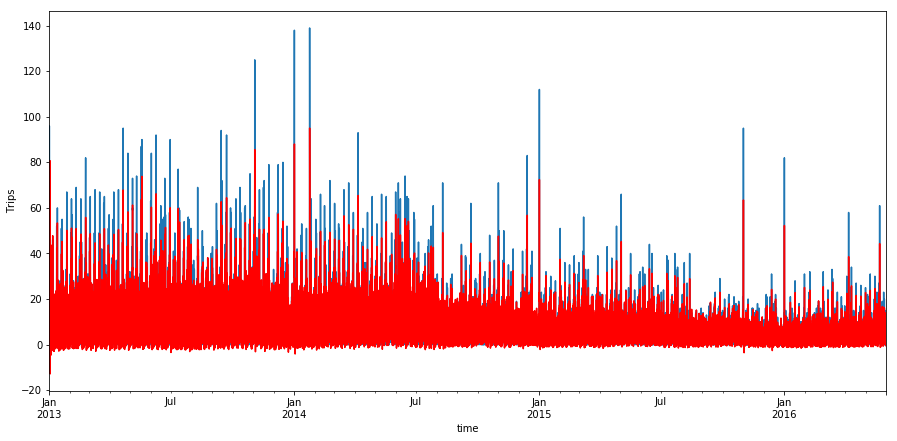

2. Forecast
End.
Start region_1222:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -99088.044
Date:                            Thu, 14 Dec 2017   AIC                         198228.088
Time:                                    14:00:50   BIC                         198444.058
Sample:                                         0   HQIC                        198297.392
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -4.3

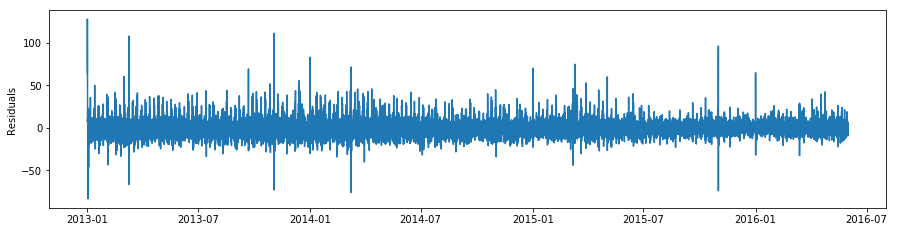

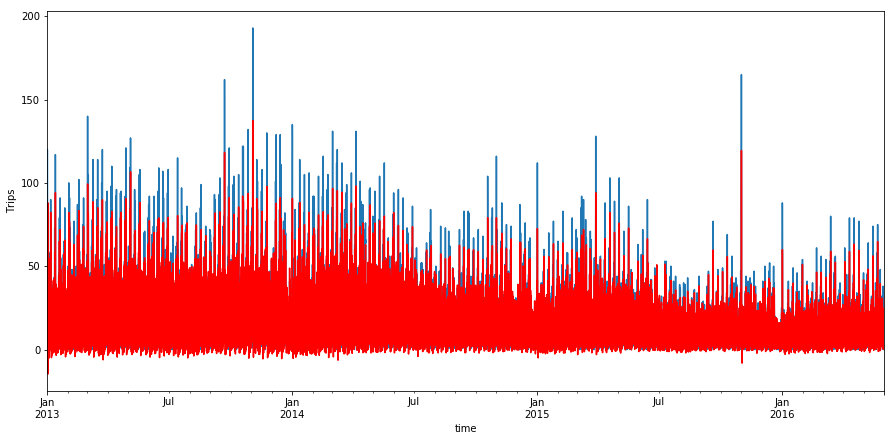

2. Forecast
End.
Start region_1223:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -104481.486
Date:                            Thu, 14 Dec 2017   AIC                         209014.971
Time:                                    15:43:29   BIC                         209230.942
Sample:                                         0   HQIC                        209084.276
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -4.4

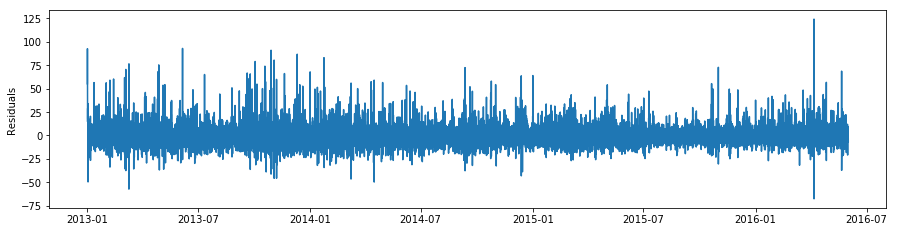

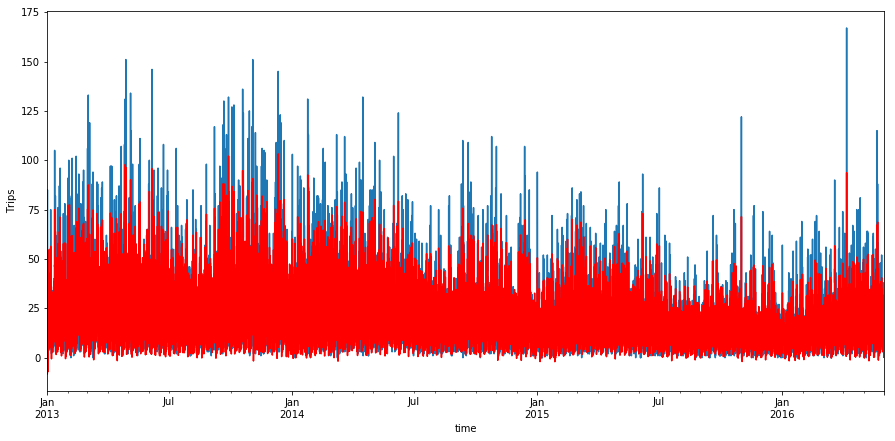

2. Forecast
End.
Start region_1272:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -92895.320
Date:                            Thu, 14 Dec 2017   AIC                         185842.640
Time:                                    17:13:03   BIC                         186058.611
Sample:                                         0   HQIC                        185911.945
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -3.3

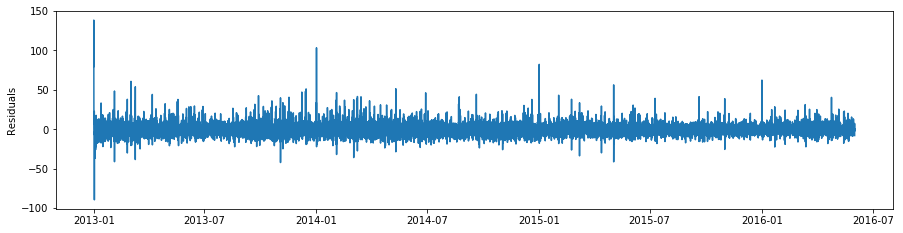

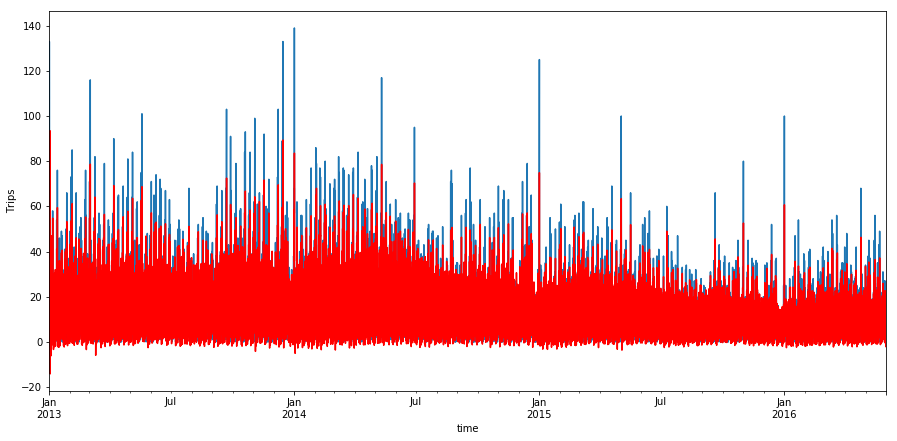

2. Forecast
End.
Start region_1273:
1. Train
geting params
1 1 0 1 0 1
not product
(1, 1, 0, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 24)   Log Likelihood             -117645.059
Date:                            Thu, 14 Dec 2017   AIC                         235340.119
Time:                                    18:16:01   BIC                         235547.783
Sample:                                         0   HQIC                        235406.758
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -4.2

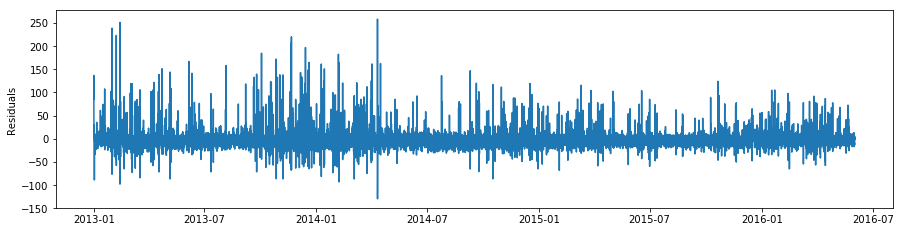

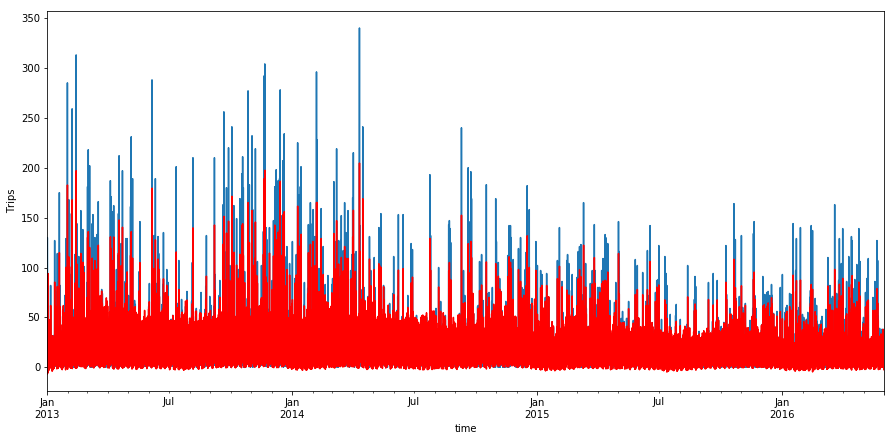

2. Forecast
End.
Start region_1274:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -86120.968
Date:                            Thu, 14 Dec 2017   AIC                         172293.936
Time:                                    20:08:13   BIC                         172509.907
Sample:                                         0   HQIC                        172363.241
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -2.5

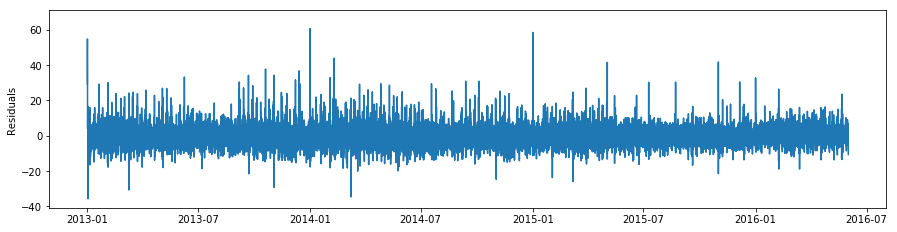

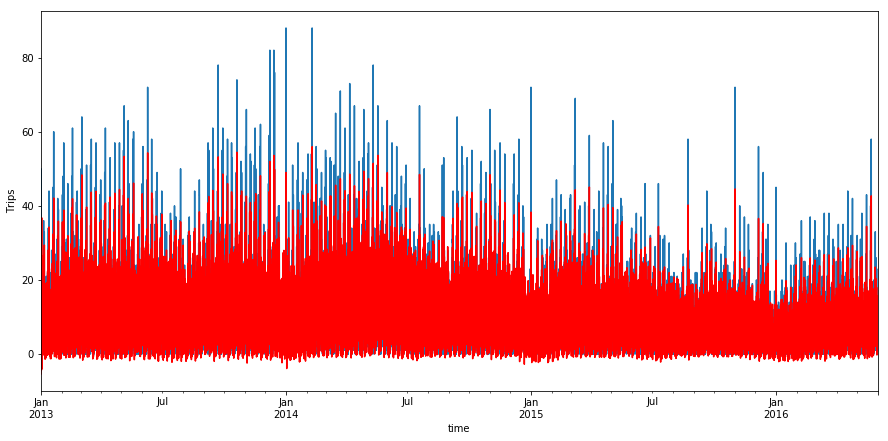

2. Forecast
End.
Start region_1380:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -91315.230
Date:                            Thu, 14 Dec 2017   AIC                         182682.461
Time:                                    21:48:47   BIC                         182898.431
Sample:                                         0   HQIC                        182751.765
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -2.7

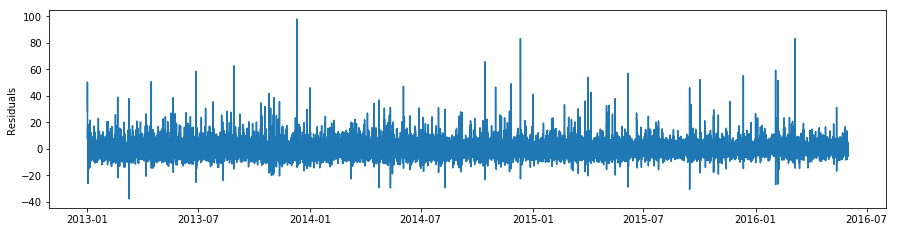

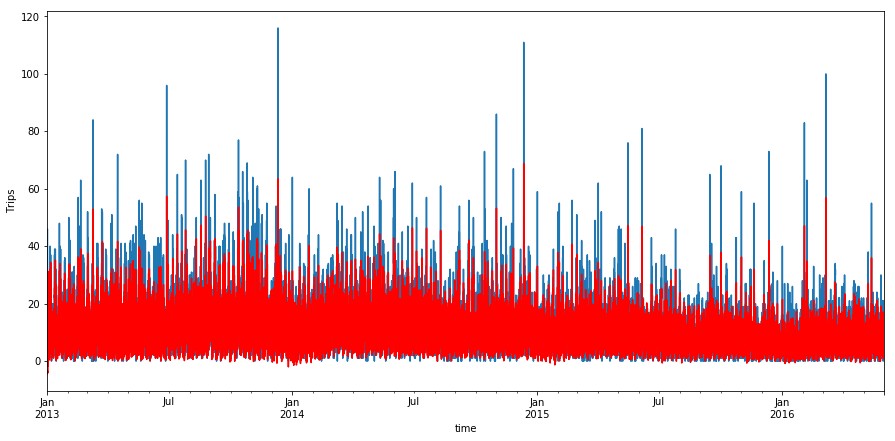

2. Forecast
End.


In [212]:
result_10 = control_forecast(9, 6, 4, params)

Start region_1389:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -92915.216
Date:                            Thu, 14 Dec 2017   AIC                         185886.432
Time:                                    23:30:58   BIC                         186119.016
Sample:                                         0   HQIC                        185961.068
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -2.3912      0.116   

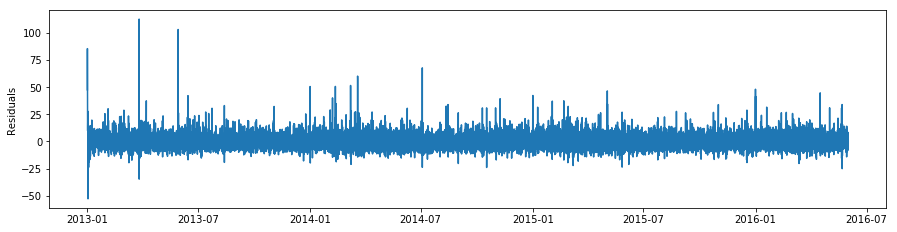

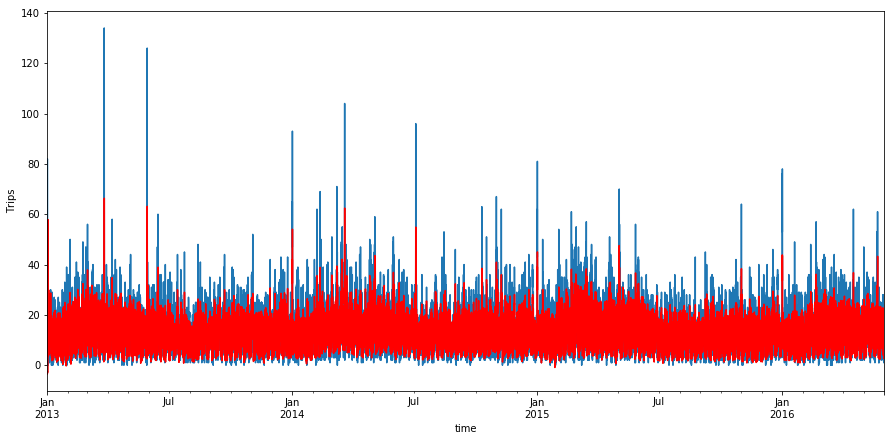

2. Forecast
End.
Start region_1390:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -94307.605
Date:                            Fri, 15 Dec 2017   AIC                         188671.209
Time:                                    01:00:39   BIC                         188903.792
Sample:                                         0   HQIC                        188745.845
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -2.7

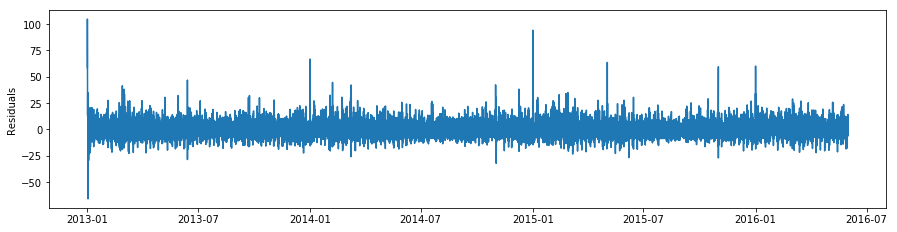

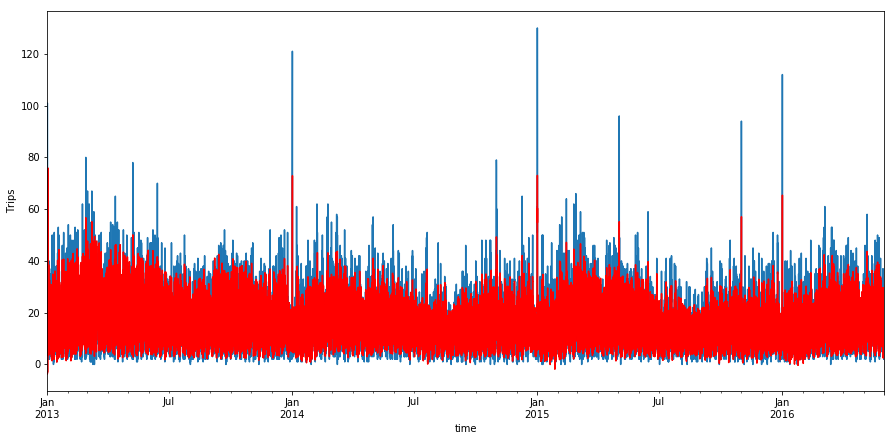

2. Forecast
End.
Start region_1439:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -79491.388
Date:                            Fri, 15 Dec 2017   AIC                         159038.775
Time:                                    02:53:29   BIC                         159271.359
Sample:                                         0   HQIC                        159113.411
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -1.2

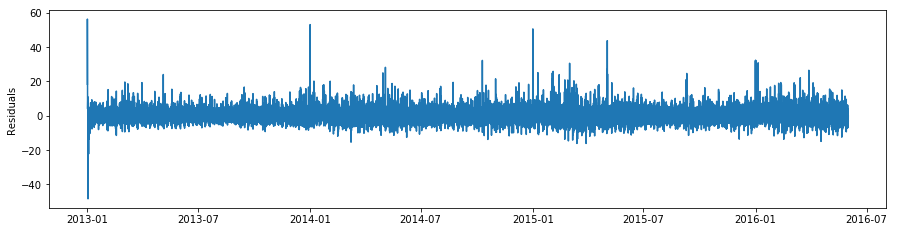

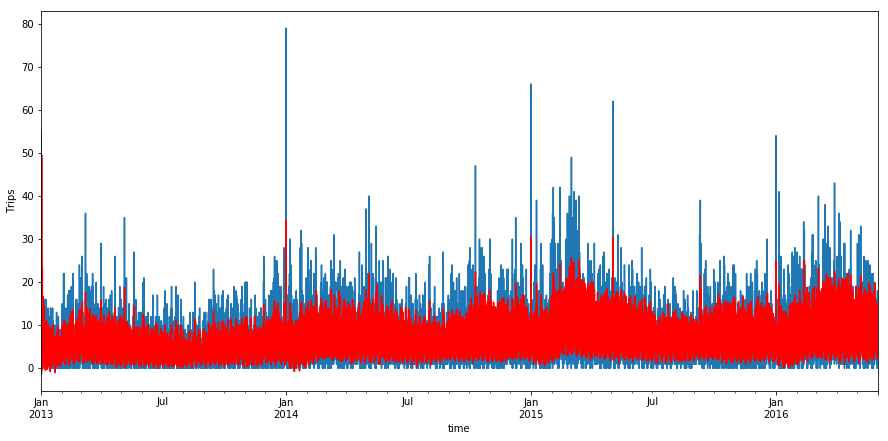

2. Forecast
End.


In [213]:
result_11 = control_forecast(10, 4, 7, params)

Start region_2068:
1. Train
geting params
1 1 0 1 0 1
not product
(1, 1, 0, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 24)   Log Likelihood             -133097.340
Date:                            Fri, 15 Dec 2017   AIC                         266248.680
Time:                                    04:07:17   BIC                         266472.956
Sample:                                         0   HQIC                        266320.650
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -3.3243      0.363   

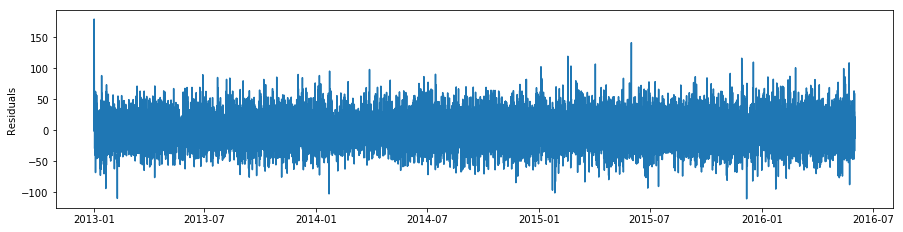

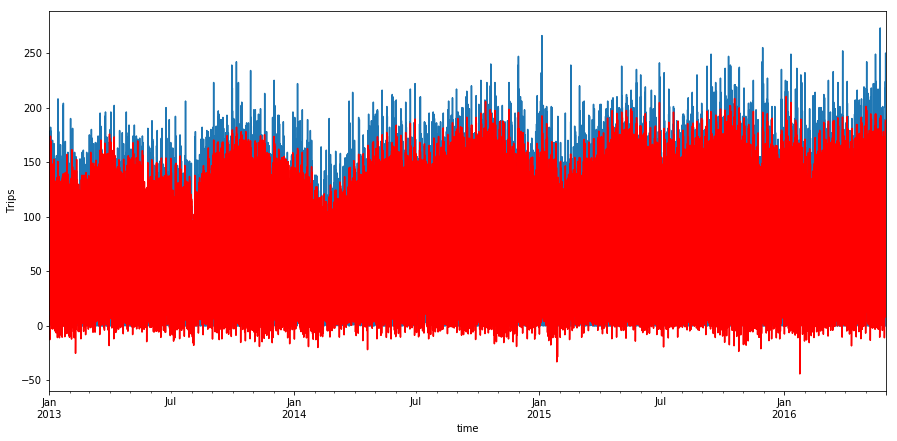

2. Forecast
End.
Start region_2069:
1. Train
geting params
1 1 0 1 0 1
not product
(1, 1, 0, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 24)   Log Likelihood              -91603.959
Date:                            Fri, 15 Dec 2017   AIC                         183261.918
Time:                                    05:30:00   BIC                         183486.195
Sample:                                         0   HQIC                        183333.888
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.3

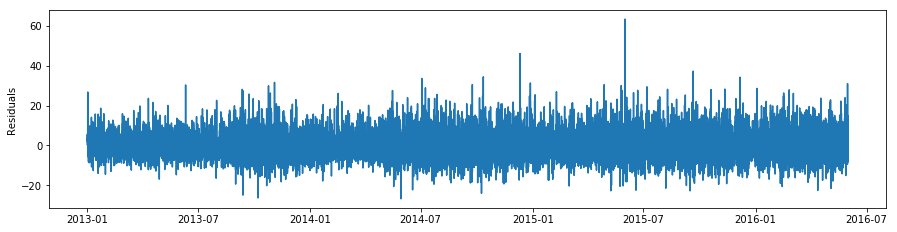

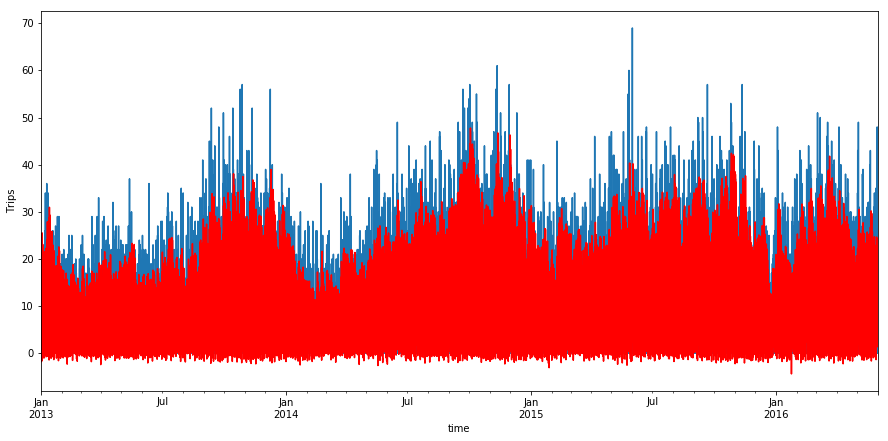

2. Forecast
End.
Start region_2118:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -142785.321
Date:                            Fri, 15 Dec 2017   AIC                         285626.641
Time:                                    07:06:41   BIC                         285859.225
Sample:                                         0   HQIC                        285701.277
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -3.5

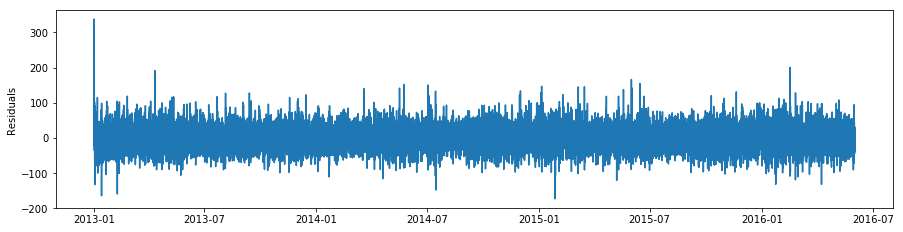

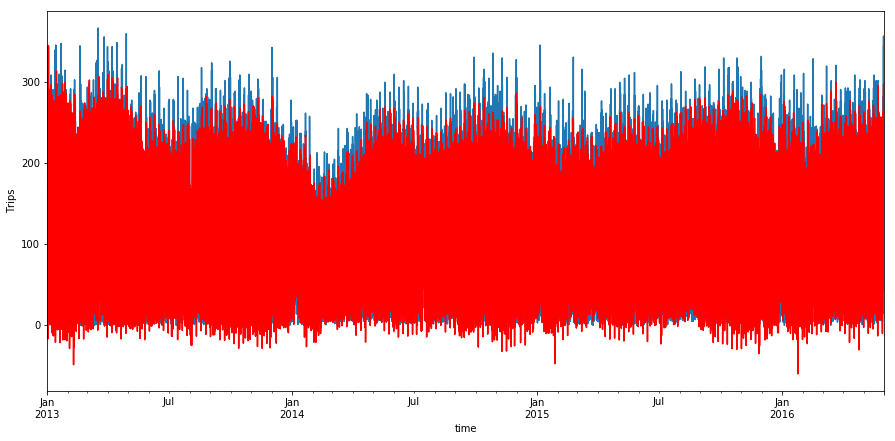

2. Forecast
End.
Start region_2119:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -126554.415
Date:                            Fri, 15 Dec 2017   AIC                         253164.829
Time:                                    08:41:56   BIC                         253397.412
Sample:                                         0   HQIC                        253239.465
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.6

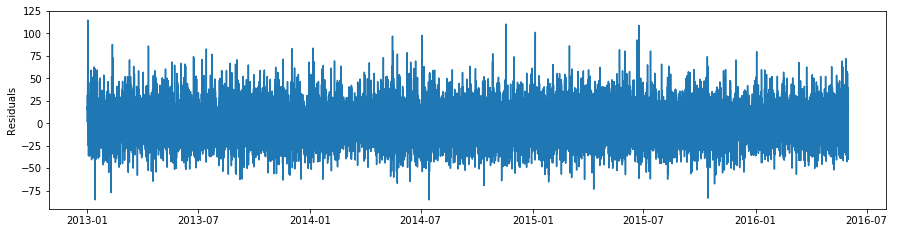

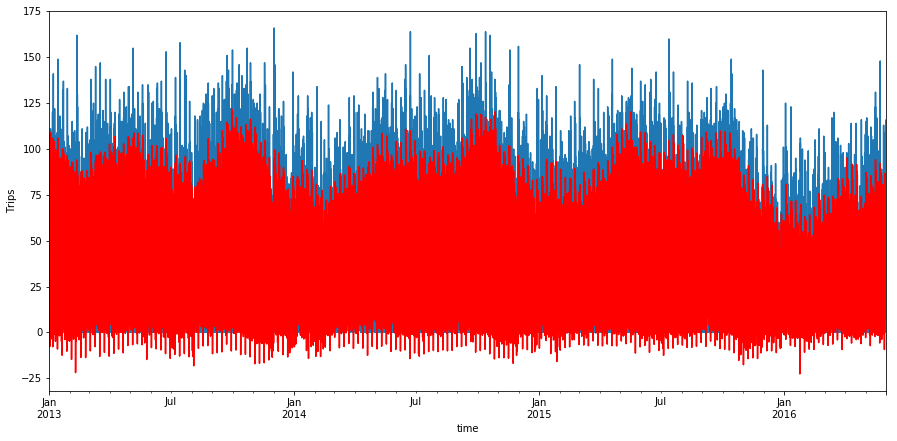

2. Forecast
End.


In [214]:
result_12 = control_forecast(11, 6, 5, params)

Start region_1684:
1. Train
geting params
1 1 0 1 0 1
not product
(1, 1, 0, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(0, 1, 1, 24)   Log Likelihood             -111792.020
Date:                            Fri, 15 Dec 2017   AIC                         223634.040
Time:                                    10:11:19   BIC                         223841.704
Sample:                                         0   HQIC                        223700.679
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             4.4287      0.179   

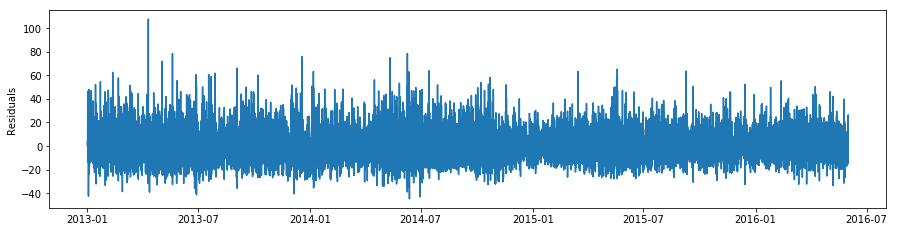

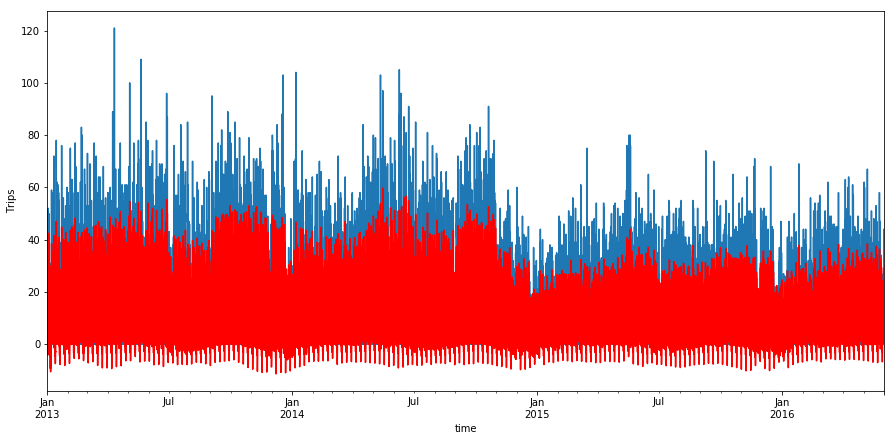

2. Forecast
End.
Start region_1733:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -84601.320
Date:                            Fri, 15 Dec 2017   AIC                         169254.639
Time:                                    11:24:26   BIC                         169470.610
Sample:                                         0   HQIC                        169323.944
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1             0.8

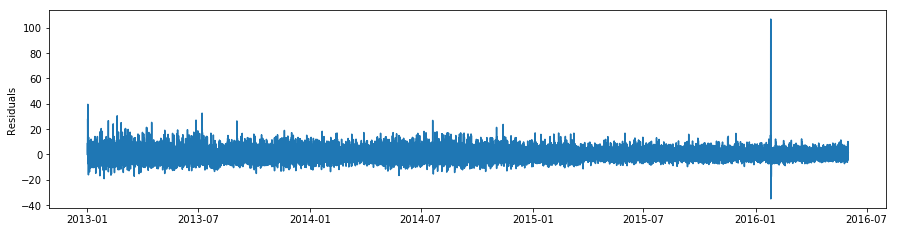

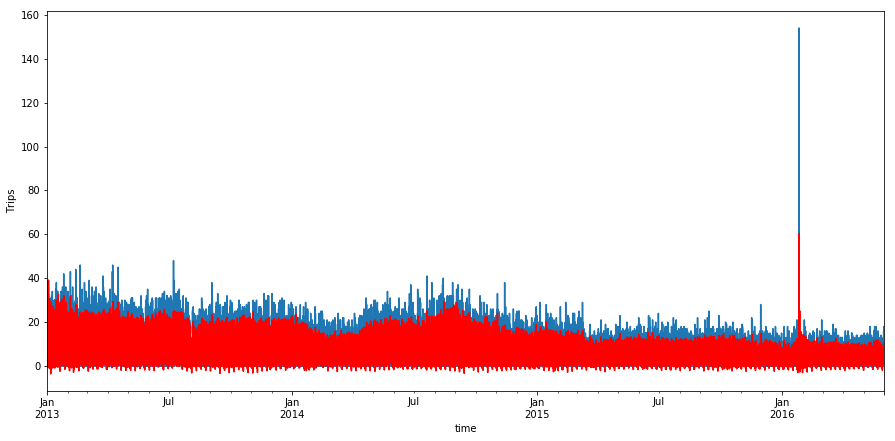

2. Forecast
End.
Start region_1734:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -164852.102
Date:                            Fri, 15 Dec 2017   AIC                         329756.205
Time:                                    13:08:19   BIC                         329972.175
Sample:                                         0   HQIC                        329825.509
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            17.2

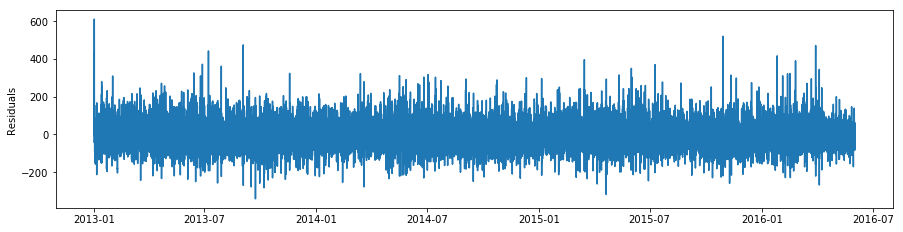

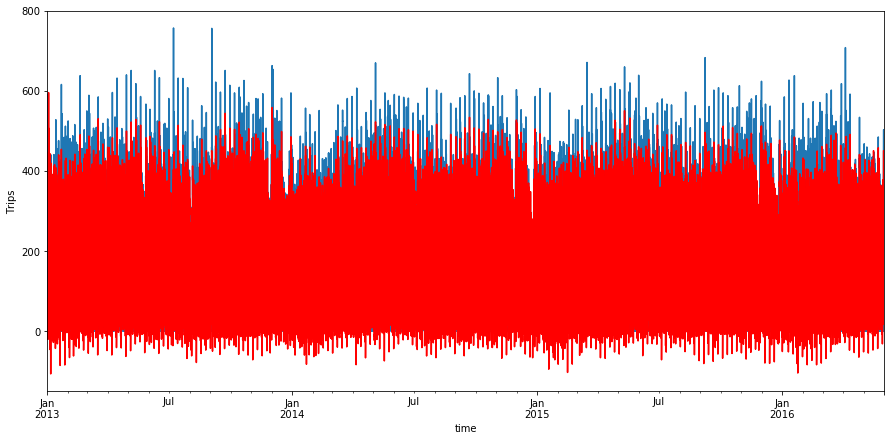

2. Forecast
End.
Start region_1783:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -160147.823
Date:                            Fri, 15 Dec 2017   AIC                         320347.646
Time:                                    14:27:17   BIC                         320563.617
Sample:                                         0   HQIC                        320416.951
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            20.4

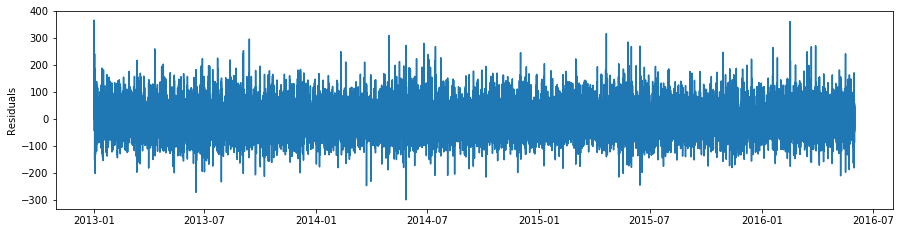

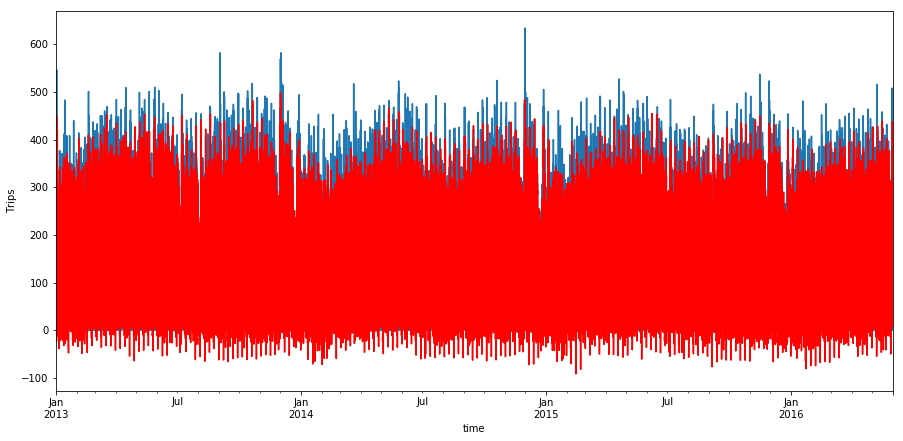

2. Forecast
End.


In [215]:
result_13 = control_forecast(12, 6, 4, params)

Start region_1431:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -105572.601
Date:                            Fri, 15 Dec 2017   AIC                         211193.201
Time:                                    16:01:37   BIC                         211392.558
Sample:                                         0   HQIC                        211257.175
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -3.5685      0.141   

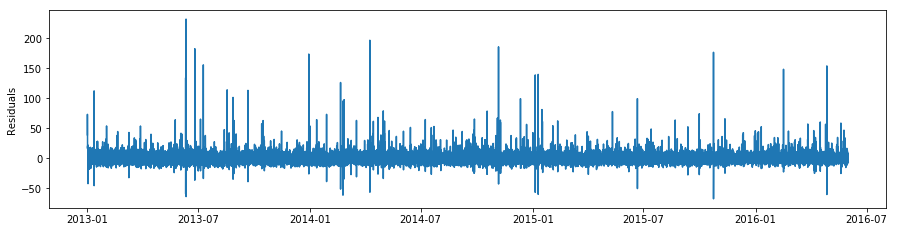

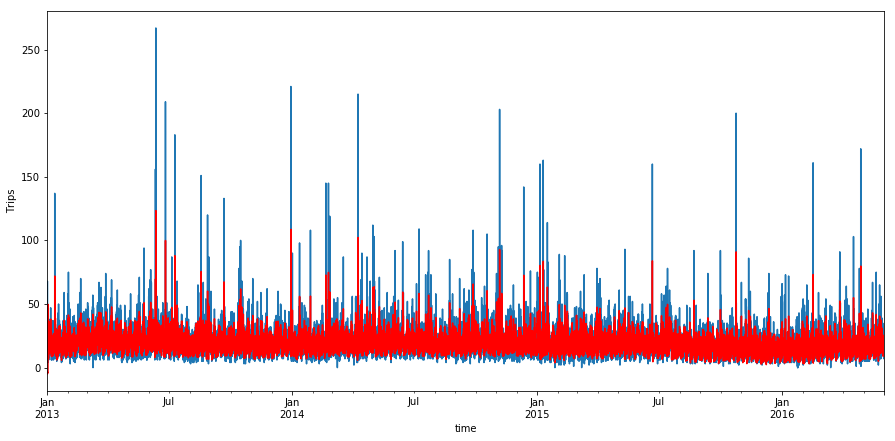

2. Forecast
End.


In [216]:
result_14 = control_forecast(13, 6, 3, params)

Start region_1387:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -108835.220
Date:                            Fri, 15 Dec 2017   AIC                         217722.441
Time:                                    17:18:23   BIC                         217938.411
Sample:                                         0   HQIC                        217791.746
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -4.7576      0.187   

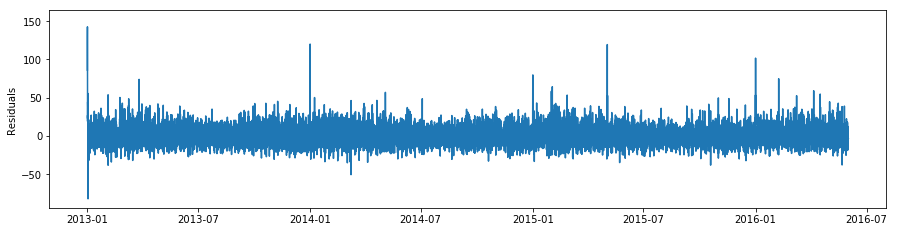

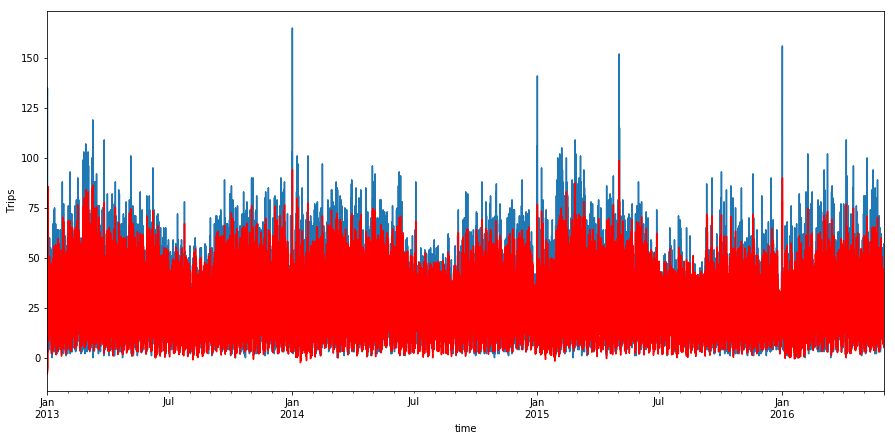

2. Forecast
End.
Start region_1388:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -101165.758
Date:                            Fri, 15 Dec 2017   AIC                         202383.517
Time:                                    18:53:57   BIC                         202599.487
Sample:                                         0   HQIC                        202452.821
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -3.9

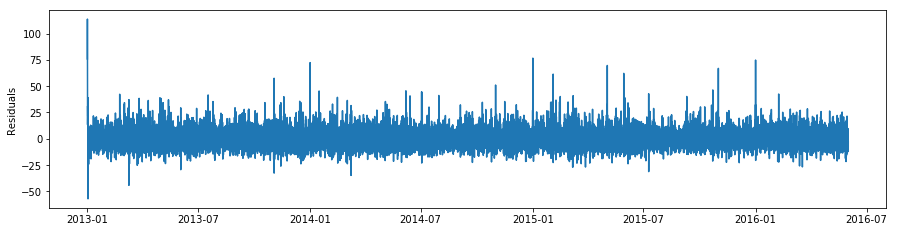

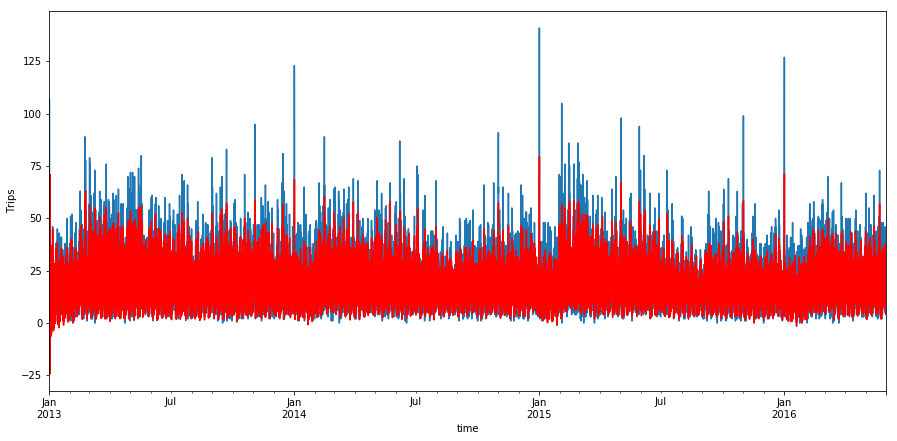

2. Forecast
End.
Start region_1435:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -82922.087
Date:                            Fri, 15 Dec 2017   AIC                         165896.175
Time:                                    20:32:20   BIC                         166112.145
Sample:                                         0   HQIC                        165965.479
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -1.8

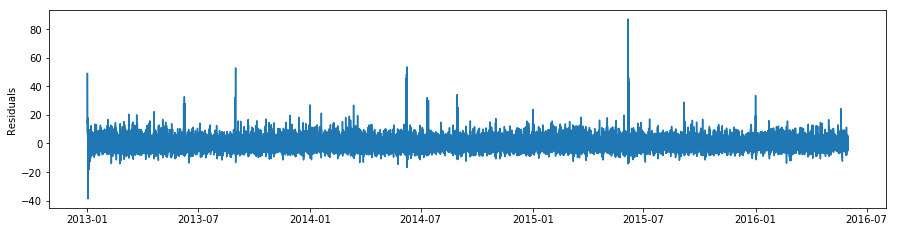

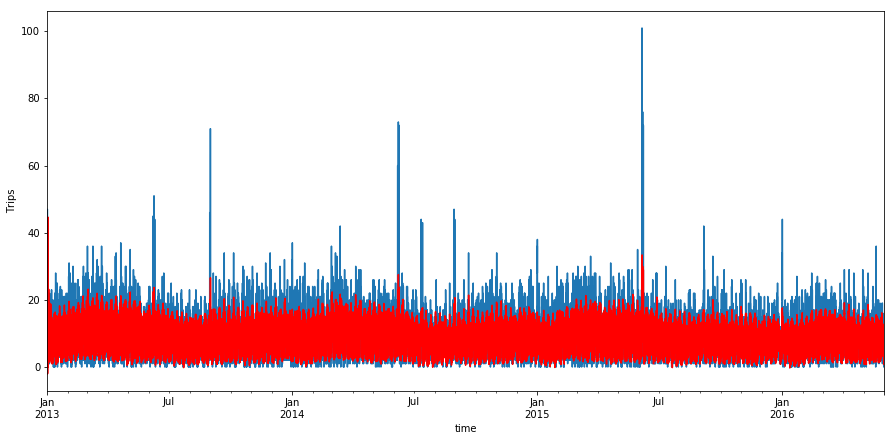

2. Forecast
End.
Start region_1436:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -105667.408
Date:                            Fri, 15 Dec 2017   AIC                         211386.816
Time:                                    21:56:23   BIC                         211602.786
Sample:                                         0   HQIC                        211456.120
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -6.0

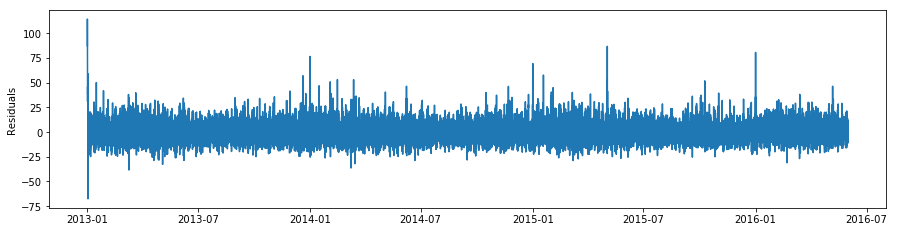

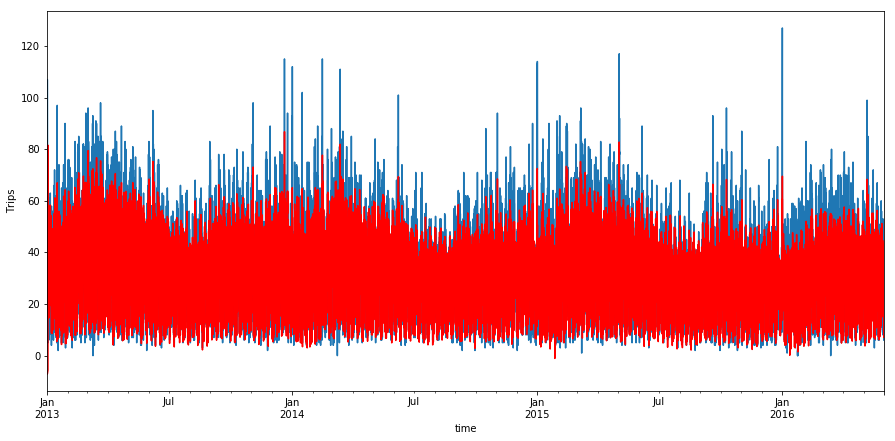

2. Forecast
End.
Start region_1437:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood             -112453.086
Date:                            Fri, 15 Dec 2017   AIC                         224958.171
Time:                                    23:37:24   BIC                         225174.142
Sample:                                         0   HQIC                        225027.476
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -4.0

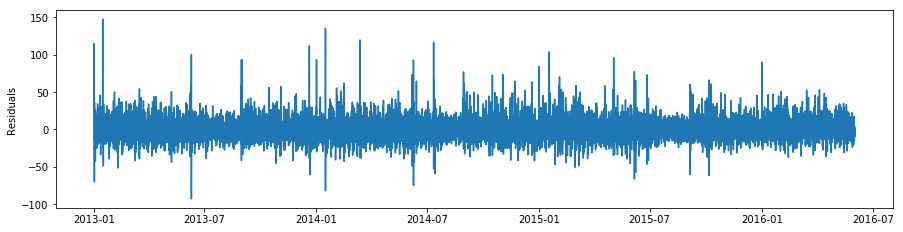

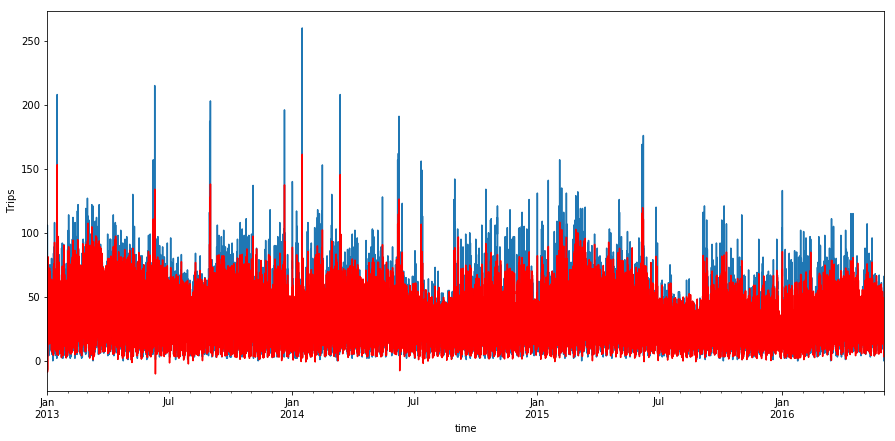

2. Forecast
End.
Start region_1438:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -88749.943
Date:                            Sat, 16 Dec 2017   AIC                         177551.886
Time:                                    00:59:36   BIC                         177767.857
Sample:                                         0   HQIC                        177621.191
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -1.2

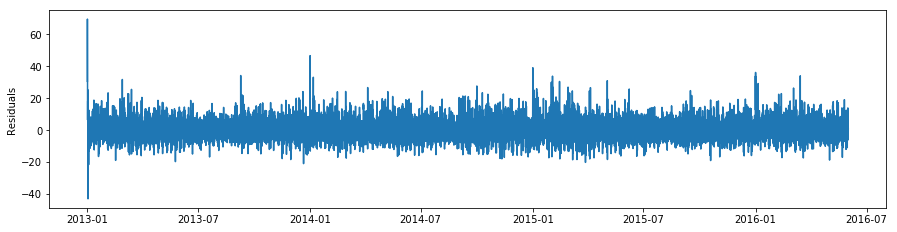

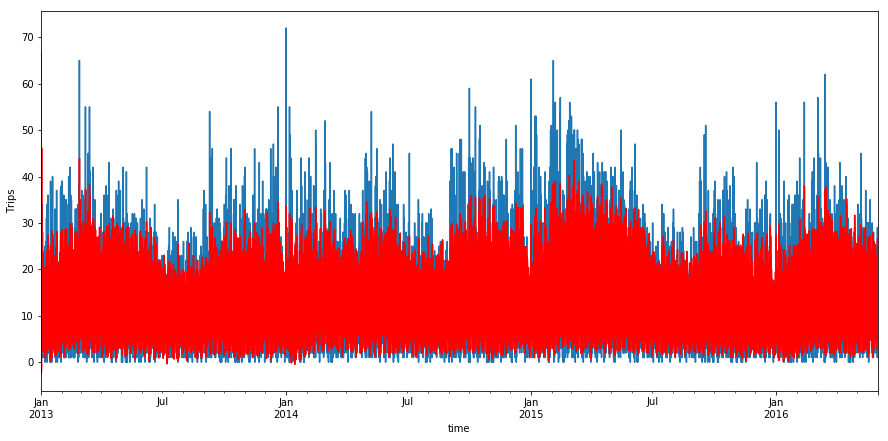

2. Forecast
End.


In [217]:
result_15 = control_forecast(14, 3, 7, params)

Start region_1630:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -77241.825
Date:                            Sat, 16 Dec 2017   AIC                         154531.651
Time:                                    02:25:22   BIC                         154731.008
Sample:                                         0   HQIC                        154595.624
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -1.6635      0.056   

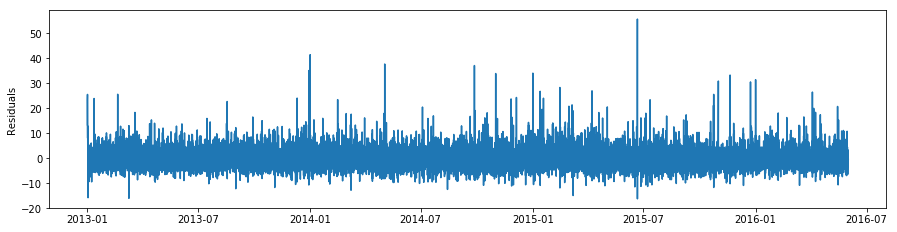

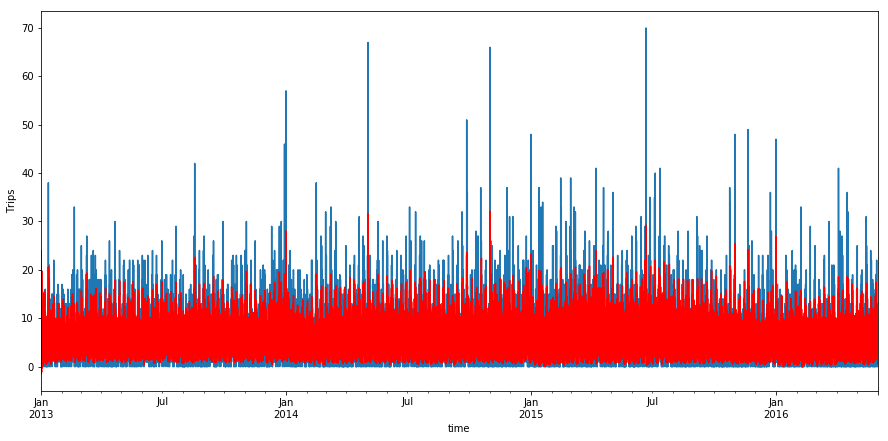

2. Forecast
End.


In [218]:
result_16 = control_forecast(15, 6, 3, params)

Start region_1482:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -96606.570
Date:                            Sat, 16 Dec 2017   AIC                         193253.139
Time:                                    04:08:17   BIC                         193419.270
Sample:                                         0   HQIC                        193306.451
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -4.4973      0.132   

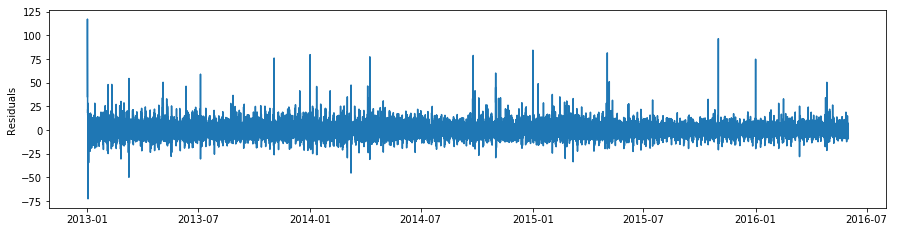

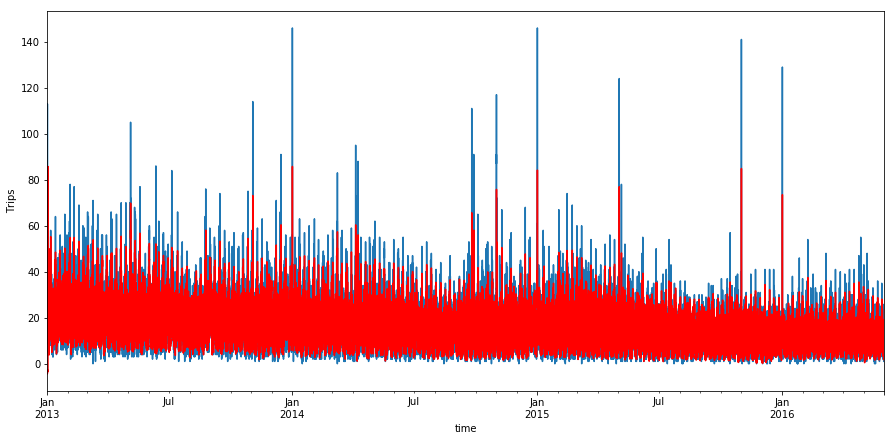

2. Forecast
End.
Start region_1532:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -87870.182
Date:                            Sat, 16 Dec 2017   AIC                         175780.364
Time:                                    05:24:39   BIC                         175946.495
Sample:                                         0   HQIC                        175833.675
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -3.5

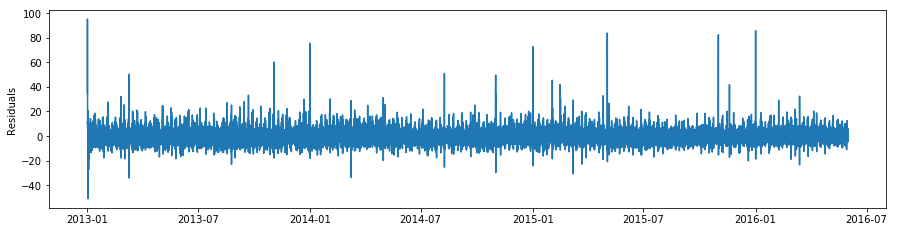

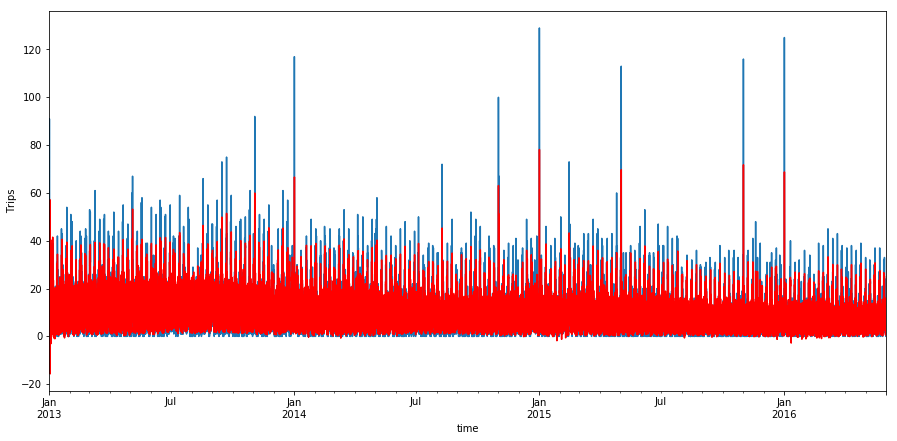

2. Forecast
End.
Start region_1533:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -98403.266
Date:                            Sat, 16 Dec 2017   AIC                         196846.532
Time:                                    06:38:11   BIC                         197012.663
Sample:                                         0   HQIC                        196899.843
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -5.1

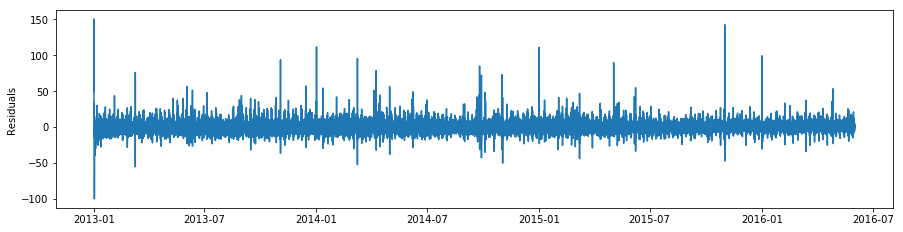

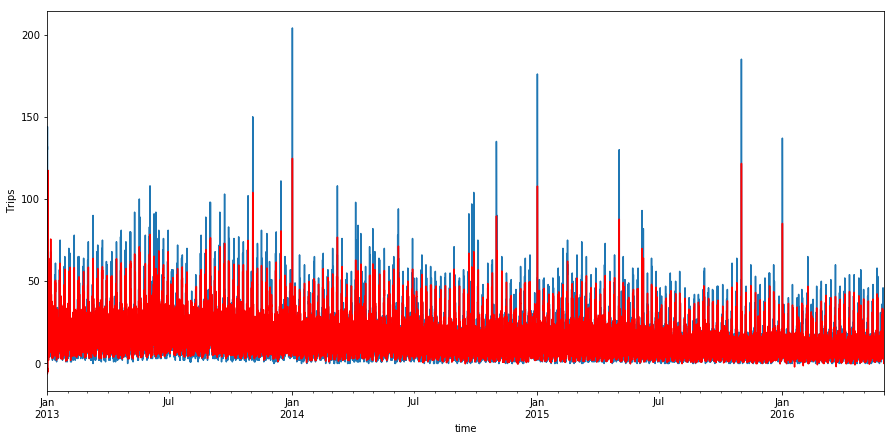

2. Forecast
End.


In [219]:
result_17 = control_forecast(16, 6, 1, params)

Start region_1441:
1. Train
geting params
1 1 1 1 0 1
not product
(1, 1, 1, 1)
                                 Statespace Model Results                                 
Dep. Variable:                                  y   No. Observations:                29928
Model:             SARIMAX(1, 0, 1)x(1, 1, 1, 24)   Log Likelihood              -73293.317
Date:                            Sat, 16 Dec 2017   AIC                         146630.633
Time:                                    07:48:51   BIC                         146813.377
Sample:                                         0   HQIC                        146689.275
                                          - 29928                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
x1            -0.5309      0.052   

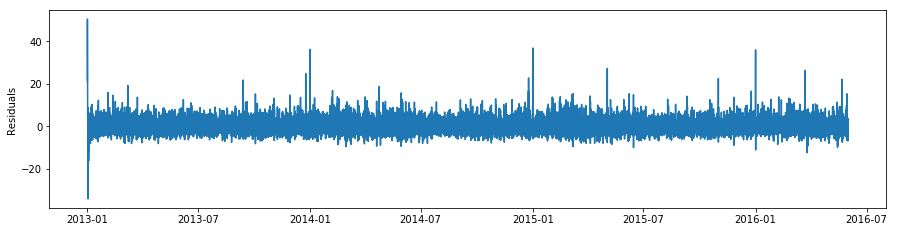

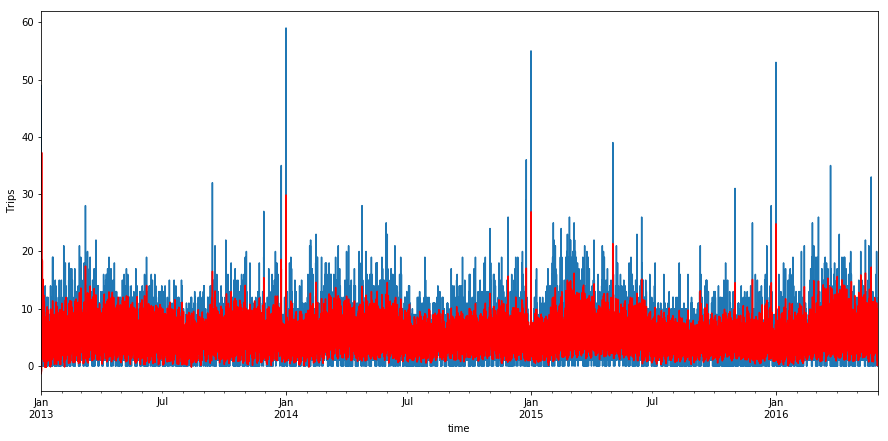

2. Forecast
End.


In [220]:
result_18 = control_forecast(17, 5, 3, params)

Проверка функционала ошибки на контрольных данных

In [268]:
check_result("result/*.csv")

32.106339412221764

## Задание № 8

Загрузите полученный файл на kaggle: https://inclass.kaggle.com/c/yellowtaxi. Добавьте в ноутбук ссылку на сабмишн.

In [269]:
file_path = glob("result/*.csv", recursive=True)
data_array = []
for path in file_path:
    res = pd.read_csv(path, sep=",")
    data_array.append(res)
    
res_data = pd.concat(data_array)
solution = res_data[["id", "y"]].sort_values(["id"])

In [270]:
solution.to_csv("solution.csv", sep=",", index=False)

Ссылка на сабмишн:
https://www.kaggle.com/submissions/6164433/6164433.zip